# Reinforcement Q-learning simple NN as function approximation

- Portfolio grid of size 10 (0 to 1)
- 2 hidden neural layers 
- Training

In [6]:
# Initialization
import numpy as np
import pandas as pd
import random
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
data = pd.read_csv('data.csv') #Three stocks (R,X_s,X_b,s_nom,s_pe,s_spr) 

In [9]:
data = pd.read_excel('sim_data_CER.xlsx') #Three stocks (R,X_s,X_b) Without predictors

# Initialization of the Tensorflow placeholders and the network

In [15]:
num_lags = 3
num_stocks=3
num_inputvar = (num_lags+1)*num_stocks
num_actions=10
hidden1 = 20
hidden2 = 45
hidden3 = 20

#Initialize Neural Network and set-up the placeholders
tf.reset_default_graph()
NN_input = tf.placeholder(shape=[1,num_inputvar],dtype=tf.float32)
# w1 = tf.Variable(tf.random_uniform([num_inputvar,hidden1],0,1))
# w2 = tf.Variable(tf.random_uniform([hidden1,hidden2],0,1))
# w3 = tf.Variable(tf.random_uniform([hidden2,hidden3],0,1))
# w4 = tf.Variable(tf.random_uniform([hidden3,num_actions],0,1))
# b1 = tf.Variable(np.zeros((1,hidden1)), dtype=tf.float32)
# b2 = tf.Variable(np.zeros((1,hidden2)), dtype=tf.float32)
# b3 = tf.Variable(np.zeros((1,hidden3)), dtype=tf.float32)
# b4 = tf.Variable(np.zeros((1,num_actions)), dtype=tf.float32)

w1 = tf.Variable(tf.random_uniform([num_inputvar,hidden1],0,0.01))
b1 = tf.Variable(np.ones((1,hidden1)), dtype=tf.float32) 
w2 = tf.Variable(tf.random_uniform([hidden1,num_actions],0,0.01))
b2 = tf.Variable(np.ones((1,num_actions)), dtype=tf.float32) 
# h1 = tf.add(tf.matmul(NN_input,w1),b1)
# # h_drop1 = tf.nn.dropout(h1,0.5)
# a1 = tf.nn.softmax(h1)

# h2 = tf.add(tf.matmul(a1,w2),b2)
# # h_drop2 = tf.nn.dropout(h2,0.3)
# a2 = tf.nn.softmax(h2)

# h3 = tf.add(tf.matmul(a2,w3),b3)
# # h_drop3 = tf.nn.dropout(h3,0.1)
# a3 = tf.nn.softmax(h3)

# ol = tf.add(tf.matmul(a3,w4),b4)
# output = tf.nn.softmax(ol)

outputh1 = tf.matmul(NN_input,w1)
# outputh1 = tf.nn.softmax(h1)
h2 = tf.matmul(outputh1,w2)
output = tf.nn.softmax(h2)
A_Max = tf.argmax(output,1)

Q_Next = tf.placeholder(shape=[1,num_actions],dtype=tf.float32)
loss = tf.reduce_sum(tf.square(Q_Next - output))



learning_rate = tf.placeholder(tf.float32, shape=[])
trainer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
optmzr = trainer.minimize(loss)


# A_Max = tf.argmax(output,1)
# Calculate loss for the NN from the Q values
# Q_Next = tf.placeholder(shape=[1,num_actions],dtype=tf.float32)
# diff = tf.subtract(Q_Next,output)
# loss = tf.reduce_sum(tf.multiply(diff,diff))

# cross_entropy = tf.reduce_mean(-tf.reduce_sum(a4 * tf.log(Q_Next), reduction_indices=[1]))
# optmzr = tf.train.GradientDescentOptimizer(learning_rate = learning_rate).minimize(loss)
A = np.linspace(0,1,num_actions) # portfolio weights of stocks (1-weight) is the weight in the bonds

# Training of the NN function approximation

1974-05-01 00:00:00


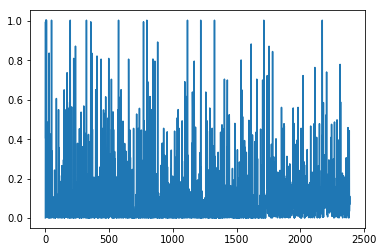

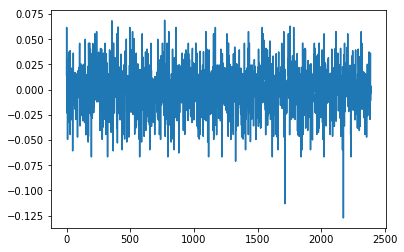

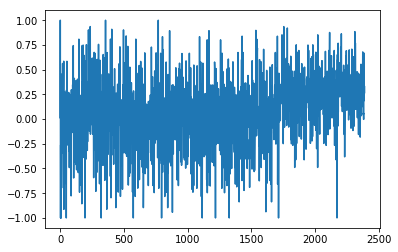

1.24768007828
[ 0.55555556  0.77777778  0.55555556  0.55555556  0.55555556  0.77777778
  0.11111111  1.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.55555556  0.55555556  0.77777778
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.55555556  0.33333333  0.11111111  1.          0.33333333  0.
  0.33333333  0.33333333  0.          0.55555556  0.55555556  0.77777778
  0.77777778  0.33333333  0.11111111  0.55555556  0.          0.55555556
  0.77777778  0.11111111  0.55555556  0.55555556  0.44444444  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556
  0.55555556  0.44444444  0.77777778  0.          0.33333333]
Writing away results
1974-06-01 00:00:00


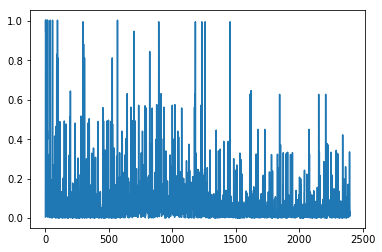

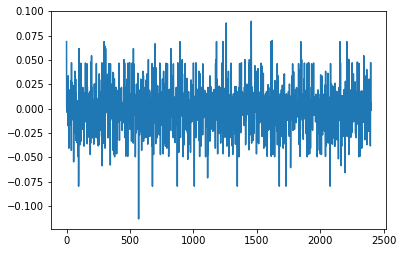

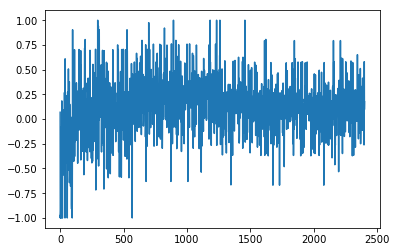

1.14561086428
[ 1.          1.          0.55555556  1.          0.22222222  0.22222222
  0.33333333  0.          0.          0.          0.          0.          0.
  0.          0.55555556  1.          0.22222222  0.22222222  0.          0.
  0.          0.          0.          0.55555556  0.          0.22222222
  0.          0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.22222222  0.22222222  0.          0.          0.
  0.55555556  1.          0.22222222  0.22222222  0.55555556  0.55555556
  1.          0.22222222  0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.22222222  0.22222222  0.          0.          0.        ]
Writing away results
1974-07-01 00:00:00


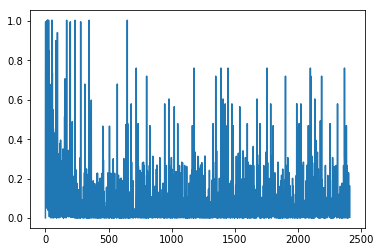

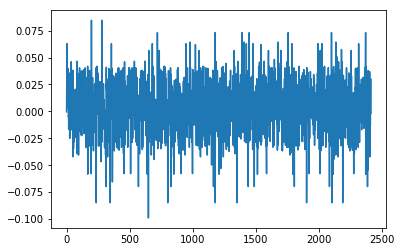

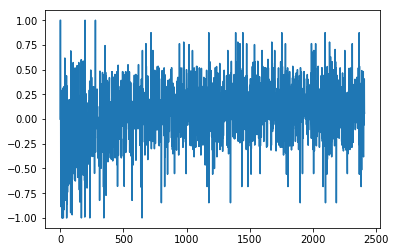

1.3591363285
[ 0.          0.          0.          0.88888889  0.33333333  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.33333333  0.44444444  0.66666667  0.33333333  0.66666667  0.66666667
  0.33333333  0.          0.          0.          0.33333333  0.66666667
  0.33333333  0.          0.22222222  0.          0.          0.33333333
  0.          0.          0.88888889  1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.          0.88888889
  0.33333333  0.66666667  0.66666667  0.66666667  0.44444444]
Writing away results
1974-08-01 00:00:00


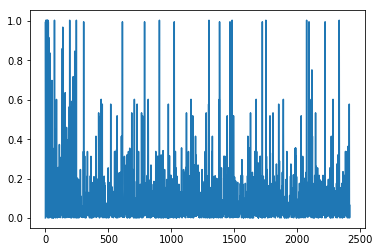

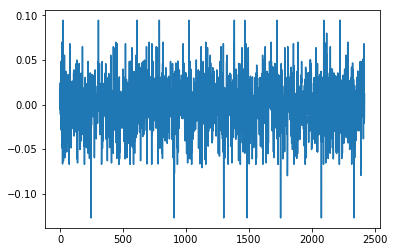

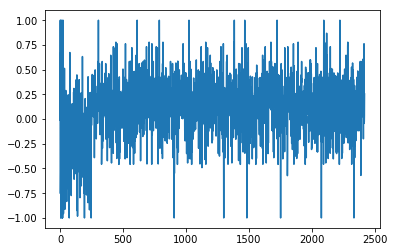

1.32158118906
[ 0.77777778  0.77777778  0.55555556  0.44444444  0.88888889  0.
  0.33333333  0.          1.          0.          0.          1.          1.
  0.77777778  0.55555556  0.33333333  0.33333333  0.          1.          0.
  1.          0.11111111  0.          0.22222222  0.88888889  0.
  0.22222222  0.          0.          0.22222222  0.11111111  0.77777778
  0.77777778  0.77777778  0.          1.          0.88888889  1.
  0.77777778  0.55555556  0.44444444  0.77777778  0.77777778  0.77777778
  0.55555556  1.          1.          0.          0.          1.
  0.77777778  0.55555556  0.77777778  0.55555556  1.          0.          1.
  0.55555556  0.        ]
Writing away results
1974-09-01 00:00:00


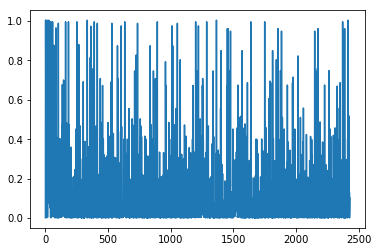

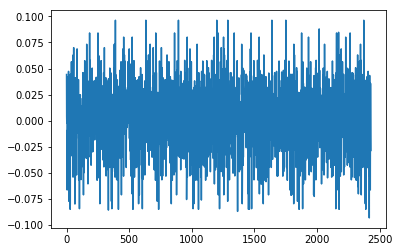

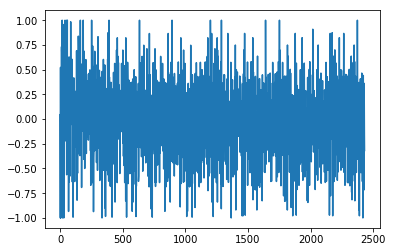

1.73904674102
[ 0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  1.          0.66666667  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  1.          0.88888889  1.          0.88888889
  0.88888889  0.22222222  0.88888889  0.88888889  1.          0.88888889
  1.          0.66666667  0.66666667  0.88888889  0.          0.88888889
  0.88888889  1.          0.77777778  1.          0.66666667  1.
  0.66666667  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  1.          0.77777778  1.          0.66666667  0.88888889
  0.88888889  0.88888889  0.77777778  0.88888889  0.33333333]
Writing away results
1974-10-01 00:00:00


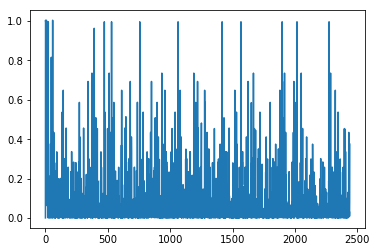

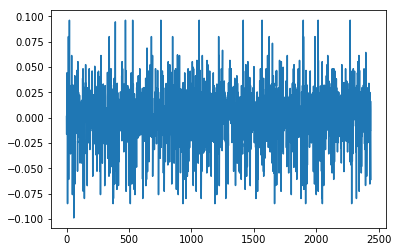

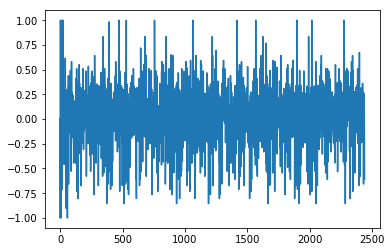

1.50386898913
[ 1.          0.44444444  1.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.88888889  0.77777778
  1.          0.11111111  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.55555556  0.44444444  0.66666667  0.55555556
  0.44444444  0.66666667  0.55555556  0.44444444  0.88888889  0.77777778
  0.77777778  0.77777778  0.55555556  0.55555556  1.          0.88888889
  0.77777778  1.          0.11111111  0.77777778  0.88888889  0.33333333
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.77777778  1.          0.77777778  1.          0.55555556  0.66666667
  0.55555556  1.          0.55555556  0.55555556  0.55555556]
Writing away results
1974-11-01 00:00:00


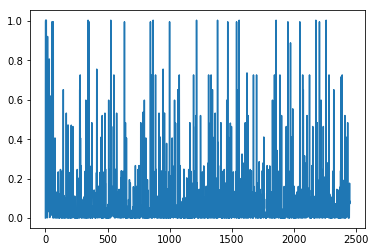

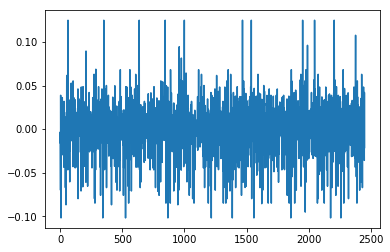

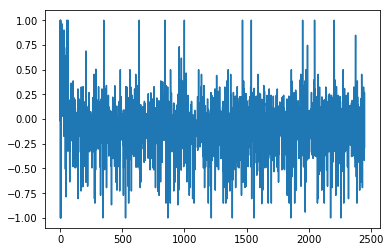

1.28044968887
[ 0.55555556  0.44444444  0.66666667  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.33333333  0.44444444  0.77777778  0.77777778
  0.66666667  0.22222222  0.66666667  0.66666667  0.33333333  0.66666667
  0.44444444  0.66666667  0.66666667  0.44444444  0.66666667  0.55555556
  0.44444444  0.66666667  0.33333333  0.44444444  0.77777778  0.77777778
  0.77777778  0.66666667  0.66666667  1.          0.88888889  0.77777778
  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.33333333  0.77777778
  0.77777778  0.77777778  0.55555556  0.66666667  0.44444444  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1974-12-01 00:00:00


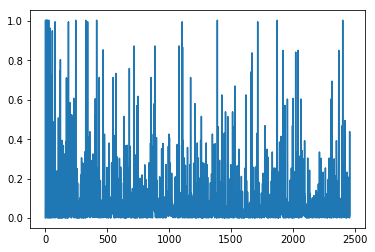

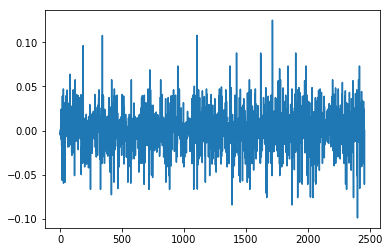

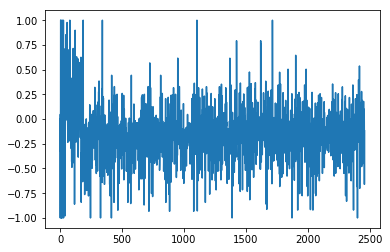

1.31144788131
[ 0.33333333  0.66666667  0.11111111  0.33333333  0.88888889  0.33333333
  0.33333333  0.88888889  0.66666667  0.66666667  0.22222222  0.11111111
  0.88888889  0.33333333  0.11111111  0.33333333  0.88888889  0.55555556
  0.66666667  0.11111111  0.88888889  0.          0.33333333  0.33333333
  0.11111111  0.44444444  0.22222222  0.66666667  0.77777778  0.77777778
  0.22222222  0.11111111  0.88888889  0.66666667  0.44444444  0.22222222
  0.44444444  0.44444444  0.66666667  0.66666667  0.11111111  0.11111111
  0.88888889  0.66666667  0.11111111  0.88888889  0.55555556  0.66666667
  0.44444444  0.77777778  0.33333333  0.66666667  0.33333333  0.88888889
  0.          0.11111111  0.11111111  0.33333333  0.44444444]
Writing away results
1975-01-01 00:00:00


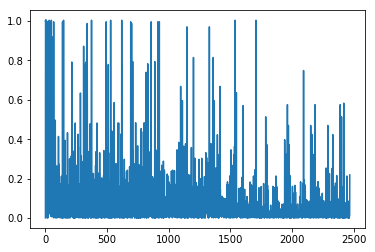

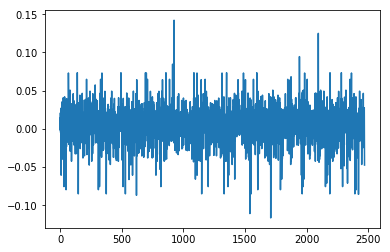

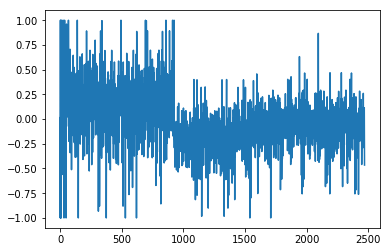

1.22026684254
[ 0.66666667  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.11111111  1.          0.55555556  0.44444444  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.          0.44444444
  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.22222222  0.11111111  1.          0.55555556  0.          0.77777778
  0.44444444  0.11111111  1.          0.          0.88888889  0.44444444
  0.          0.          1.          0.44444444  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.11111111  0.          1.
  0.55555556  0.11111111  0.33333333  0.44444444  0.55555556  0.77777778
  0.44444444  0.77777778  0.77777778  0.          0.33333333]
Writing away results
1975-02-01 00:00:00


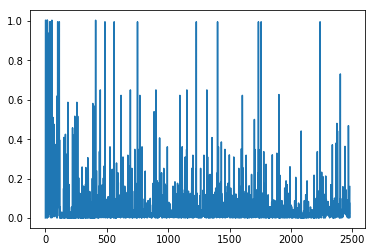

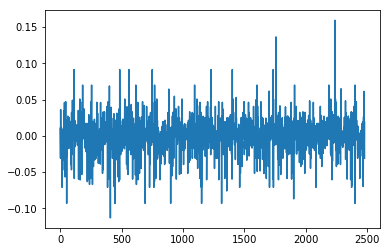

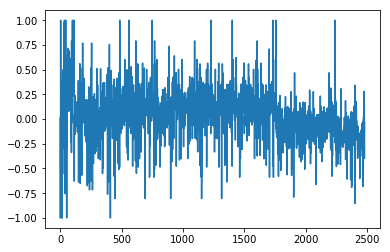

0.976100126916
[ 0.11111111  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111
  0.66666667  0.          0.          0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.11111111  0.66666667  0.22222222  0.33333333
  0.66666667  0.22222222  0.11111111  0.11111111  0.22222222  0.11111111
  0.66666667  1.          0.          0.          0.22222222  0.11111111
  0.66666667  0.22222222  0.          0.          0.          0.          0.
  0.          0.77777778  0.11111111  0.11111111  0.22222222  0.11111111
  0.11111111  1.          0.          0.          0.          0.11111111
  0.22222222  0.11111111  0.33333333  0.22222222  0.11111111  0.11111111
  0.11111111  0.          0.55555556  0.        ]
Writing away results
1975-03-01 00:00:00


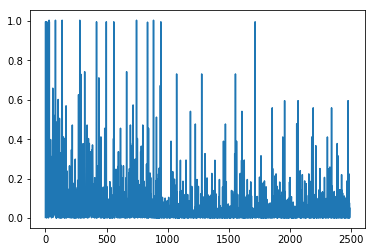

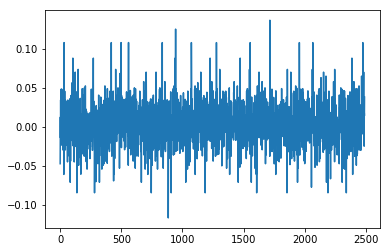

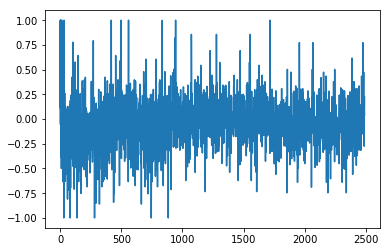

1.06777175164
[ 0.55555556  0.88888889  0.55555556  0.55555556  1.          1.
  0.33333333  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.44444444  0.88888889  0.55555556  1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889  0.44444444
  0.33333333  0.          0.          0.88888889  0.55555556  0.          1.
  0.          0.11111111  0.66666667  0.          0.33333333  0.11111111
  0.55555556  0.55555556  1.          0.88888889  0.55555556  0.55555556
  0.44444444  0.33333333  0.66666667  0.11111111  1.          0.88888889
  0.55555556  0.          0.55555556  0.55555556  0.88888889  0.55555556
  0.          0.11111111  0.66666667  0.88888889]
Writing away results
1975-04-01 00:00:00


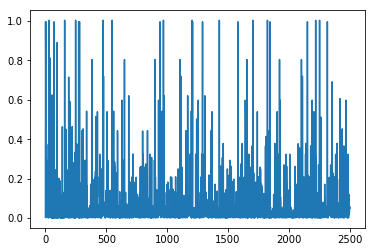

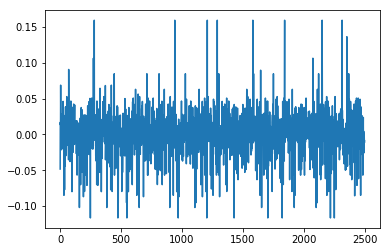

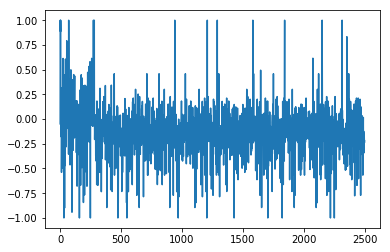

1.00064520972
[ 0.77777778  0.33333333  0.11111111  0.77777778  0.77777778  0.
  0.22222222  0.11111111  0.44444444  0.33333333  0.44444444  0.33333333
  0.77777778  0.77777778  0.          0.11111111  0.77777778  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.77777778  0.
  0.22222222  0.22222222  0.          0.11111111  0.77777778  0.          1.
  0.22222222  0.11111111  0.88888889  0.77777778  0.22222222  0.11111111
  0.11111111  0.77777778  0.33333333  0.11111111  0.11111111  0.77777778
  0.          0.22222222  0.22222222  0.77777778  0.33333333  0.66666667
  0.11111111  0.33333333  0.11111111  0.33333333  0.33333333  0.77777778
  0.          0.          0.11111111  0.77777778]
Writing away results
1975-05-01 00:00:00


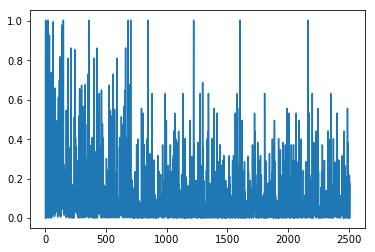

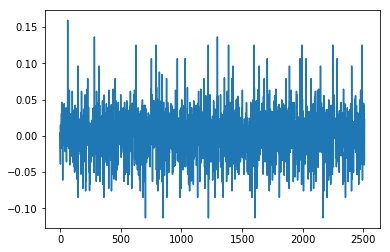

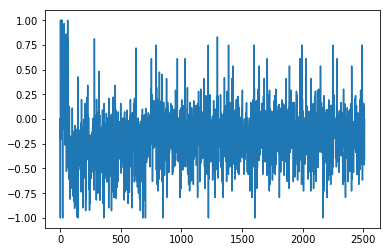

1.16582306912
[ 0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.33333333
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.          1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.77777778  0.88888889  0.77777778
  0.77777778  0.66666667  0.11111111  0.77777778  0.88888889  0.77777778
  0.77777778  0.22222222  0.77777778  0.88888889  0.33333333  0.22222222
  0.66666667  1.          1.          0.66666667  0.66666667  0.88888889
  0.88888889  0.44444444  0.77777778  0.88888889  1.          0.22222222
  0.77777778  0.66666667  0.11111111  0.66666667  0.66666667  0.77777778
  0.88888889  0.22222222  0.77777778  0.55555556  0.77777778]
Writing away results
1975-06-01 00:00:00


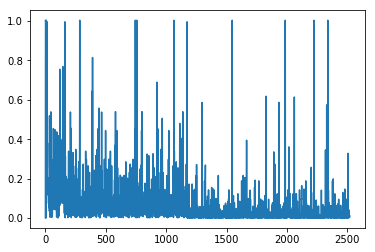

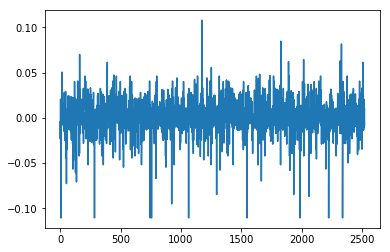

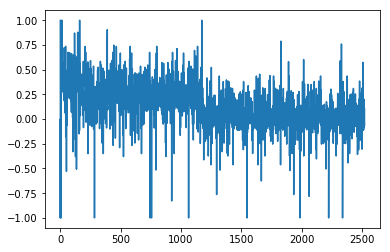

0.969987915962
[ 0.22222222  0.22222222  0.77777778  0.          0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.77777778
  0.22222222  0.44444444  0.88888889  0.22222222  0.44444444  0.22222222
  0.22222222  0.44444444  0.77777778  0.          0.          0.
  0.22222222  0.22222222  0.          0.22222222  0.          0.
  0.44444444  0.          0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.          0.
  0.          0.22222222  0.22222222  0.22222222  0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.          0.          1.
  0.22222222  0.          0.        ]
Writing away results
1975-07-01 00:00:00


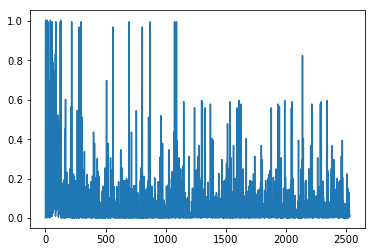

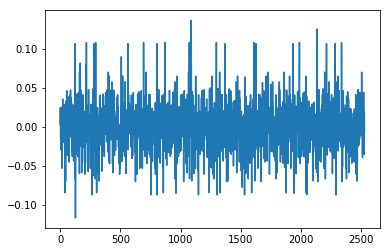

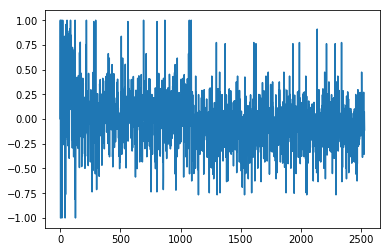

1.35319272051
[ 0.88888889  0.88888889  0.66666667  0.66666667  0.11111111  0.77777778
  0.22222222  0.11111111  0.77777778  0.22222222  0.88888889  0.22222222
  1.          0.88888889  0.22222222  0.77777778  0.22222222  0.22222222
  0.77777778  0.33333333  0.66666667  0.66666667  0.66666667  0.22222222
  0.11111111  0.88888889  0.          0.66666667  0.55555556  0.11111111
  1.          0.55555556  0.66666667  0.77777778  0.77777778  0.88888889
  0.22222222  0.11111111  0.77777778  0.44444444  0.55555556  0.66666667
  0.77777778  0.          0.88888889  0.11111111  0.77777778  0.22222222
  0.11111111  0.77777778  0.11111111  0.55555556  0.66666667  0.66666667
  0.77777778  0.          0.44444444  0.66666667  0.11111111]
Writing away results
1975-08-01 00:00:00


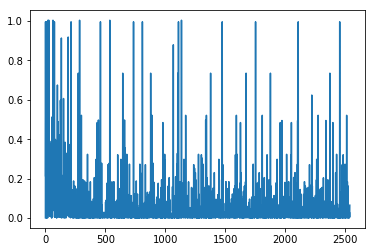

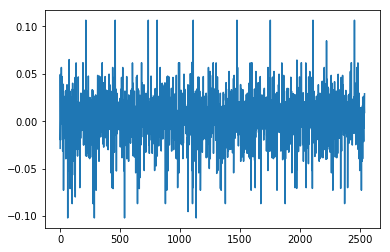

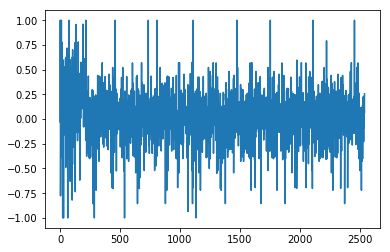

0.989979543366
[ 0.66666667  0.          0.          0.11111111  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556  0.44444444
  0.66666667  0.55555556  0.77777778  0.55555556  0.55555556  0.11111111
  1.          0.          0.          0.          0.55555556  0.11111111
  1.          0.88888889  0.          0.          0.33333333  1.          0.
  0.          0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.          1.          0.55555556
  0.55555556  0.55555556  1.          0.55555556  0.11111111  0.55555556
  0.55555556  0.          0.          0.          0.66666667  0.11111111
  0.          0.          0.55555556  0.11111111]
Writing away results
1975-09-01 00:00:00


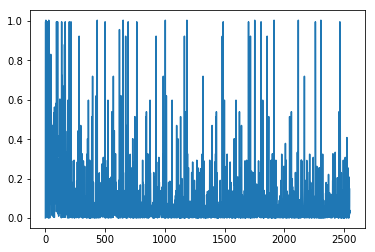

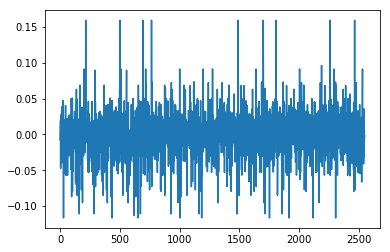

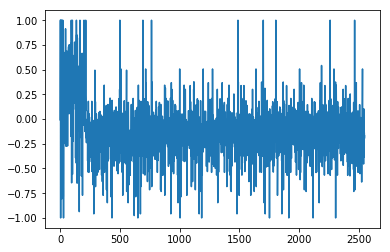

1.33002579174
[ 1.          1.          0.55555556  0.66666667  0.77777778  0.55555556
  0.66666667  0.44444444  0.66666667  0.77777778  0.55555556  0.66666667
  0.44444444  0.33333333  0.          0.77777778  0.33333333  0.66666667
  0.22222222  1.          1.          0.77777778  0.55555556  0.66666667
  0.22222222  0.33333333  0.77777778  0.11111111  0.66666667  0.66666667
  1.          0.11111111  0.55555556  0.66666667  0.44444444  0.55555556
  0.66666667  0.66666667  0.77777778  1.          0.11111111  0.33333333
  0.66666667  0.55555556  0.66666667  0.44444444  0.55555556  0.66666667
  0.55555556  0.66666667  0.22222222  0.11111111  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.66666667  0.77777778]
Writing away results
1975-10-01 00:00:00


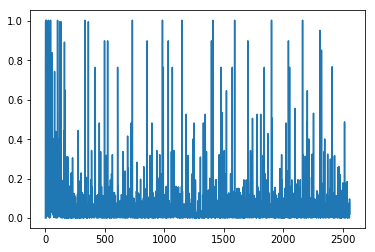

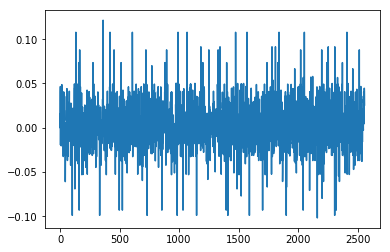

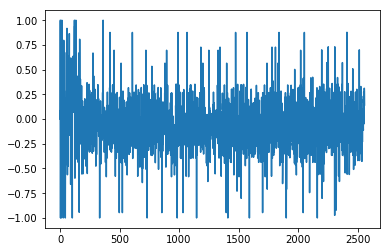

1.1299211941
[ 0.22222222  0.77777778  0.33333333  0.77777778  0.77777778  0.33333333
  0.77777778  0.66666667  0.77777778  0.77777778  0.22222222  0.77777778
  0.77777778  1.          0.77777778  0.77777778  0.66666667  0.11111111
  0.22222222  0.88888889  0.33333333  0.77777778  0.22222222  0.11111111
  0.44444444  0.22222222  0.77777778  0.44444444  0.11111111  0.
  0.77777778  0.77777778  0.33333333  1.          0.77777778  0.33333333
  0.11111111  0.22222222  0.77777778  0.88888889  0.77777778  0.33333333
  0.77777778  0.88888889  1.          0.77777778  0.33333333  0.77777778
  0.11111111  0.22222222  0.77777778  0.22222222  0.77777778  0.11111111
  0.22222222  0.77777778  0.33333333  0.77777778  0.77777778]
Writing away results
1975-11-01 00:00:00


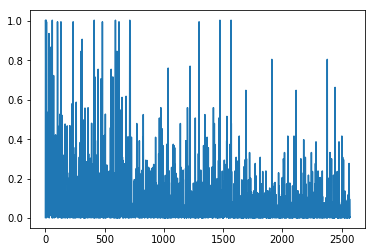

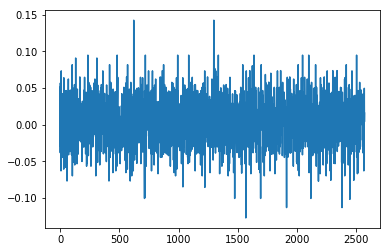

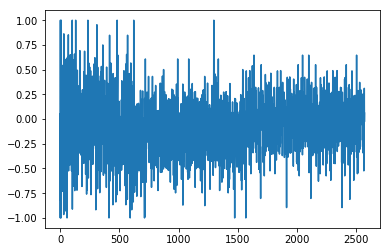

1.30587952609
[ 1.          1.          1.          1.          1.          0.66666667
  0.66666667  1.          0.22222222  0.77777778  0.66666667  1.          1.
  1.          1.          0.66666667  0.44444444  0.55555556  0.55555556
  1.          1.          0.33333333  0.66666667  0.44444444  0.11111111
  0.          0.77777778  0.66666667  0.55555556  1.          1.          1.
  0.66666667  1.          1.          0.44444444  0.66666667  0.55555556
  0.22222222  1.          1.          1.          0.77777778  0.66666667
  1.          1.          1.          0.44444444  0.66666667  0.
  0.22222222  0.66666667  0.44444444  0.44444444  0.11111111  1.          1.
  1.          1.        ]
Writing away results
1975-12-01 00:00:00


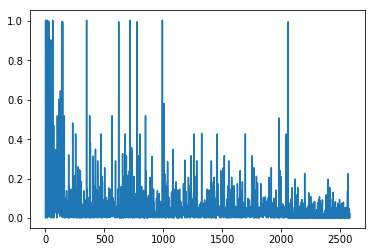

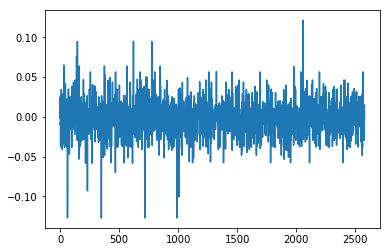

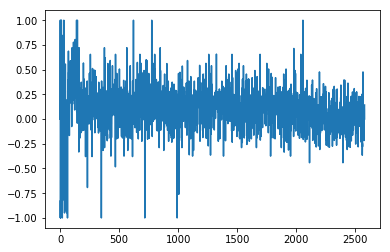

1.07601743844
[ 0.          0.          0.          0.          0.          0.22222222
  0.          0.33333333  0.          0.          0.44444444  0.          0.
  0.44444444  0.22222222  0.33333333  0.33333333  0.33333333  0.
  0.44444444  0.22222222  0.55555556  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.11111111  0.          0.          0.
  0.          0.          0.33333333  0.33333333  0.33333333  0.33333333
  1.          0.          0.          0.33333333  0.          0.          0.
  0.          0.33333333  0.55555556  0.33333333  0.66666667  0.
  0.33333333  0.55555556  0.88888889  0.          0.          0.          0.
  0.55555556]
Writing away results
1976-01-01 00:00:00


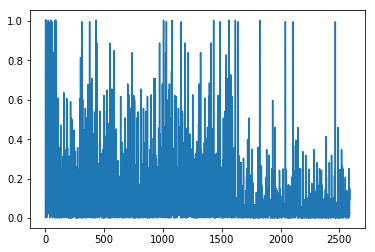

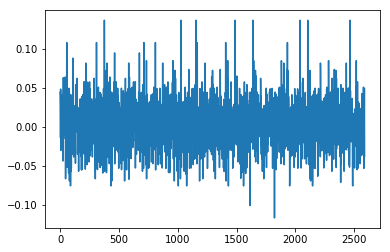

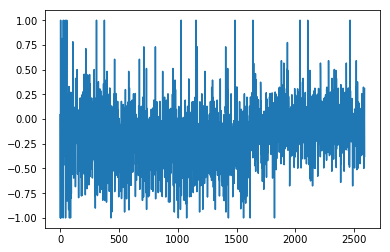

1.26454621563
[ 0.77777778  1.          0.77777778  0.77777778  0.          0.66666667
  1.          1.          0.77777778  1.          0.77777778  0.88888889
  0.33333333  0.          0.22222222  0.66666667  0.55555556  0.66666667
  0.33333333  0.          0.44444444  0.22222222  0.66666667  0.22222222
  0.          0.          0.66666667  0.66666667  1.          0.77777778
  0.77777778  0.88888889  1.          0.44444444  0.66666667  0.22222222
  0.66666667  0.77777778  0.66666667  0.88888889  1.          0.77777778
  0.88888889  0.77777778  0.77777778  0.          0.66666667  0.22222222
  0.66666667  0.44444444  0.          0.11111111  0.55555556  1.
  0.77777778  0.77777778  0.77777778  0.88888889  0.55555556]
Writing away results
1976-02-01 00:00:00


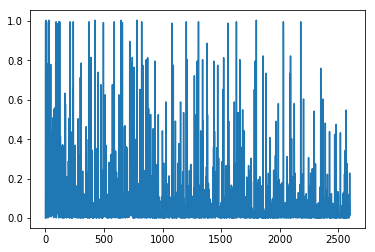

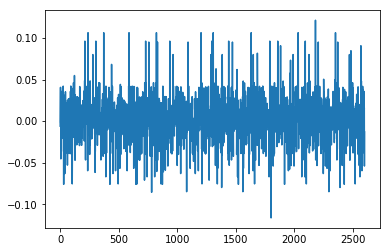

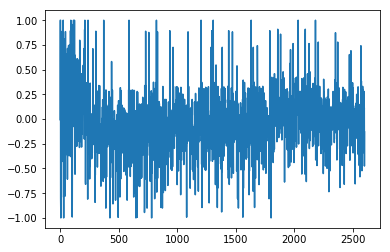

1.07607697972
[ 0.44444444  0.44444444  0.44444444  0.88888889  0.          0.55555556
  0.77777778  0.44444444  0.55555556  0.88888889  0.88888889  0.55555556
  0.77777778  0.          0.          0.55555556  0.66666667  0.55555556
  0.77777778  1.          0.55555556  0.          0.55555556  0.77777778
  0.          0.          0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  1.          0.          0.55555556  0.77777778
  0.44444444  0.88888889  0.44444444  0.77777778  0.44444444  0.22222222
  0.33333333  0.44444444  0.77777778  0.          0.55555556  0.77777778
  0.44444444  0.55555556  0.          0.22222222  0.88888889  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.55555556]
Writing away results
1976-03-01 00:00:00


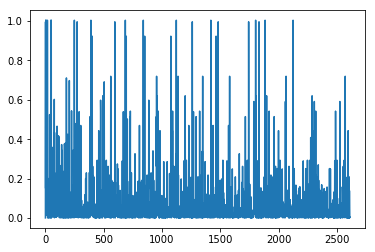

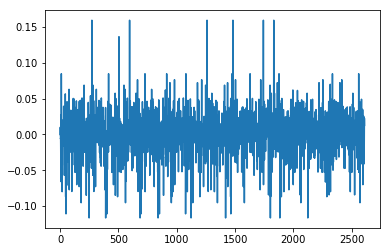

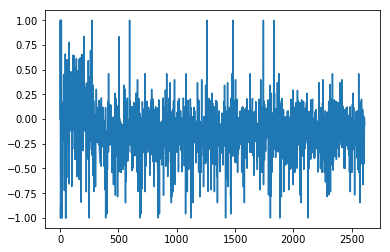

1.34498205192
[ 0.55555556  0.77777778  0.77777778  0.          0.44444444  0.55555556
  0.          0.33333333  0.77777778  0.66666667  0.33333333  0.77777778
  0.22222222  1.          1.          0.55555556  0.33333333  0.55555556
  0.77777778  1.          0.66666667  1.          0.33333333  0.77777778
  0.66666667  0.11111111  0.11111111  0.77777778  0.77777778  0.44444444
  0.33333333  0.33333333  0.77777778  0.22222222  0.11111111  0.33333333
  0.55555556  0.44444444  0.11111111  0.77777778  0.66666667  0.55555556
  0.33333333  0.33333333  0.77777778  0.44444444  0.11111111  0.
  0.33333333  0.77777778  0.66666667  0.55555556  0.55555556  0.
  0.77777778  0.77777778  0.11111111  0.33333333  0.77777778]
Writing away results
1976-04-01 00:00:00


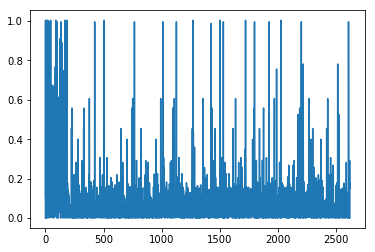

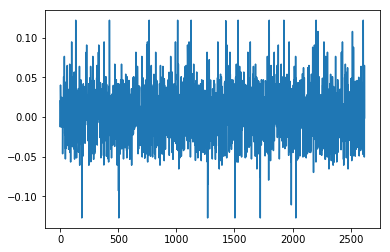

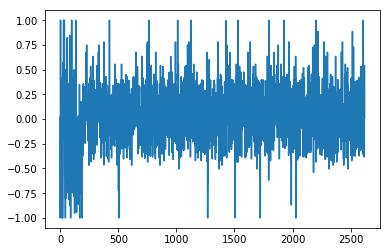

1.07472902269
[ 1.          0.55555556  1.          0.22222222  1.          1.          1.
  1.          1.          1.          0.55555556  0.55555556  0.55555556
  0.55555556  1.          1.          0.55555556  0.66666667  0.55555556
  0.88888889  0.22222222  0.55555556  0.55555556  0.88888889  0.22222222
  1.          1.          1.          1.          1.          0.55555556
  0.55555556  0.55555556  0.22222222  1.          1.          1.
  0.55555556  1.          1.          1.          1.          0.55555556
  0.88888889  0.22222222  0.22222222  1.          0.55555556  0.55555556
  0.11111111  1.          1.          1.          1.          0.44444444
  1.          1.          0.55555556  0.33333333]
Writing away results
1976-05-01 00:00:00


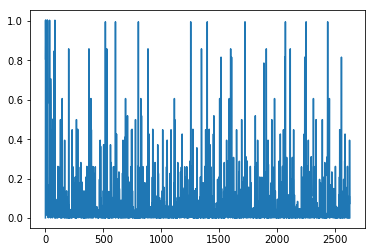

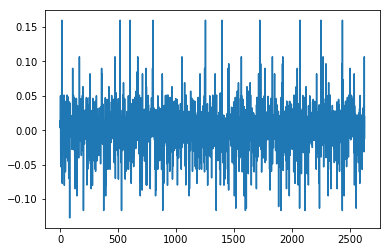

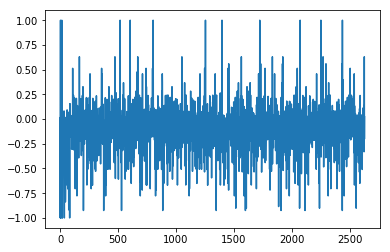

1.13794853823
[ 0.77777778  0.88888889  0.          0.77777778  0.44444444  0.66666667
  0.66666667  0.33333333  0.66666667  0.77777778  1.          1.          1.
  0.33333333  0.44444444  0.77777778  1.          1.          0.11111111
  0.11111111  0.77777778  1.          0.11111111  0.33333333  0.66666667
  0.66666667  0.88888889  0.44444444  0.66666667  0.55555556  1.
  0.11111111  0.77777778  0.66666667  0.88888889  0.44444444  0.77777778
  0.33333333  0.88888889  0.66666667  0.44444444  1.          0.11111111
  0.11111111  0.77777778  0.22222222  0.55555556  1.          0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.88888889
  0.44444444  0.77777778  1.          0.11111111]
Writing away results
1976-06-01 00:00:00


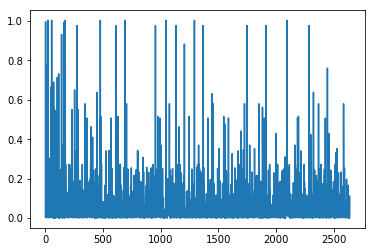

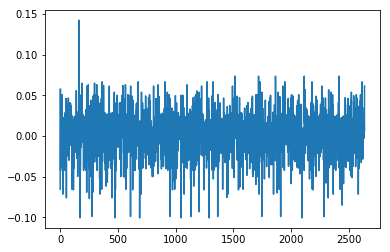

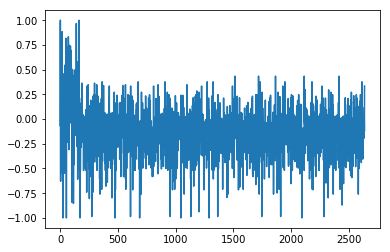

1.05018781227
[ 1.          0.11111111  0.44444444  0.77777778  0.11111111  0.33333333
  0.77777778  0.11111111  0.44444444  0.66666667  0.          0.11111111
  1.          0.11111111  0.44444444  0.66666667  0.11111111  0.88888889
  0.66666667  0.44444444  0.88888889  0.          1.          1.
  0.22222222  1.          0.77777778  0.22222222  0.11111111  0.88888889
  0.66666667  0.88888889  0.11111111  0.88888889  0.66666667  0.44444444
  1.          0.77777778  0.22222222  0.66666667  0.88888889  0.88888889
  0.66666667  0.88888889  0.66666667  0.11111111  0.44444444  0.77777778
  0.33333333  0.33333333  0.66666667  1.          0.66666667  1.
  0.77777778  0.44444444  0.66666667  0.          0.44444444]
Writing away results
1976-07-01 00:00:00


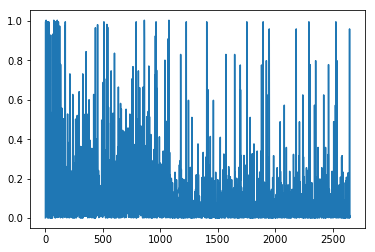

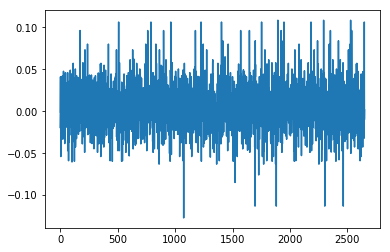

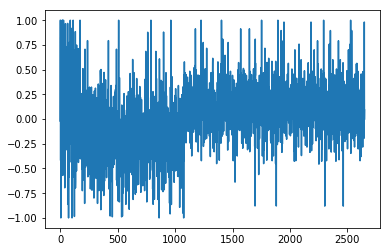

1.03163188023
[ 0.55555556  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.77777778  0.55555556  0.55555556  0.22222222  0.66666667
  0.88888889  0.44444444  0.88888889  0.22222222  0.55555556  0.55555556
  0.22222222  0.22222222  0.55555556  0.55555556  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.55555556
  0.77777778  0.88888889  0.88888889  0.88888889  0.77777778  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.33333333  0.55555556
  0.          0.88888889  0.22222222  0.33333333  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.11111111  0.55555556  0.22222222  0.33333333]
Writing away results
1976-08-01 00:00:00


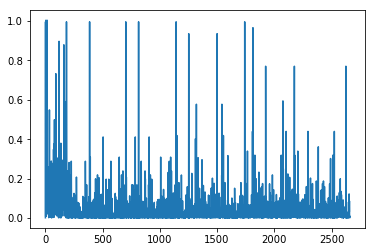

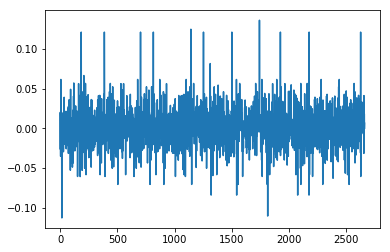

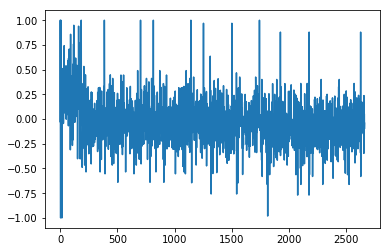

1.0157399307
[ 0.33333333  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.88888889  0.66666667  0.22222222  0.22222222  0.88888889  0.66666667
  0.33333333  0.55555556  0.22222222  0.88888889  0.66666667  0.33333333
  0.33333333  0.66666667  0.22222222  0.11111111  0.11111111  0.11111111
  0.55555556  0.11111111  0.33333333  0.33333333  0.66666667  0.22222222
  0.55555556  0.11111111  0.55555556  0.33333333  0.55555556  0.55555556
  0.88888889  0.55555556  0.33333333  0.33333333  0.66666667  0.33333333
  0.66666667  0.33333333  0.44444444  0.66666667  0.55555556  0.55555556
  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111  0.33333333
  0.44444444  0.22222222  0.22222222  0.33333333  0.66666667]
Writing away results
1976-09-01 00:00:00


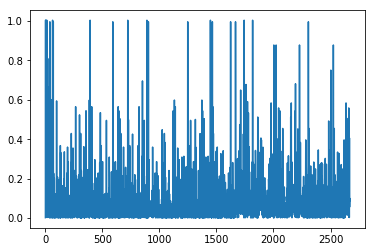

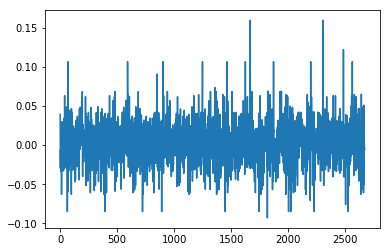

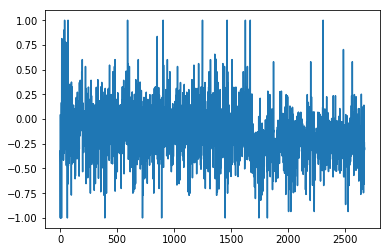

1.12666782595
[ 0.66666667  0.11111111  0.55555556  0.66666667  0.11111111  0.33333333
  1.          0.77777778  0.77777778  0.77777778  0.11111111  0.77777778
  0.66666667  0.11111111  0.77777778  0.11111111  0.11111111  1.          1.
  0.77777778  0.66666667  0.55555556  0.66666667  0.66666667  0.11111111
  0.11111111  1.          0.88888889  0.77777778  0.66666667  0.44444444
  0.66666667  0.77777778  0.55555556  0.11111111  0.44444444  0.66666667
  0.11111111  1.          0.11111111  0.77777778  0.66666667  0.11111111
  1.          0.          0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  1.          0.          0.77777778
  0.11111111  1.          0.66666667  0.77777778]
Writing away results
1976-10-01 00:00:00


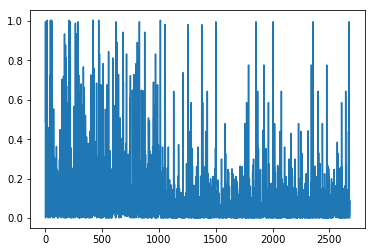

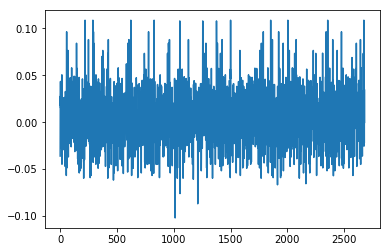

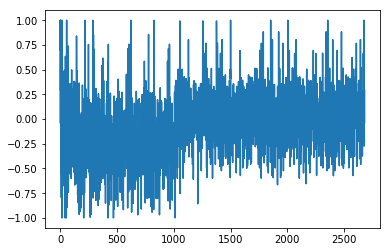

0.898735654519
[ 0.88888889  0.88888889  0.88888889  0.55555556  0.55555556  0.33333333
  0.22222222  0.22222222  0.44444444  0.88888889  0.55555556  0.66666667
  0.22222222  0.66666667  0.22222222  0.55555556  0.33333333  0.66666667
  0.77777778  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.33333333  0.22222222  0.77777778  0.88888889  0.44444444
  0.88888889  0.55555556  0.88888889  0.77777778  0.88888889  0.88888889
  0.          0.33333333  0.          0.77777778  0.77777778  0.
  0.33333333  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.44444444  0.88888889  0.11111111  0.66666667  0.22222222
  0.          0.11111111  0.          0.22222222  0.22222222]
Writing away results
1976-11-01 00:00:00


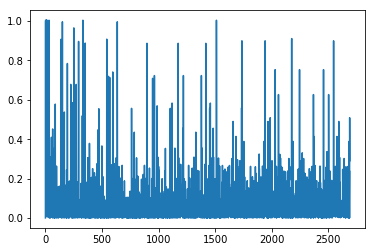

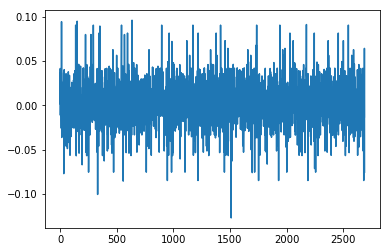

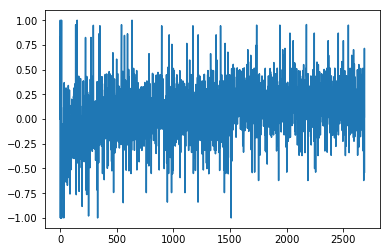

0.944378115771
[ 0.66666667  0.66666667  0.          0.          0.22222222  0.55555556
  0.55555556  0.66666667  0.66666667  0.          0.22222222  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.22222222  0.55555556  0.55555556  0.66666667  0.22222222  0.22222222
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.22222222  0.55555556  0.55555556
  0.22222222  0.11111111  0.55555556  0.55555556  0.55555556]
Writing away results
1976-12-01 00:00:00


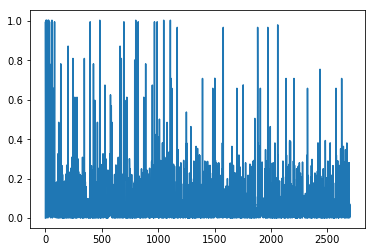

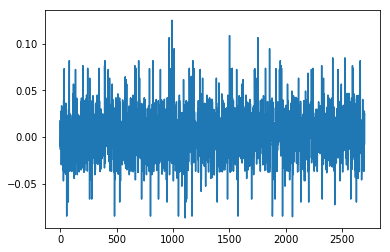

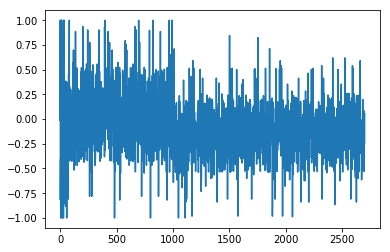

0.984078677703
[ 0.55555556  0.66666667  0.55555556  0.44444444  0.44444444  0.44444444
  0.55555556  0.11111111  0.66666667  0.77777778  0.44444444  0.44444444
  0.11111111  0.          0.44444444  0.44444444  1.          0.66666667
  0.66666667  0.77777778  0.77777778  0.66666667  0.22222222  0.44444444
  0.44444444  0.          0.11111111  0.55555556  0.11111111  0.
  0.77777778  0.11111111  0.55555556  0.77777778  0.44444444  0.44444444
  0.44444444  1.          0.11111111  0.44444444  0.44444444  0.44444444
  0.66666667  0.77777778  0.77777778  0.77777778  0.11111111  1.
  0.11111111  0.          0.44444444  0.44444444  0.44444444  0.
  0.11111111  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1977-01-01 00:00:00


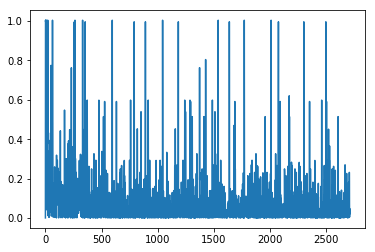

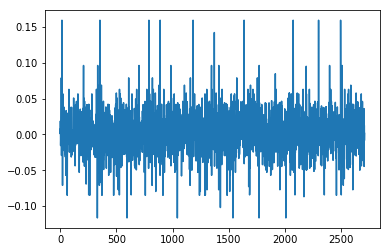

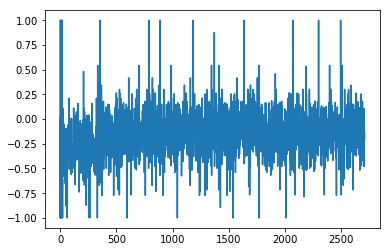

0.814776681633
[ 0.22222222  0.55555556  0.44444444  1.          0.22222222  0.
  0.66666667  0.33333333  0.44444444  0.22222222  0.          0.66666667
  0.33333333  0.88888889  0.          0.22222222  0.22222222  0.55555556
  0.44444444  0.66666667  0.33333333  0.55555556  0.88888889  0.22222222
  0.22222222  0.66666667  0.88888889  0.66666667  0.33333333  0.
  0.22222222  0.33333333  0.44444444  0.33333333  1.          0.
  0.33333333  0.44444444  1.          0.          0.66666667  0.33333333
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.33333333  0.44444444  0.          0.22222222  0.88888889  0.66666667
  0.33333333  0.44444444  1.          0.          0.66666667]
Writing away results
1977-02-01 00:00:00


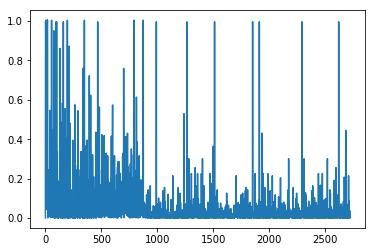

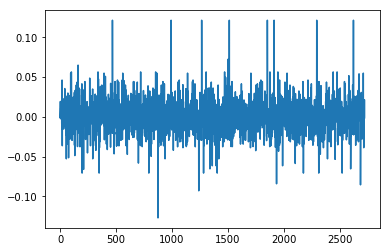

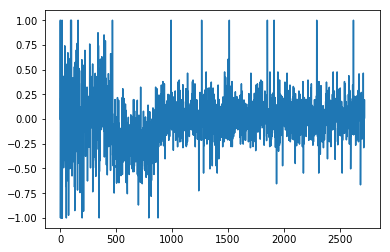

0.829325781101
[ 0.88888889  0.33333333  0.33333333  0.          0.22222222  0.44444444
  0.88888889  0.22222222  0.33333333  0.33333333  0.77777778  0.33333333
  0.33333333  0.33333333  0.          0.44444444  0.11111111  0.22222222
  0.22222222  0.44444444  0.33333333  0.33333333  0.33333333  0.
  0.55555556  0.22222222  0.22222222  0.44444444  0.22222222  0.55555556
  0.22222222  0.22222222  0.33333333  0.77777778  0.          0.
  0.11111111  0.33333333  0.33333333  0.55555556  0.44444444  0.22222222
  0.11111111  0.11111111  0.22222222  0.22222222  0.66666667  0.88888889
  0.33333333  0.          0.          0.44444444  0.55555556  0.33333333
  0.33333333  0.33333333  0.33333333  0.55555556  0.88888889]
Writing away results
1977-03-01 00:00:00


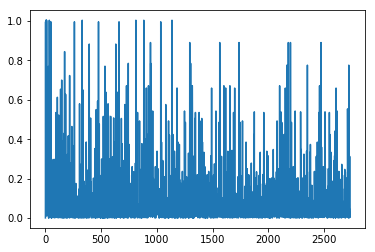

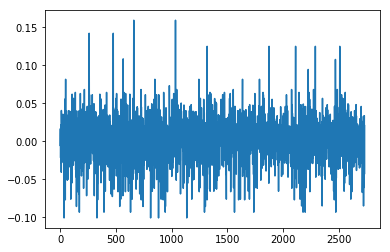

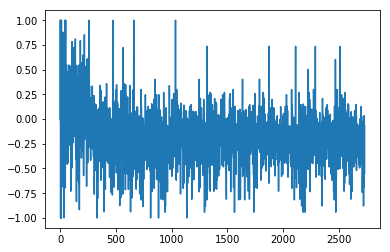

0.847859413887
[ 0.77777778  0.77777778  0.77777778  0.66666667  1.          0.66666667
  0.11111111  0.77777778  0.44444444  0.77777778  0.88888889  0.
  0.77777778  0.55555556  0.33333333  0.66666667  0.11111111  0.33333333
  0.33333333  0.22222222  0.44444444  0.77777778  0.55555556  0.66666667
  0.33333333  1.          0.88888889  0.11111111  0.33333333  0.66666667
  1.          0.          0.44444444  0.77777778  0.55555556  0.66666667
  0.88888889  0.11111111  0.77777778  0.66666667  0.66666667  0.66666667
  0.33333333  0.11111111  0.33333333  1.          0.22222222  0.77777778
  0.55555556  0.          0.22222222  0.77777778  0.          0.77777778
  0.77777778  0.77777778  0.55555556  0.66666667  0.66666667]
Writing away results
1977-04-01 00:00:00


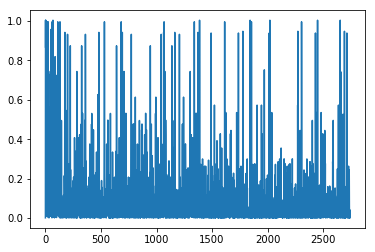

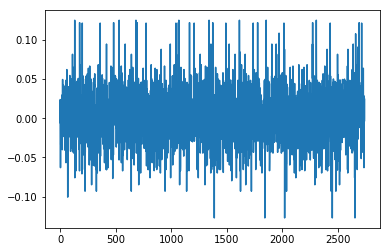

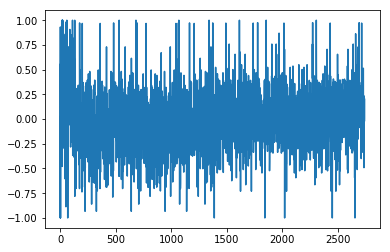

0.89262576518
[ 0.77777778  0.77777778  1.          1.          0.88888889  0.44444444
  0.77777778  0.77777778  0.77777778  0.77777778  0.33333333  0.77777778
  1.          1.          1.          1.          1.          1.          0.
  0.77777778  0.77777778  0.77777778  1.          1.          1.
  0.88888889  1.          1.          1.          1.          0.77777778
  0.33333333  0.77777778  0.77777778  1.          0.77777778  0.33333333
  0.11111111  1.          1.          1.          1.          0.66666667
  1.          1.          0.66666667  0.          0.77777778  0.77777778
  0.66666667  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778
  1.          1.          1.          0.77777778]
Writing away results
1977-05-01 00:00:00


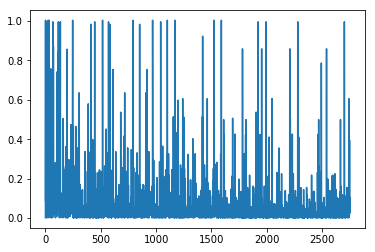

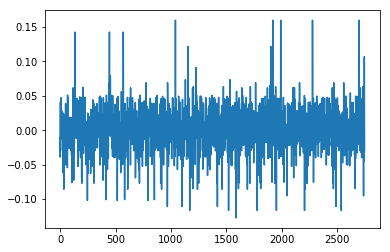

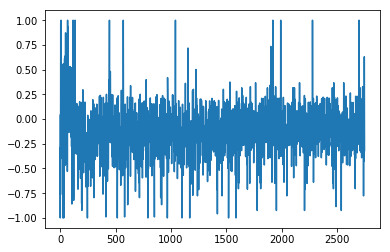

0.838759548782
[ 0.88888889  0.11111111  0.44444444  0.33333333  0.55555556  0.88888889
  0.33333333  0.55555556  0.33333333  0.33333333  0.55555556  0.22222222
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.33333333
  0.33333333  0.55555556  0.11111111  0.44444444  0.11111111  0.
  0.33333333  0.          0.          0.77777778  0.77777778  0.33333333
  0.55555556  0.55555556  0.11111111  0.77777778  0.33333333  1.
  0.88888889  0.11111111  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.33333333  0.55555556  1.          0.44444444
  0.33333333  0.55555556  0.88888889  1.          1.          1.
  0.22222222  0.44444444  0.33333333  1.          0.88888889]
Writing away results
1977-06-01 00:00:00


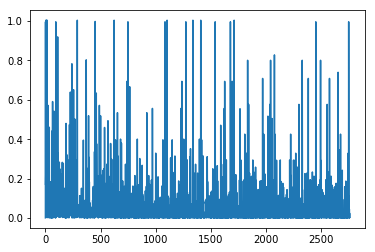

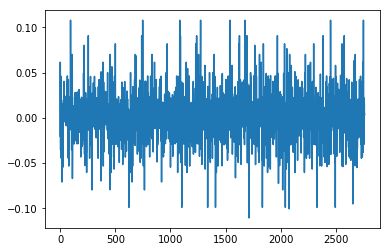

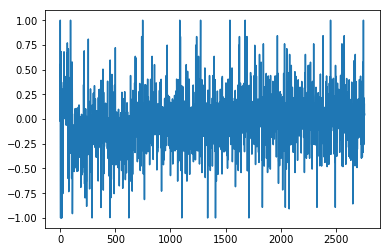

0.912813015902
[ 0.33333333  0.22222222  0.44444444  1.          0.55555556  0.11111111
  0.11111111  0.          0.55555556  0.11111111  0.33333333  0.22222222
  0.22222222  0.88888889  0.22222222  0.22222222  1.          0.55555556
  0.11111111  0.66666667  0.22222222  0.44444444  0.22222222  0.44444444
  0.88888889  0.33333333  0.44444444  0.22222222  0.          0.55555556
  0.77777778  0.77777778  1.          0.          0.88888889  0.33333333
  0.33333333  0.22222222  0.22222222  0.22222222  1.          0.77777778
  0.22222222  0.44444444  1.          0.11111111  0.          0.77777778
  1.          0.11111111  0.55555556  0.55555556  0.55555556  0.33333333
  0.44444444  0.55555556  0.55555556  0.55555556  0.11111111]
Writing away results
1977-07-01 00:00:00


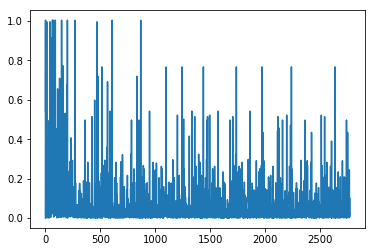

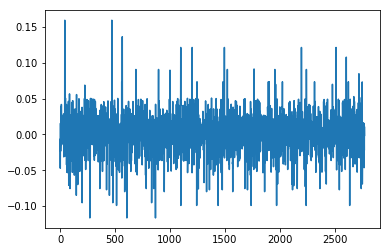

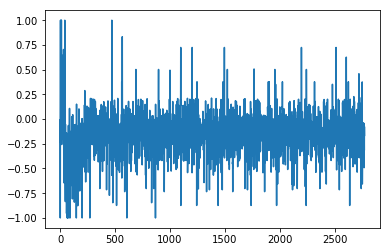

0.849888887469
[ 0.55555556  0.88888889  0.44444444  0.55555556  0.          0.55555556
  0.22222222  0.66666667  0.33333333  0.11111111  0.11111111  0.44444444
  0.77777778  0.77777778  0.11111111  0.55555556  0.66666667  0.55555556
  0.11111111  0.55555556  0.33333333  0.77777778  0.11111111  0.77777778
  0.77777778  0.          0.77777778  1.          0.44444444  0.55555556
  0.11111111  1.          1.          0.44444444  0.77777778  0.11111111
  0.          0.44444444  0.66666667  1.          0.33333333  0.77777778
  0.66666667  0.33333333  0.11111111  0.22222222  0.11111111  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.88888889
  0.          0.55555556  0.66666667  0.          0.22222222]
Writing away results
1977-08-01 00:00:00


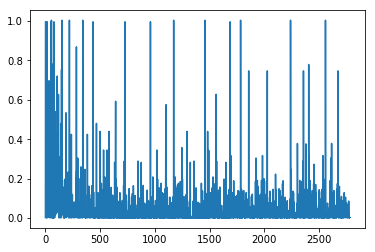

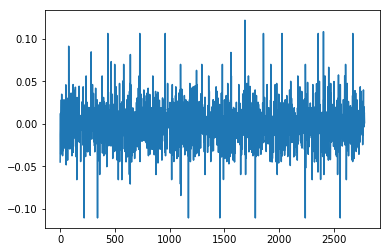

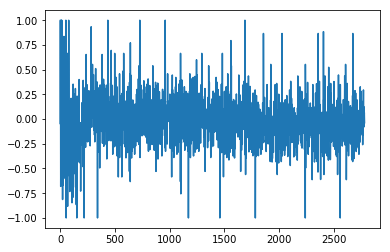

0.837536129184
[ 0.77777778  0.22222222  0.33333333  0.77777778  0.33333333  0.33333333
  0.33333333  0.33333333  0.55555556  0.          0.88888889  0.          0.
  0.          0.33333333  0.33333333  0.33333333  0.77777778  0.88888889
  0.          0.          0.77777778  0.          0.          0.
  0.88888889  0.33333333  0.33333333  0.33333333  0.11111111  0.66666667
  0.33333333  0.77777778  0.          0.          0.          0.
  0.88888889  0.22222222  0.          0.88888889  1.          0.22222222
  0.77777778  0.33333333  0.77777778  0.22222222  0.33333333  0.33333333
  0.33333333  0.77777778  0.55555556  0.          0.          0.33333333
  0.33333333  0.77777778  0.77777778  0.33333333]
Writing away results
1977-09-01 00:00:00


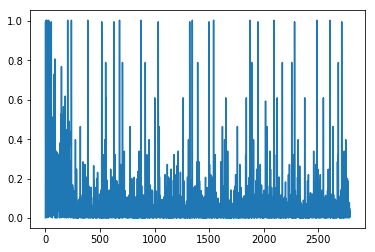

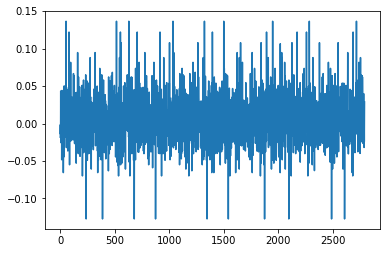

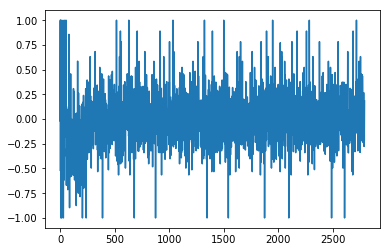

1.01192296839
[ 0.33333333  0.11111111  0.44444444  0.77777778  0.11111111  0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  0.11111111  0.44444444  0.44444444  0.44444444  1.          1.          1.
  0.11111111  1.          1.          1.          1.          0.11111111
  0.44444444  0.77777778  0.77777778  1.          0.22222222  0.44444444
  0.55555556  1.          1.          1.          1.          0.77777778
  1.          1.          0.11111111  0.22222222  0.44444444  0.11111111
  0.22222222  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444
  0.55555556  1.          1.          0.44444444  0.44444444  0.44444444
  0.66666667  0.11111111  0.44444444]
Writing away results
1977-10-01 00:00:00


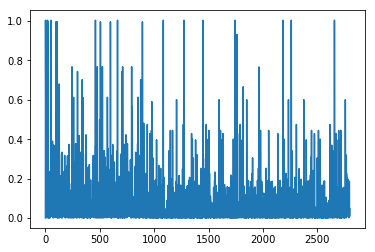

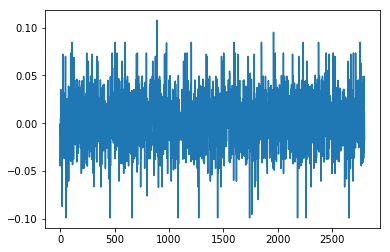

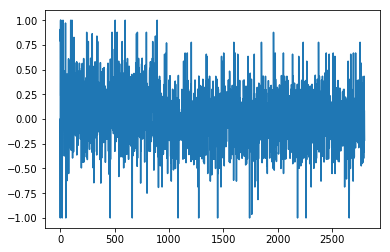

1.07002060456
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444
  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778  0.11111111
  0.          0.33333333  0.44444444  0.44444444  0.11111111  0.66666667
  0.77777778  0.22222222  0.77777778  0.11111111  0.77777778  0.77777778
  0.44444444  0.33333333  0.44444444  0.44444444  0.          0.44444444
  0.33333333  0.55555556  0.11111111  0.77777778  0.77777778  0.77777778
  0.88888889  0.33333333  0.77777778  0.66666667  0.33333333  0.44444444
  0.44444444  1.          0.55555556  0.44444444  0.44444444  0.44444444
  0.33333333  0.55555556  0.11111111  0.77777778  0.33333333  0.44444444
  0.33333333  0.44444444  0.44444444  0.33333333  0.77777778]
Writing away results
1977-11-01 00:00:00


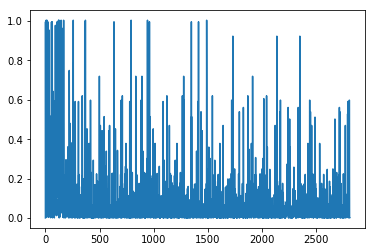

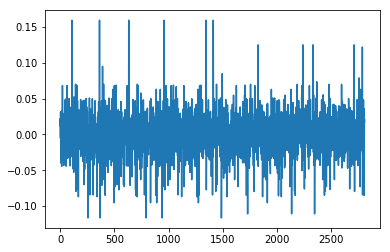

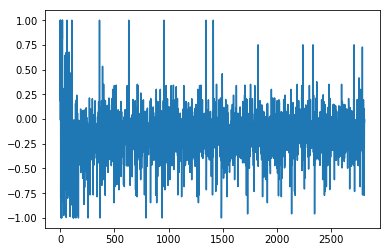

1.27365073006
[ 0.77777778  0.66666667  0.          0.77777778  0.77777778  0.22222222
  0.66666667  0.11111111  0.33333333  0.66666667  1.          0.11111111
  0.77777778  0.22222222  0.77777778  0.66666667  0.77777778  0.66666667
  0.          0.44444444  0.66666667  0.44444444  0.66666667  1.
  0.88888889  1.          0.77777778  0.11111111  0.          0.88888889
  0.22222222  0.44444444  0.44444444  0.66666667  0.88888889  1.
  0.33333333  0.66666667  1.          0.33333333  0.44444444  1.
  0.88888889  0.66666667  0.77777778  0.          0.77777778  0.77777778
  0.66666667  0.22222222  0.44444444  0.          0.77777778  0.77777778
  1.          0.77777778  0.44444444  0.22222222  0.66666667]
Writing away results
1977-12-01 00:00:00


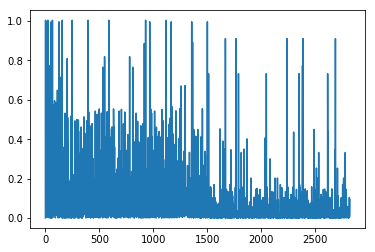

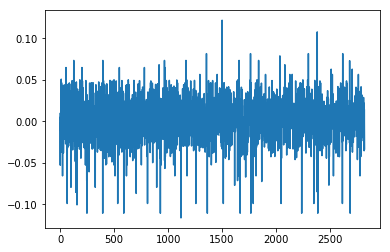

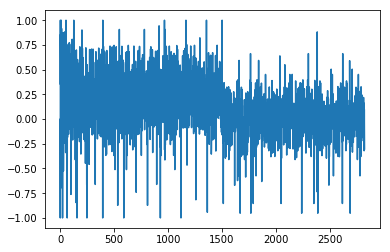

1.08863275959
[ 1.          0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.11111111
  0.22222222  0.11111111  0.77777778  0.66666667  0.66666667  0.33333333
  0.66666667  0.          0.66666667  0.66666667  0.11111111  0.11111111
  0.22222222  0.11111111  0.66666667  0.11111111  0.11111111  1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.55555556  0.33333333  0.11111111  0.22222222  0.11111111  0.11111111
  0.77777778  0.11111111  0.11111111  0.11111111  0.11111111  0.77777778
  0.33333333  0.66666667  0.11111111  0.11111111  0.22222222  0.22222222
  0.11111111  1.          0.66666667  0.66666667  0.66666667]
Writing away results
1978-01-01 00:00:00


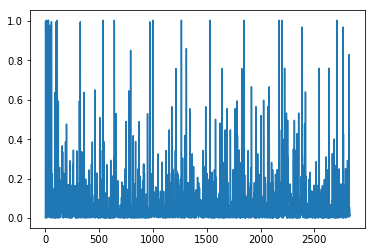

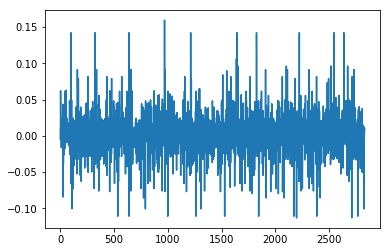

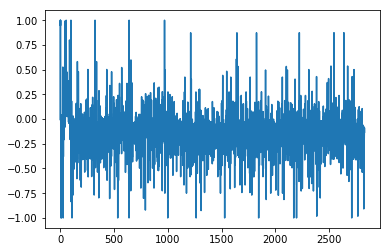

1.3536052114
[ 0.66666667  0.88888889  0.          0.77777778  0.66666667  0.66666667
  0.77777778  0.22222222  0.66666667  0.88888889  0.77777778  0.
  0.77777778  0.66666667  0.77777778  0.55555556  0.66666667  0.77777778
  0.55555556  0.77777778  0.22222222  0.          0.77777778  1.
  0.11111111  0.          0.88888889  0.77777778  1.          0.66666667
  0.33333333  0.33333333  0.33333333  0.          0.11111111  0.22222222
  0.66666667  0.88888889  0.77777778  0.11111111  0.77777778  0.
  0.11111111  0.          0.          0.77777778  0.66666667  0.66666667
  0.33333333  0.          0.11111111  0.77777778  0.66666667  0.11111111
  0.88888889  0.77777778  0.66666667  0.77777778  0.66666667]
Writing away results
1978-02-01 00:00:00


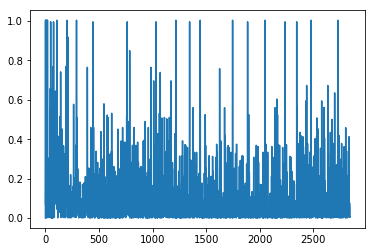

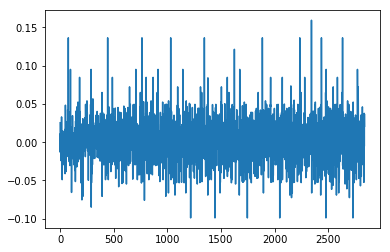

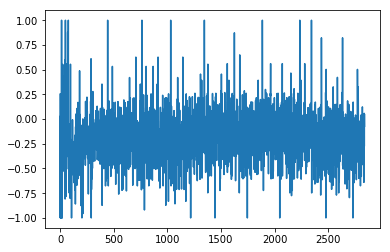

1.09559766009
[ 0.22222222  0.44444444  0.33333333  0.77777778  0.77777778  0.77777778
  0.          1.          0.22222222  0.44444444  0.66666667  0.44444444
  0.55555556  0.77777778  0.55555556  1.          0.77777778  0.55555556
  0.          0.55555556  0.66666667  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.77777778  0.77777778
  0.55555556  0.77777778  0.55555556  0.33333333  1.          0.66666667
  0.22222222  0.44444444  0.66666667  0.44444444  0.55555556  0.66666667
  0.66666667  0.66666667  0.11111111  0.77777778  0.66666667  0.77777778
  0.88888889  0.66666667  0.44444444  1.          0.66666667  0.22222222
  0.          0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1978-03-01 00:00:00


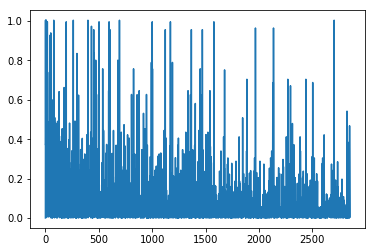

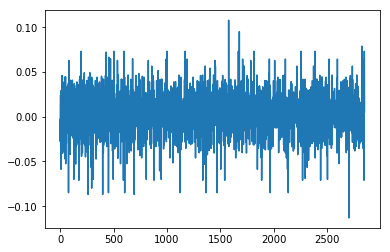

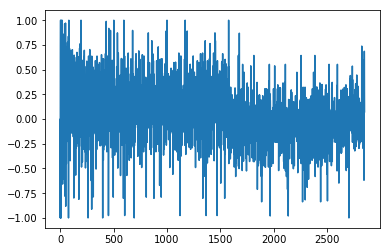

1.15612011628
[ 0.11111111  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.11111111  0.11111111  0.22222222  0.66666667
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.11111111  0.11111111  0.33333333  0.66666667
  0.11111111  0.11111111  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.44444444  0.33333333  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  1.          0.11111111  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1978-04-01 00:00:00


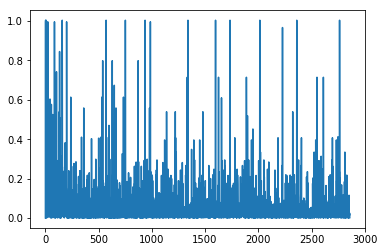

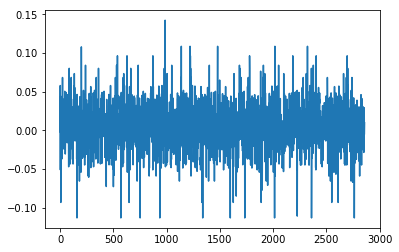

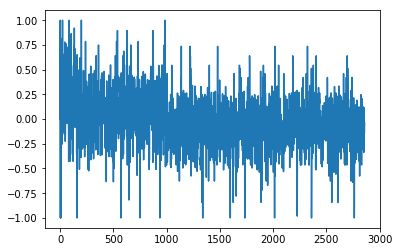

1.43401503133
[ 0.11111111  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.77777778  0.77777778  0.11111111  0.88888889  0.88888889
  0.88888889  0.33333333  0.88888889  0.55555556  0.88888889  0.88888889
  0.          0.77777778  0.77777778  0.11111111  0.88888889  0.
  0.77777778  0.77777778  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  1.          0.77777778  0.77777778
  0.          0.66666667  0.22222222  0.          0.          0.
  0.77777778  0.33333333  0.33333333  0.88888889  0.77777778  0.77777778
  0.77777778  0.33333333  0.          0.77777778  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1978-05-01 00:00:00


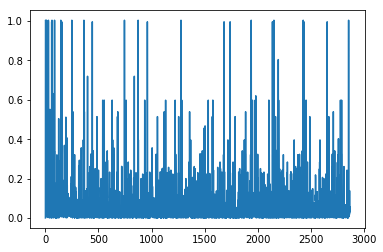

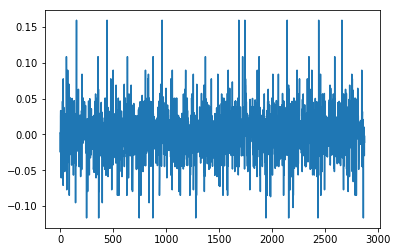

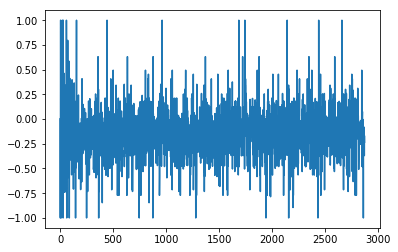

1.18829255627
[ 0.88888889  0.88888889  0.33333333  0.88888889  0.88888889  0.44444444
  1.          0.11111111  0.77777778  0.44444444  0.22222222  0.44444444
  0.88888889  0.33333333  0.          0.77777778  0.44444444  0.11111111
  1.          1.          0.77777778  0.77777778  0.55555556  1.
  0.66666667  0.          0.22222222  0.44444444  0.88888889  1.
  0.77777778  0.88888889  1.          1.          0.77777778  0.11111111
  0.88888889  0.66666667  0.11111111  0.55555556  0.55555556  1.
  0.66666667  0.11111111  0.44444444  1.          1.          0.55555556
  0.55555556  0.11111111  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.22222222]
Writing away results
1978-06-01 00:00:00


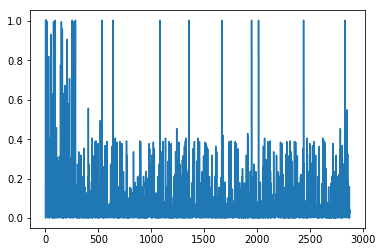

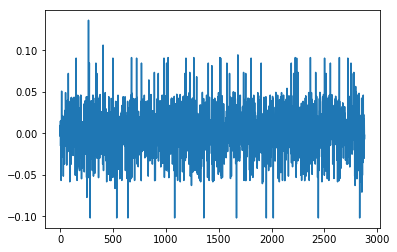

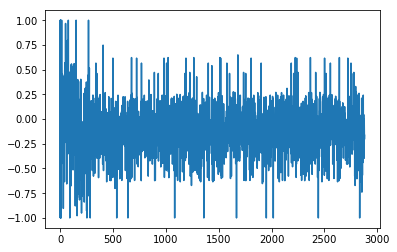

1.27423330968
[ 0.          0.77777778  1.          0.33333333  0.66666667  0.55555556
  0.55555556  0.11111111  0.22222222  0.44444444  0.22222222  0.66666667
  0.77777778  0.44444444  0.44444444  0.22222222  0.66666667  0.
  0.88888889  0.44444444  0.22222222  0.66666667  0.          0.88888889
  0.44444444  0.77777778  0.77777778  0.          0.          1.
  0.22222222  0.66666667  0.88888889  0.11111111  0.11111111  0.
  0.22222222  0.11111111  0.11111111  0.11111111  0.55555556  1.
  0.44444444  0.77777778  0.11111111  0.11111111  0.55555556  0.66666667
  0.66666667  0.55555556  1.          0.44444444  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1978-07-01 00:00:00


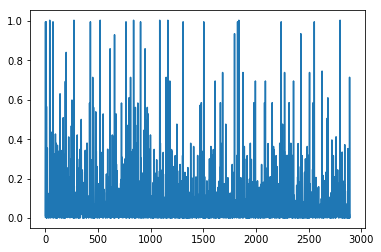

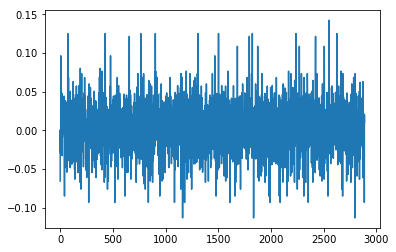

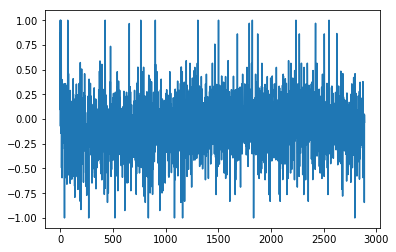

1.3143185771
[ 0.88888889  0.88888889  0.55555556  1.          0.77777778  0.77777778
  0.11111111  0.66666667  0.88888889  0.33333333  0.11111111  0.66666667
  0.22222222  0.88888889  0.22222222  0.11111111  0.77777778  0.77777778
  0.11111111  0.22222222  0.77777778  0.77777778  0.44444444  0.88888889
  0.88888889  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.77777778  0.77777778  0.11111111  0.77777778  0.
  0.77777778  0.77777778  0.77777778  0.77777778  0.44444444  0.66666667
  0.88888889  0.77777778  0.77777778  0.77777778  0.11111111  1.
  0.77777778  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667]
Writing away results
1978-08-01 00:00:00


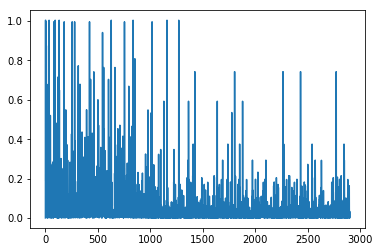

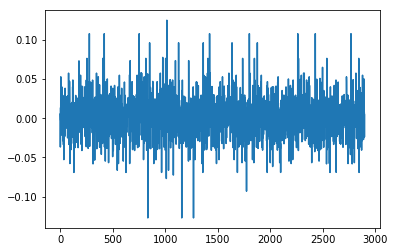

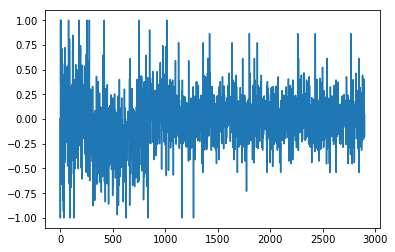

0.903204868193
[ 0.44444444  0.44444444  0.          0.66666667  0.33333333  0.33333333
  0.77777778  0.44444444  0.44444444  0.55555556  0.44444444  0.11111111
  0.44444444  0.44444444  0.          0.66666667  0.33333333  1.          1.
  0.66666667  0.55555556  0.11111111  0.11111111  0.44444444  0.44444444
  0.44444444  0.          1.          0.77777778  0.77777778  0.
  0.33333333  0.33333333  0.66666667  0.          0.66666667  0.
  0.66666667  0.66666667  0.11111111  0.11111111  0.44444444  0.
  0.66666667  0.33333333  0.33333333  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1978-09-01 00:00:00


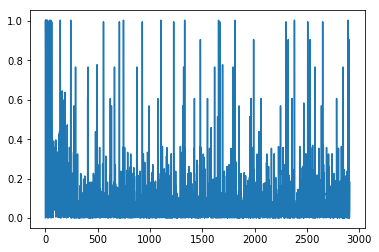

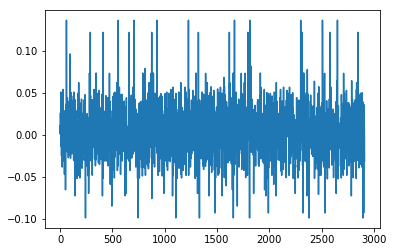

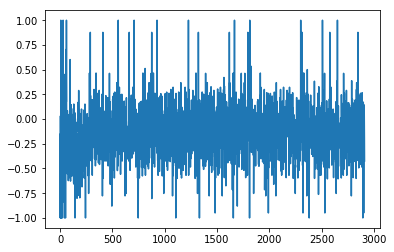

1.15140931111
[ 1.          0.44444444  0.66666667  0.          1.          0.77777778
  1.          0.77777778  1.          0.66666667  0.77777778  1.
  0.77777778  0.33333333  0.66666667  0.          1.          0.44444444
  0.22222222  0.66666667  0.          1.          0.44444444  0.44444444
  0.88888889  0.77777778  0.88888889  0.77777778  0.44444444  0.          0.
  0.33333333  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  1.          0.44444444  0.66666667  0.22222222
  0.22222222  0.44444444  0.44444444  0.22222222  0.          0.77777778
  0.11111111  0.11111111  1.          0.44444444  0.11111111  0.44444444
  1.          0.44444444  1.          0.77777778]
Writing away results
1978-10-01 00:00:00


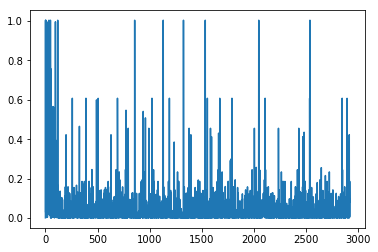

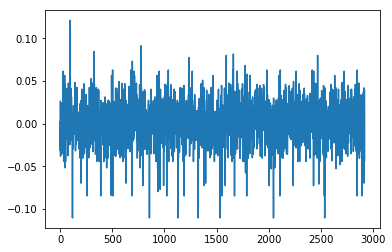

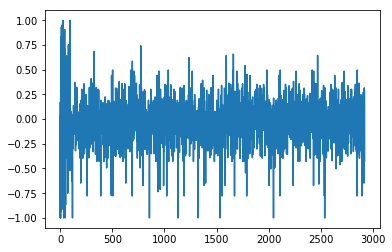

1.26743693734
[ 0.44444444  0.88888889  0.11111111  0.11111111  0.22222222  0.33333333
  0.66666667  0.22222222  0.66666667  1.          0.22222222  0.22222222
  0.11111111  0.33333333  0.          0.33333333  0.66666667  0.44444444
  0.88888889  0.          1.          0.66666667  0.66666667  0.22222222
  0.22222222  0.33333333  0.22222222  0.22222222  0.55555556  0.11111111
  1.          0.33333333  0.55555556  0.11111111  0.11111111  0.11111111
  0.          0.          1.          0.66666667  0.55555556  0.11111111
  0.11111111  1.          0.11111111  0.44444444  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.44444444]
Writing away results
1978-11-01 00:00:00


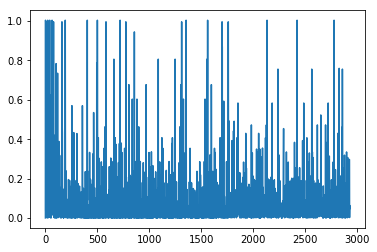

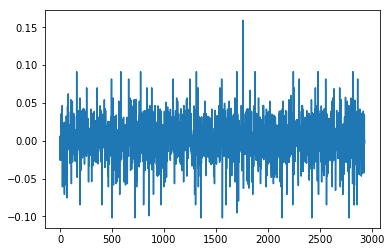

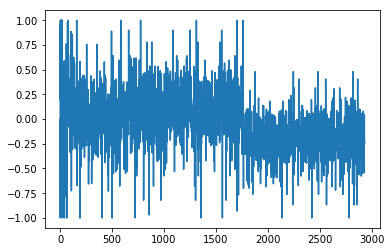

1.30413459604
[ 0.33333333  0.          0.22222222  0.66666667  0.11111111  0.55555556
  0.66666667  0.11111111  0.55555556  0.66666667  0.55555556  0.22222222
  0.44444444  0.          0.22222222  0.55555556  0.22222222  0.          0.
  0.66666667  0.66666667  0.66666667  0.11111111  0.55555556  0.55555556
  0.55555556  1.          0.44444444  0.          0.22222222  0.22222222
  0.55555556  0.22222222  0.22222222  0.22222222  0.          0.88888889
  0.66666667  0.11111111  0.33333333  0.22222222  0.          0.22222222
  0.22222222  0.44444444  0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.22222222  0.55555556]
Writing away results
1978-12-01 00:00:00


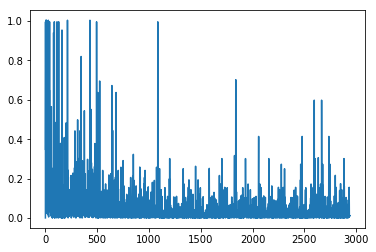

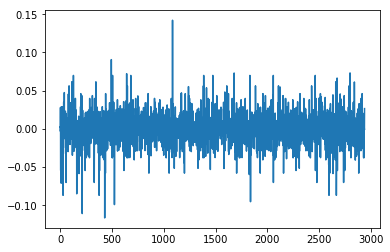

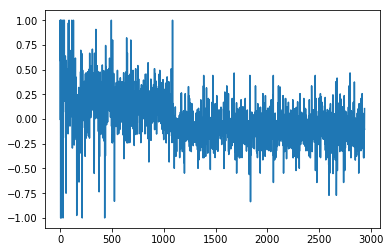

1.18030450206
[ 0.33333333  0.11111111  0.22222222  0.22222222  0.22222222  1.
  0.22222222  0.22222222  0.22222222  0.22222222  1.          0.33333333
  0.          1.          0.22222222  1.          1.          0.33333333
  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889  0.22222222
  0.22222222  1.          0.33333333  0.          0.33333333  0.33333333
  0.88888889  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222
  0.22222222  0.22222222  0.88888889  0.33333333  0.33333333  0.11111111
  1.          0.77777778  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.55555556  0.33333333]
Writing away results
1979-01-01 00:00:00


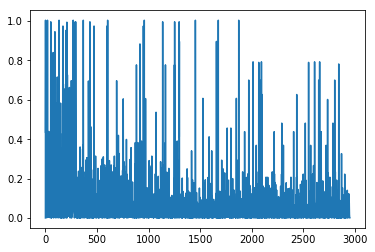

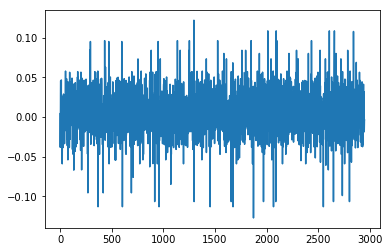

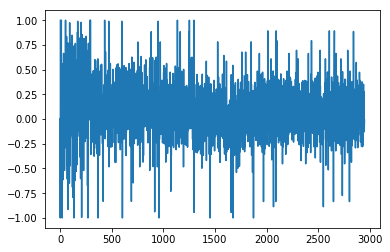

1.26066372356
[ 0.55555556  0.44444444  0.88888889  0.88888889  0.33333333  0.88888889
  0.88888889  0.88888889  0.88888889  0.33333333  0.88888889  0.
  0.88888889  0.88888889  0.33333333  1.          0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.          0.55555556  0.33333333  0.88888889  0.
  0.33333333  0.33333333  0.33333333  0.55555556  0.44444444  0.77777778
  0.88888889  0.22222222  0.33333333  0.55555556  0.33333333  0.33333333
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.          0.33333333  0.88888889]
Writing away results
1979-02-01 00:00:00


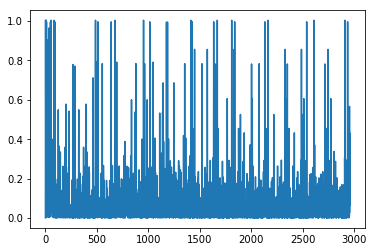

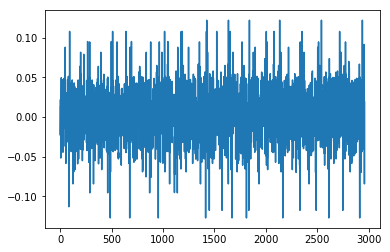

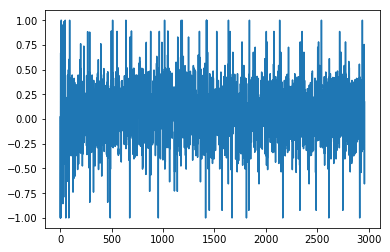

1.38582785642
[ 1.          1.          1.          0.          1.          1.          1.
  1.          0.66666667  0.33333333  0.66666667  0.88888889  1.
  0.66666667  0.44444444  0.88888889  1.          1.          1.          1.
  0.66666667  0.88888889  0.66666667  0.44444444  1.          0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.77777778  1.          1.          0.66666667  0.44444444
  0.44444444  0.66666667  0.44444444  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.66666667  0.66666667  1.          1.        ]
Writing away results
1979-03-01 00:00:00


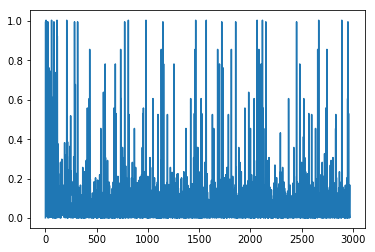

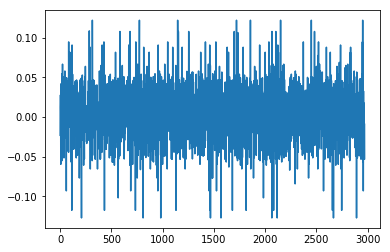

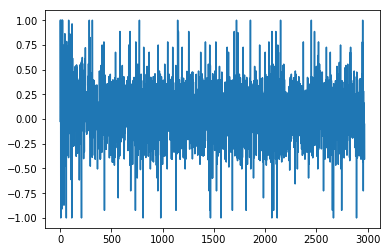

1.14296149319
[ 1.          1.          0.11111111  1.          1.          1.          1.
  0.55555556  0.55555556  0.77777778  0.          1.          0.55555556
  0.55555556  1.          1.          1.          1.          1.
  0.44444444  1.          1.          0.11111111  0.55555556  0.55555556
  0.77777778  0.          0.44444444  0.55555556  0.55555556  0.55555556
  0.55555556  1.          1.          1.          0.55555556  0.55555556
  0.55555556  0.77777778  0.55555556  0.55555556  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.55555556  0.55555556  0.77777778  1.          1.
  0.88888889]
Writing away results
1979-04-01 00:00:00


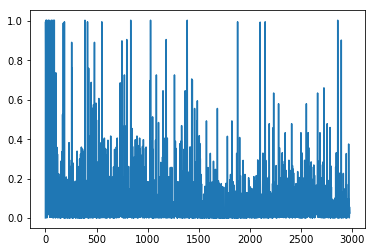

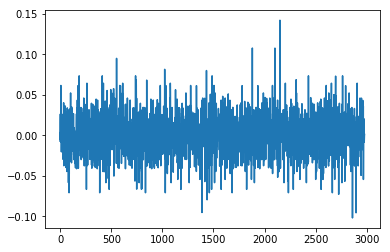

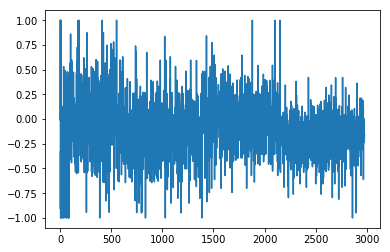

1.09644037104
[ 0.55555556  0.33333333  0.55555556  0.55555556  0.11111111  0.22222222
  0.44444444  0.66666667  0.88888889  0.44444444  0.          0.44444444
  0.66666667  0.88888889  0.11111111  0.11111111  0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.88888889  0.66666667
  0.44444444  0.22222222  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.11111111  0.66666667  0.88888889  0.44444444
  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667  0.55555556
  0.11111111  0.55555556  0.11111111  0.55555556  0.55555556  0.11111111
  0.55555556  0.55555556  0.22222222  0.22222222  0.44444444  0.88888889
  0.44444444  0.66666667  0.55555556  0.44444444  0.44444444]
Writing away results
1979-05-01 00:00:00


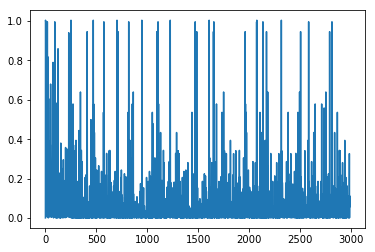

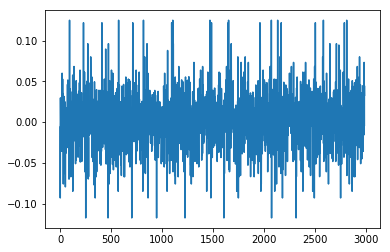

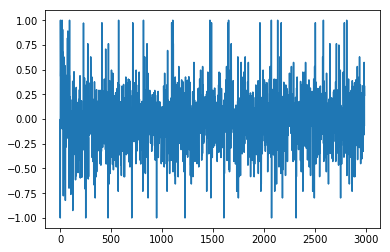

1.31835607347
[ 1.          0.66666667  0.          0.          1.          0.11111111
  0.66666667  0.77777778  0.22222222  0.          0.11111111  0.77777778
  0.77777778  0.44444444  0.          0.          0.88888889  0.88888889
  0.22222222  1.          0.77777778  0.77777778  0.44444444  0.11111111
  0.22222222  0.88888889  0.77777778  0.11111111  0.77777778  0.77777778
  0.66666667  1.          0.88888889  0.88888889  0.77777778  0.66666667
  0.44444444  0.11111111  0.77777778  0.66666667  1.          0.88888889
  0.          0.88888889  0.88888889  0.          0.88888889  0.
  0.88888889  0.88888889  0.88888889  0.77777778  0.66666667  0.77777778
  0.66666667  0.          0.44444444  0.77777778  0.77777778]
Writing away results
1979-06-01 00:00:00


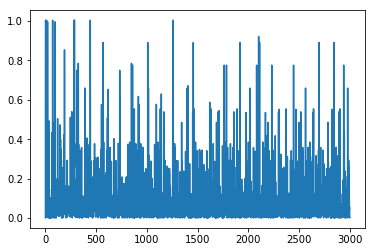

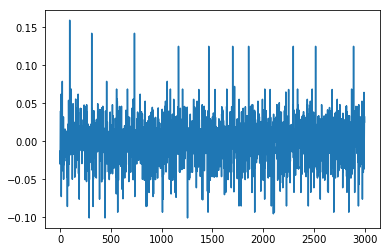

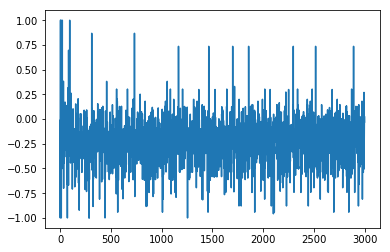

1.09956065374
[ 0.33333333  0.          0.66666667  0.22222222  0.77777778  0.88888889
  0.77777778  0.55555556  0.44444444  0.77777778  0.88888889  0.77777778
  0.11111111  0.66666667  0.66666667  0.22222222  0.88888889  0.66666667
  0.22222222  0.55555556  0.77777778  0.88888889  0.77777778  0.11111111
  0.77777778  0.77777778  0.77777778  0.77777778  0.88888889  0.11111111
  0.          0.33333333  0.77777778  0.77777778  0.11111111  0.77777778
  0.55555556  0.88888889  0.66666667  0.          0.66666667  0.
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.55555556  0.88888889  0.77777778  0.66666667
  0.          0.11111111  0.77777778  0.77777778  0.77777778]
Writing away results
1979-07-01 00:00:00


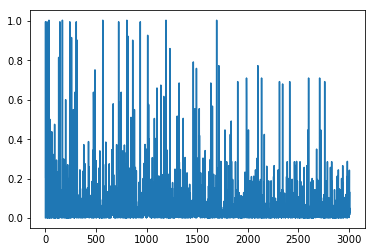

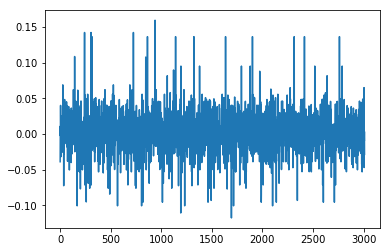

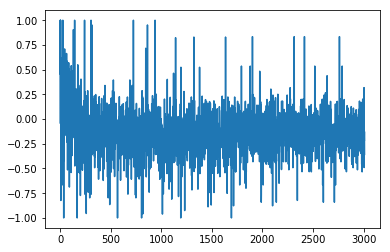

1.13486850218
[ 0.33333333  0.66666667  0.33333333  0.88888889  0.88888889  0.22222222
  0.66666667  0.66666667  0.22222222  0.11111111  0.          0.
  0.55555556  0.66666667  0.88888889  0.88888889  0.33333333  0.22222222
  0.88888889  0.44444444  0.33333333  0.22222222  1.          0.11111111
  0.66666667  0.22222222  0.88888889  0.11111111  0.          0.
  0.55555556  0.11111111  0.88888889  0.11111111  0.22222222  0.66666667
  0.11111111  1.          0.77777778  1.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.77777778  1.
  0.11111111  0.88888889  0.11111111  0.22222222  0.          0.11111111
  0.22222222  0.11111111  0.66666667  0.22222222  0.22222222]
Writing away results
1979-08-01 00:00:00


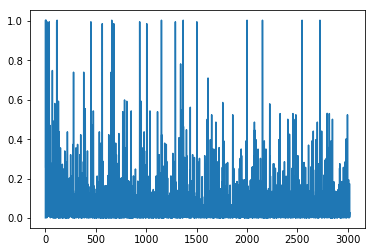

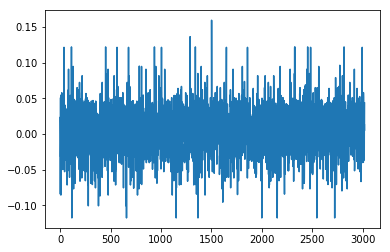

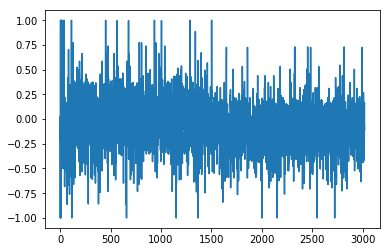

1.08724735793
[ 0.88888889  1.          0.33333333  0.55555556  0.55555556  0.88888889
  0.33333333  0.33333333  0.55555556  0.55555556  0.88888889  1.          1.
  1.          0.          1.          1.          0.          0.55555556
  0.66666667  0.88888889  0.88888889  0.55555556  0.88888889  0.33333333
  0.33333333  0.55555556  0.66666667  0.88888889  0.77777778  0.55555556
  0.44444444  0.66666667  0.88888889  0.88888889  0.55555556  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.55555556  0.88888889  0.55555556
  0.88888889  0.88888889  0.55555556  0.88888889  0.55555556  0.33333333
  0.55555556  0.33333333  0.33333333]
Writing away results
1979-09-01 00:00:00


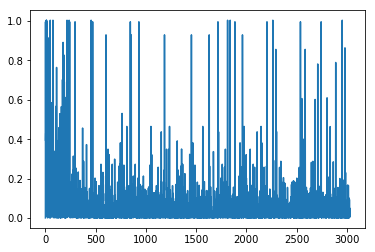

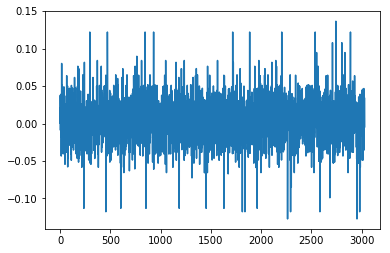

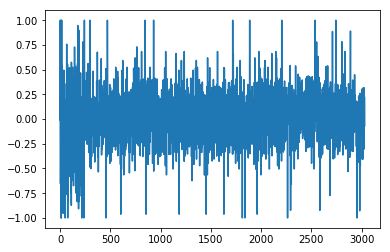

1.21266921706
[ 1.          0.44444444  0.66666667  0.11111111  0.55555556  1.
  0.44444444  0.66666667  0.88888889  0.66666667  1.          1.          1.
  0.22222222  0.22222222  0.88888889  0.55555556  0.77777778  0.11111111
  0.11111111  0.22222222  0.88888889  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.22222222  1.          0.88888889  0.11111111
  0.11111111  0.33333333  0.55555556  0.88888889  0.66666667  0.88888889
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.55555556  0.88888889  0.11111111
  0.66666667  0.88888889  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111]
Writing away results
1979-10-01 00:00:00


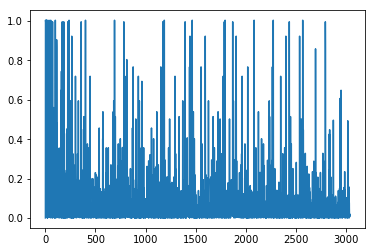

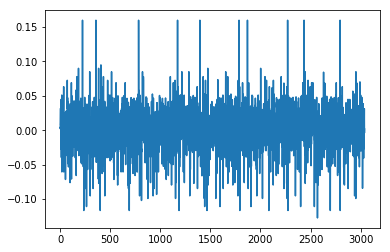

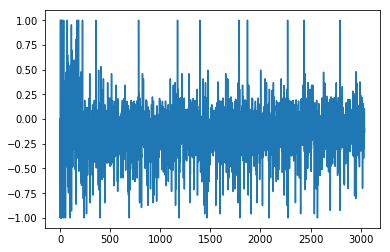

1.1875353224
[ 0.          1.          1.          0.66666667  0.44444444  0.33333333
  1.          1.          0.66666667  0.66666667  0.77777778  0.55555556
  0.44444444  0.55555556  0.55555556  0.44444444  0.77777778  1.          0.
  0.33333333  0.44444444  0.88888889  1.          1.          1.          1.
  0.66666667  0.77777778  0.22222222  0.88888889  1.          0.
  0.88888889  1.          0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.77777778  0.55555556  0.11111111  0.55555556  0.44444444
  0.55555556  0.44444444  0.88888889  1.          0.          0.77777778
  0.77777778  0.33333333  0.88888889  0.88888889  1.          0.          1.
  1.          0.11111111]
Writing away results
1979-11-01 00:00:00


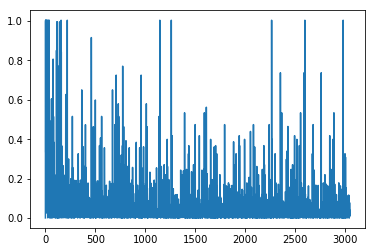

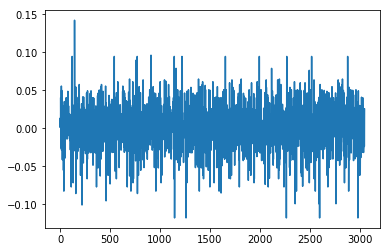

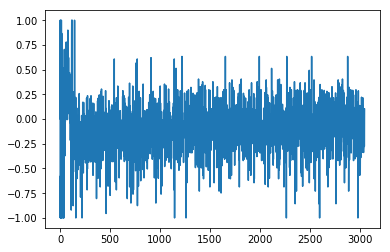

0.975691767708
[ 0.66666667  0.          0.44444444  1.          0.11111111  0.11111111
  0.          0.44444444  0.44444444  1.          1.          1.          1.
  1.          0.44444444  0.11111111  0.66666667  0.          0.66666667
  0.11111111  0.          0.11111111  0.11111111  0.11111111  0.
  0.44444444  0.44444444  0.11111111  0.          0.88888889  0.
  0.44444444  0.11111111  0.44444444  0.22222222  0.44444444  0.22222222
  0.44444444  0.44444444  0.22222222  0.44444444  0.22222222  1.
  0.44444444  1.          0.66666667  0.11111111  0.          0.44444444
  0.77777778  0.44444444  0.11111111  0.88888889  0.          0.33333333
  0.66666667  0.11111111  0.44444444  0.22222222]
Writing away results
1979-12-01 00:00:00


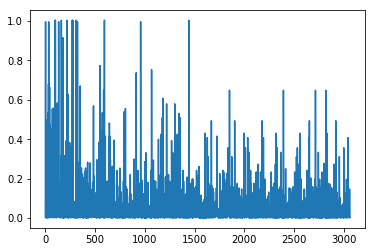

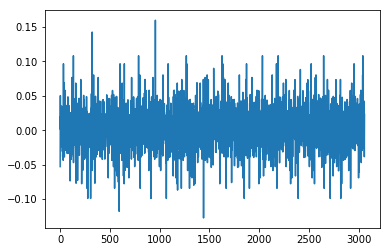

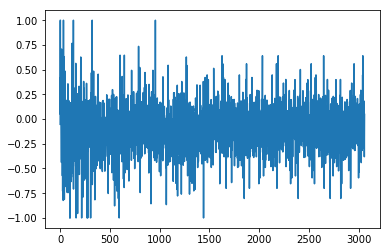

1.15547366137
[ 0.66666667  1.          0.77777778  0.66666667  0.88888889  0.77777778
  0.55555556  0.88888889  0.11111111  0.11111111  0.77777778  0.44444444
  0.77777778  0.22222222  0.66666667  0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.55555556  0.88888889  0.66666667  0.66666667  0.66666667  0.77777778
  0.33333333  0.66666667  0.88888889  0.55555556  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556
  0.11111111  0.          0.44444444  0.66666667  0.22222222  0.88888889
  0.77777778  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.88888889  0.88888889]
Writing away results
1980-01-01 00:00:00


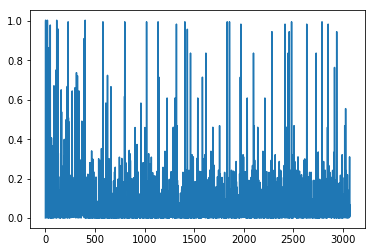

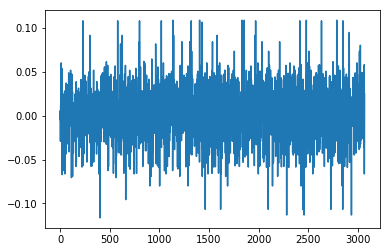

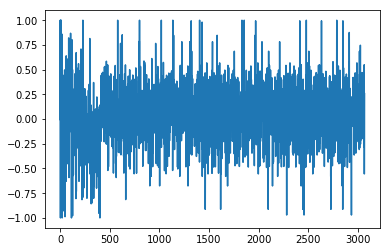

1.06937724724
[ 0.77777778  0.88888889  0.66666667  0.          0.33333333  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.          0.88888889
  0.66666667  0.          0.77777778  0.66666667  0.77777778  0.
  0.66666667  0.66666667  0.66666667  0.77777778  0.55555556  0.88888889
  0.88888889  0.66666667  0.77777778  0.77777778  0.55555556  0.66666667
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.          0.66666667  0.22222222  0.33333333
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.22222222  0.88888889  0.88888889  0.88888889]
Writing away results
1980-02-01 00:00:00


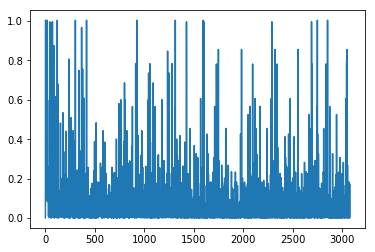

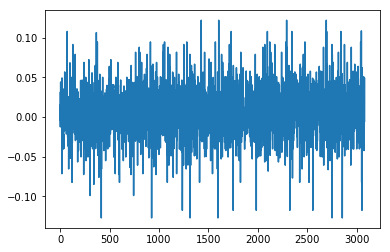

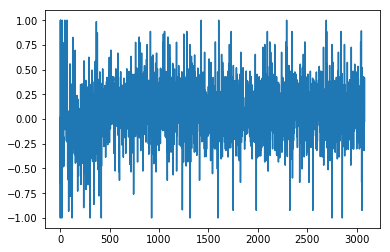

1.32004508751
[ 1.          0.33333333  0.88888889  0.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  0.88888889
  0.88888889  0.11111111  0.88888889  0.55555556  0.          0.          0.
  0.88888889  0.          1.          1.          0.33333333  0.
  0.88888889  0.11111111  0.          0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.77777778  0.          1.          1.
  0.          0.          0.88888889  0.          0.          0.88888889
  0.          0.44444444  1.          1.          1.          1.        ]
Writing away results
1980-03-01 00:00:00


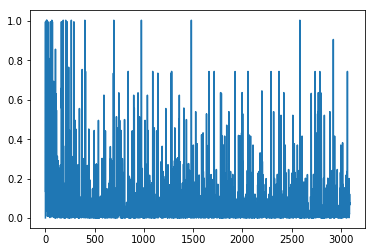

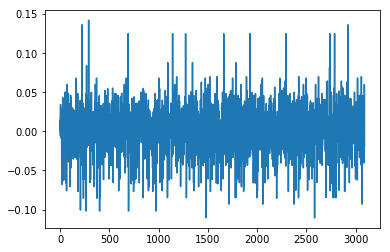

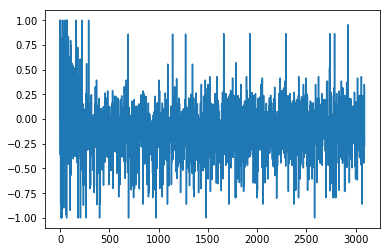

1.47045665812
[ 0.          1.          0.55555556  0.          0.66666667  0.22222222
  0.44444444  0.11111111  0.11111111  0.66666667  1.          0.
  0.77777778  0.11111111  0.          0.55555556  0.77777778  0.77777778
  0.77777778  0.77777778  0.55555556  0.          0.          1.
  0.77777778  0.77777778  0.88888889  0.          0.88888889  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.77777778
  0.55555556  0.88888889  0.33333333  0.55555556  0.88888889  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-04-01 00:00:00


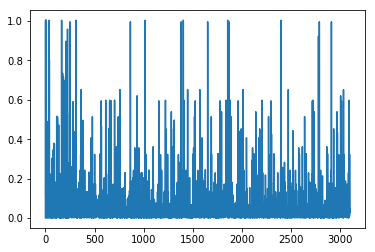

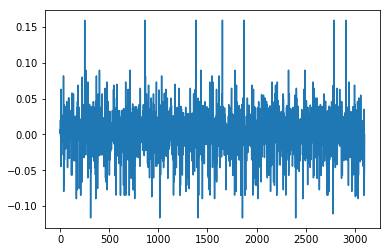

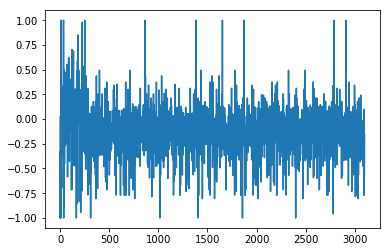

1.41708445975
[ 1.          0.          0.44444444  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.          0.11111111  0.55555556  0.77777778
  0.22222222  0.11111111  1.          0.22222222  0.22222222  1.          1.
  0.          0.44444444  0.66666667  1.          0.22222222  0.88888889
  0.          0.11111111  1.          0.33333333  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.11111111  1.          1.
  0.44444444  0.          0.88888889  1.          0.22222222  0.22222222
  0.22222222  0.22222222  1.          0.33333333  0.          0.66666667
  0.66666667  0.44444444  0.44444444  0.        ]
Writing away results
1980-05-01 00:00:00


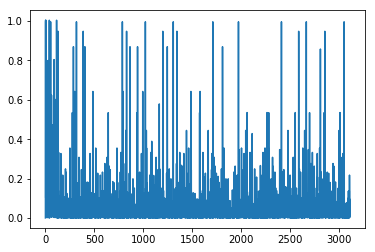

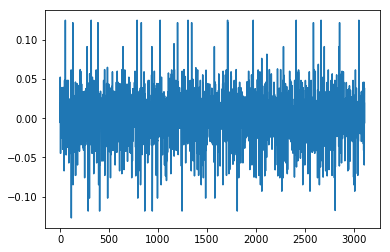

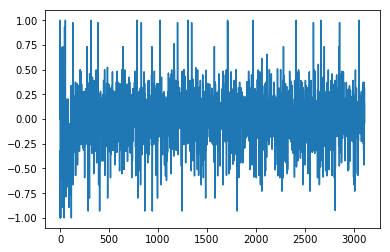

1.16320397903
[ 0.44444444  0.11111111  0.55555556  0.55555556  0.55555556  0.88888889
  0.55555556  0.55555556  0.66666667  0.33333333  0.33333333  0.77777778
  0.66666667  0.55555556  0.77777778  0.77777778  0.77777778  0.77777778
  0.55555556  0.11111111  0.55555556  0.33333333  0.77777778  0.77777778
  0.77777778  0.66666667  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556  0.66666667
  0.          0.55555556  0.66666667  0.77777778  0.33333333  0.77777778
  0.77777778  0.33333333  0.77777778  0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1980-06-01 00:00:00


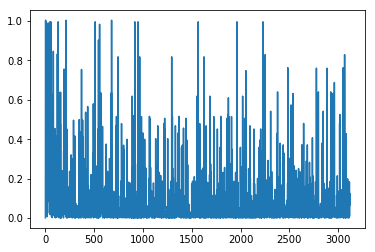

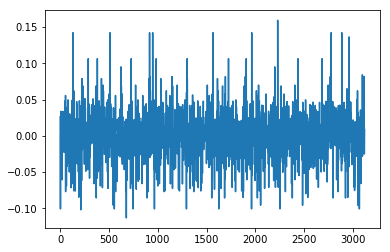

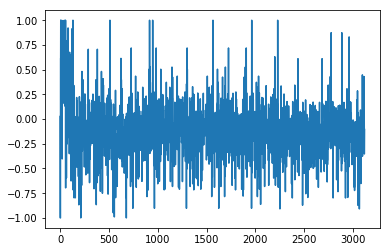

1.03996864177
[ 0.66666667  0.22222222  0.22222222  0.33333333  0.11111111  0.33333333
  1.          0.          0.11111111  0.88888889  0.11111111  0.66666667
  0.11111111  0.11111111  0.88888889  0.44444444  0.88888889  0.55555556
  0.55555556  0.66666667  1.          0.44444444  0.88888889  0.55555556
  0.55555556  0.88888889  0.55555556  0.66666667  0.55555556  0.66666667
  0.66666667  0.55555556  0.66666667  0.55555556  0.66666667  0.55555556
  0.66666667  1.          0.44444444  0.33333333  0.11111111  0.55555556
  0.22222222  0.77777778  0.11111111  0.88888889  0.88888889  0.11111111
  0.88888889  0.88888889  0.55555556  0.66666667  0.77777778  0.
  0.66666667  0.22222222  0.22222222  0.66666667  0.        ]
Writing away results
1980-07-01 00:00:00


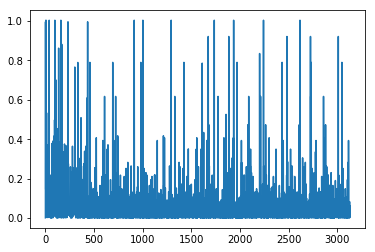

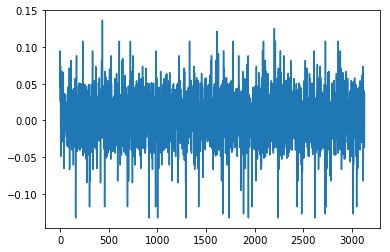

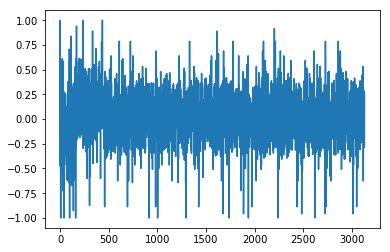

1.45766541795
[ 1.          1.          1.          1.          1.          1.
  0.77777778  0.88888889  0.22222222  0.44444444  0.33333333  1.
  0.22222222  0.44444444  0.44444444  0.22222222  0.66666667  0.44444444
  1.          0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.22222222  1.          0.44444444  0.11111111  1.          0.44444444
  0.44444444  0.22222222  0.44444444  0.44444444  0.22222222  0.44444444
  0.11111111  1.          1.          1.          1.          1.          1.
  1.          1.          1.        ]
Writing away results
1980-08-01 00:00:00


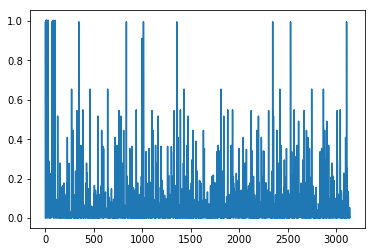

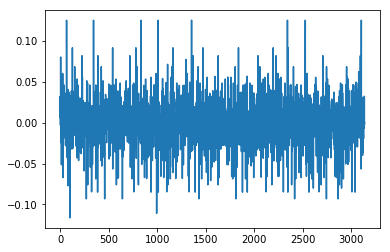

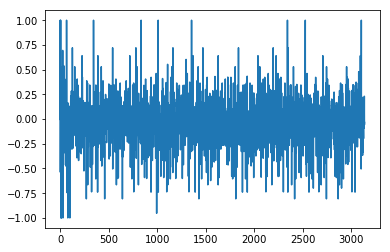

1.20893459424
[ 0.33333333  0.33333333  0.77777778  0.33333333  0.66666667  0.
  0.77777778  0.77777778  0.77777778  0.          0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.22222222  0.22222222  0.33333333
  0.77777778  0.77777778  0.77777778  0.22222222  0.          0.77777778
  0.55555556  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.22222222  0.33333333  0.33333333
  0.          0.77777778  0.          0.33333333  0.22222222  0.
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.11111111  0.22222222  0.33333333  0.11111111  0.11111111  0.55555556
  0.22222222  0.33333333  0.33333333  0.55555556  0.22222222]
Writing away results
1980-09-01 00:00:00


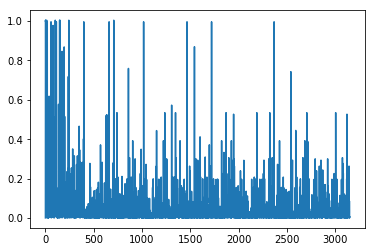

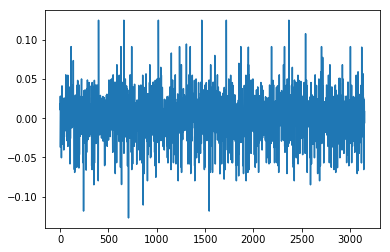

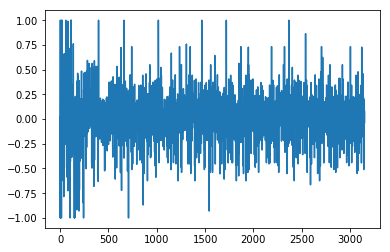

1.11792805261
[ 0.44444444  0.11111111  0.11111111  0.44444444  1.          0.88888889
  0.33333333  0.55555556  1.          0.11111111  0.55555556  0.55555556
  0.66666667  0.55555556  0.          0.44444444  0.44444444  0.22222222
  0.55555556  0.          0.55555556  0.66666667  0.11111111  0.11111111
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  1.
  0.11111111  0.55555556  0.44444444  0.44444444  0.66666667  0.22222222
  0.55555556  0.55555556  0.55555556  0.77777778  0.55555556  0.33333333
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1980-10-01 00:00:00


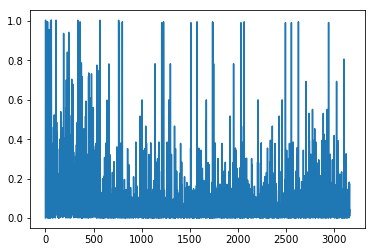

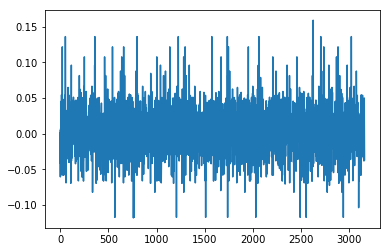

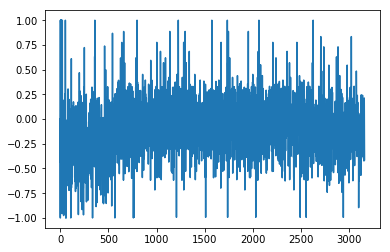

1.1941776579
[ 0.55555556  0.55555556  0.44444444  0.11111111  0.22222222  0.33333333
  0.55555556  0.11111111  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.88888889  1.          0.44444444  0.66666667
  0.33333333  0.44444444  0.11111111  0.44444444  1.          0.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.66666667  0.33333333  0.66666667  1.
  0.44444444  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  1.          0.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.        ]
Writing away results
1980-11-01 00:00:00


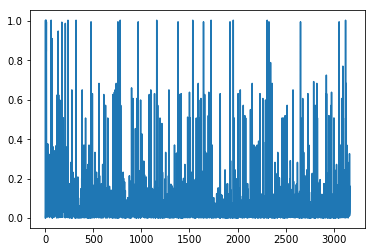

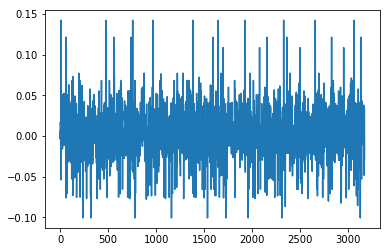

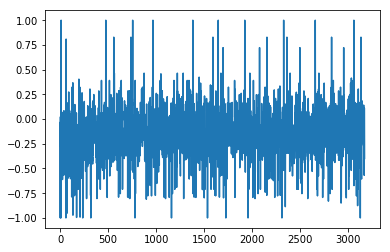

1.1534187296
[ 0.33333333  0.55555556  0.          0.77777778  0.22222222  0.22222222
  0.33333333  0.22222222  0.33333333  0.33333333  0.22222222  0.77777778
  0.77777778  0.55555556  0.66666667  0.22222222  0.77777778  0.77777778
  0.22222222  0.11111111  0.88888889  0.77777778  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.55555556  0.66666667  1.          0.33333333  0.77777778  0.11111111
  0.          0.55555556  0.88888889  0.11111111  0.33333333  0.22222222
  0.22222222  0.33333333  0.11111111  0.77777778  0.55555556  0.          0.
  0.66666667  0.66666667  0.55555556  0.66666667  0.          0.77777778
  0.55555556  0.66666667  0.66666667  0.11111111]
Writing away results
1980-12-01 00:00:00


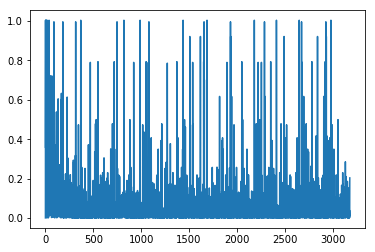

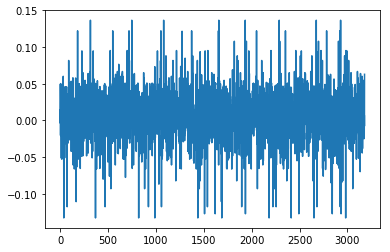

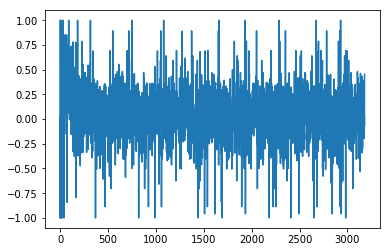

1.32918931955
[ 1.          1.          0.55555556  0.22222222  0.          0.44444444
  0.77777778  0.          0.          0.          0.77777778  0.77777778
  1.          1.          0.          0.          0.77777778  0.          0.
  0.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.88888889  0.77777778  0.          1.          0.33333333  0.88888889
  0.          0.          0.          0.          0.          0.77777778
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          0.
  0.55555556]
Writing away results
1981-01-01 00:00:00


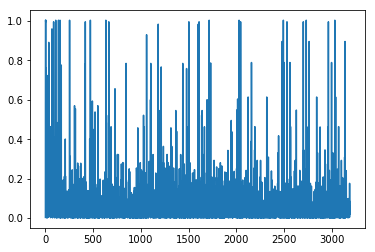

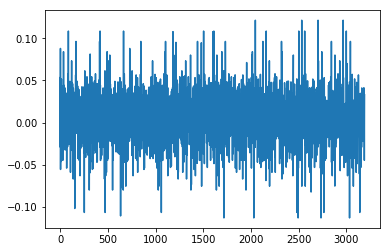

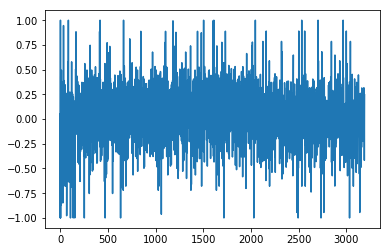

1.29610998951
[ 0.44444444  0.          0.55555556  0.55555556  0.88888889  0.33333333
  0.          0.          0.          0.66666667  0.66666667  0.44444444
  0.88888889  0.          0.          0.66666667  0.33333333  0.77777778
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.77777778  0.          0.77777778  0.88888889  0.33333333
  0.77777778  0.          0.          0.          0.          0.          0.
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.66666667  0.88888889]
Writing away results
1981-02-01 00:00:00


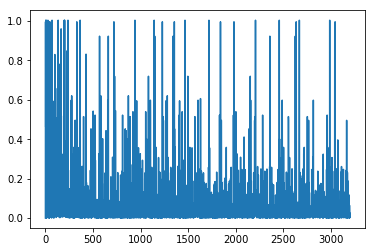

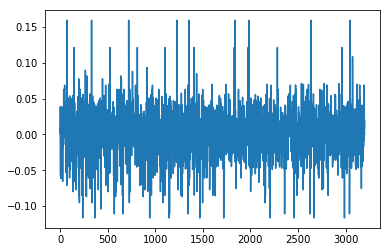

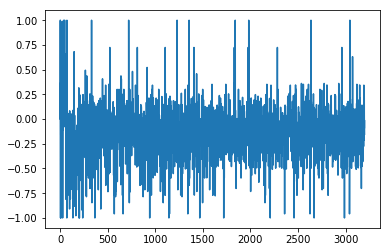

1.44496441072
[ 0.44444444  0.88888889  0.77777778  0.44444444  0.          0.44444444
  0.44444444  0.44444444  1.          0.33333333  0.22222222  0.33333333
  0.33333333  0.44444444  0.44444444  0.22222222  0.44444444  0.33333333
  0.          0.11111111  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.
  0.44444444  0.33333333  0.22222222  0.33333333  0.33333333  0.22222222
  1.          0.44444444  0.44444444  0.22222222  0.44444444  1.
  0.11111111  0.33333333  0.66666667  0.33333333  0.33333333  0.88888889
  0.88888889  0.66666667  0.33333333  0.33333333  0.33333333  0.11111111
  0.33333333  1.          0.33333333  0.88888889  0.88888889]
Writing away results
1981-03-01 00:00:00


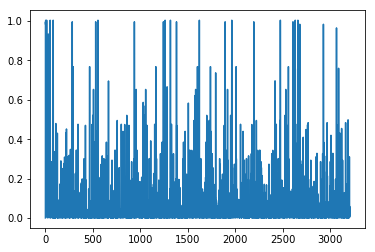

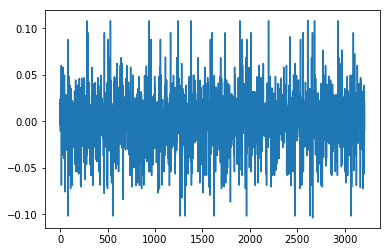

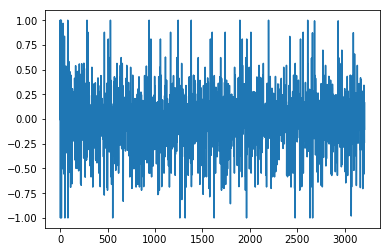

1.62770003947
[ 0.77777778  0.          0.33333333  0.88888889  0.          0.          0.
  0.77777778  1.          0.          0.33333333  0.88888889  0.66666667
  0.77777778  0.          0.          0.77777778  0.55555556  0.44444444
  0.33333333  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.88888889  0.33333333  0.77777778
  0.          0.33333333  0.44444444  0.          0.88888889  0.66666667
  0.88888889  0.          0.77777778  0.77777778  0.55555556  0.44444444
  0.33333333  0.44444444  1.          1.          0.44444444  0.33333333
  0.33333333  1.          0.44444444  0.33333333  0.33333333  0.88888889
  0.77777778  0.44444444  0.33333333  0.33333333]
Writing away results
1981-04-01 00:00:00


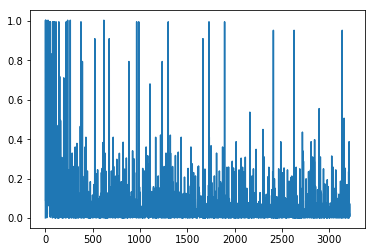

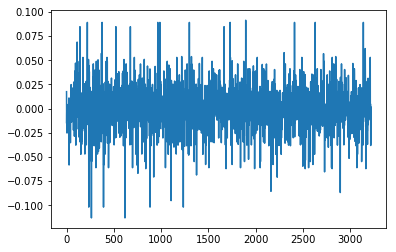

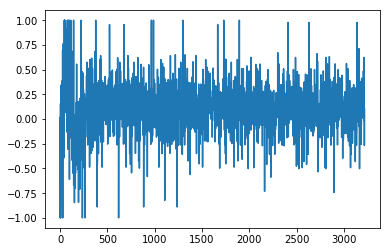

1.40632699293
[ 0.11111111  0.11111111  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.          0.          0.11111111  0.11111111
  0.33333333  0.11111111  0.11111111  0.33333333  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.11111111  1.          0.11111111  0.          0.
  0.11111111  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111
  0.11111111  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.11111111  1.          0.          0.          0.          0.        ]
Writing away results
1981-05-01 00:00:00


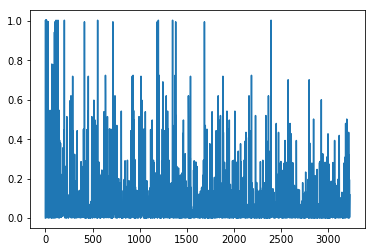

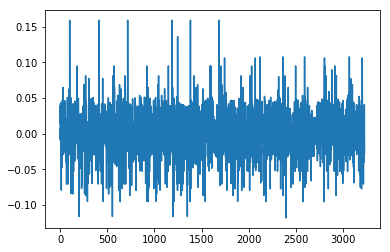

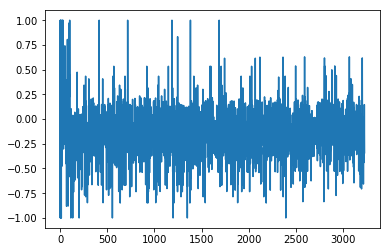

1.50714429566
[ 0.22222222  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.22222222  0.77777778  0.33333333  0.66666667  0.66666667
  0.55555556  0.22222222  0.33333333  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.33333333  0.66666667  0.11111111  0.55555556
  0.          0.33333333  0.22222222  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.33333333  0.11111111
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1981-06-01 00:00:00


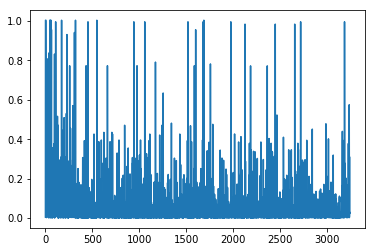

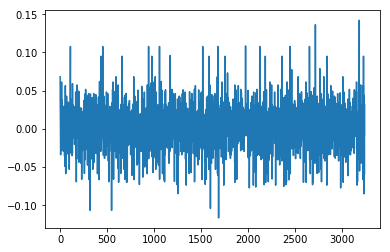

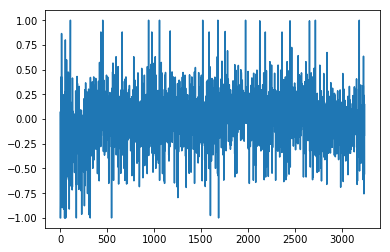

1.40226358372
[ 0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.77777778  0.55555556  0.          0.66666667  0.66666667  0.
  0.33333333  0.          1.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.33333333  0.22222222  0.66666667  0.55555556
  0.          0.33333333  0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.55555556  0.55555556  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556
  0.55555556  0.55555556  0.55555556  0.          1.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1981-07-01 00:00:00


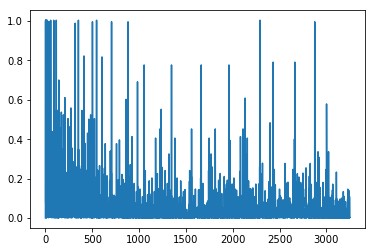

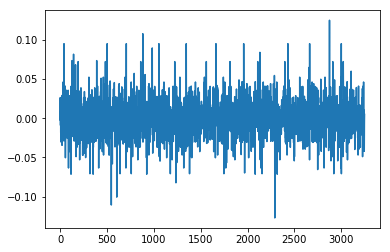

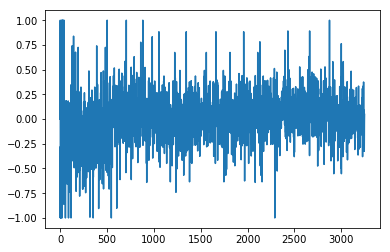

1.53463770697
[ 0.          0.          0.          0.44444444  0.77777778  0.11111111
  0.11111111  0.          0.          0.44444444  0.22222222  0.44444444
  0.          0.77777778  0.77777778  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.          0.          0.44444444  0.11111111  0.77777778
  0.44444444  0.          0.          0.          0.          0.          0.
  0.77777778  0.77777778  0.11111111  0.11111111  0.77777778  0.77777778
  0.11111111  0.11111111  0.11111111  0.77777778  0.77777778  0.11111111
  0.11111111  0.          0.88888889  0.77777778  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1981-08-01 00:00:00


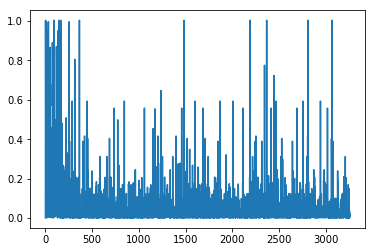

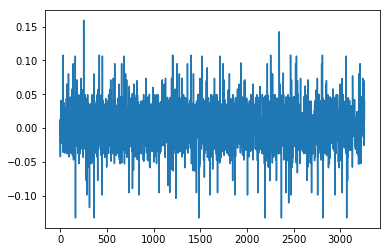

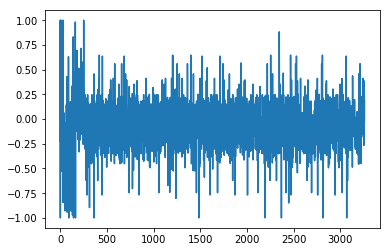

1.72022272968
[ 0.33333333  0.33333333  0.          0.77777778  0.77777778  1.
  0.33333333  0.33333333  0.          0.33333333  0.33333333  0.88888889
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  1.
  0.11111111  0.33333333  0.33333333  0.77777778  0.88888889  0.
  0.33333333  0.          0.33333333  0.44444444  0.          0.33333333
  0.77777778  0.77777778  0.77777778  1.          0.77777778  0.77777778
  0.77777778  0.77777778  1.          0.77777778  0.77777778  0.77777778
  0.77777778  0.33333333  0.11111111  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1981-09-01 00:00:00


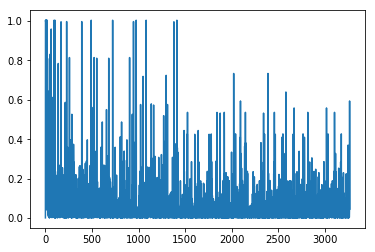

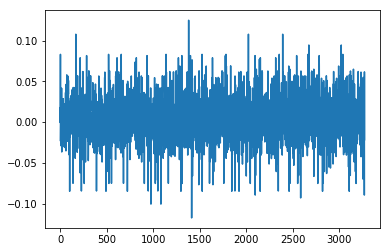

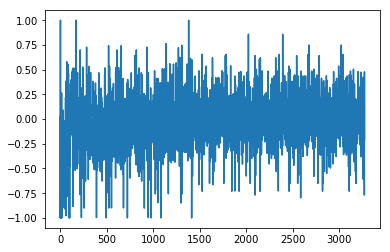

1.83555765098
[ 0.22222222  0.88888889  1.          0.11111111  0.55555556  0.22222222
  0.22222222  0.88888889  0.22222222  0.44444444  0.88888889  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.55555556  0.          0.44444444  0.88888889  0.22222222
  1.          0.          0.44444444  0.22222222  0.22222222  0.22222222
  0.22222222  0.88888889  0.22222222  1.          1.          1.          1.
  1.          1.          1.          0.55555556  0.55555556  1.          1.
  1.          1.          0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.        ]
Writing away results
1981-10-01 00:00:00


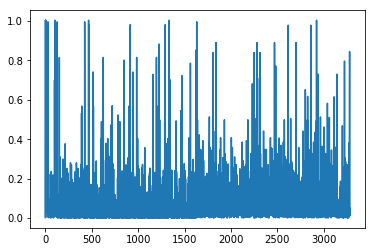

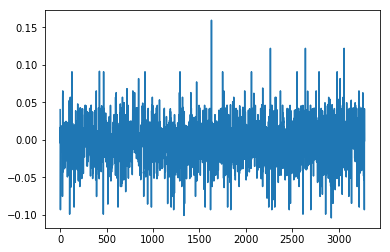

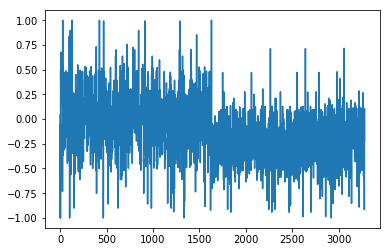

1.83191747814
[ 0.44444444  0.22222222  0.          0.          0.77777778  0.44444444
  0.44444444  0.77777778  0.44444444  0.88888889  0.          1.          1.
  1.          1.          0.          1.          0.          1.
  0.66666667  0.66666667  0.88888889  0.66666667  0.22222222  0.77777778
  0.          0.77777778  0.44444444  0.55555556  0.44444444  0.77777778
  0.77777778  0.44444444  0.77777778  0.          1.          1.
  0.33333333  0.          0.          1.          0.66666667  0.33333333
  1.          1.          0.          0.          0.77777778  0.          1.
  1.          1.          0.          1.          1.          0.          1.
  0.33333333  0.        ]
Writing away results
1981-11-01 00:00:00


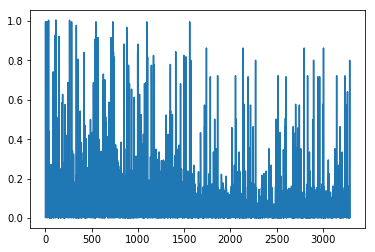

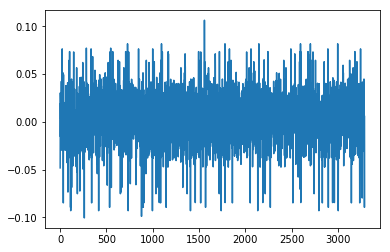

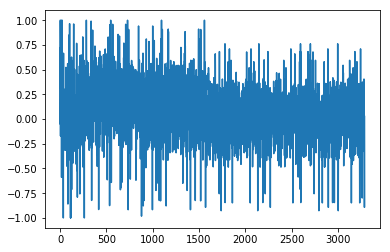

1.47011750259
[ 1.          0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.33333333  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.22222222  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333]
Writing away results
1981-12-01 00:00:00


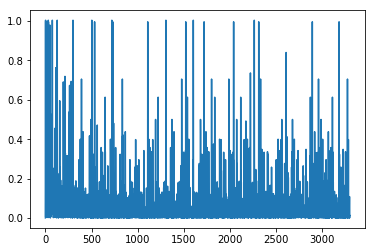

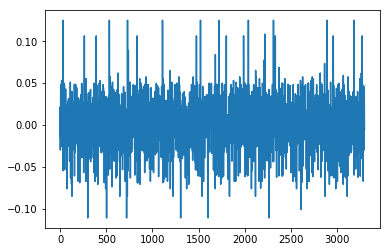

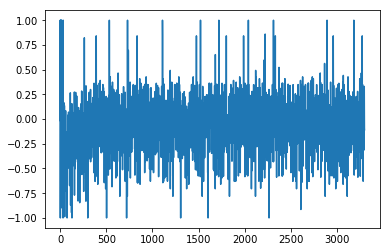

1.62228088024
[ 0.          0.44444444  0.77777778  0.77777778  0.66666667  0.77777778
  0.77777778  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.33333333  0.66666667  0.22222222  0.
  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.          0.44444444  0.77777778  0.33333333  0.44444444
  0.          0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.77777778  0.44444444  1.          0.77777778]
Writing away results
1982-01-01 00:00:00


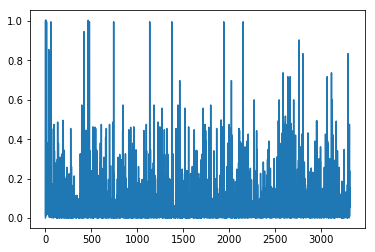

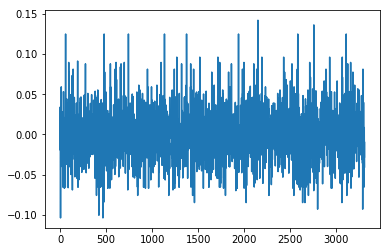

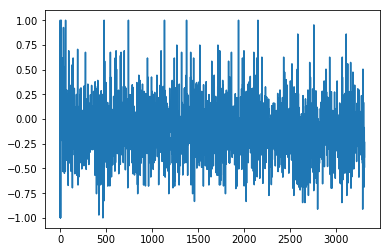

1.42475360152
[ 1.          0.88888889  0.77777778  1.          0.11111111  0.77777778
  1.          1.          0.22222222  0.33333333  0.22222222  0.33333333
  1.          1.          0.33333333  1.          0.22222222  0.33333333
  0.22222222  0.44444444  1.          0.44444444  1.          1.
  0.44444444  0.77777778  0.77777778  0.77777778  0.44444444  0.88888889
  0.77777778  1.          0.22222222  0.33333333  0.22222222  1.          1.
  0.22222222  0.33333333  1.          1.          0.22222222  0.33333333
  1.          0.77777778  1.          1.          0.          0.22222222
  1.          0.22222222  0.22222222  0.33333333  1.          0.44444444
  1.          0.77777778  0.33333333  1.        ]
Writing away results
1982-02-01 00:00:00


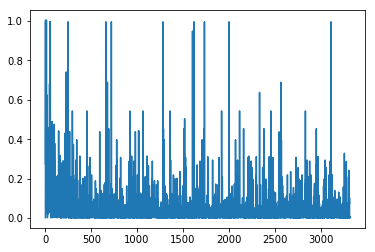

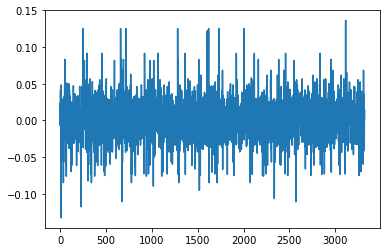

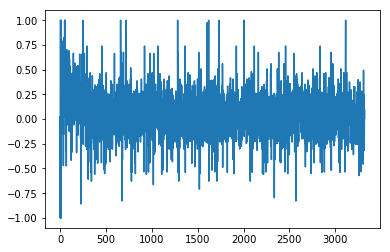

1.5750898711
[ 0.          0.22222222  0.          0.33333333  0.22222222  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.44444444  0.22222222  0.55555556  0.          0.22222222
  0.22222222  0.77777778  0.          0.22222222  0.77777778  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.55555556  0.          0.66666667  0.55555556  0.22222222]
Writing away results
1982-03-01 00:00:00


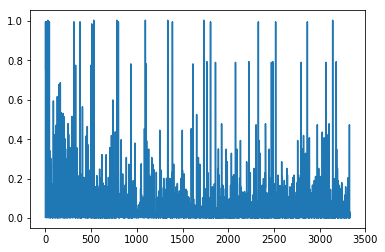

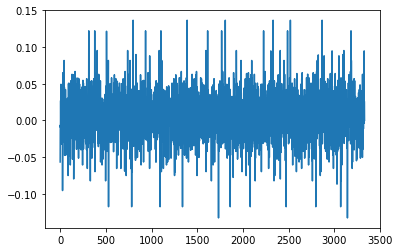

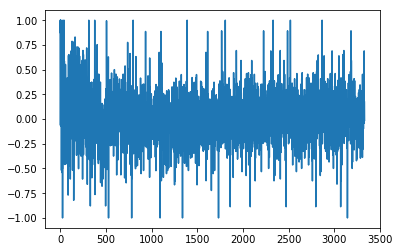

1.778058627
[ 0.          0.          0.          0.          0.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.          0.55555556  0.          1.
  0.44444444  0.          0.          0.          0.          0.          0.
  0.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.          0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          0.44444444  1.          0.44444444
  0.22222222  1.          0.          1.        ]
Writing away results
1982-04-01 00:00:00


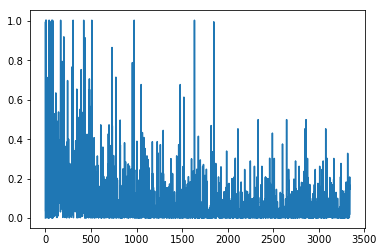

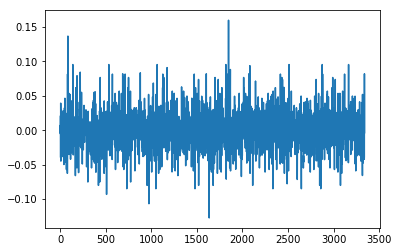

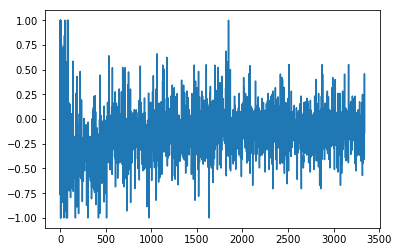

1.78786250813
[ 0.22222222  0.33333333  1.          0.22222222  0.11111111  0.33333333
  0.11111111  0.11111111  0.55555556  0.55555556  0.11111111  0.88888889
  0.11111111  0.88888889  0.55555556  0.55555556  0.          0.22222222
  0.66666667  1.          0.22222222  0.          0.22222222  0.          0.
  0.          0.          0.22222222  0.33333333  0.77777778  0.55555556
  0.77777778  0.11111111  0.11111111  0.88888889  0.55555556  0.55555556
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  1.
  0.11111111  0.11111111  0.55555556  0.11111111  0.11111111  0.55555556
  0.55555556  0.11111111  0.55555556  0.11111111  0.22222222  1.
  0.22222222  0.66666667  0.11111111  0.88888889]
Writing away results
1982-05-01 00:00:00


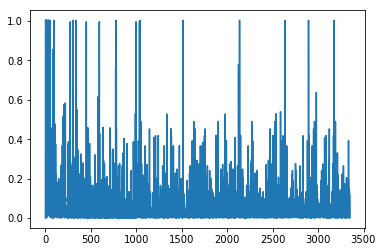

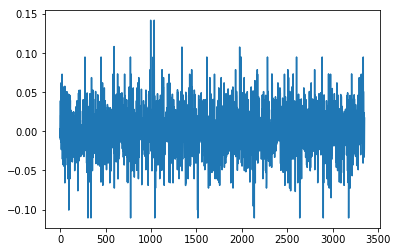

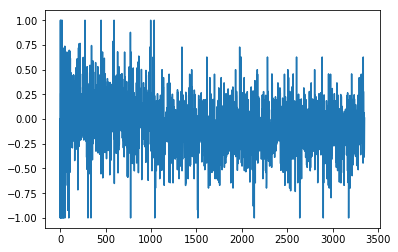

1.58369913026
[ 1.          0.          0.55555556  0.88888889  0.11111111  0.11111111
  0.22222222  0.11111111  0.22222222  0.22222222  0.11111111  0.22222222
  0.22222222  0.66666667  0.22222222  0.88888889  0.77777778  0.
  0.66666667  0.22222222  0.          1.          0.88888889  0.88888889
  0.          0.88888889  1.          0.33333333  0.22222222  0.11111111
  0.66666667  0.22222222  0.22222222  0.11111111  0.11111111  0.66666667
  0.66666667  0.22222222  0.11111111  0.22222222  1.          0.88888889
  0.22222222  0.11111111  0.22222222  0.66666667  0.22222222  0.11111111
  0.66666667  0.22222222  0.11111111  0.66666667  0.22222222  0.33333333
  0.22222222  0.          0.66666667  0.22222222  0.11111111]
Writing away results
1982-06-01 00:00:00


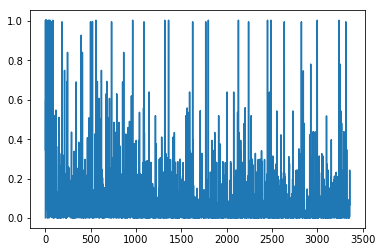

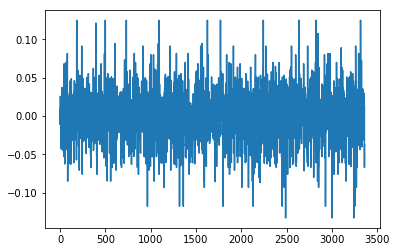

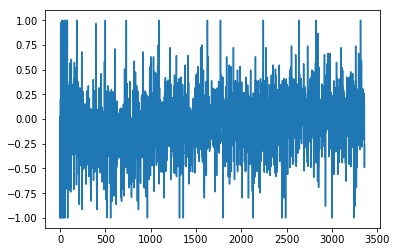

1.94292626616
[ 0.77777778  0.88888889  0.55555556  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          0.77777778  0.22222222  0.77777778  0.11111111
  0.44444444  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.55555556  0.44444444  0.44444444  1.
  0.44444444  0.44444444  0.44444444  1.          0.44444444  0.44444444
  0.44444444  1.          0.44444444  0.77777778  0.33333333  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          0.11111111  1.          0.66666667  0.44444444
  0.66666667  0.44444444  0.44444444  0.44444444  1.        ]
Writing away results
1982-07-01 00:00:00


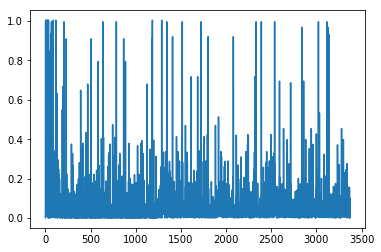

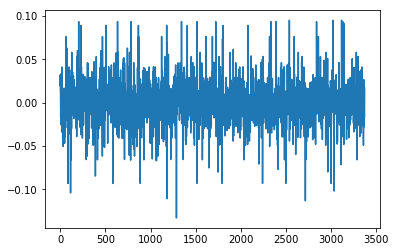

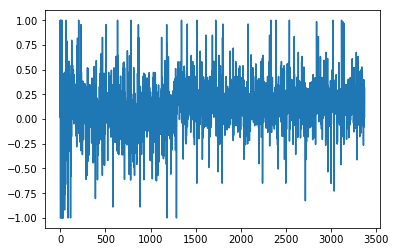

1.61359849739
[ 0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.          0.44444444  0.          0.22222222  0.22222222
  0.          0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.88888889  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.22222222  0.44444444  0.          0.22222222  0.          0.22222222
  0.22222222  0.22222222  0.22222222  1.        ]
Writing away results
1982-08-01 00:00:00


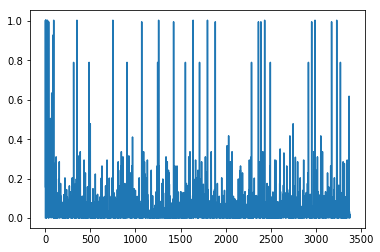

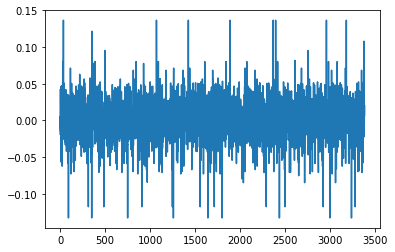

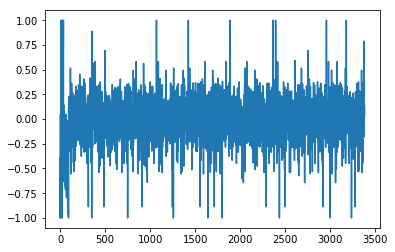

1.78776497117
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.44444444  0.22222222  0.33333333  0.88888889  0.55555556  1.          0.
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556
  1.          0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.77777778  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  1.          0.22222222
  0.33333333  1.          0.22222222  0.33333333  0.55555556  0.55555556
  0.55555556  0.22222222  0.66666667  0.66666667]
Writing away results
1982-09-01 00:00:00


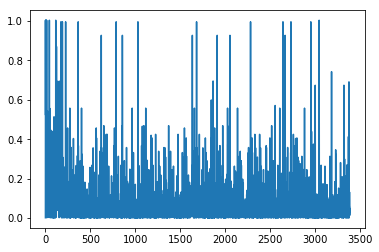

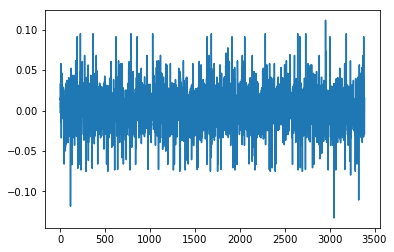

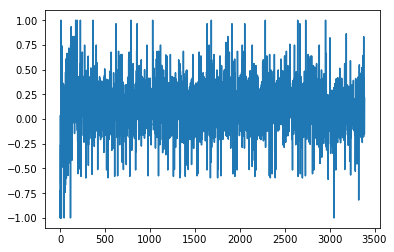

1.69906010806
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.          0.55555556  0.55555556  0.77777778  0.          0.          0.
  0.          0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.55555556  0.33333333  0.66666667
  0.55555556  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.55555556]
Writing away results
1982-10-01 00:00:00


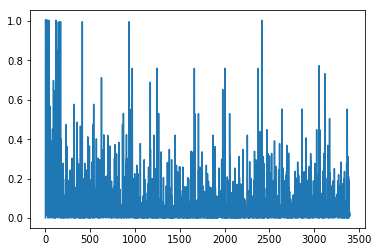

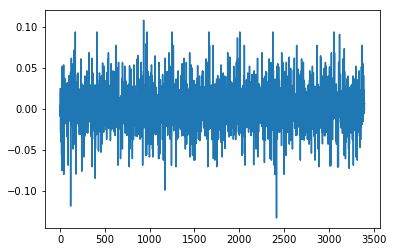

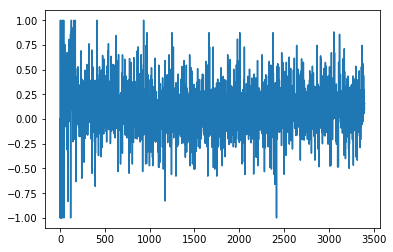

1.44566679555
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333  0.77777778
  0.22222222  0.55555556  0.44444444  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556  0.33333333
  0.          0.44444444  0.22222222  0.44444444  0.44444444  0.44444444
  0.44444444  1.          0.55555556  0.44444444  0.44444444]
Writing away results
1982-11-01 00:00:00


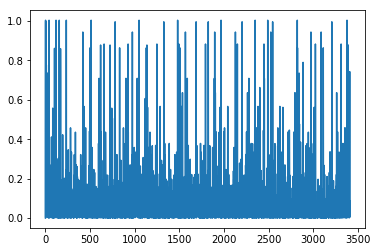

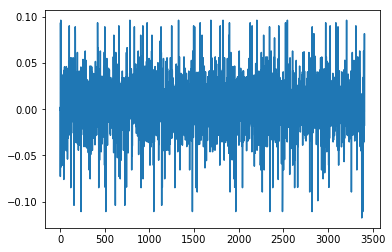

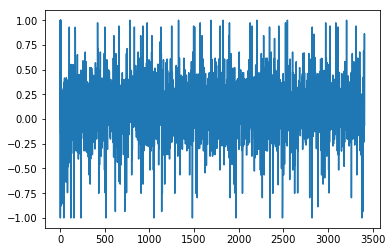

1.28089080435
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  1.          0.11111111
  0.44444444  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.66666667  1.          0.44444444
  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1982-12-01 00:00:00


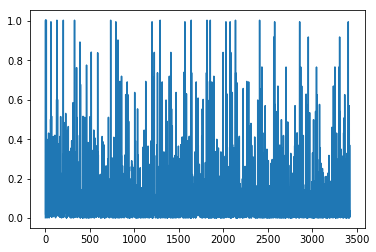

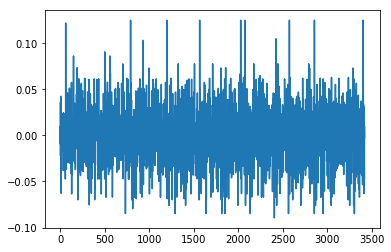

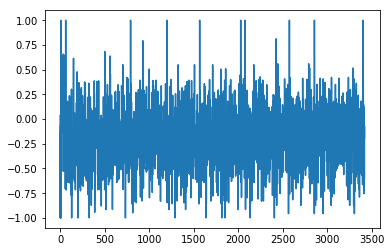

1.41272371607
[ 0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  1.          0.11111111  0.77777778  0.66666667  0.77777778  0.55555556
  0.22222222  0.77777778  0.22222222  0.44444444  0.11111111  0.77777778
  1.          0.77777778  0.44444444  0.22222222  0.55555556  0.66666667
  0.55555556  0.55555556  0.22222222  0.          0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.77777778  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.77777778  0.66666667  0.22222222  0.44444444  0.66666667
  0.77777778  0.55555556  0.11111111  1.          0.66666667  0.33333333
  0.33333333  1.          1.          0.22222222  0.77777778]
Writing away results
1983-01-01 00:00:00


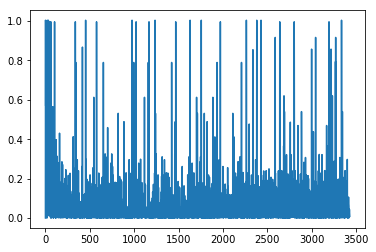

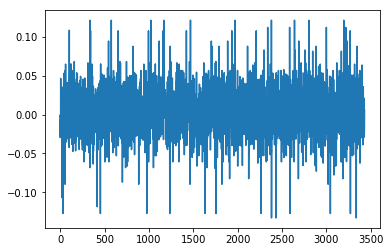

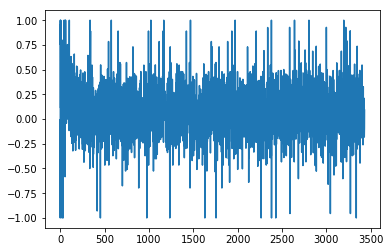

1.21940360178
[ 1.          1.          1.          1.          1.          1.          1.
  0.22222222  0.22222222  0.22222222  1.          1.          0.88888889
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.22222222  0.44444444  1.          1.          1.          1.          1.
  1.          1.          1.          0.33333333  1.          0.55555556
  0.88888889  1.          0.88888889  1.          1.          1.          1.
  0.          0.44444444  1.          1.          1.          0.22222222
  0.22222222]
Writing away results
1983-02-01 00:00:00


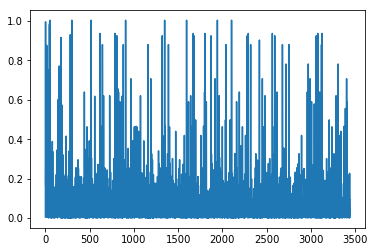

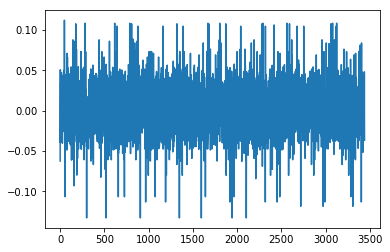

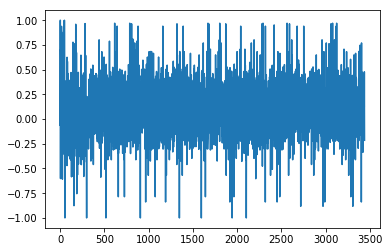

1.28220681204
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.66666667  0.44444444  1.          0.88888889  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.55555556  0.44444444  0.88888889  0.55555556  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444]
Writing away results
1983-03-01 00:00:00


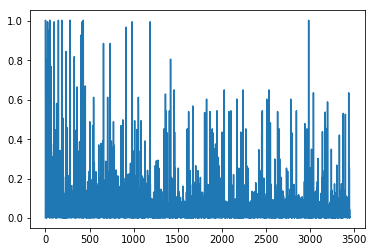

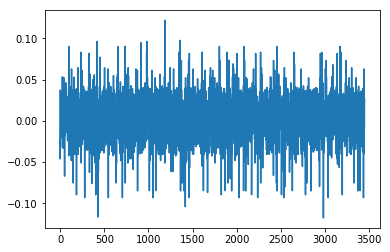

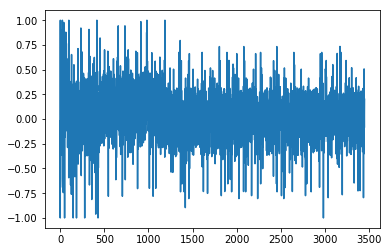

1.26273611554
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.44444444  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.22222222  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.77777778]
Writing away results
1983-04-01 00:00:00


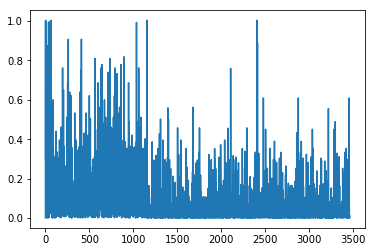

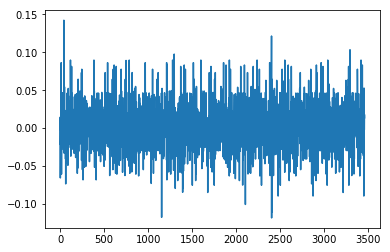

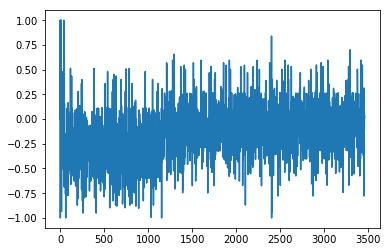

1.27480060241
[ 0.66666667  0.          0.44444444  0.66666667  0.55555556  0.33333333
  0.22222222  1.          0.33333333  0.11111111  0.66666667  1.
  0.55555556  0.22222222  0.55555556  0.22222222  0.88888889  0.33333333
  0.11111111  0.66666667  0.          0.33333333  0.          0.66666667
  0.66666667  0.33333333  0.33333333  0.44444444  0.66666667  0.66666667
  1.          0.33333333  0.          0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.22222222
  0.11111111  0.33333333  0.77777778  0.88888889  0.33333333  0.44444444
  0.66666667  0.66666667  0.88888889  0.77777778  0.44444444  0.66666667
  0.66666667  0.55555556  1.          0.77777778  0.        ]
Writing away results
1983-05-01 00:00:00


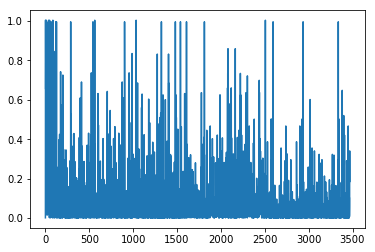

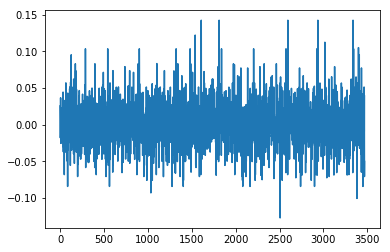

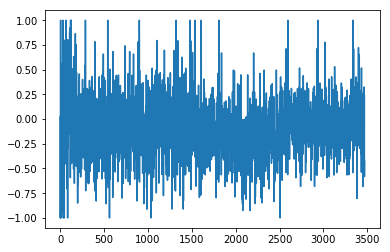

1.44110457746
[ 0.11111111  0.33333333  0.33333333  0.88888889  0.66666667  0.
  0.77777778  0.55555556  0.33333333  0.88888889  0.88888889  0.66666667
  0.44444444  0.88888889  0.66666667  1.          0.55555556  0.33333333
  1.          1.          1.          0.11111111  0.33333333  0.33333333
  1.          1.          0.33333333  0.33333333  0.33333333  1.          1.
  1.          0.33333333  1.          1.          0.33333333  0.11111111
  1.          0.33333333  1.          0.66666667  0.77777778  0.66666667
  0.22222222  1.          1.          0.33333333  0.33333333  0.88888889
  0.66666667  1.          0.11111111  0.33333333  0.33333333  0.88888889
  0.88888889  0.55555556  0.22222222  0.33333333]
Writing away results
1983-06-01 00:00:00


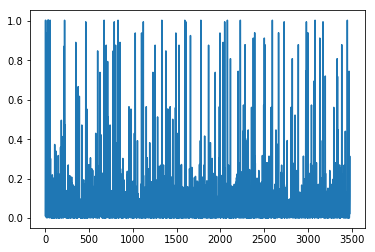

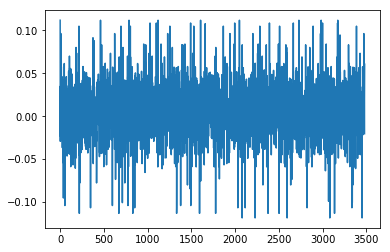

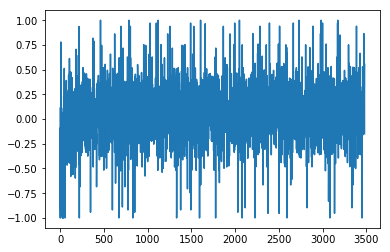

1.07382936894
[ 0.88888889  0.88888889  0.22222222  0.66666667  0.22222222  0.88888889
  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.88888889  0.22222222  0.44444444  0.88888889
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.66666667  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222
  0.66666667  0.22222222  0.88888889  0.88888889  0.88888889]
Writing away results
1983-07-01 00:00:00


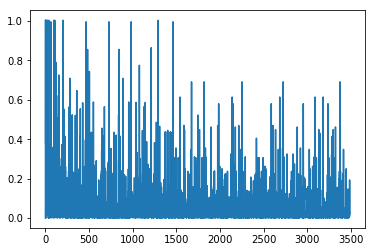

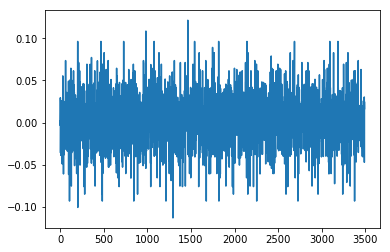

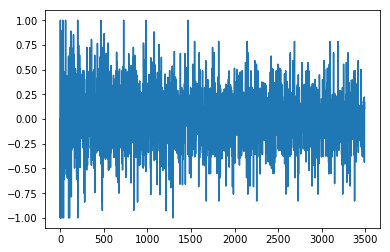

1.33583379887
[ 0.66666667  0.44444444  0.77777778  0.77777778  0.55555556  0.66666667
  0.44444444  0.44444444  0.44444444  0.77777778  0.77777778  0.44444444
  0.77777778  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.66666667  0.66666667  0.44444444  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.88888889  0.66666667  0.44444444
  0.55555556  0.55555556  0.11111111  0.66666667  0.88888889  0.77777778
  0.55555556  0.55555556  0.66666667  0.44444444  0.44444444  0.77777778
  0.77777778  0.55555556  0.66666667  0.66666667  0.66666667]
Writing away results
1983-08-01 00:00:00


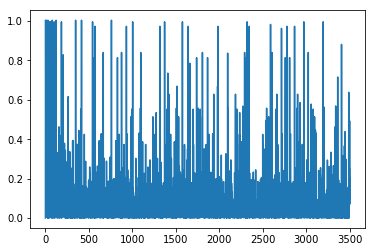

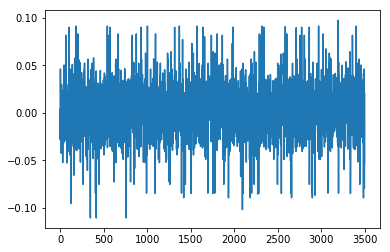

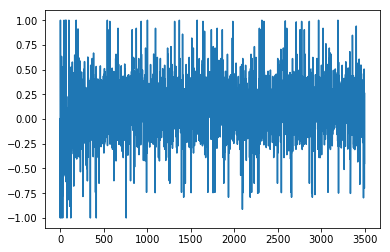

1.19521728663
[ 0.22222222  0.44444444  0.22222222  0.66666667  0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.22222222  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.          0.66666667]
Writing away results
1983-09-01 00:00:00


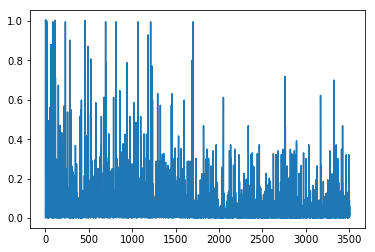

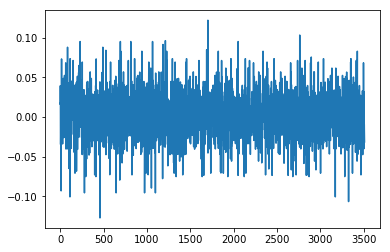

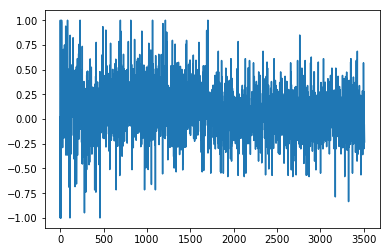

1.25228194554
[ 0.44444444  0.44444444  0.55555556  0.55555556  0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  1.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333  0.55555556
  0.44444444  0.22222222  0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.44444444  0.44444444  0.22222222  0.55555556
  0.55555556  0.55555556  0.44444444  0.55555556  0.55555556]
Writing away results
1983-10-01 00:00:00


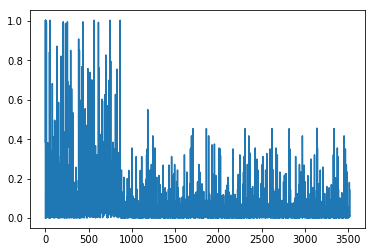

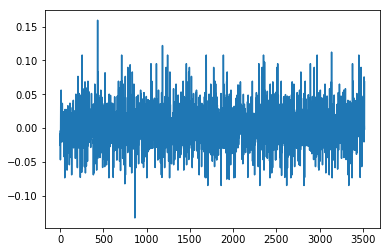

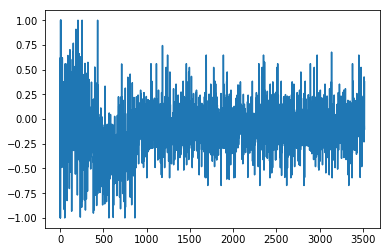

1.32504591338
[ 0.22222222  0.77777778  0.77777778  0.          1.          0.
  0.22222222  0.          0.          0.22222222  0.33333333  0.55555556
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.55555556  0.77777778  1.
  0.77777778  0.11111111  0.55555556  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.55555556  0.88888889  0.22222222
  0.77777778  0.77777778  0.55555556  0.77777778  0.11111111  0.55555556
  0.44444444  0.44444444  0.33333333  0.11111111  0.77777778  0.55555556
  0.44444444  1.          0.66666667  0.11111111  0.77777778  0.55555556
  0.77777778  0.33333333  0.11111111  0.33333333  0.        ]
Writing away results
1983-11-01 00:00:00


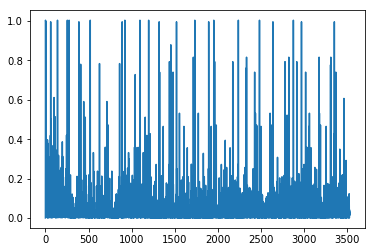

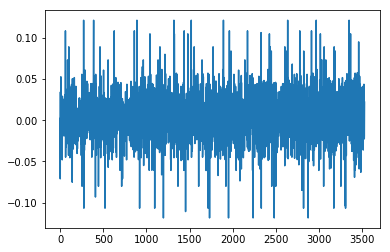

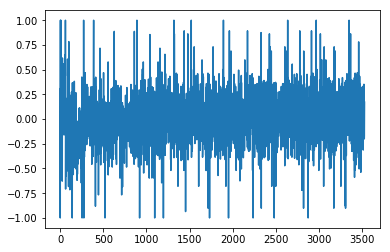

1.20519574693
[ 0.22222222  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.          0.77777778
  0.          0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.55555556  0.88888889  0.88888889  0.88888889  0.11111111
  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889
  0.55555556  0.22222222  0.88888889  0.77777778  0.22222222]
Writing away results
1983-12-01 00:00:00


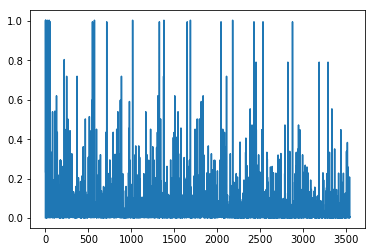

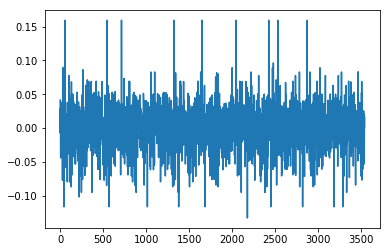

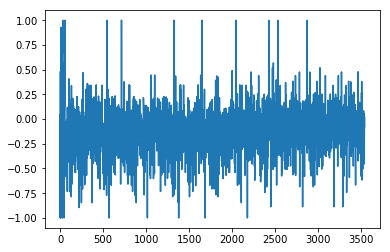

1.53720798896
[ 0.          0.88888889  0.11111111  1.          1.          1.          1.
  1.          0.88888889  0.55555556  0.22222222  0.44444444  0.55555556
  0.55555556  0.          0.22222222  0.44444444  0.55555556  0.55555556
  0.55555556  0.44444444  0.11111111  0.33333333  0.          0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444  0.55555556
  0.22222222  0.33333333  0.          0.88888889  0.55555556  0.88888889
  0.44444444  0.          0.22222222  0.44444444  0.44444444  1.
  0.66666667  0.55555556  0.44444444  0.11111111  1.          1.
  0.66666667  0.22222222  0.55555556  0.44444444  0.11111111  0.66666667
  0.          0.88888889  0.44444444  0.66666667]
Writing away results
1984-01-01 00:00:00


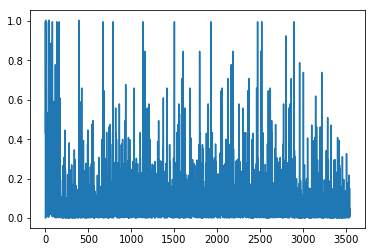

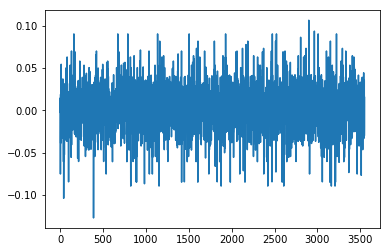

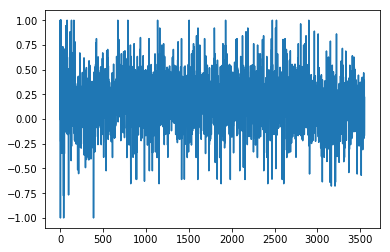

1.10288214849
[ 0.22222222  0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.          0.33333333  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.          0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667
  0.22222222  0.66666667  0.66666667  0.22222222]
Writing away results
1984-02-01 00:00:00


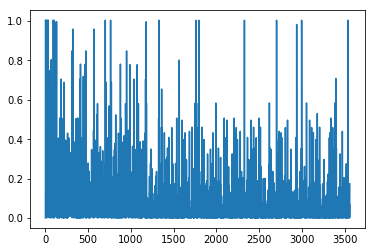

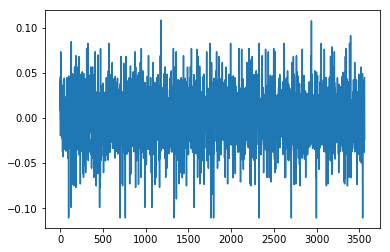

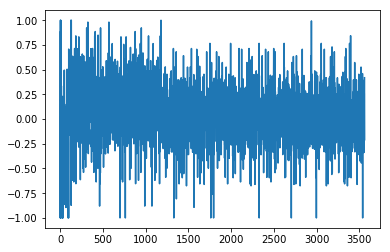

1.55819899769
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.44444444  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889
  0.55555556  0.88888889  0.44444444  0.55555556  0.88888889  0.55555556
  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444  0.55555556
  0.55555556  0.55555556  0.33333333  0.44444444  0.44444444  0.88888889
  0.55555556  0.55555556  0.55555556  0.77777778  0.66666667  0.55555556
  0.33333333  0.55555556  0.66666667  0.88888889  0.55555556]
Writing away results
1984-03-01 00:00:00


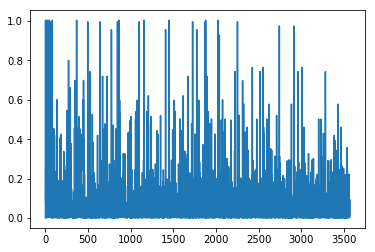

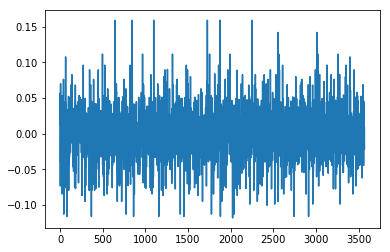

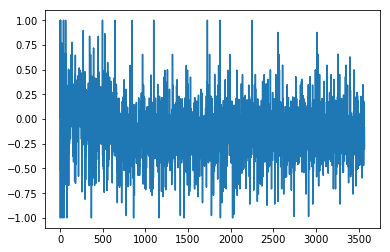

1.2226625367
[ 0.66666667  0.22222222  0.22222222  0.22222222  0.11111111  0.88888889
  0.55555556  0.55555556  0.77777778  0.55555556  0.55555556  0.55555556
  0.55555556  0.77777778  0.88888889  0.55555556  0.55555556  0.77777778
  1.          0.88888889  0.77777778  0.55555556  0.55555556  0.77777778
  0.77777778  0.55555556  0.55555556  0.77777778  0.55555556  0.88888889
  0.11111111  0.44444444  0.77777778  0.55555556  0.77777778  0.77777778
  0.55555556  0.77777778  0.22222222  0.22222222  0.55555556  0.55555556
  0.77777778  0.66666667  1.          0.66666667  0.11111111  0.55555556
  0.55555556  0.44444444  0.77777778  0.22222222  0.77777778  0.66666667
  0.77777778  0.11111111  0.55555556  0.          0.77777778]
Writing away results
1984-04-01 00:00:00


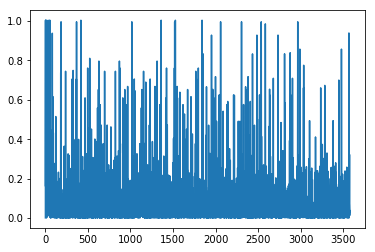

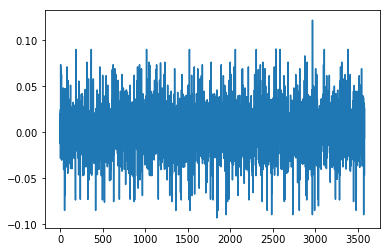

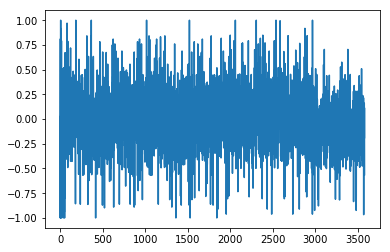

1.36381071361
[ 0.88888889  0.44444444  0.          0.11111111  0.55555556  0.66666667
  0.55555556  0.66666667  0.55555556  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.44444444
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.55555556  0.55555556  0.11111111
  0.55555556  0.66666667  1.          0.66666667  0.66666667  0.55555556
  0.66666667  0.44444444  0.88888889  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.          0.11111111  0.55555556  0.66666667
  0.55555556  0.44444444  0.          0.66666667  0.44444444  0.66666667
  0.66666667  0.55555556  0.66666667  0.66666667  0.22222222]
Writing away results
1984-05-01 00:00:00


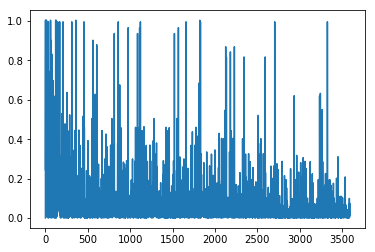

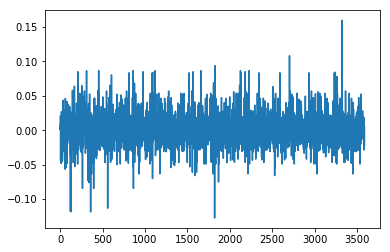

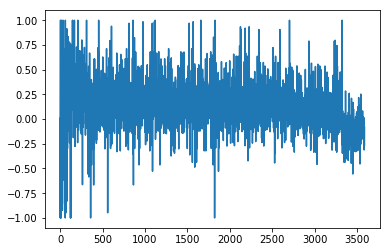

1.4963078887
[ 0.22222222  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.22222222  0.11111111  0.22222222  0.33333333
  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111
  0.22222222  0.11111111  0.11111111  1.          0.11111111]
Writing away results
1984-06-01 00:00:00


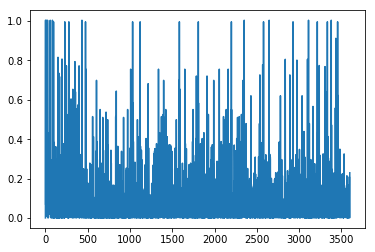

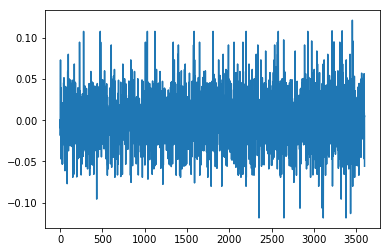

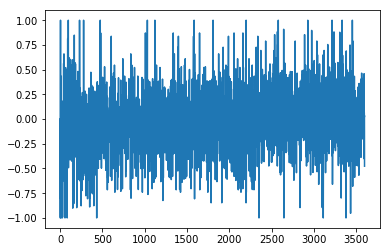

1.52363037012
[ 0.77777778  0.33333333  0.11111111  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.44444444  0.77777778  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.44444444  0.11111111  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.77777778  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.77777778  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.88888889  0.66666667  0.88888889  0.          0.44444444
  0.88888889  0.88888889  0.44444444  0.88888889  0.88888889]
Writing away results
1984-07-01 00:00:00


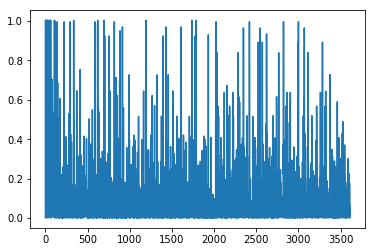

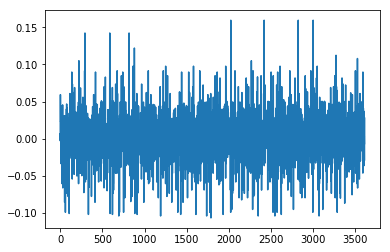

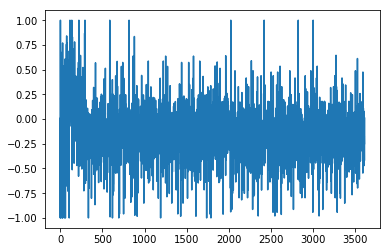

1.46704588498
[ 0.33333333  0.55555556  0.77777778  0.44444444  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.33333333  0.77777778  0.77777778
  0.77777778  0.77777778  0.33333333  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.44444444  0.77777778  0.77777778  0.66666667  0.77777778  0.66666667
  0.77777778  0.77777778  0.55555556  0.77777778  0.66666667  0.33333333
  0.55555556  0.77777778  0.77777778  0.66666667  0.66666667  1.
  0.55555556  0.55555556  0.77777778  0.77777778  0.33333333  0.22222222
  0.55555556  0.66666667  0.33333333  0.55555556  0.66666667  0.77777778
  0.55555556  0.55555556  0.22222222  0.77777778  0.55555556]
Writing away results
1984-08-01 00:00:00


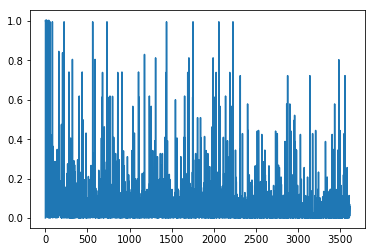

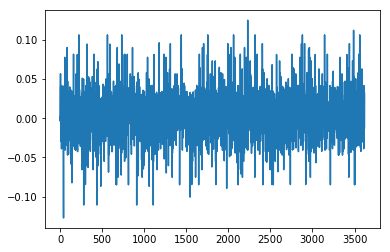

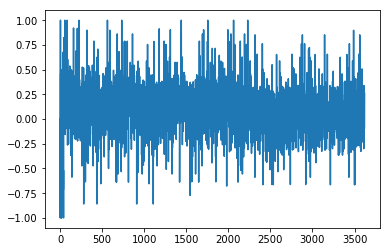

1.33923723046
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.          0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.33333333  0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.77777778  0.66666667  1.          0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1984-09-01 00:00:00


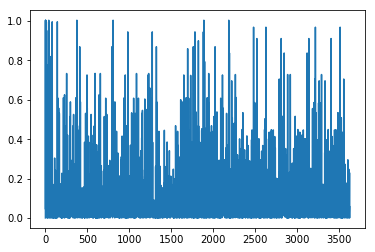

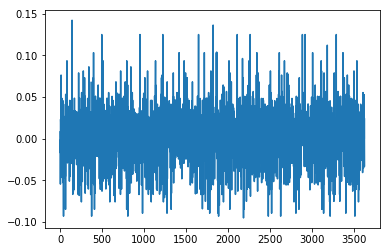

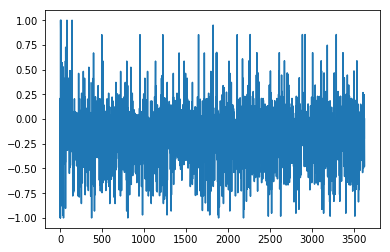

1.95098578793
[ 0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.66666667
  0.77777778  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.33333333  0.66666667
  0.77777778  0.88888889  0.66666667  0.77777778  0.66666667  0.          1.
  0.66666667  0.88888889  0.66666667  0.11111111  1.          0.
  0.77777778  0.77777778  0.77777778  0.77777778  0.33333333  0.66666667
  0.66666667  0.66666667  1.          0.11111111  0.55555556  0.66666667
  0.11111111  0.33333333  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667]
Writing away results
1984-10-01 00:00:00


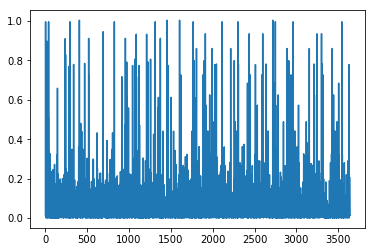

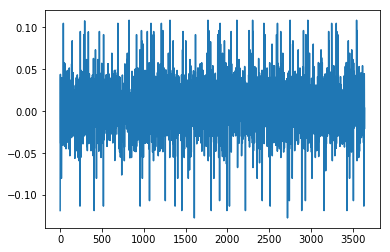

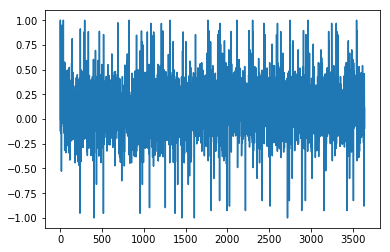

1.4709251485
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.88888889  0.
  0.22222222  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.88888889  0.          0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1984-11-01 00:00:00


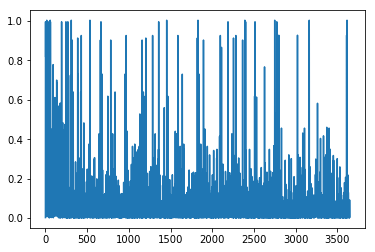

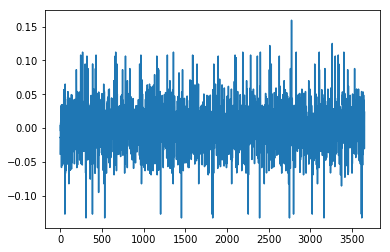

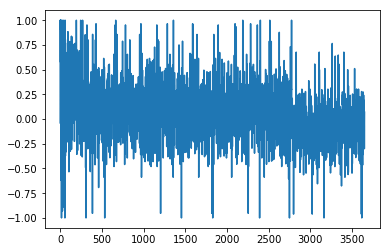

1.64516113364
[ 1.          1.          1.          1.          0.33333333  0.33333333
  0.33333333  1.          0.33333333  1.          0.66666667  0.88888889
  1.          0.33333333  0.33333333  0.33333333  1.          0.33333333
  0.33333333  1.          0.77777778  0.33333333  0.44444444  0.77777778
  1.          0.77777778  0.33333333  1.          0.33333333  0.33333333
  0.77777778  0.88888889  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.11111111  0.33333333  0.33333333  0.33333333
  1.          0.33333333  1.          0.77777778  0.33333333  1.
  0.77777778  0.33333333  1.          1.          0.33333333  1.
  0.33333333  0.33333333  0.33333333  1.          0.33333333]
Writing away results
1984-12-01 00:00:00


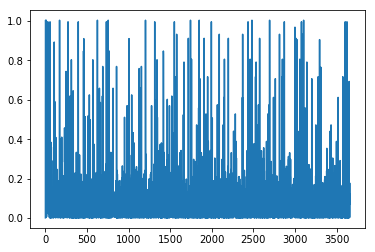

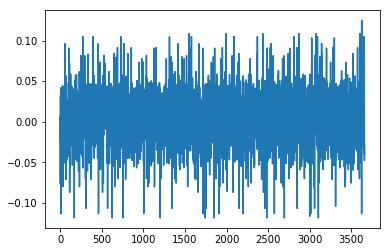

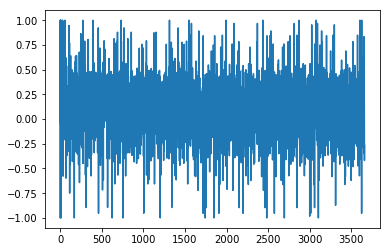

1.47103383804
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.          0.66666667  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.55555556  0.22222222  0.88888889  0.88888889  0.88888889  0.55555556
  0.88888889  0.88888889  1.          0.88888889  0.22222222  0.66666667
  0.88888889  0.88888889  0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1985-01-01 00:00:00


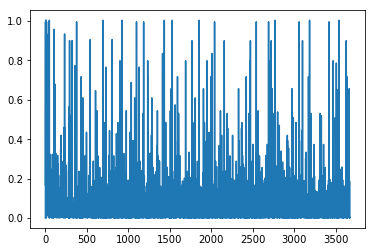

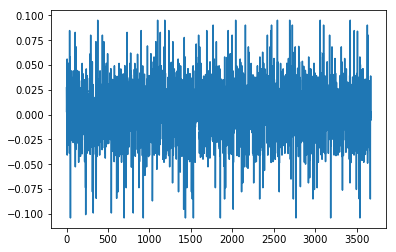

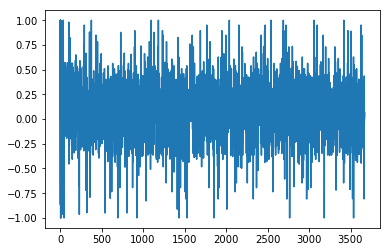

1.25828847633
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.22222222  0.33333333  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.77777778  0.          0.          0.          0.
  0.66666667  0.66666667  0.77777778  0.77777778  0.55555556  0.66666667
  0.          0.66666667  0.66666667  0.33333333  0.77777778  0.66666667
  0.55555556  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.        ]
Writing away results
1985-02-01 00:00:00


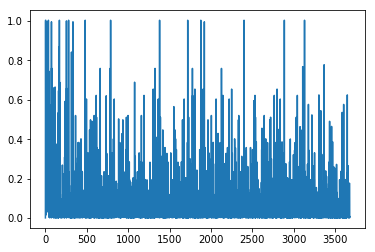

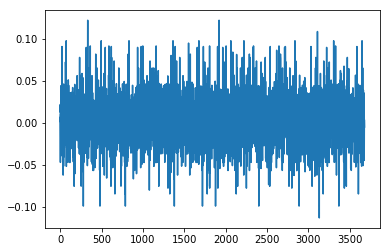

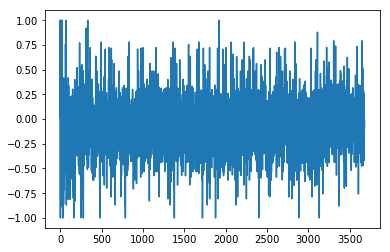

1.31057969756
[ 0.66666667  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667
  0.77777778  0.55555556  0.77777778  0.77777778  0.66666667  0.66666667
  0.77777778  0.77777778  0.66666667  0.77777778  0.77777778  0.66666667
  0.77777778  0.55555556  0.66666667  0.77777778  0.66666667  0.77777778
  0.77777778  0.66666667  0.77777778  0.33333333  0.22222222  0.11111111
  0.66666667  0.66666667  0.55555556  1.          0.55555556  0.88888889
  0.66666667  0.66666667  0.66666667  0.33333333  0.22222222  0.77777778
  0.66666667  0.77777778  0.77777778  0.11111111  0.44444444  0.77777778
  0.11111111  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.77777778  0.66666667  0.77777778  0.77777778  0.88888889]
Writing away results
1985-03-01 00:00:00


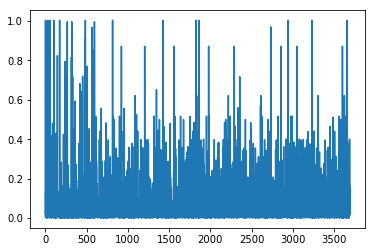

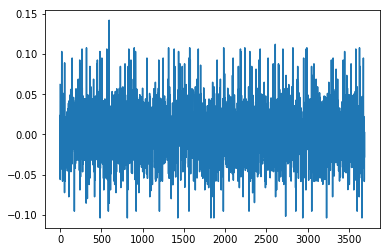

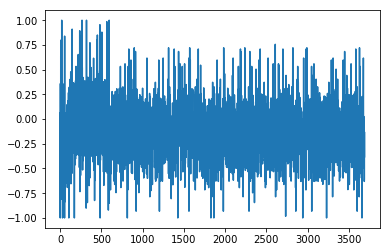

1.43775119565
[ 0.77777778  0.77777778  0.77777778  0.11111111  0.77777778  0.77777778
  0.66666667  0.55555556  0.11111111  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  1.          0.77777778
  0.22222222  0.77777778  0.11111111  0.66666667  0.77777778  0.77777778
  0.77777778  0.77777778  0.66666667  0.88888889  0.33333333  0.77777778
  0.77777778  0.66666667  0.66666667  0.88888889  0.88888889  0.77777778
  0.77777778  0.77777778  0.22222222  0.55555556  0.33333333  0.66666667
  0.77777778  0.11111111  0.11111111  0.77777778  0.77777778  0.22222222
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  1.          0.66666667  0.11111111  0.66666667]
Writing away results
1985-04-01 00:00:00


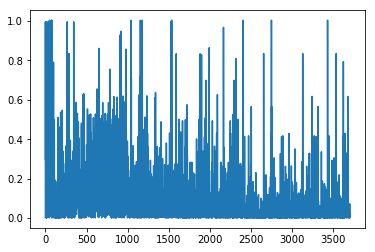

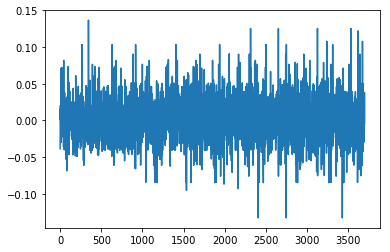

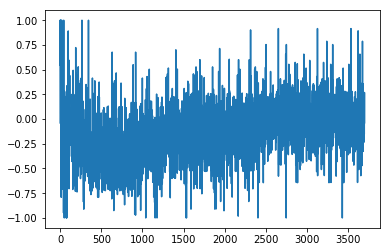

1.41827199202
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444
  0.55555556  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.22222222  0.66666667  0.66666667
  0.44444444  0.77777778  0.88888889  0.77777778  0.66666667  0.66666667
  0.66666667  0.33333333  0.88888889  0.22222222  0.55555556  0.88888889
  0.22222222  0.77777778  0.88888889  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.88888889  0.77777778  0.55555556]
Writing away results
1985-05-01 00:00:00


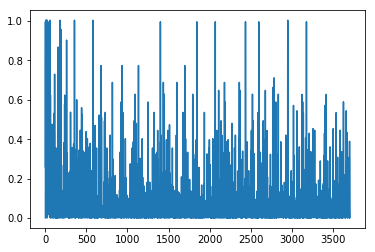

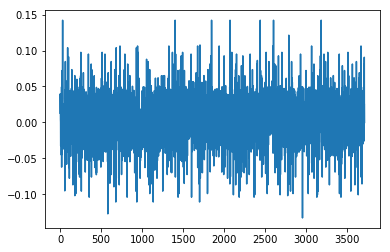

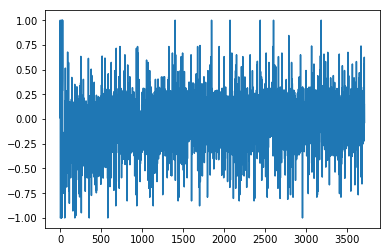

1.36631181122
[ 0.77777778  0.77777778  0.77777778  0.77777778  0.88888889  0.66666667
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  1.          0.77777778  0.33333333  0.66666667
  0.33333333  1.          0.77777778  0.77777778  0.77777778  0.77777778
  0.55555556  0.66666667  0.77777778  0.77777778  0.77777778  0.88888889
  0.88888889  0.66666667  0.          0.77777778  0.77777778  0.77777778
  0.88888889  0.66666667  0.33333333  1.          0.77777778  1.
  0.11111111  0.77777778  0.77777778  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.66666667  0.33333333  0.11111111  0.66666667  0.88888889]
Writing away results
1985-06-01 00:00:00


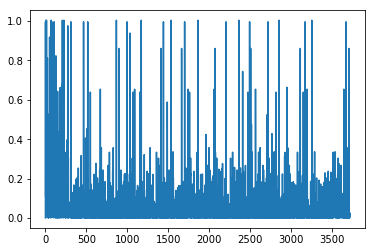

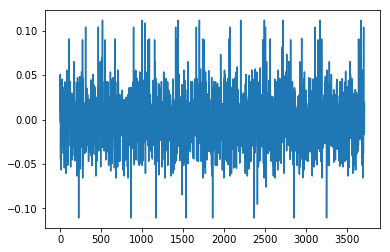

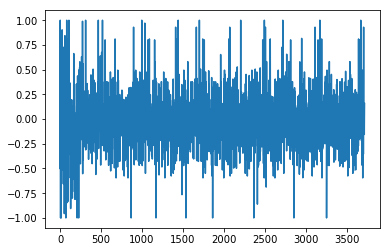

1.40756854422
[ 0.11111111  0.11111111  0.11111111  1.          0.22222222  0.22222222
  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111
  0.11111111  0.88888889  0.22222222  1.          0.          0.22222222
  0.55555556  0.22222222  0.11111111  0.11111111  0.11111111  0.33333333
  0.22222222  0.22222222  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.22222222  0.11111111  0.11111111  0.33333333
  0.22222222  0.11111111  0.55555556  0.22222222  0.22222222  0.55555556
  0.11111111  0.22222222  0.          0.11111111  0.22222222  0.22222222
  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111  0.66666667
  1.          0.55555556  0.55555556  1.          0.55555556]
Writing away results
1985-07-01 00:00:00


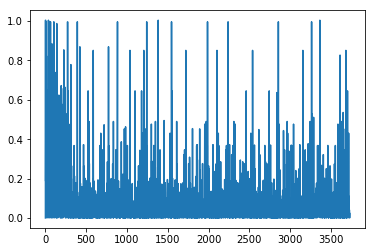

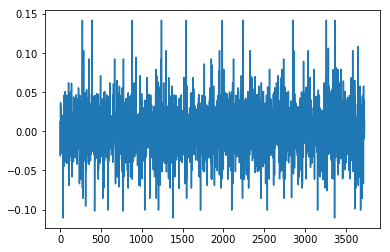

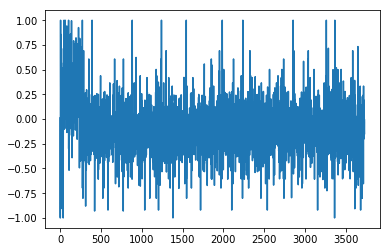

1.48071735203
[ 0.33333333  1.          0.88888889  0.88888889  0.66666667  0.33333333
  1.          1.          1.          0.33333333  0.66666667  1.
  0.55555556  0.55555556  0.          0.33333333  1.          0.33333333
  0.66666667  0.66666667  0.33333333  0.44444444  0.44444444  0.55555556
  0.66666667  0.66666667  0.44444444  0.44444444  0.88888889  0.88888889
  0.77777778  0.33333333  0.          0.44444444  0.44444444  0.77777778
  0.          0.33333333  0.44444444  1.          0.33333333  0.44444444
  0.66666667  0.33333333  0.55555556  0.55555556  0.33333333  1.          1.
  0.          0.33333333  0.55555556  0.55555556  0.          0.33333333
  0.11111111  0.88888889  0.77777778  0.66666667]
Writing away results
1985-08-01 00:00:00


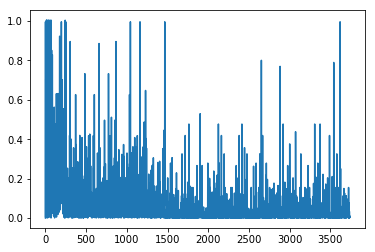

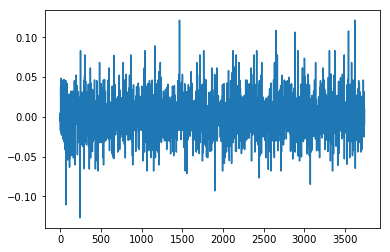

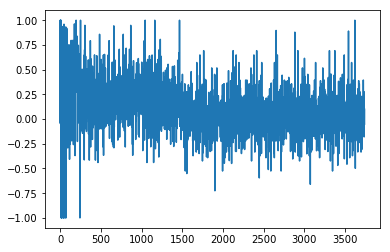

1.24795099332
[ 0.33333333  0.22222222  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.
  0.33333333  0.22222222  0.66666667  0.33333333  0.22222222  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.11111111  0.33333333
  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222
  0.33333333  0.33333333  0.33333333  0.11111111  0.66666667  0.33333333
  0.          0.33333333  0.33333333  0.22222222  0.33333333  0.33333333
  0.88888889  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.55555556  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.33333333]
Writing away results
1985-09-01 00:00:00


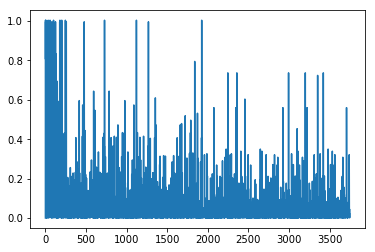

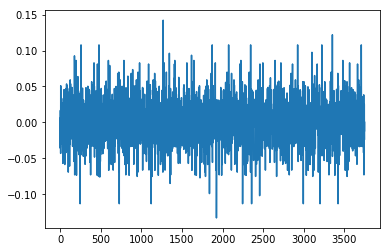

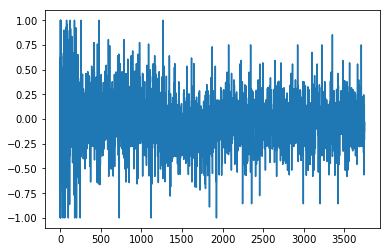

1.18206629159
[ 0.66666667  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556
  0.44444444  0.22222222  0.55555556  0.33333333  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.33333333  0.44444444  0.55555556
  0.55555556  0.55555556  0.11111111  0.22222222  1.          0.22222222
  0.11111111  1.          1.          0.55555556  0.55555556  1.
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.33333333  1.          0.66666667  0.33333333
  0.          0.33333333  0.55555556  0.55555556  0.22222222]
Writing away results
1985-10-01 00:00:00


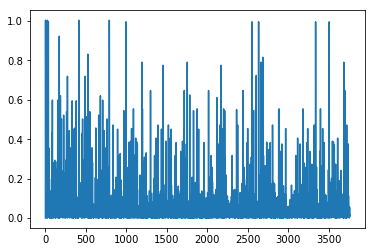

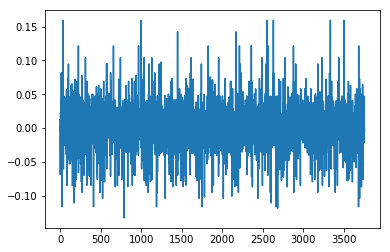

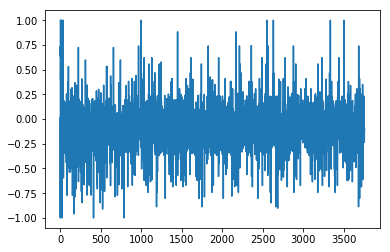

1.08510285541
[ 0.          0.22222222  0.11111111  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.77777778  0.44444444  0.66666667  0.55555556
  0.          0.77777778  0.          0.22222222  0.11111111  0.66666667
  0.66666667  0.77777778  0.77777778  0.11111111  0.11111111  0.66666667
  1.          0.44444444  0.          0.          0.11111111  0.66666667
  0.66666667  0.77777778  0.11111111  0.11111111  0.88888889  0.77777778
  0.11111111  0.88888889  0.66666667  0.77777778  0.11111111  0.66666667
  0.77777778  0.11111111  0.66666667  0.22222222  0.22222222  0.66666667
  0.77777778  0.44444444  0.11111111  1.          0.88888889  0.77777778
  1.          0.22222222  0.11111111  0.88888889  0.55555556]
Writing away results
1985-11-01 00:00:00


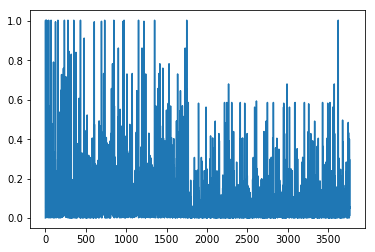

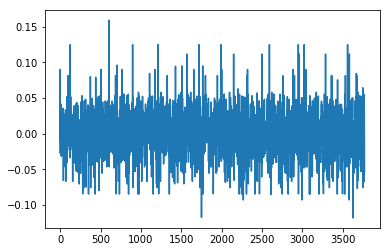

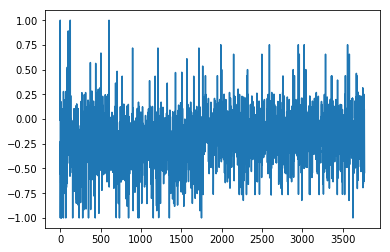

1.12006631221
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.          0.66666667  0.77777778  0.
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.33333333  0.33333333  0.22222222  0.66666667  0.55555556  0.77777778
  0.77777778  0.11111111  1.          0.66666667  0.66666667  0.
  0.11111111  0.33333333  0.88888889  0.66666667  0.11111111  0.11111111
  0.66666667  0.55555556  0.11111111  0.22222222  0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.33333333  0.55555556  0.77777778  0.33333333  0.11111111  0.77777778
  0.33333333  0.11111111  0.66666667  0.77777778  0.77777778]
Writing away results
1985-12-01 00:00:00


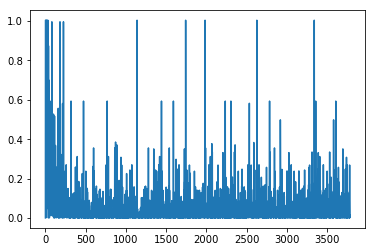

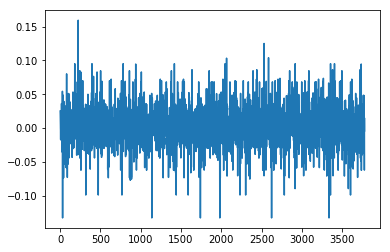

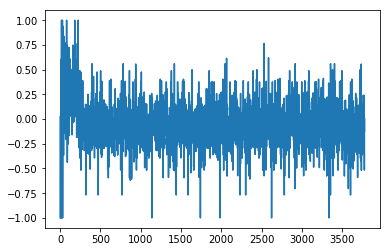

1.06917097476
[ 0.33333333  0.55555556  0.55555556  0.55555556  0.55555556  0.77777778
  0.55555556  0.44444444  0.77777778  0.44444444  0.11111111  0.77777778
  0.44444444  0.77777778  0.33333333  0.55555556  1.          1.
  0.22222222  0.33333333  0.55555556  1.          0.          0.
  0.66666667  0.33333333  0.33333333  1.          1.          0.77777778
  0.11111111  0.44444444  1.          0.77777778  0.33333333  0.44444444
  0.77777778  0.22222222  0.44444444  0.55555556  0.77777778  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  1.          0.77777778
  0.33333333  0.44444444  0.88888889  0.66666667  0.          0.22222222
  0.33333333  0.55555556  1.          0.          0.66666667]
Writing away results
1986-01-01 00:00:00


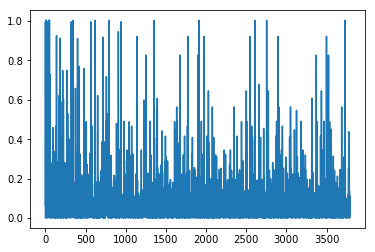

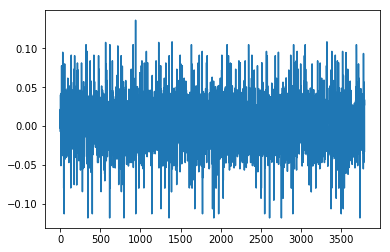

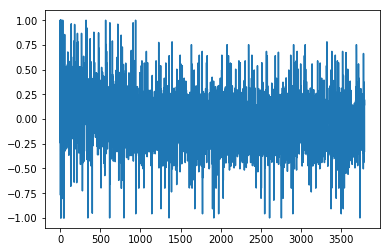

1.07447613324
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.55555556  1.          0.88888889  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222
  0.66666667  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222
  0.88888889  0.11111111  0.88888889  0.77777778  0.66666667  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889
  0.88888889  0.33333333  0.55555556  0.55555556  0.55555556]
Writing away results
1986-02-01 00:00:00


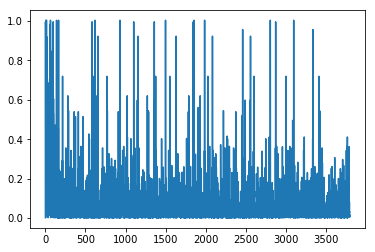

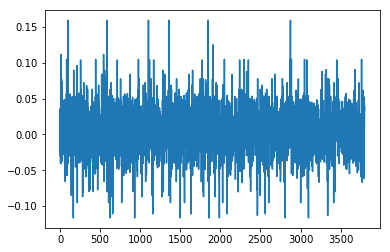

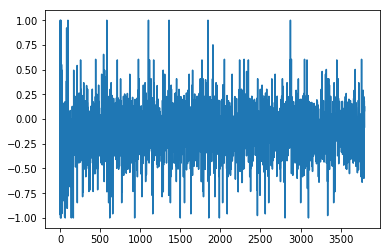

1.01725337421
[ 0.88888889  0.88888889  0.88888889  0.33333333  0.88888889  0.77777778
  0.88888889  0.77777778  0.22222222  0.88888889  0.11111111  0.88888889
  0.88888889  0.22222222  0.          0.          0.          0.
  0.88888889  0.77777778  0.77777778  0.55555556  1.          0.44444444
  0.22222222  0.33333333  0.33333333  0.          0.11111111  0.
  0.77777778  0.33333333  0.66666667  0.44444444  0.33333333  0.88888889
  0.44444444  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.77777778  0.55555556  1.          0.11111111
  0.55555556  0.44444444  0.44444444  0.22222222  0.88888889  0.22222222
  0.77777778  0.55555556  1.          1.          0.88888889]
Writing away results
1986-03-01 00:00:00


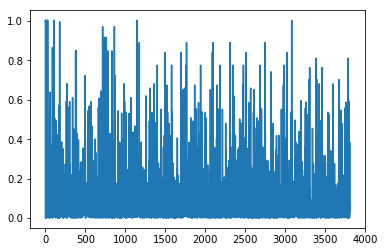

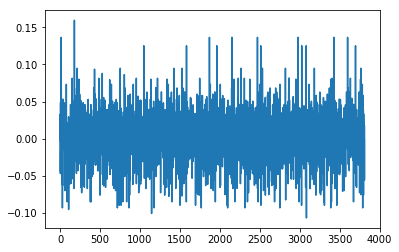

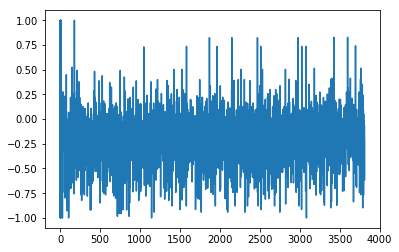

1.32011314317
[ 0.66666667  0.66666667  0.66666667  0.88888889  0.          0.66666667
  0.77777778  1.          0.88888889  1.          0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.44444444  0.33333333  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  1.          0.33333333
  0.66666667  0.66666667  0.88888889  0.33333333  0.11111111  0.11111111
  0.88888889  0.          1.          0.66666667  0.44444444  0.11111111
  0.66666667  0.88888889  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.77777778  0.44444444  0.77777778  0.77777778
  0.77777778  0.77777778  0.66666667  0.          0.22222222  0.77777778
  0.77777778  0.77777778  0.77777778  0.33333333  0.66666667]
Writing away results
1986-04-01 00:00:00


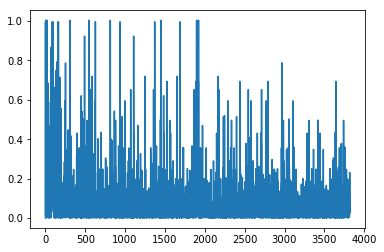

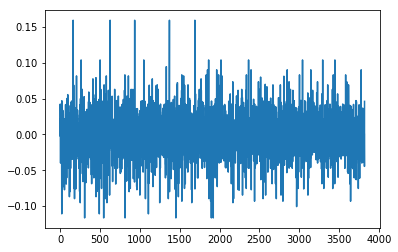

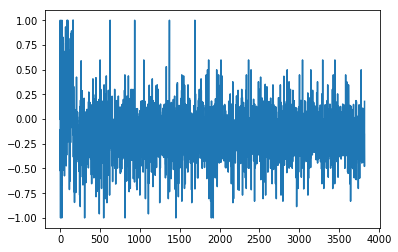

1.34859893178
[ 0.66666667  0.55555556  0.66666667  0.22222222  0.55555556  0.22222222
  0.33333333  0.11111111  0.88888889  0.55555556  0.66666667  0.66666667
  0.55555556  0.55555556  0.33333333  0.77777778  0.66666667  0.66666667
  0.22222222  0.44444444  0.44444444  1.          0.33333333  0.66666667
  0.55555556  0.22222222  0.33333333  0.22222222  0.22222222  0.55555556
  0.11111111  0.22222222  0.55555556  0.55555556  0.66666667  0.
  0.55555556  0.33333333  0.66666667  0.11111111  0.66666667  0.
  0.55555556  0.55555556  0.44444444  0.22222222  0.55555556  0.44444444
  0.77777778  0.33333333  0.66666667  0.          0.22222222  0.44444444
  0.44444444  1.          0.66666667  0.          0.66666667]
Writing away results
1986-05-01 00:00:00


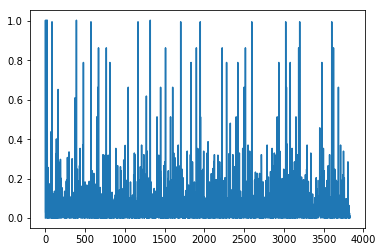

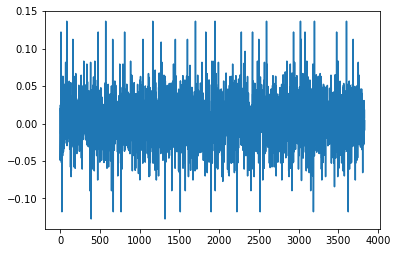

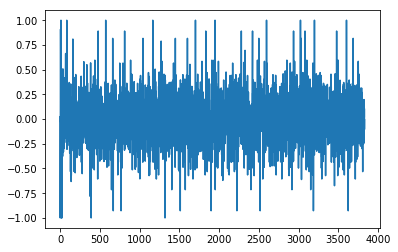

1.15201945226
[ 1.          1.          1.          1.          0.33333333  1.
  0.66666667  1.          1.          1.          1.          1.
  0.77777778  0.22222222  1.          1.          1.          0.22222222
  0.33333333  0.33333333  0.33333333  1.          1.          1.
  0.11111111  1.          0.66666667  0.88888889  0.66666667  0.55555556
  1.          0.66666667  0.66666667  1.          1.          0.66666667
  1.          1.          1.          1.          1.          0.66666667
  0.33333333  0.55555556  0.33333333  0.77777778  0.22222222  0.33333333
  1.          1.          1.          0.22222222  0.33333333  0.33333333
  0.33333333  1.          1.          1.          1.        ]
Writing away results
1986-06-01 00:00:00


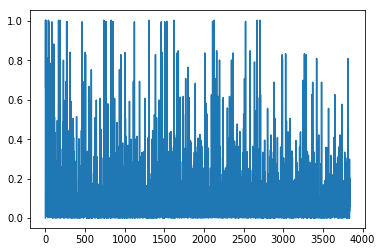

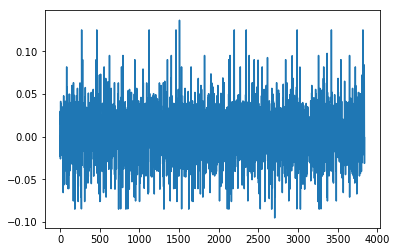

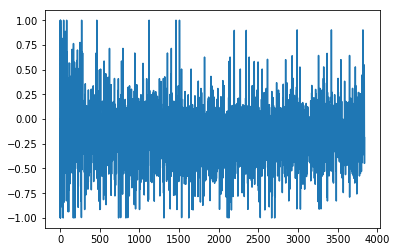

1.17795945956
[ 0.66666667  0.66666667  1.          0.88888889  0.77777778  0.88888889
  0.22222222  1.          0.66666667  0.66666667  0.33333333  0.22222222
  0.77777778  0.55555556  0.55555556  0.66666667  0.          0.77777778
  0.77777778  0.77777778  0.66666667  0.66666667  0.33333333  0.33333333
  1.          0.66666667  0.22222222  0.33333333  0.88888889  0.22222222
  0.33333333  1.          0.          0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.88888889  0.          0.77777778  0.77777778  0.77777778  1.
  0.66666667  0.22222222  0.33333333  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1986-07-01 00:00:00


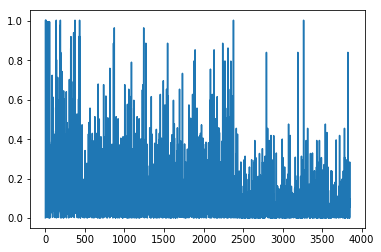

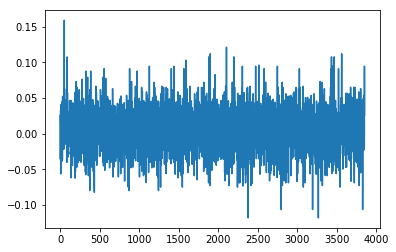

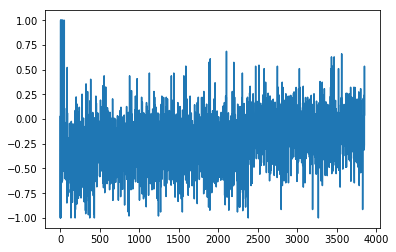

1.25903640359
[ 0.55555556  1.          0.          1.          0.11111111  0.66666667
  1.          0.11111111  0.77777778  0.77777778  0.55555556  0.88888889
  0.88888889  0.77777778  0.55555556  0.55555556  0.22222222  0.22222222
  0.          0.44444444  0.77777778  0.77777778  0.55555556  0.88888889
  0.55555556  0.33333333  1.          0.          0.          0.77777778
  0.88888889  0.          0.77777778  1.          0.44444444  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  1.          0.
  0.55555556  0.33333333  0.          0.66666667  1.          0.
  0.77777778  0.55555556  0.22222222  0.66666667  0.66666667  0.
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1986-08-01 00:00:00


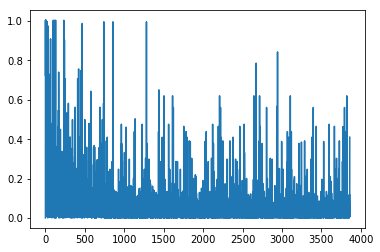

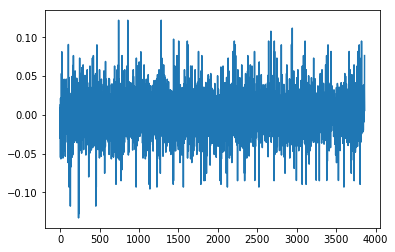

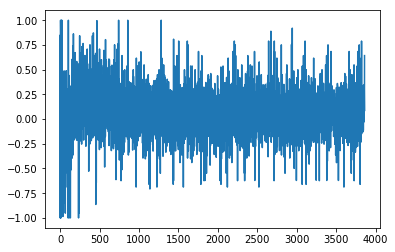

1.2142305183
[ 0.66666667  1.          0.55555556  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.77777778
  0.          0.          0.55555556  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.        ]
Writing away results
1986-09-01 00:00:00


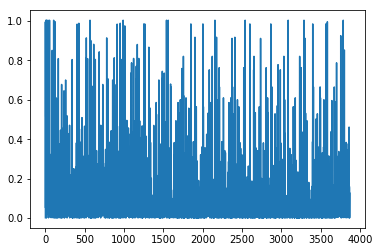

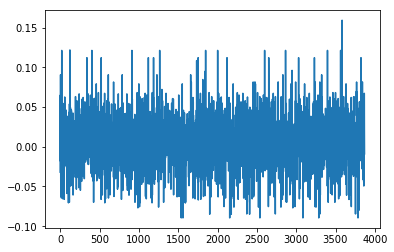

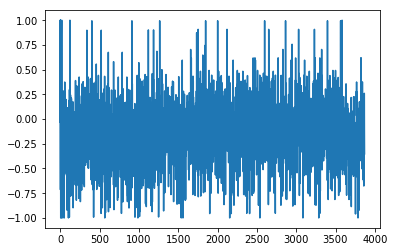

1.28551146835
[ 0.11111111  1.          0.22222222  0.88888889  1.          0.66666667
  0.66666667  0.66666667  0.33333333  0.22222222  0.44444444  0.66666667
  0.66666667  0.55555556  0.77777778  0.77777778  1.          1.
  0.66666667  0.66666667  0.55555556  1.          0.          0.33333333
  0.33333333  1.          0.          0.66666667  1.          0.
  0.66666667  0.22222222  1.          0.66666667  1.          0.66666667
  0.66666667  0.33333333  0.77777778  1.          0.11111111  0.77777778
  0.77777778  0.11111111  1.          0.44444444  0.44444444  0.55555556
  0.77777778  0.77777778  0.77777778  1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.          1.        ]
Writing away results
1986-10-01 00:00:00


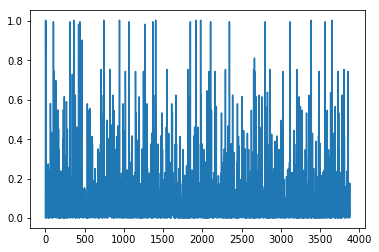

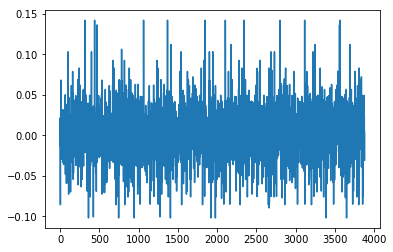

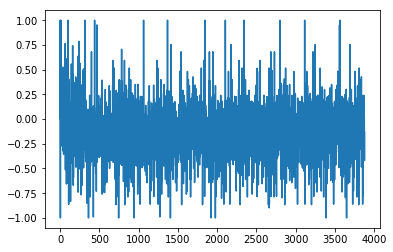

1.29448537829
[ 0.33333333  0.66666667  0.77777778  0.33333333  0.66666667  0.33333333
  0.66666667  0.66666667  0.55555556  1.          0.33333333  0.66666667
  0.88888889  0.88888889  0.88888889  0.77777778  0.33333333  0.66666667
  0.66666667  0.66666667  0.33333333  1.          0.22222222  0.66666667
  1.          0.44444444  0.66666667  0.66666667  1.          0.33333333
  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.          0.88888889  0.22222222  0.77777778  0.88888889
  0.77777778  0.33333333  0.66666667  0.33333333  0.88888889  0.88888889
  0.88888889  0.77777778  1.          0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667]
Writing away results
1986-11-01 00:00:00


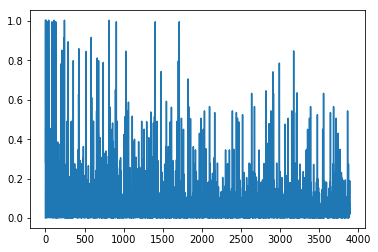

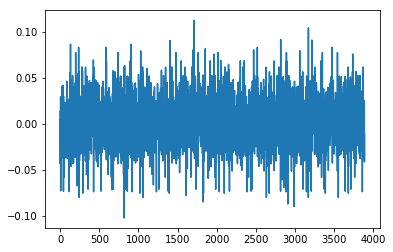

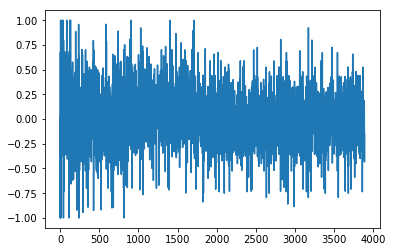

1.16944259983
[ 0.55555556  0.33333333  0.          0.55555556  0.55555556  0.55555556
  0.44444444  0.          0.55555556  0.55555556  0.55555556  0.33333333
  0.33333333  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.55555556  1.          0.          0.55555556
  1.          0.          0.          0.55555556  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.88888889  0.          0.33333333  0.88888889  0.33333333  0.33333333
  0.          0.55555556  0.55555556  0.55555556  0.33333333  0.33333333
  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.44444444  0.55555556  0.55555556]
Writing away results
1986-12-01 00:00:00


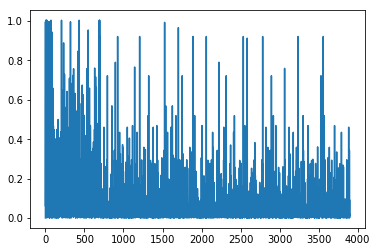

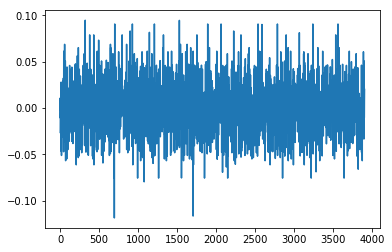

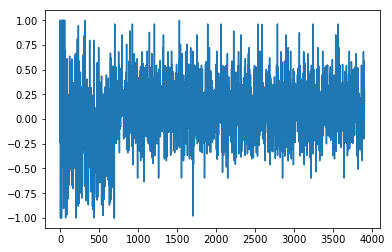

1.24882445022
[ 0.55555556  0.          0.          0.          0.          1.
  0.11111111  0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.          0.          0.11111111
  0.          0.          0.55555556  0.          0.          0.55555556
  0.          0.          0.55555556  0.          0.          0.          0.
  0.          0.          0.          0.          0.66666667  0.88888889
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.77777778  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.        ]
Writing away results
1987-01-01 00:00:00


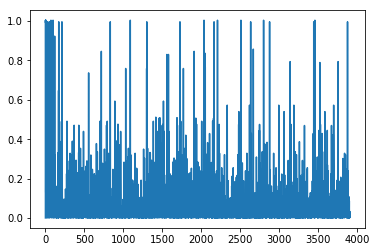

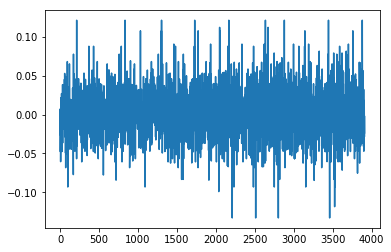

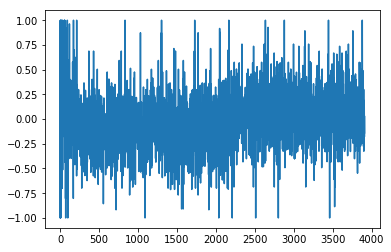

1.11492460052
[ 1.          0.33333333  0.33333333  1.          1.          1.
  0.33333333  0.33333333  1.          0.55555556  0.22222222  0.22222222
  0.22222222  0.33333333  1.          1.          0.44444444  0.22222222
  0.77777778  0.88888889  1.          0.77777778  0.77777778  1.          1.
  0.77777778  1.          1.          0.33333333  0.33333333  1.
  0.33333333  1.          1.          0.44444444  0.33333333  0.55555556
  0.22222222  0.44444444  0.77777778  1.          0.33333333  0.33333333
  0.44444444  0.22222222  0.22222222  0.22222222  0.33333333  0.33333333
  1.          1.          1.          1.          0.55555556  1.          1.
  0.33333333  1.          0.33333333]
Writing away results
1987-02-01 00:00:00


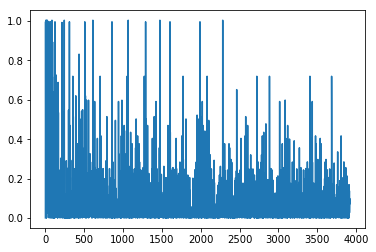

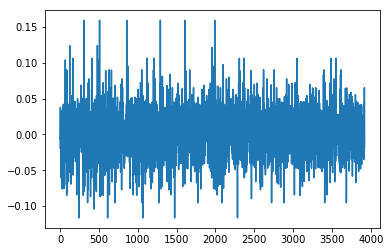

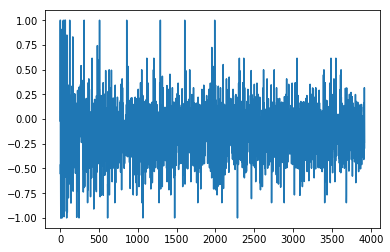

1.269224254
[ 0.88888889  0.77777778  0.11111111  0.11111111  0.11111111  0.88888889
  0.77777778  0.22222222  0.22222222  0.11111111  0.66666667  0.88888889
  0.77777778  0.44444444  0.77777778  0.11111111  0.77777778  0.66666667
  0.22222222  0.77777778  0.66666667  0.33333333  0.77777778  0.77777778
  0.33333333  0.77777778  0.11111111  0.          0.          0.77777778
  0.44444444  0.77777778  0.11111111  0.11111111  0.88888889  0.66666667
  0.77777778  0.66666667  1.          0.77777778  0.66666667  0.77777778
  0.66666667  0.11111111  0.66666667  1.          0.88888889  0.77777778
  0.77777778  0.44444444  0.22222222  0.11111111  0.33333333  0.77777778
  0.66666667  0.          0.77777778  0.44444444  0.77777778]
Writing away results
1987-03-01 00:00:00


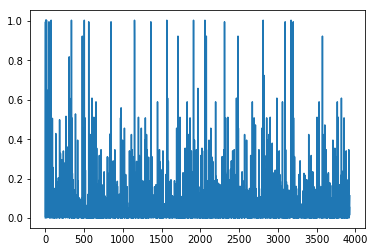

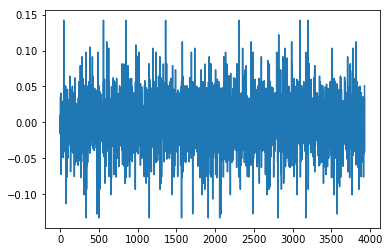

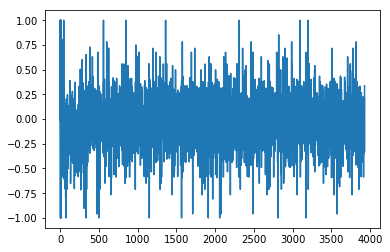

1.19833089492
[ 0.66666667  0.66666667  0.66666667  0.          0.22222222  0.66666667
  0.66666667  0.88888889  0.88888889  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.11111111  0.          1.          0.66666667
  0.66666667  0.77777778  1.          0.66666667  0.          0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          1.          0.77777778  0.88888889
  0.77777778  0.77777778  0.          0.11111111  0.66666667  0.88888889
  0.88888889  0.88888889  0.77777778  1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  1.        ]
Writing away results
1987-04-01 00:00:00


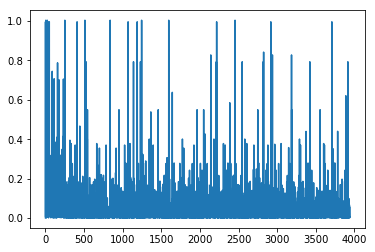

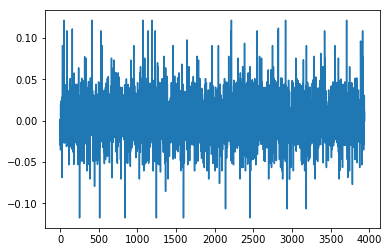

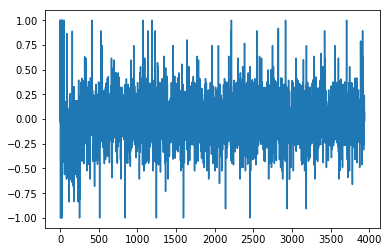

1.14974492311
[ 0.44444444  0.11111111  0.66666667  0.44444444  0.44444444  0.44444444
  0.33333333  0.55555556  0.55555556  0.22222222  0.44444444  0.44444444
  0.44444444  0.33333333  0.88888889  0.44444444  0.33333333  0.44444444
  0.22222222  0.33333333  0.44444444  0.44444444  1.          0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.11111111  0.77777778  0.44444444  0.33333333  0.55555556  0.66666667
  0.22222222  0.44444444  0.44444444  0.88888889  0.33333333  0.55555556
  0.55555556  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.33333333  0.88888889  0.44444444  0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889]
Writing away results
1987-05-01 00:00:00


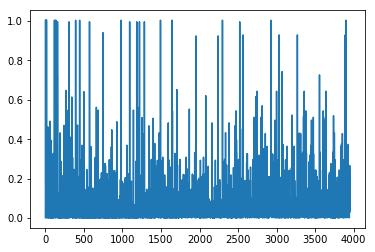

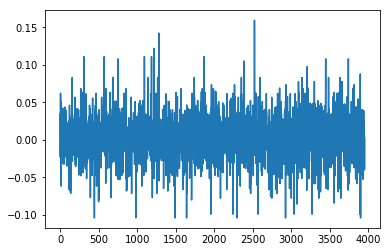

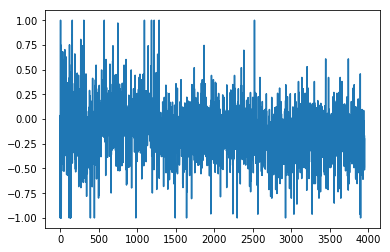

1.0894945683
[ 0.77777778  1.          1.          0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.22222222  0.11111111  0.77777778  0.55555556
  0.77777778  1.          0.77777778  0.44444444  0.77777778  0.
  0.11111111  0.55555556  0.77777778  0.          0.11111111  0.77777778
  0.          0.33333333  0.55555556  0.77777778  0.55555556  0.77777778
  0.88888889  0.77777778  0.22222222  0.44444444  0.22222222  0.22222222
  1.          0.77777778  0.11111111  0.66666667  0.66666667  0.66666667
  1.          0.          0.11111111  0.77777778  0.77777778  0.33333333
  0.77777778  0.77777778  0.11111111  0.77777778  0.          0.33333333
  0.33333333  0.55555556  0.77777778  0.11111111  0.77777778]
Writing away results
1987-06-01 00:00:00


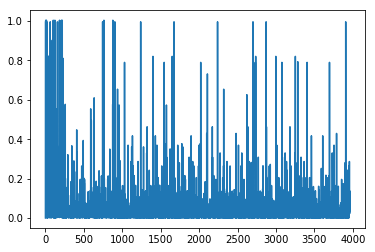

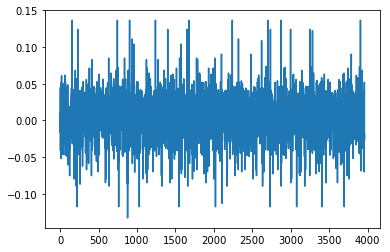

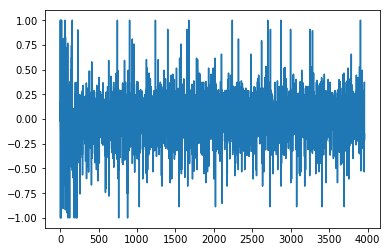

1.05135952473
[ 0.          0.22222222  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.77777778  0.66666667  0.66666667  0.66666667
  1.          0.66666667  1.          0.66666667  0.11111111  1.
  0.66666667  0.66666667  0.22222222  1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.11111111  0.11111111  0.          0.11111111  0.11111111  0.77777778
  0.66666667  1.          0.66666667  0.11111111  0.11111111  0.11111111
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.55555556  0.66666667  0.66666667
  0.77777778  0.66666667  1.          0.66666667  1.        ]
Writing away results
1987-07-01 00:00:00


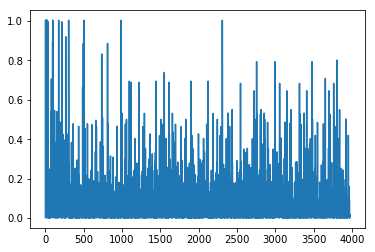

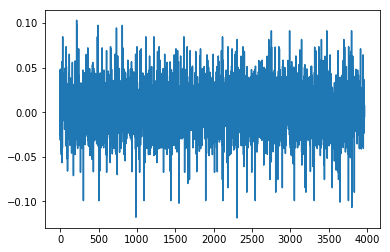

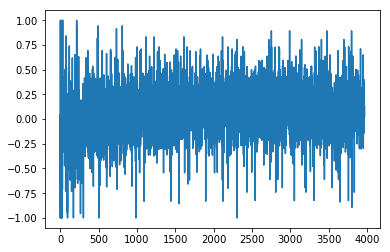

1.15558148558
[ 0.77777778  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.55555556  0.66666667  0.33333333  0.55555556  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.22222222  0.44444444  0.44444444  0.44444444  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444]
Writing away results
1987-08-01 00:00:00


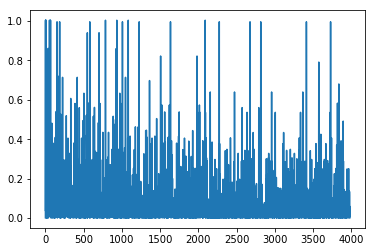

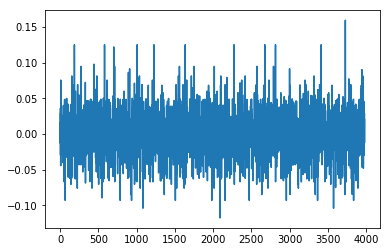

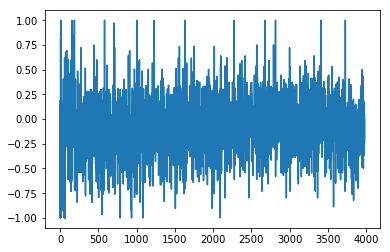

1.27658005178
[ 0.44444444  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778
  0.44444444  0.44444444  0.44444444  0.77777778  0.          0.66666667
  0.88888889  0.44444444  0.66666667  0.88888889  0.44444444  0.44444444
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.11111111  0.          0.77777778
  0.77777778  0.77777778  0.77777778  0.44444444  0.44444444  0.44444444
  0.55555556  0.77777778  0.77777778  0.77777778  0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.77777778  0.44444444  0.66666667]
Writing away results
1987-09-01 00:00:00


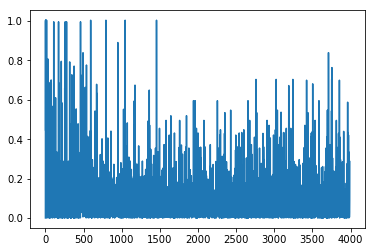

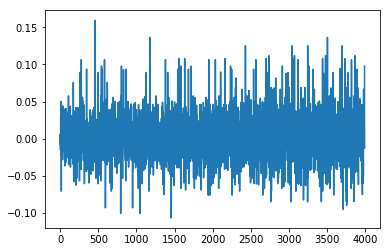

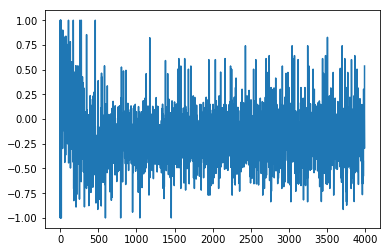

1.64425965181
[ 0.22222222  0.11111111  0.77777778  0.77777778  0.77777778  0.33333333
  0.66666667  1.          1.          0.55555556  0.22222222  0.77777778
  1.          0.          0.77777778  1.          1.          0.22222222
  1.          1.          0.          0.          0.          0.66666667
  0.66666667  1.          0.88888889  0.          0.77777778  0.11111111
  0.88888889  0.77777778  1.          0.          0.33333333  0.22222222
  0.77777778  0.77777778  0.77777778  0.33333333  0.66666667  0.66666667
  0.66666667  1.          1.          0.22222222  1.          0.44444444
  0.33333333  0.          0.22222222  0.55555556  0.44444444  0.66666667
  1.          0.77777778  0.          0.77777778  0.        ]
Writing away results
1987-10-01 00:00:00


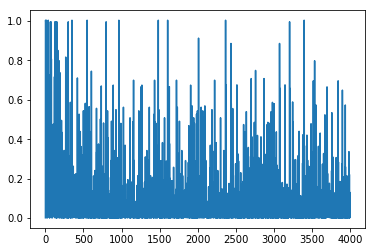

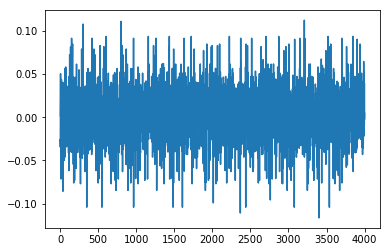

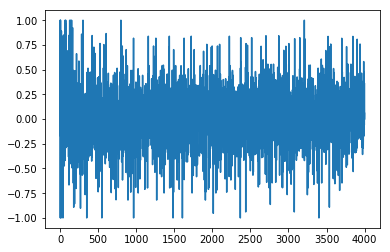

1.2583480363
[ 0.88888889  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.55555556  0.88888889  0.66666667
  0.          0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.55555556  0.66666667  0.88888889  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.66666667  0.55555556  0.66666667
  0.66666667  0.          0.66666667  0.55555556  0.66666667  0.55555556
  0.33333333  0.          0.66666667  0.66666667  0.66666667]
Writing away results
1987-11-01 00:00:00


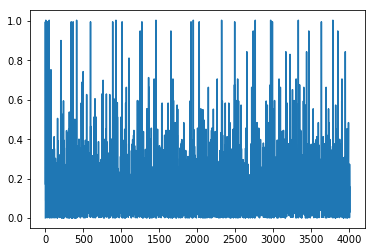

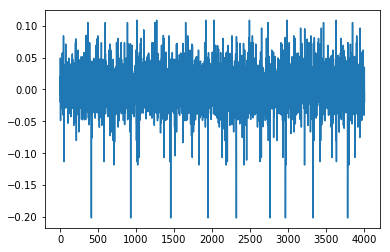

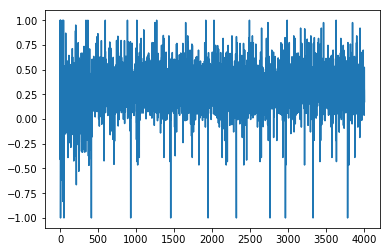

1.40764158328
[ 0.44444444  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.44444444  0.88888889  0.88888889
  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444
  0.88888889  0.44444444  0.88888889  0.88888889  0.88888889]
Writing away results
1987-12-01 00:00:00


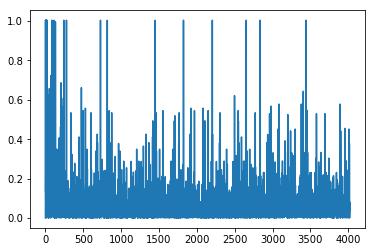

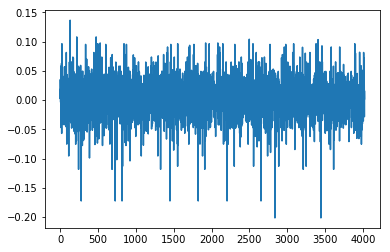

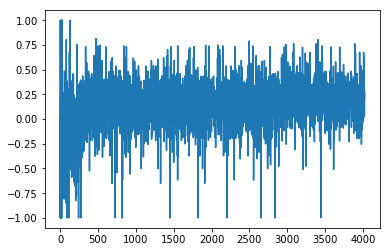

1.4379047242
[ 0.55555556  0.33333333  0.22222222  0.22222222  0.88888889  0.88888889
  0.22222222  0.22222222  0.33333333  0.88888889  0.22222222  0.33333333
  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.77777778  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.77777778
  0.22222222  0.22222222  0.22222222  0.88888889  0.55555556  0.22222222
  0.33333333  0.22222222  0.66666667  0.22222222  0.88888889]
Writing away results
1988-01-01 00:00:00


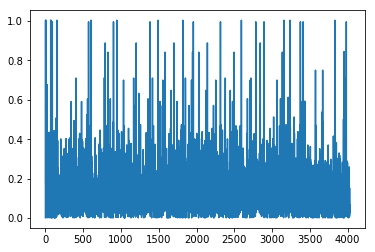

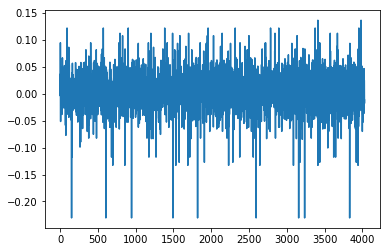

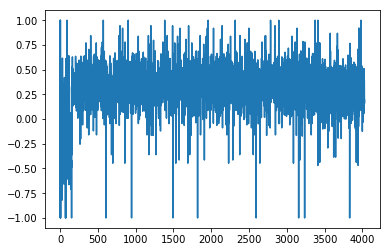

1.47653104262
[ 0.22222222  1.          1.          1.          0.66666667  1.          1.
  0.22222222  1.          0.11111111  0.44444444  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.22222222  0.11111111
  0.22222222  1.          1.          1.          1.          1.        ]
Writing away results
1988-02-01 00:00:00


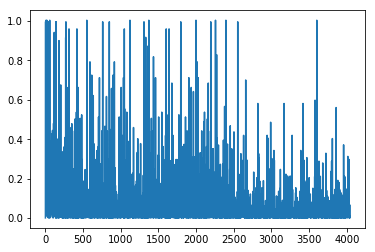

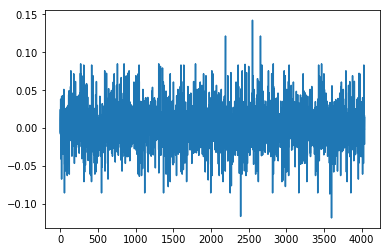

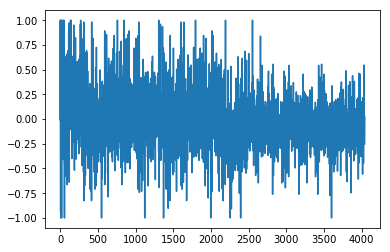

1.41150757548
[ 0.44444444  0.44444444  0.44444444  1.          0.55555556  0.44444444
  0.22222222  0.77777778  0.          0.44444444  0.77777778  0.77777778
  0.44444444  0.44444444  0.77777778  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.22222222  0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.77777778  0.44444444  0.44444444
  0.22222222  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.77777778
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.77777778  0.22222222  0.          0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1988-03-01 00:00:00


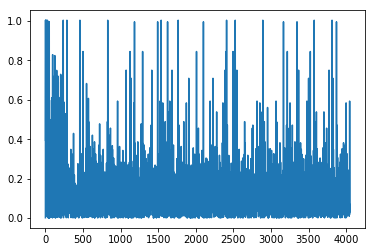

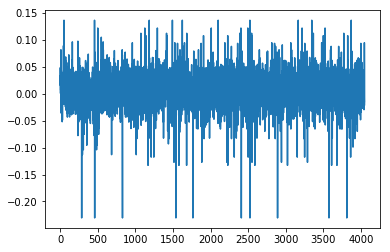

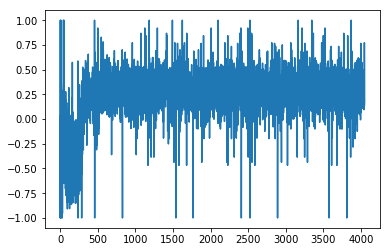

1.55097881353
[ 1.          1.          0.66666667  1.          1.          1.          1.
  0.55555556  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.33333333  0.          0.33333333  0.33333333  0.33333333  0.33333333
  1.          1.          1.          0.33333333  0.33333333  0.33333333
  0.33333333  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.33333333  0.33333333  0.33333333
  1.          1.          1.          1.          1.          1.          1.        ]
Writing away results
1988-04-01 00:00:00


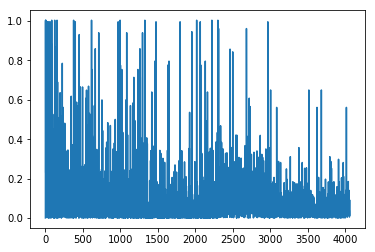

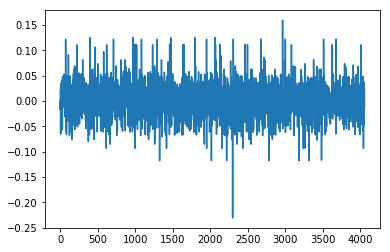

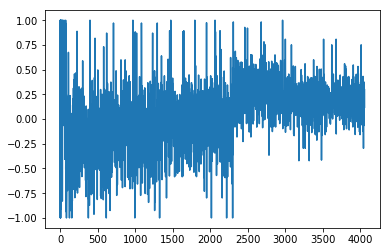

1.36562124109
[ 0.33333333  0.33333333  0.66666667  0.33333333  0.44444444  0.33333333
  0.33333333  0.88888889  0.33333333  0.33333333  0.77777778  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.44444444  0.33333333  0.77777778  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.77777778  0.44444444
  0.44444444  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  1.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.44444444  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1988-05-01 00:00:00


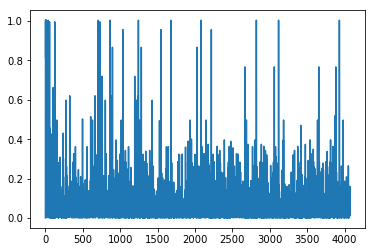

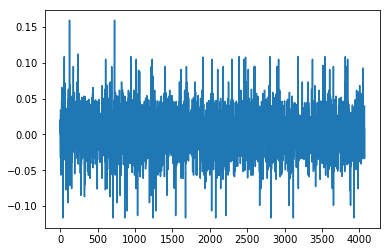

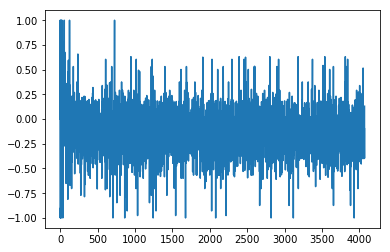

1.40410066582
[ 0.77777778  0.11111111  0.          0.66666667  0.22222222  0.88888889
  0.33333333  0.22222222  0.11111111  0.          0.66666667  0.88888889
  0.88888889  0.88888889  0.22222222  0.          0.66666667  0.88888889
  0.22222222  0.77777778  0.66666667  0.22222222  0.55555556  1.
  0.22222222  0.88888889  0.66666667  0.66666667  0.55555556  0.55555556
  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.22222222  0.88888889  0.88888889  0.22222222
  0.88888889  0.22222222  0.          0.33333333  0.          0.33333333
  0.77777778  0.88888889  0.22222222  0.88888889  0.22222222  0.22222222
  0.11111111  0.88888889  0.88888889  0.88888889  0.22222222]
Writing away results
1988-06-01 00:00:00


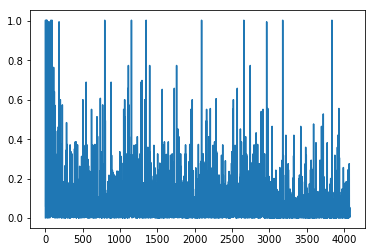

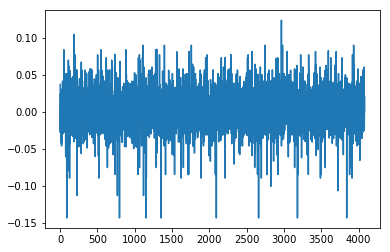

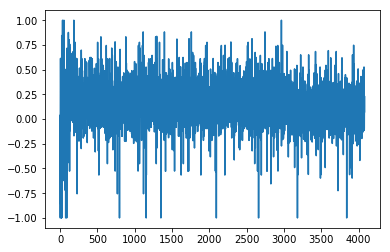

1.31774756718
[ 0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.88888889
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1988-07-01 00:00:00


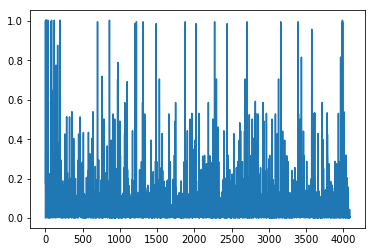

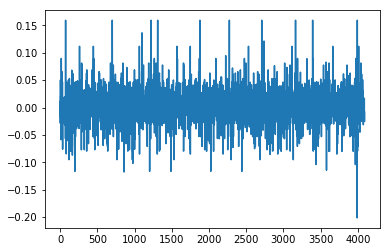

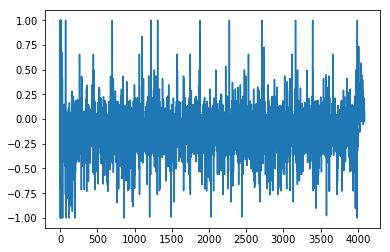

1.38381552513
[ 0.55555556  0.77777778  0.88888889  0.66666667  0.33333333  0.33333333
  0.33333333  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.88888889  0.55555556  0.          0.
  1.          1.          0.11111111  0.22222222  0.55555556  0.22222222
  0.55555556  1.          1.          0.66666667  0.44444444  0.33333333
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.33333333
  0.55555556  0.22222222  0.22222222  0.55555556  0.33333333  0.22222222
  0.33333333  0.88888889  0.66666667  0.55555556  0.55555556  0.22222222
  0.55555556  0.33333333  0.33333333  0.33333333  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333]
Writing away results
1988-08-01 00:00:00


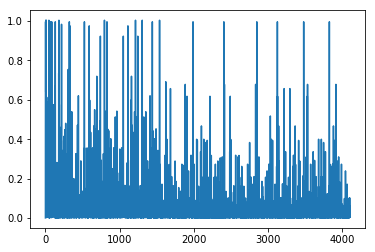

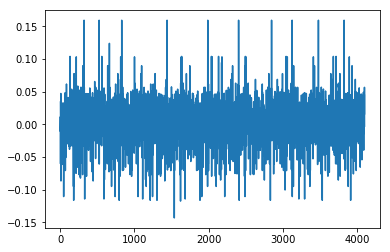

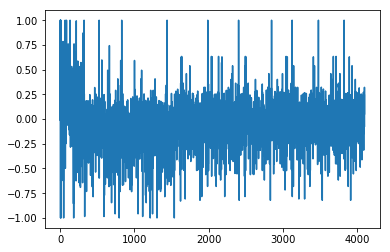

1.45640716536
[ 0.22222222  0.11111111  1.          0.22222222  0.55555556  0.55555556
  0.77777778  0.55555556  0.55555556  0.          0.55555556  0.55555556
  0.55555556  0.44444444  0.55555556  0.22222222  1.          1.
  0.22222222  1.          1.          0.11111111  0.55555556  0.
  0.55555556  1.          1.          1.          0.33333333  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.55555556  0.          0.55555556  0.55555556  0.11111111  0.          0.
  0.55555556  1.          0.11111111  0.22222222  0.11111111  0.          0.
  0.55555556  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556]
Writing away results
1988-09-01 00:00:00


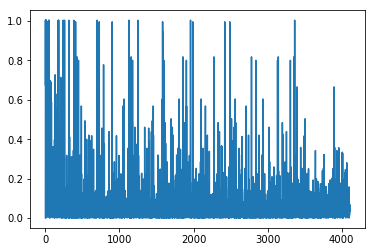

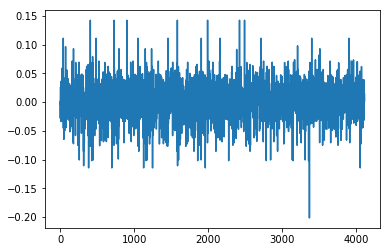

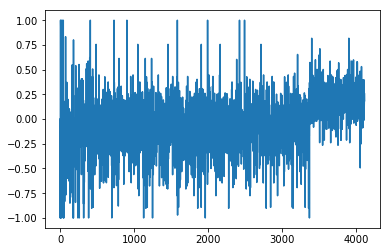

1.48414192769
[ 0.55555556  0.55555556  0.11111111  0.55555556  0.55555556  0.44444444
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.11111111  0.55555556  0.33333333  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.55555556  0.55555556  0.11111111  0.44444444
  0.44444444  0.88888889  0.88888889  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.44444444  0.55555556  0.55555556
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.55555556  0.44444444  0.55555556  0.11111111  0.55555556  0.55555556
  0.11111111  0.55555556  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111]
Writing away results
1988-10-01 00:00:00


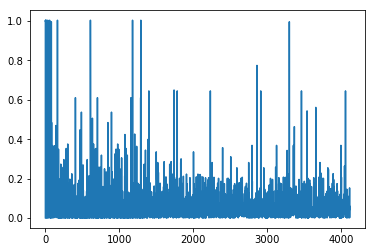

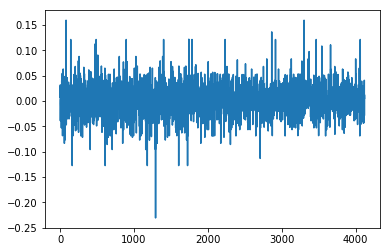

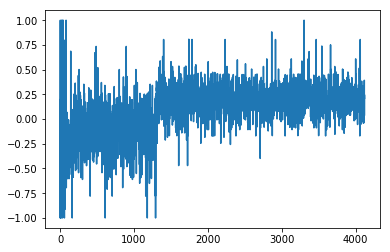

1.28379773808
[ 0.33333333  0.11111111  0.33333333  0.33333333  0.11111111  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.22222222  0.33333333  0.22222222  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1988-11-01 00:00:00


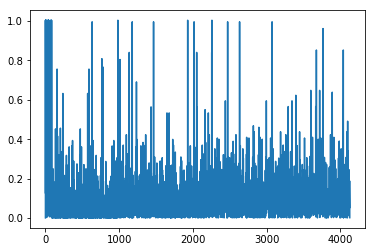

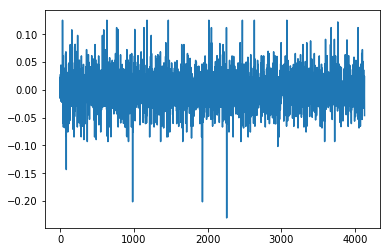

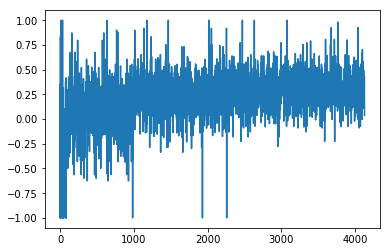

1.38853529336
[ 0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          0.77777778  0.66666667  0.55555556  0.77777778  0.66666667
  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.22222222  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1988-12-01 00:00:00


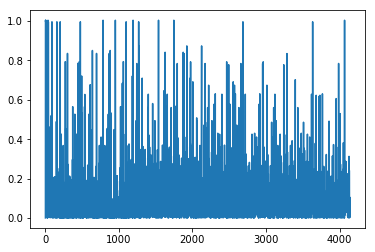

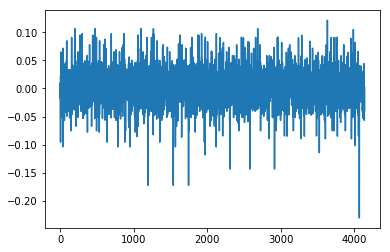

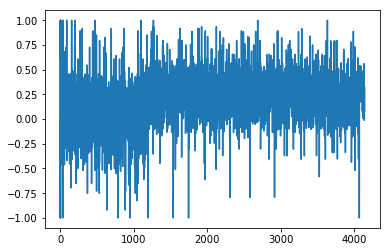

1.41207950778
[ 0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  1.          0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.22222222
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1989-01-01 00:00:00


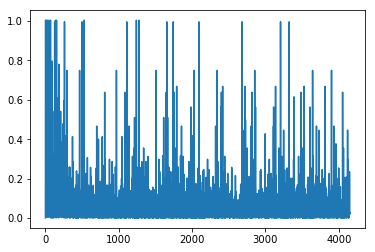

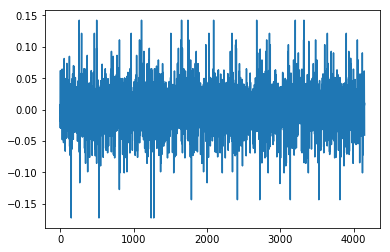

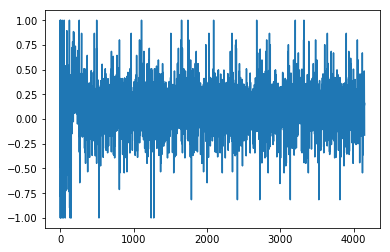

1.42035207323
[ 0.66666667  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1989-02-01 00:00:00


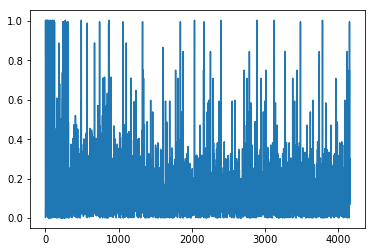

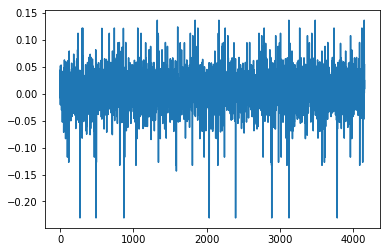

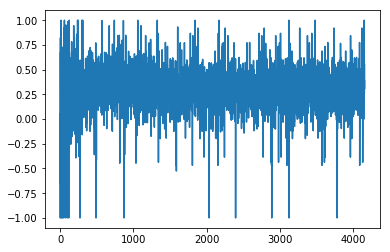

1.55082200026
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.          0.22222222  0.          0.          0.
  0.          1.          1.          1.          0.          0.          0.
  0.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.          0.33333333  0.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.        ]
Writing away results
1989-03-01 00:00:00


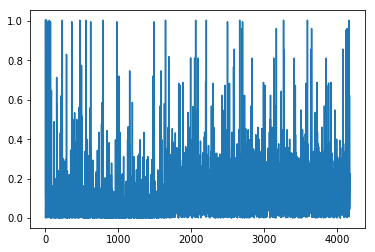

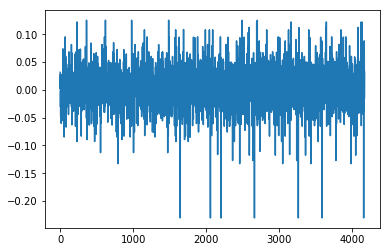

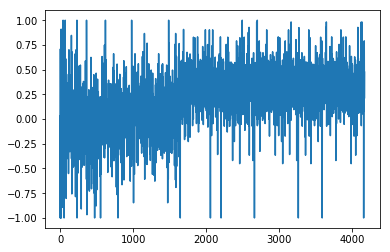

1.40301696252
[ 1.          1.          1.          1.          1.          1.          1.
  1.          0.77777778  0.55555556  0.          0.66666667  0.77777778
  0.          1.          1.          1.          0.          0.          0.
  0.77777778  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.77777778  1.          0.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.        ]
Writing away results
1989-04-01 00:00:00


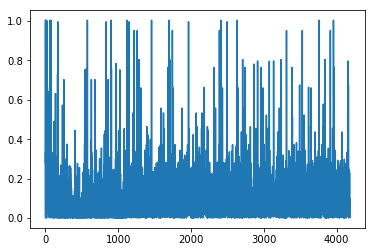

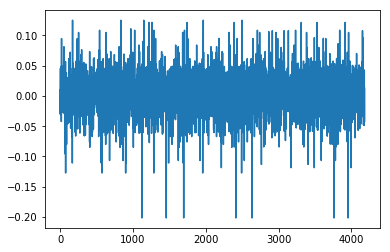

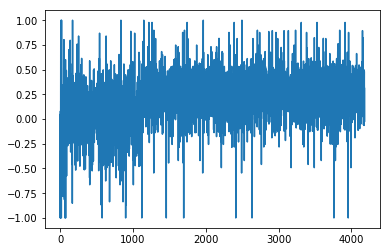

1.37669648716
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.44444444  0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667]
Writing away results
1989-05-01 00:00:00


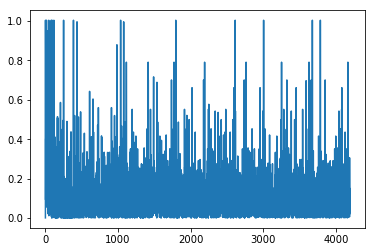

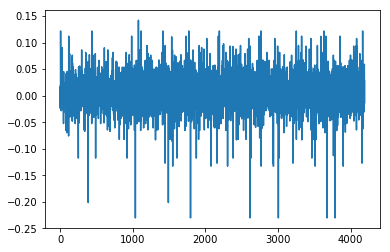

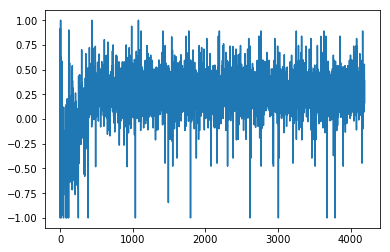

1.39765290691
[ 1.          1.          1.          1.          1.          1.
  0.33333333  0.          0.33333333  0.33333333  0.33333333  0.33333333
  1.          1.          1.          0.33333333  0.33333333  0.33333333
  0.33333333  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.33333333  0.          0.33333333
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.33333333
  0.33333333]
Writing away results
1989-06-01 00:00:00


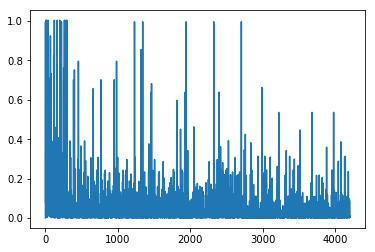

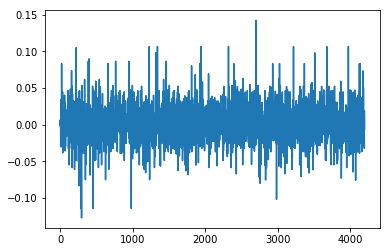

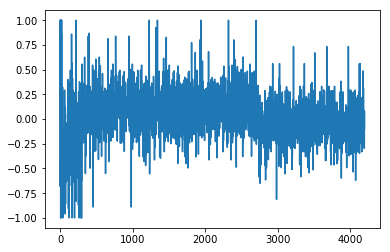

1.23473248465
[ 0.          0.          0.          0.          0.          0.66666667
  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.
  0.          0.55555556  0.22222222  0.22222222  0.22222222  0.33333333
  0.          0.          0.          0.          0.          0.55555556
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.22222222  0.          0.22222222  0.          0.
  0.          0.          0.33333333  0.          0.          0.          0.
  0.          0.          0.          0.77777778  0.          0.          0.
  0.          0.33333333  0.          0.22222222  0.22222222  0.22222222]
Writing away results
1989-07-01 00:00:00


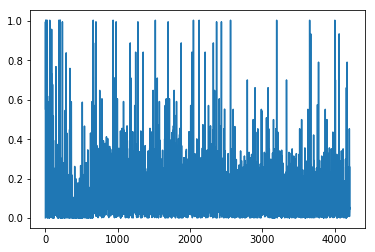

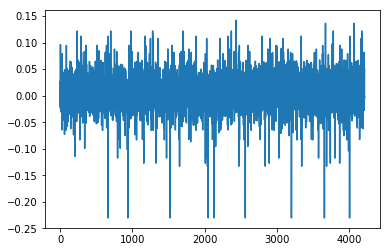

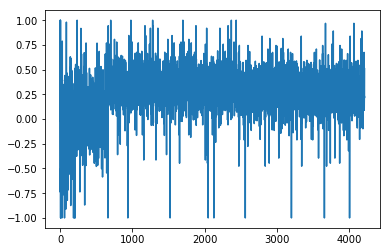

1.18815075746
[ 1.          1.          1.          1.          0.33333333  1.
  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.33333333  0.77777778  0.33333333  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1989-08-01 00:00:00


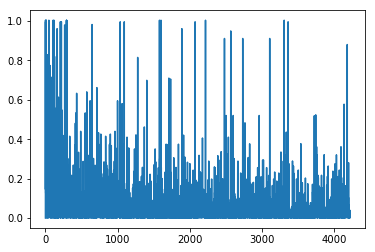

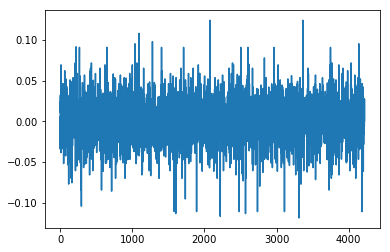

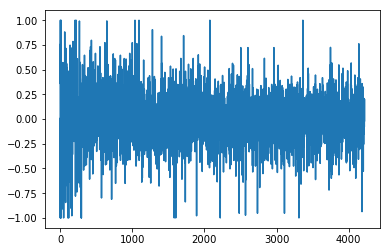

1.1560791355
[ 0.          0.22222222  0.          0.44444444  1.          0.55555556
  0.44444444  0.55555556  0.55555556  0.          0.          0.22222222
  0.44444444  0.55555556  0.55555556  0.55555556  0.11111111  0.          0.
  0.          0.          0.          0.          0.22222222  0.
  0.11111111  0.22222222  0.          0.22222222  0.11111111  0.22222222
  0.          0.55555556  0.          1.          0.          0.11111111
  0.22222222  0.22222222  0.22222222  0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.          0.11111111  0.          0.
  0.22222222  0.22222222  0.22222222  0.          1.          0.55555556
  0.55555556  0.55555556  0.55555556]
Writing away results
1989-09-01 00:00:00


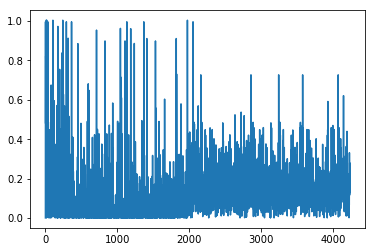

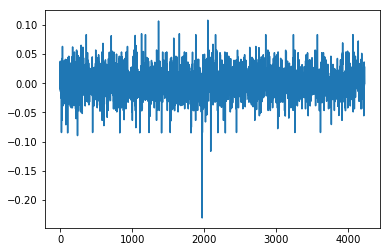

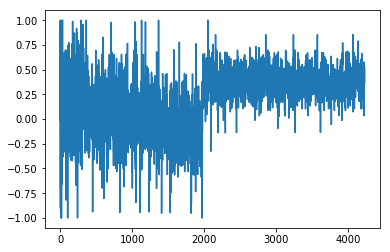

1.17700922817
[ 0.11111111  0.11111111  0.22222222  0.11111111  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111  0.66666667
  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.22222222  0.77777778  0.22222222  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1989-10-01 00:00:00


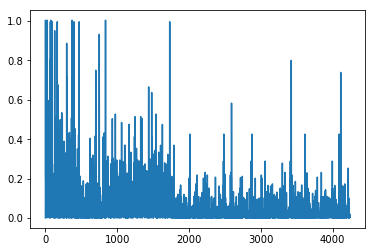

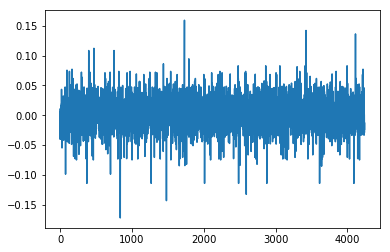

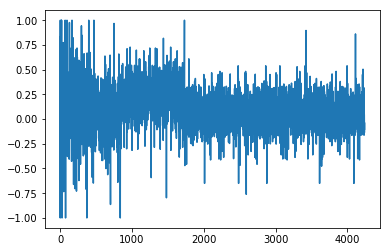

1.27909597374
[ 0.55555556  0.44444444  0.22222222  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.66666667  0.44444444
  0.44444444  0.44444444  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  0.22222222  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556]
Writing away results
1989-11-01 00:00:00


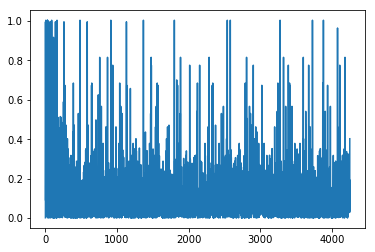

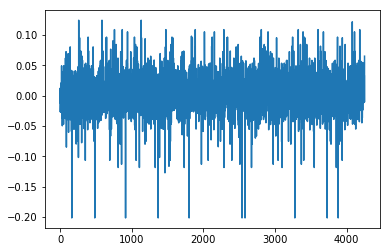

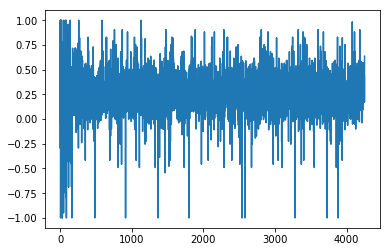

1.19987800712
[ 0.          0.44444444  0.          0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.44444444  0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.77777778
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.44444444  0.          0.          0.          0.
  0.88888889  0.88888889  0.44444444]
Writing away results
1989-12-01 00:00:00


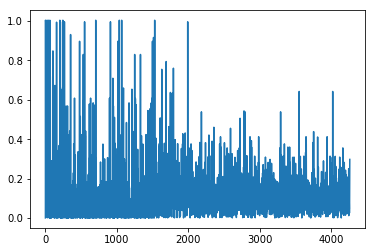

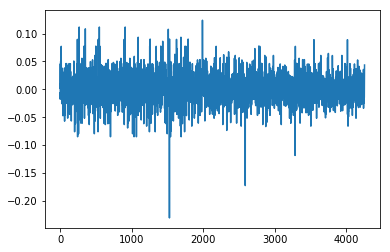

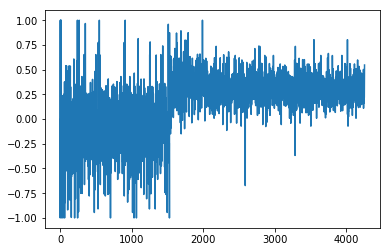

1.14582053178
[ 0.66666667  0.33333333  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.22222222  0.          0.11111111  0.11111111  0.11111111
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111  0.22222222
  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.11111111  0.11111111  0.11111111
  0.11111111  0.22222222  0.22222222  0.33333333  0.22222222]
Writing away results
1990-01-01 00:00:00


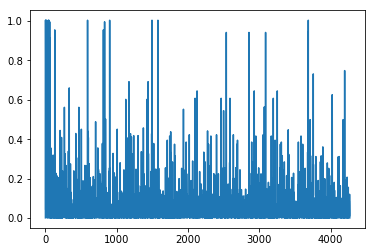

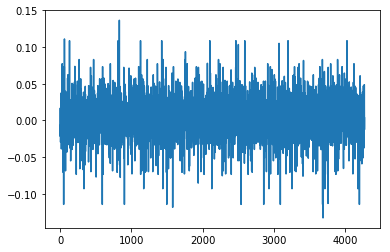

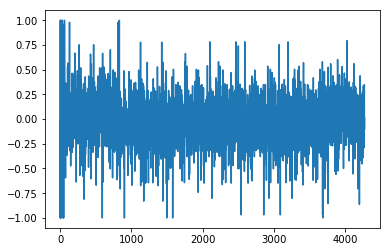

1.27170745015
[ 0.33333333  0.66666667  0.77777778  0.          0.11111111  0.55555556
  0.88888889  0.33333333  0.33333333  0.44444444  0.44444444  1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.55555556  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.55555556  0.          0.77777778  0.33333333
  0.55555556  0.55555556  0.88888889  0.55555556  0.88888889  0.55555556
  0.55555556  0.55555556  0.55555556  0.88888889  0.55555556  0.55555556
  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.55555556  0.          0.33333333  0.          0.          0.
  0.66666667  0.55555556  1.          0.66666667  0.22222222]
Writing away results
1990-02-01 00:00:00


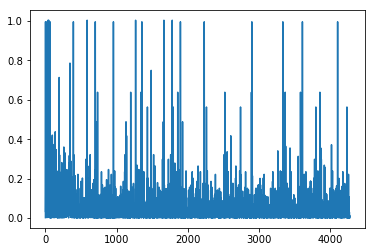

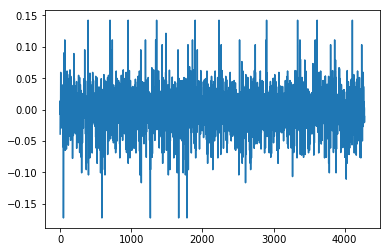

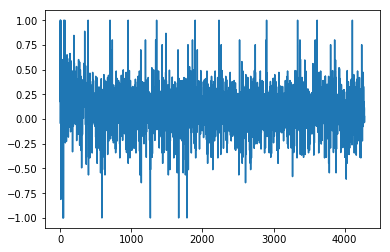

1.31998568418
[ 0.88888889  0.22222222  0.88888889  0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.22222222  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.88888889  0.          0.77777778  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.44444444  0.          0.77777778  0.88888889  0.88888889  0.88888889
  0.88888889  1.          0.          0.77777778  0.          0.88888889
  0.88888889]
Writing away results
1990-03-01 00:00:00


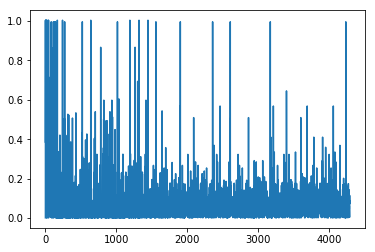

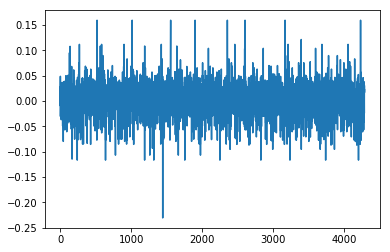

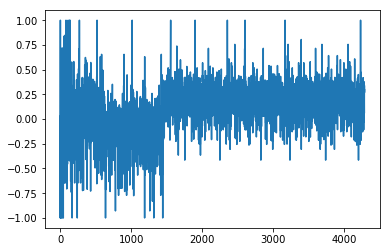

1.31331248203
[ 0.77777778  1.          0.44444444  0.44444444  0.44444444  1.          1.
  1.          0.11111111  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  1.          0.44444444  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.33333333  0.44444444  0.22222222  1.          1.
  1.          1.          0.55555556  0.44444444  0.22222222  0.44444444
  1.          1.          0.44444444]
Writing away results
1990-04-01 00:00:00


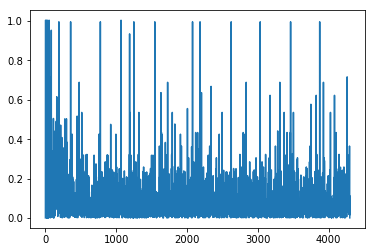

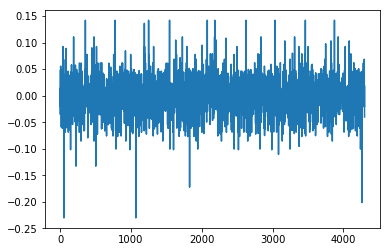

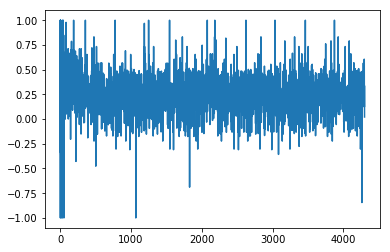

1.30030432817
[ 0.88888889  0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.88888889  0.33333333
  0.88888889  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556
  0.          0.          0.          0.88888889  0.88888889  0.33333333
  0.        ]
Writing away results
1990-05-01 00:00:00


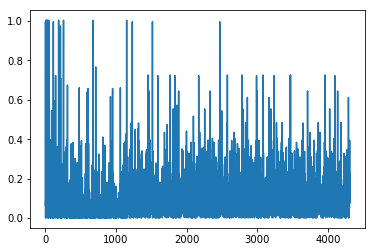

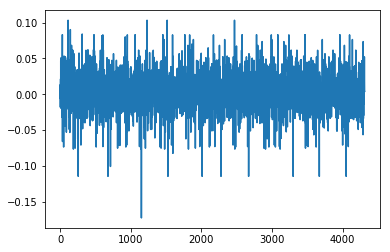

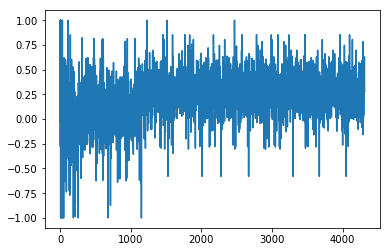

1.27096612041
[ 0.55555556  0.55555556  0.55555556  0.88888889  0.22222222  0.22222222
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556]
Writing away results
1990-06-01 00:00:00


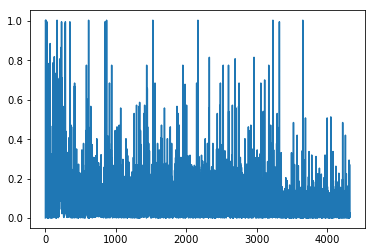

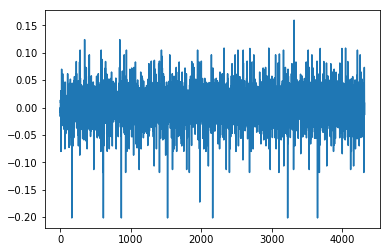

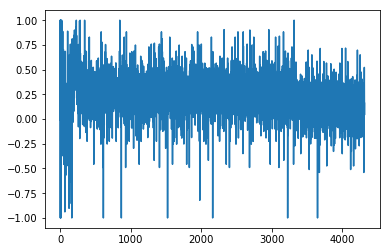

1.3013024788
[ 0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.88888889  1.          0.22222222  0.66666667  0.66666667
  0.66666667  0.11111111  0.88888889  1.          0.88888889  0.22222222
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1990-07-01 00:00:00


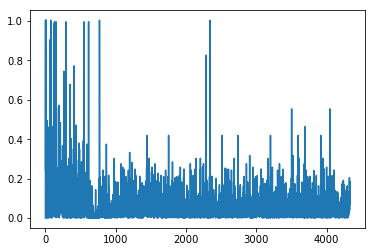

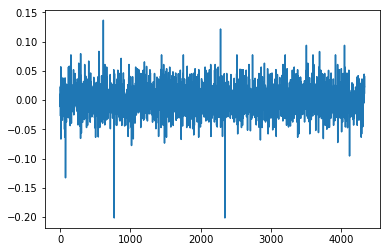

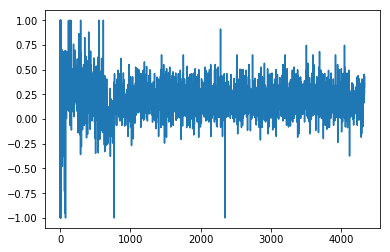

1.24901109529
[ 0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.33333333  0.77777778  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333  0.33333333
  0.77777778  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1990-08-01 00:00:00


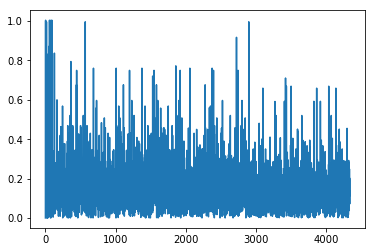

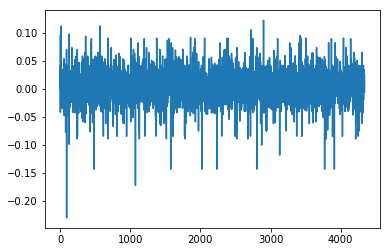

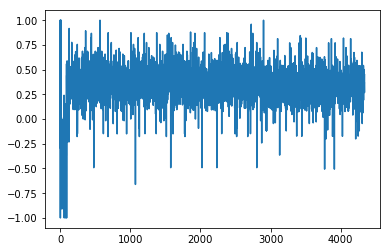

1.54395813408
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1990-09-01 00:00:00


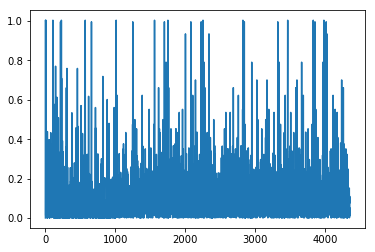

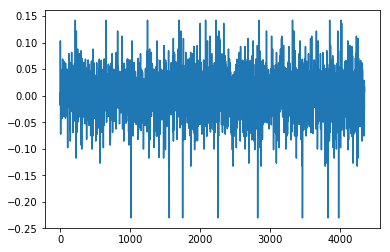

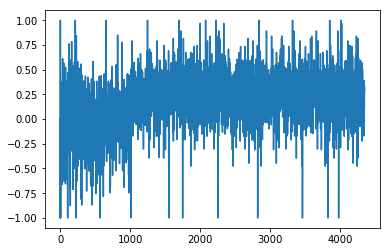

1.77846328608
[ 0.88888889  0.88888889  0.88888889  1.          1.          1.          1.
  1.          1.          0.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.88888889
  0.          0.88888889  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  0.66666667  1.          0.88888889  0.88888889  0.          1.          1.
  1.          1.          1.          1.        ]
Writing away results
1990-10-01 00:00:00


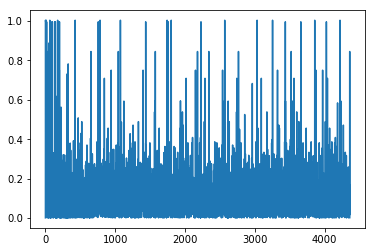

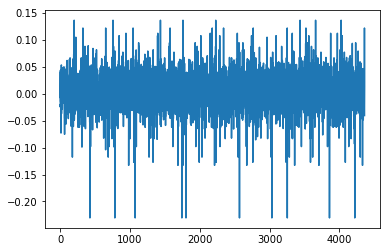

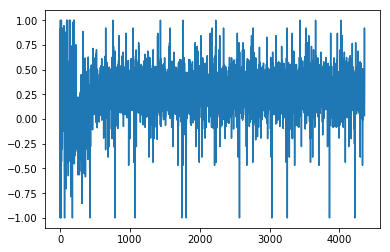

1.86394999879
[ 0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.33333333  0.33333333
  0.33333333  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.
  1.          1.          0.33333333  0.33333333  0.33333333  1.          1.
  1.          1.          1.          1.          1.        ]
Writing away results
1990-11-01 00:00:00


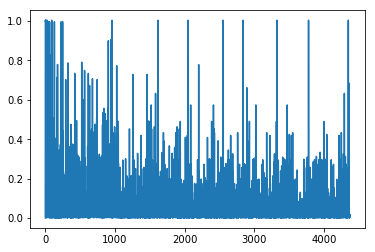

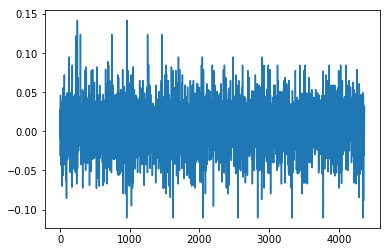

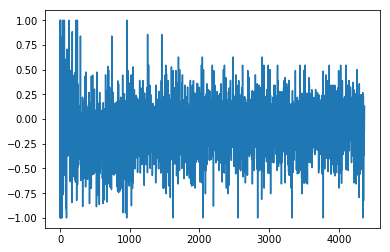

1.4575957552
[ 0.66666667  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.11111111  0.77777778  0.77777778  0.33333333  0.77777778
  0.11111111  0.77777778  0.11111111  0.77777778  0.77777778  0.88888889
  0.55555556  0.          0.77777778  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.33333333  0.77777778  0.11111111  0.77777778
  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.88888889  0.55555556  0.66666667  0.77777778
  0.          0.88888889  0.55555556  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1990-12-01 00:00:00


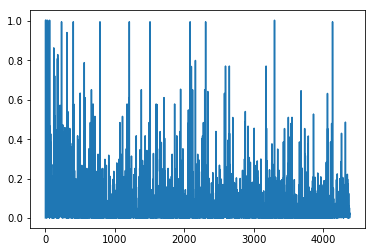

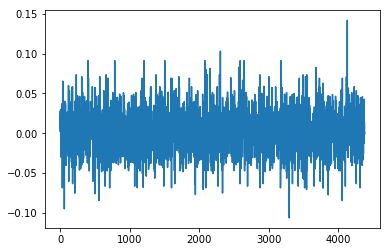

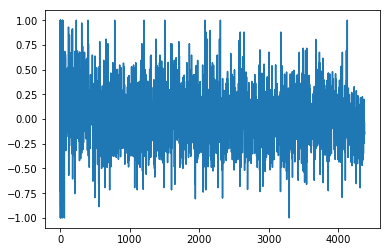

1.39153591665
[ 0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.11111111  0.22222222  0.11111111  0.11111111
  0.11111111  0.11111111  0.22222222  0.11111111  0.77777778  0.11111111
  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.11111111  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.11111111  0.66666667  0.11111111  0.44444444
  0.44444444  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1991-01-01 00:00:00


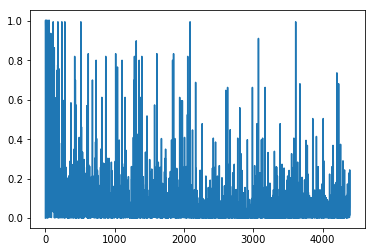

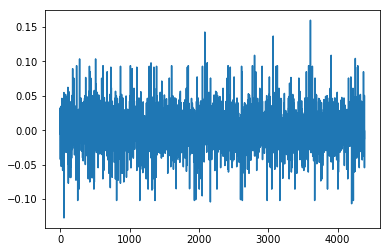

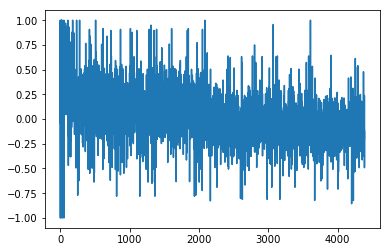

1.42920053889
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  1.          0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.44444444  0.88888889  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  1.          0.66666667  0.44444444  0.88888889  0.33333333
  1.          0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1991-02-01 00:00:00


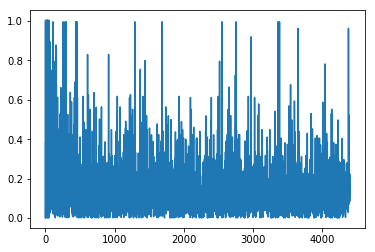

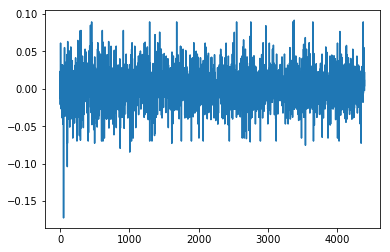

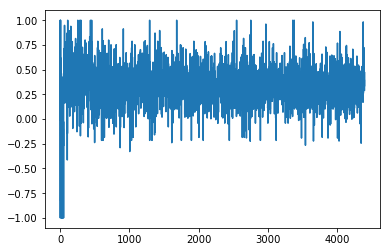

1.30161338091
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.88888889  0.11111111  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.44444444  0.22222222  0.11111111  0.11111111  0.11111111
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1991-03-01 00:00:00


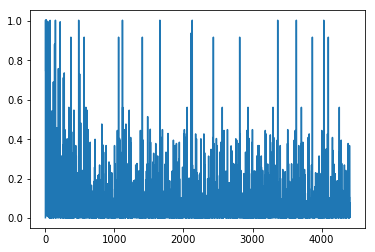

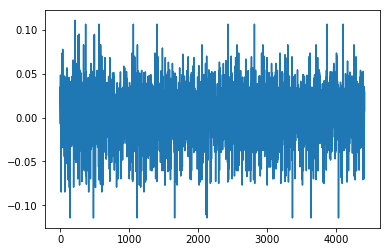

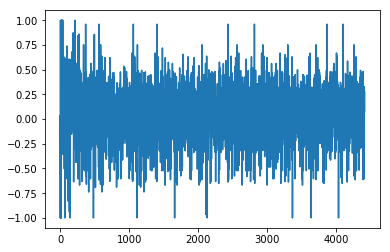

1.45221697201
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.55555556  0.88888889  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556  1.          1.
  0.44444444  0.44444444  0.44444444  0.77777778  0.55555556  0.33333333
  0.55555556  1.          0.44444444  0.44444444  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1991-04-01 00:00:00


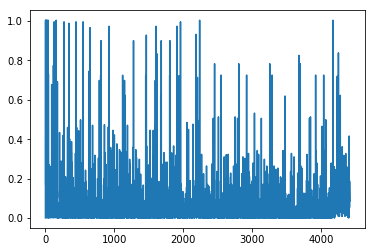

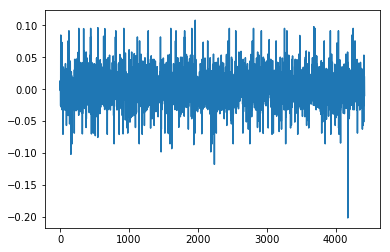

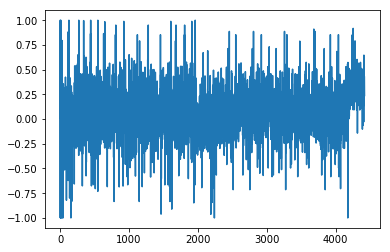

1.3912791242
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.          0.55555556  0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.          0.
  0.          0.          0.44444444  0.44444444  0.88888889  0.44444444
  0.          0.          0.55555556  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1991-05-01 00:00:00


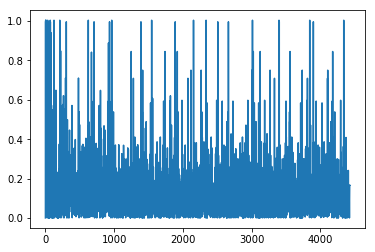

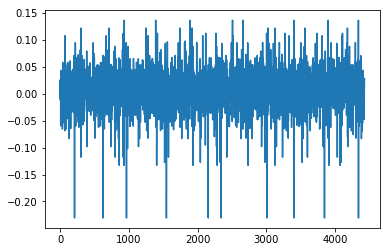

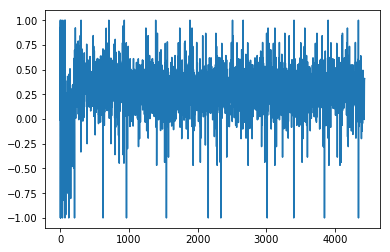

1.65394664017
[ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.
  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.]
Writing away results
1991-06-01 00:00:00


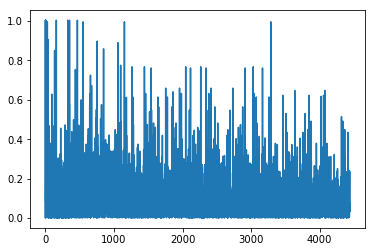

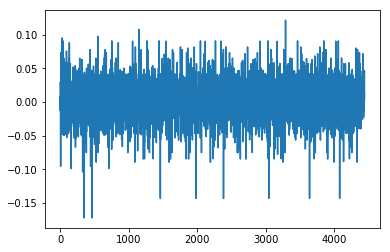

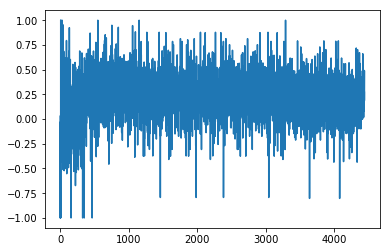

1.57815044654
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-07-01 00:00:00


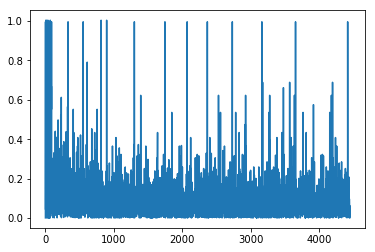

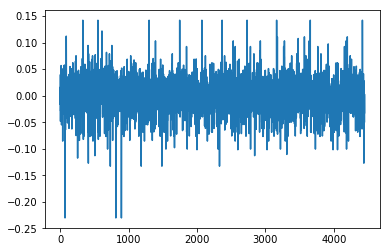

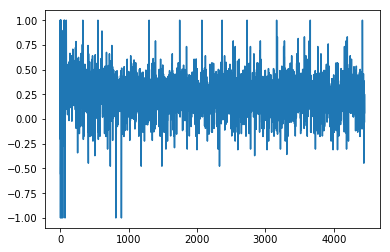

1.33711815664
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  0.22222222  0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.77777778
  0.22222222  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.77777778  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1991-08-01 00:00:00


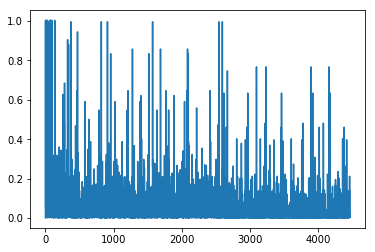

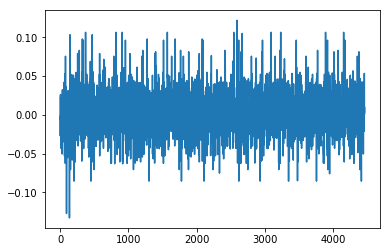

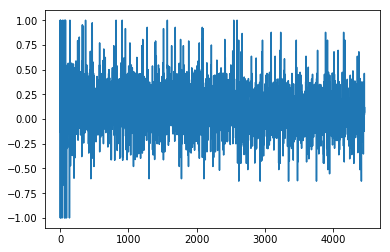

1.33268732187
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.22222222  0.44444444  0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889
  0.44444444  0.          0.44444444  0.22222222  0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1991-09-01 00:00:00


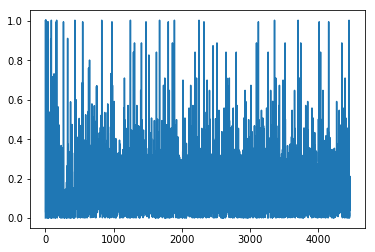

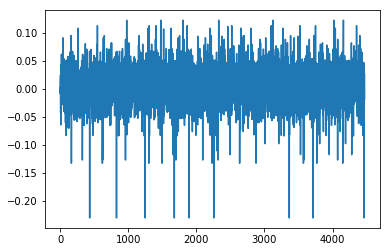

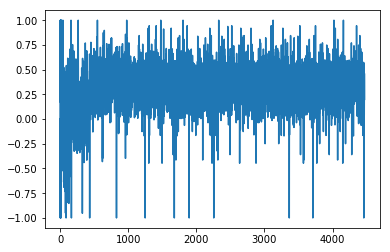

1.50850184447
[ 1.          1.          1.          1.          1.          1.          1.
  0.55555556  1.          0.55555556  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  1.          0.44444444  1.          0.55555556  0.55555556
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.55555556]
Writing away results
1991-10-01 00:00:00


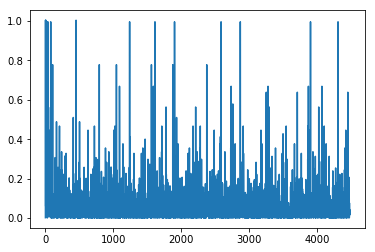

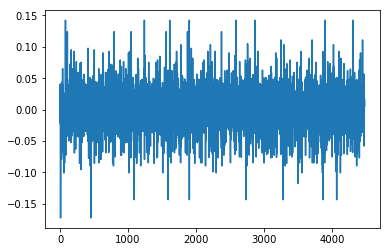

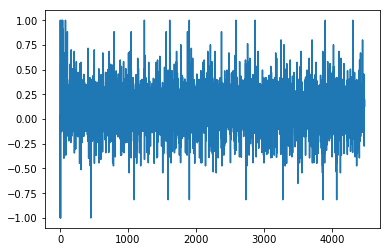

1.51585925941
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.11111111  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.44444444  0.88888889
  0.88888889  0.88888889  0.88888889  0.55555556  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889]
Writing away results
1991-11-01 00:00:00


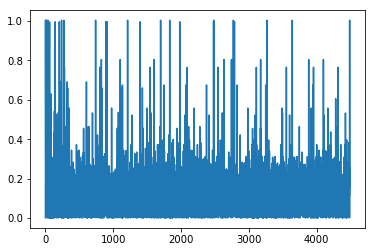

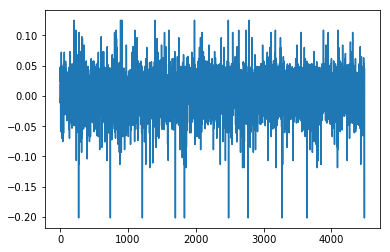

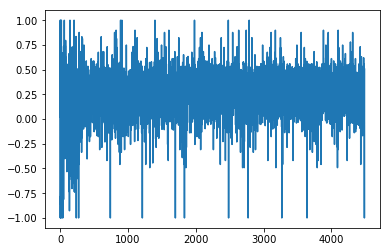

1.53318237295
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.88888889  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.77777778  0.11111111  0.33333333
  0.33333333  0.11111111  0.88888889  0.88888889  0.          0.88888889
  0.77777778  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.33333333  0.88888889]
Writing away results
1991-12-01 00:00:00


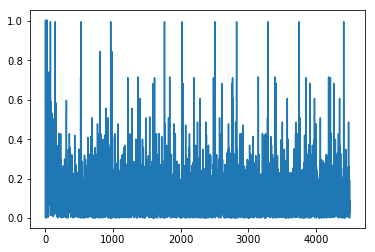

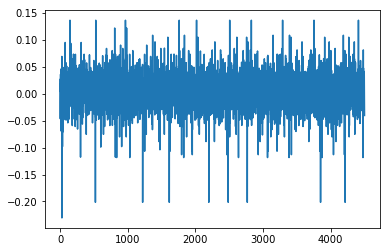

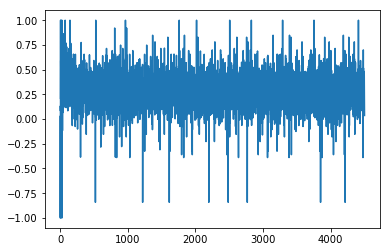

1.52783376286
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.88888889
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.88888889  1.          0.88888889  0.44444444
  0.44444444  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889]
Writing away results
1992-01-01 00:00:00


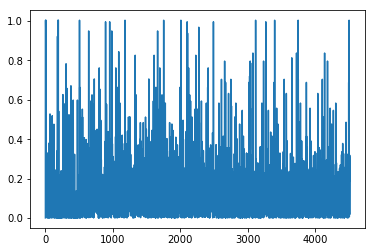

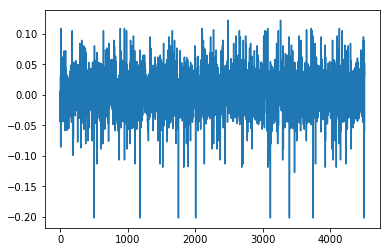

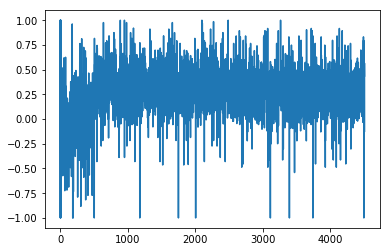

1.47791848484
[ 0.88888889  0.88888889  0.88888889  0.11111111  0.77777778  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889]
Writing away results
1992-02-01 00:00:00


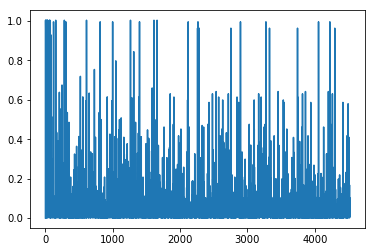

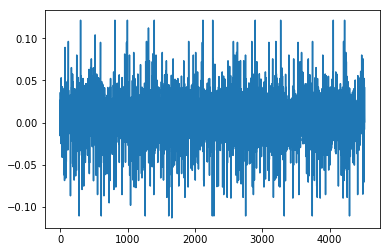

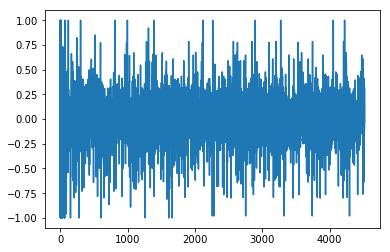

1.41710696685
[ 0.88888889  0.44444444  0.22222222  0.44444444  0.22222222  0.88888889
  0.44444444  0.88888889  0.66666667  0.88888889  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.44444444  0.88888889
  0.44444444  0.44444444  0.88888889  0.44444444  0.88888889  0.44444444
  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889
  0.33333333  0.44444444  0.88888889  0.22222222  0.22222222  0.33333333
  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.44444444  0.88888889
  0.44444444  0.33333333  0.33333333  0.33333333  0.44444444  0.22222222
  0.88888889  0.          0.44444444  0.44444444  0.44444444]
Writing away results
1992-03-01 00:00:00


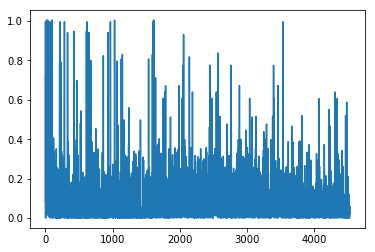

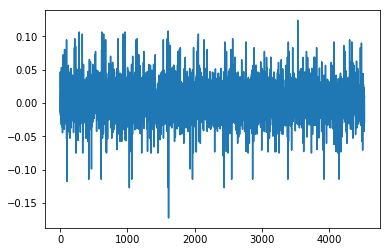

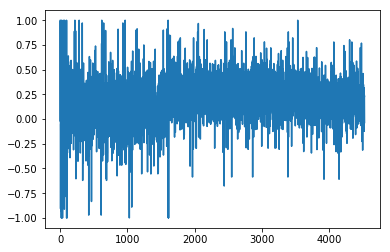

1.42379158929
[ 0.55555556  0.33333333  0.55555556  0.33333333  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667  0.55555556
  0.22222222  0.55555556  0.33333333  0.33333333  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1992-04-01 00:00:00


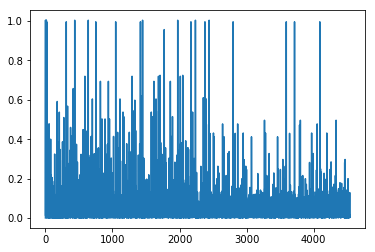

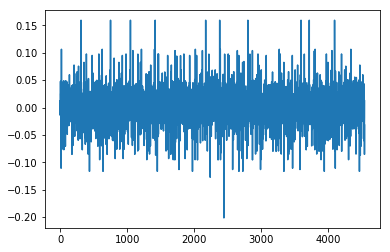

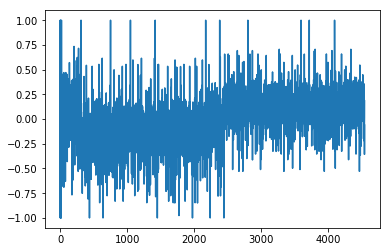

1.28016033994
[ 1.          0.11111111  0.77777778  0.44444444  0.44444444  0.44444444
  0.11111111  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.77777778  0.44444444  0.44444444
  0.44444444  0.11111111  0.44444444  0.44444444  0.77777778  1.          1.
  1.          1.          0.22222222  0.44444444  0.77777778  0.44444444
  0.11111111  1.          0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1992-05-01 00:00:00


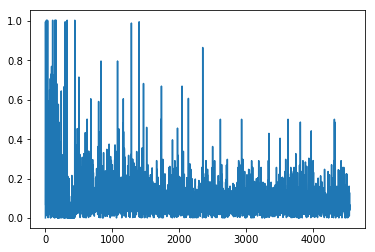

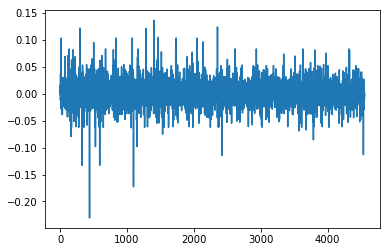

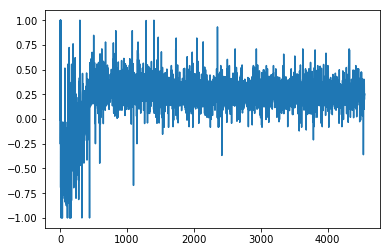

1.16794796823
[ 0.          0.22222222  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.
  0.11111111  0.          0.22222222  0.22222222  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.22222222  0.22222222  0.          0.          0.          0.
  0.          0.          0.22222222]
Writing away results
1992-06-01 00:00:00


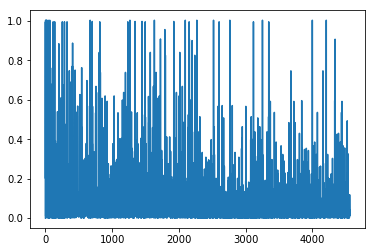

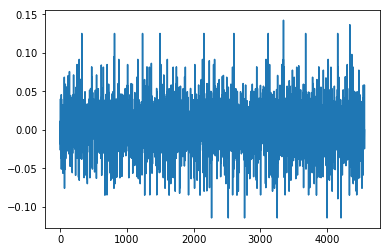

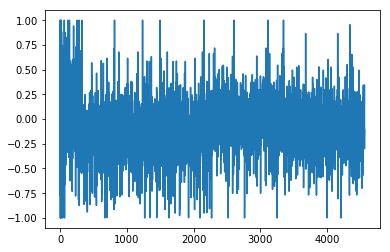

1.5700661943
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  1.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  1.
  0.11111111  0.44444444  0.55555556  0.77777778  0.77777778  0.44444444
  0.88888889  0.11111111  0.55555556  1.          0.77777778  0.22222222
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.33333333  1.          0.88888889  0.11111111  0.44444444
  0.44444444  0.22222222  0.11111111  0.66666667  0.66666667  0.11111111
  0.66666667  0.11111111  0.55555556  0.88888889]
Writing away results
1992-07-01 00:00:00


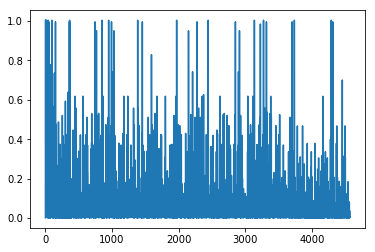

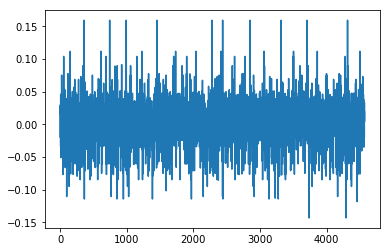

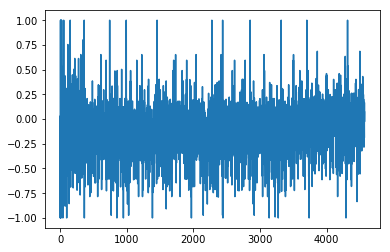

1.43901889513
[ 0.66666667  0.          0.55555556  0.22222222  0.55555556  0.22222222
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.44444444
  0.33333333  0.66666667  0.22222222  0.55555556  0.22222222  0.33333333
  0.44444444  0.          0.55555556  0.11111111  0.77777778  0.88888889
  0.66666667  0.44444444  0.          0.55555556  1.          0.77777778
  1.          0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.55555556  0.66666667  0.11111111  0.88888889
  1.          0.11111111  0.44444444  0.33333333  0.66666667  0.66666667
  0.55555556  0.66666667  0.88888889  0.66666667  0.44444444]
Writing away results
1992-08-01 00:00:00


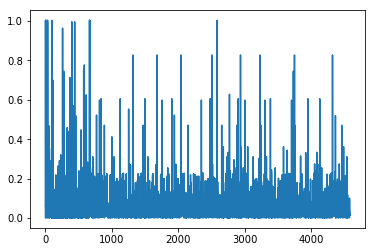

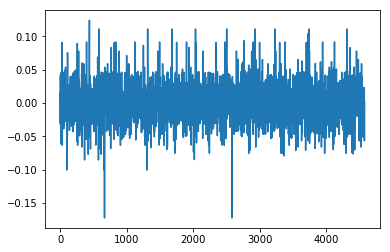

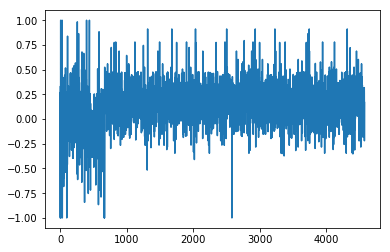

1.2540542084
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.11111111  0.22222222  0.11111111  0.55555556  0.55555556  0.77777778
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.11111111  0.11111111  0.11111111]
Writing away results
1992-09-01 00:00:00


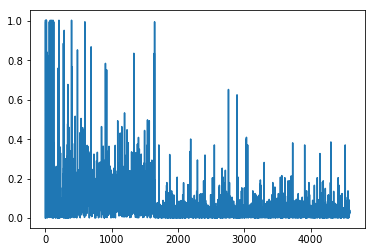

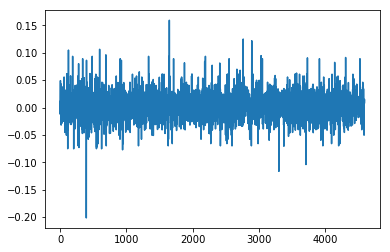

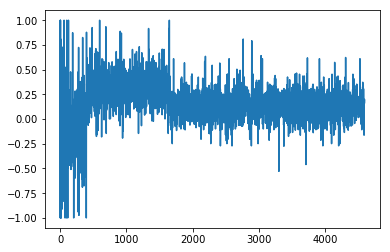

1.27417058808
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889  0.22222222
  0.22222222  0.22222222  0.11111111  0.11111111  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111  0.88888889
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1992-10-01 00:00:00


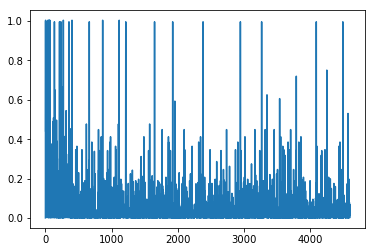

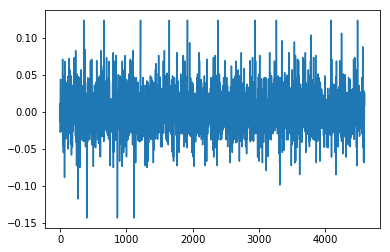

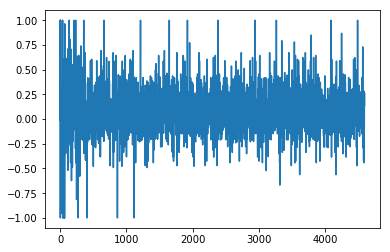

1.15054363706
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.44444444  0.44444444  0.44444444
  0.44444444  0.          0.          0.66666667  0.          0.44444444
  0.44444444  0.44444444  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.44444444
  0.44444444  0.          0.          0.          0.          0.          0.
  0.44444444  0.          0.          0.          0.          0.        ]
Writing away results
1992-11-01 00:00:00


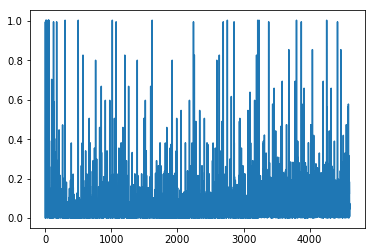

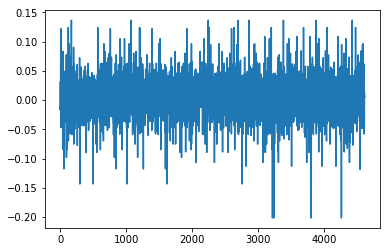

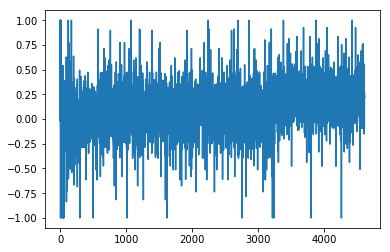

1.72416234539
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.55555556  0.33333333
  0.33333333  0.33333333  0.88888889  0.88888889  1.          0.88888889
  0.33333333  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.55555556  0.33333333  0.44444444  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1992-12-01 00:00:00


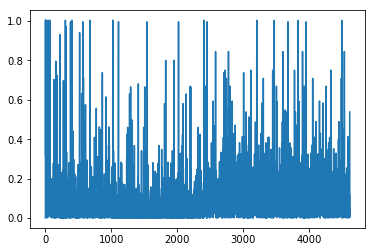

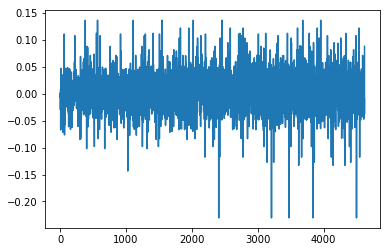

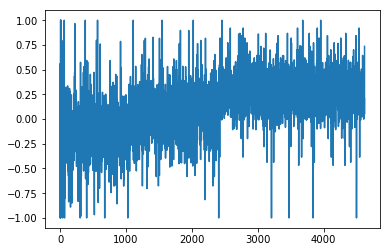

1.79285442813
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444  1.          1.
  0.88888889  1.          0.44444444  0.44444444  0.44444444  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.44444444  0.44444444  0.          1.          1.          1.
  1.          1.          0.44444444  1.          1.          1.          1.
  1.          1.          1.        ]
Writing away results
1993-01-01 00:00:00


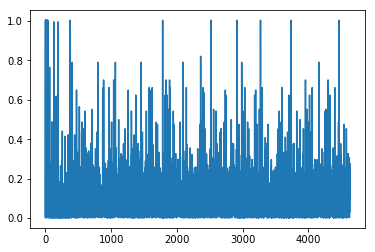

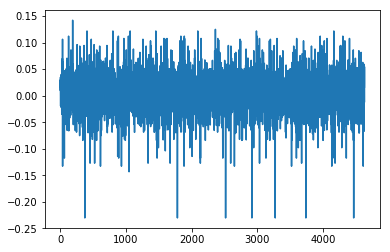

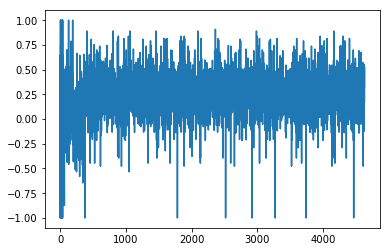

1.84760380295
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  1.          1.          1.          0.66666667  0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.66666667  1.          1.
  1.          1.          1.          1.          0.66666667  1.          1.
  1.          1.          1.          1.          1.          0.88888889]
Writing away results
1993-02-01 00:00:00


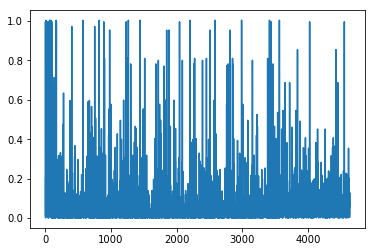

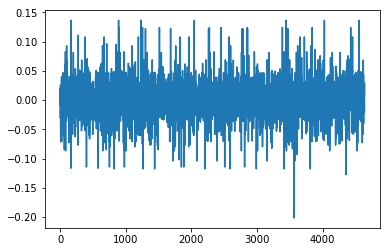

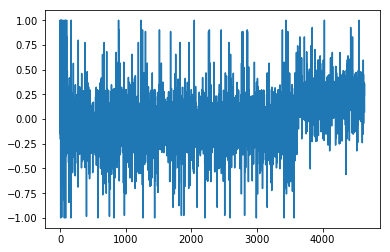

1.52171096397
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  1.          0.55555556  0.88888889  0.66666667  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.33333333  0.55555556  1.
  0.66666667  0.22222222  0.44444444  0.55555556  0.55555556  0.55555556
  0.55555556  1.          0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1993-03-01 00:00:00


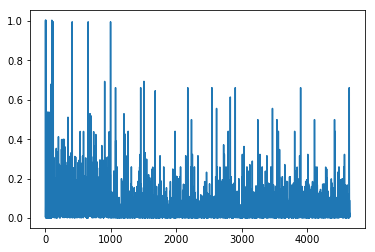

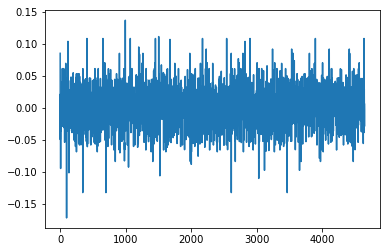

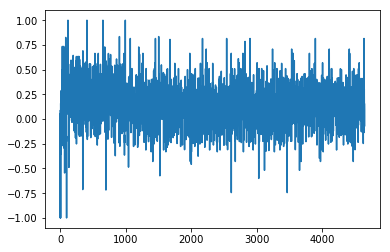

1.25028295649
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.11111111  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.22222222
  0.          0.22222222  0.66666667  0.66666667  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.11111111
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.22222222  0.22222222]
Writing away results
1993-04-01 00:00:00


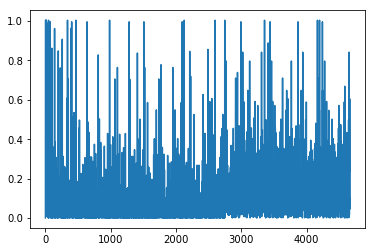

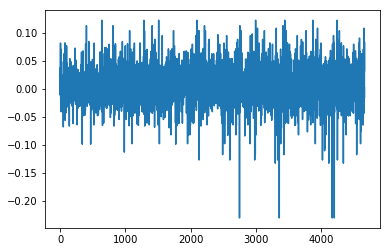

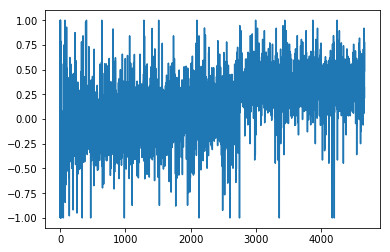

1.94302968159
[ 1.          1.          1.          1.          1.          1.          1.
  1.          0.66666667  1.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  1.          0.          1.
  0.22222222  0.22222222  0.88888889  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.55555556  0.22222222  1.          1.          1.          1.          1.
  1.          0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.        ]
Writing away results
1993-05-01 00:00:00


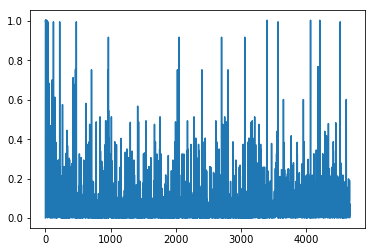

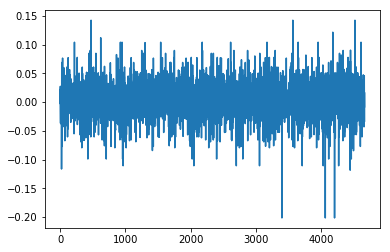

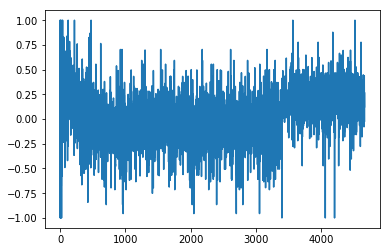

1.56546028289
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.55555556  0.66666667  1.          0.33333333  1.          1.
  0.33333333  0.55555556  0.66666667  0.22222222  0.88888889  1.
  0.33333333  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.77777778
  0.88888889  0.33333333  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-06-01 00:00:00


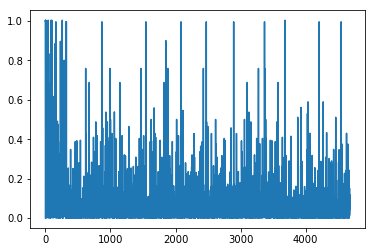

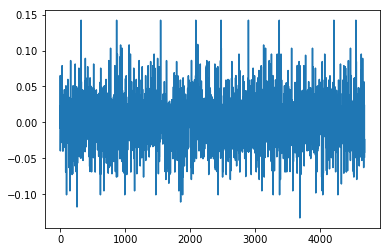

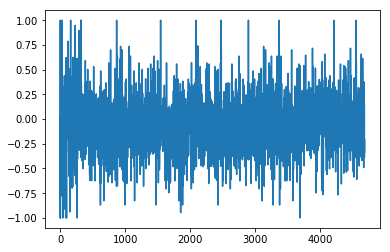

1.63948199461
[ 0.44444444  0.11111111  0.77777778  0.77777778  0.77777778  0.
  0.55555556  0.44444444  0.22222222  0.88888889  0.88888889  0.22222222
  0.22222222  0.55555556  0.44444444  0.22222222  0.55555556  0.88888889
  0.88888889  0.44444444  0.55555556  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.55555556  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.11111111  0.55555556  0.44444444
  0.44444444  0.88888889  0.88888889  0.44444444  0.66666667  0.77777778
  0.77777778  0.77777778  0.44444444  0.22222222  0.55555556  0.44444444
  0.77777778  0.77777778  0.77777778  0.77777778  0.          0.55555556
  0.44444444  0.77777778  0.55555556  0.44444444  0.77777778]
Writing away results
1993-07-01 00:00:00


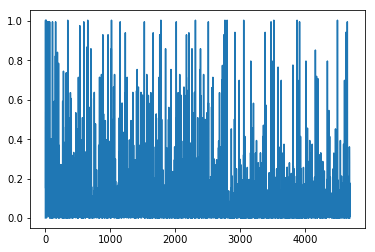

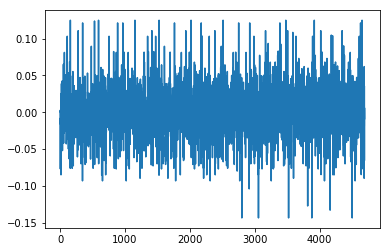

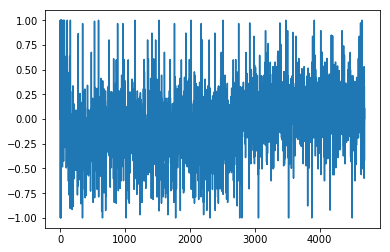

1.59911053156
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.77777778  0.77777778  0.77777778
  0.77777778  0.55555556  1.          0.66666667  0.          0.77777778
  0.77777778  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.33333333
  0.          0.77777778  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-08-01 00:00:00


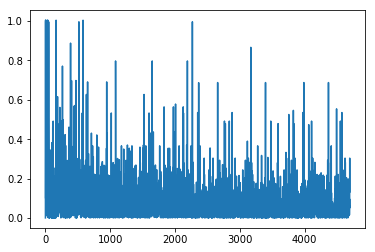

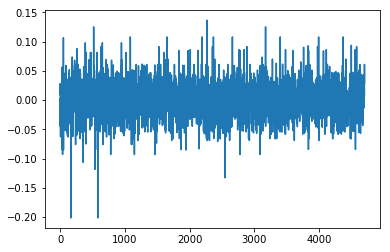

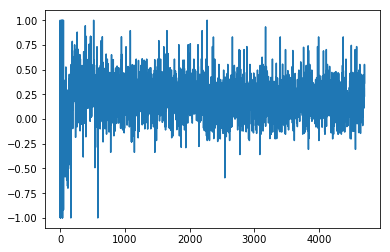

1.23702833825
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.88888889  0.22222222  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.          0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1993-09-01 00:00:00


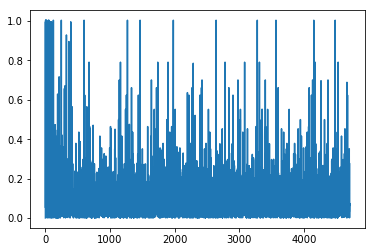

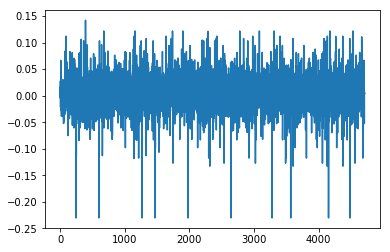

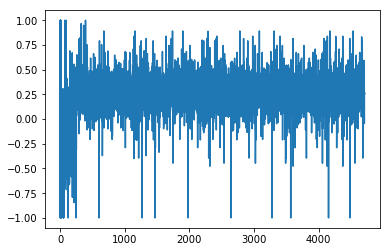

1.83360382818
[ 1.          1.          1.          1.          1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.
  0.22222222  1.          0.22222222  0.22222222  0.88888889  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.88888889  1.          1.          1.          1.
  1.          1.          0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.22222222]
Writing away results
1993-10-01 00:00:00


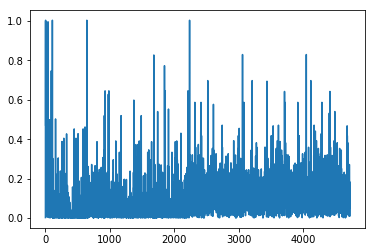

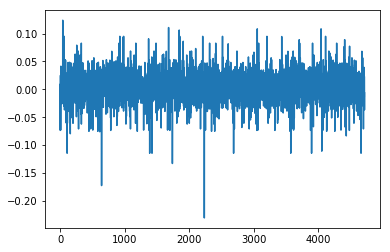

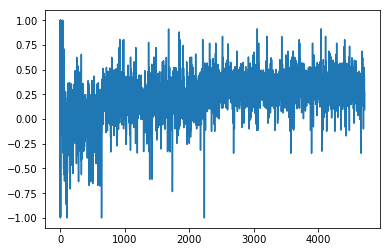

1.4524562853
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.          0.          0.55555556  0.55555556  0.11111111  0.55555556
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.        ]
Writing away results
1993-11-01 00:00:00


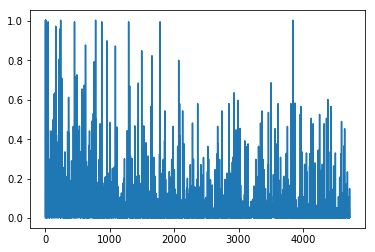

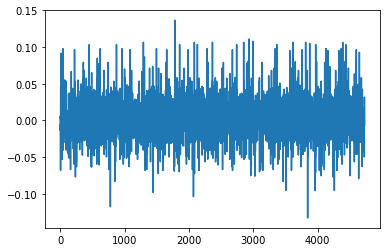

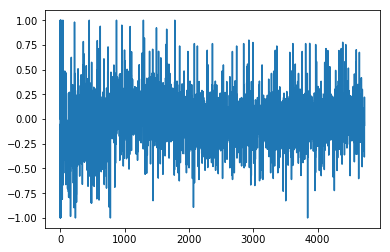

1.51037455288
[ 0.33333333  0.22222222  0.11111111  0.77777778  0.44444444  0.          0.
  0.          0.88888889  0.11111111  0.77777778  0.33333333  0.          0.
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.11111111  0.33333333  0.11111111
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.44444444
  0.44444444  0.88888889  0.11111111  0.33333333  0.33333333  0.11111111
  0.33333333  0.11111111  0.77777778  0.88888889  0.11111111  0.33333333
  0.33333333  0.33333333  0.33333333  0.11111111  0.22222222  0.11111111
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889
  0.11111111  0.44444444  0.88888889]
Writing away results
1993-12-01 00:00:00


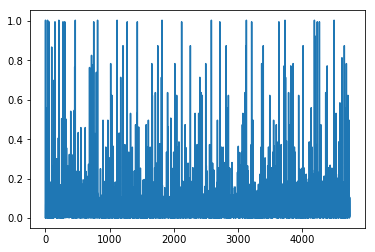

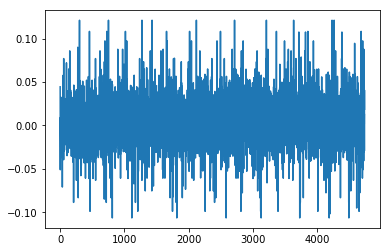

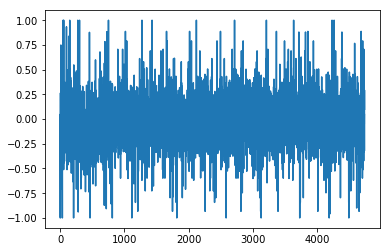

1.62178598469
[ 0.66666667  0.77777778  0.44444444  0.33333333  0.22222222  0.33333333
  0.33333333  0.66666667  0.77777778  0.44444444  0.66666667  0.22222222
  0.33333333  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  1.          0.77777778  1.
  0.77777778  0.77777778  0.77777778  0.          0.          0.          0.
  0.22222222  0.22222222  0.77777778  0.88888889  0.77777778  0.77777778
  0.66666667  0.77777778  0.33333333  1.          0.77777778  0.77777778
  0.77777778  0.77777778  0.66666667  0.77777778  0.88888889  0.77777778
  0.88888889  0.77777778  0.77777778  0.77777778  1.          1.
  0.77777778  0.33333333  0.22222222  0.77777778]
Writing away results
1994-01-01 00:00:00


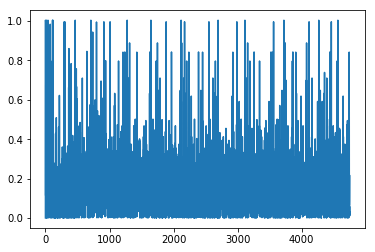

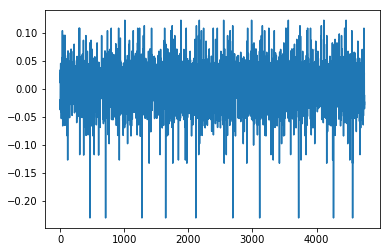

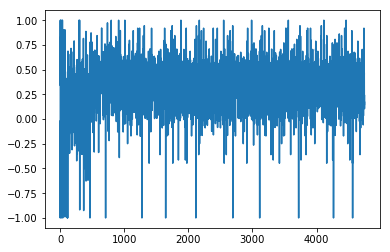

1.99099398039
[ 1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          1.          1.          0.66666667  0.66666667
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  1.        ]
Writing away results
1994-02-01 00:00:00


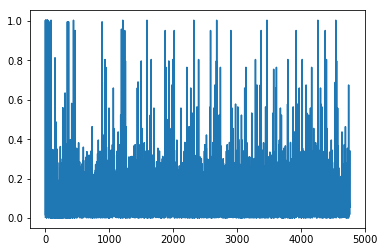

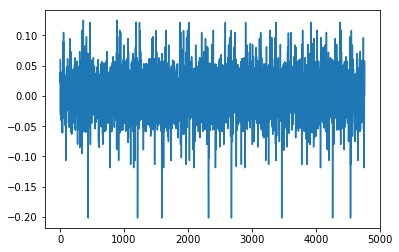

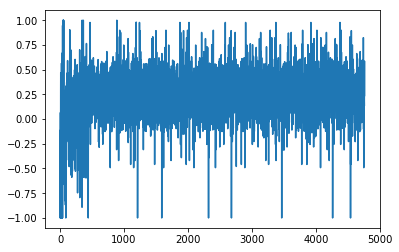

2.08251345611
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  1.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  1.          0.66666667  0.88888889  0.88888889]
Writing away results
1994-03-01 00:00:00


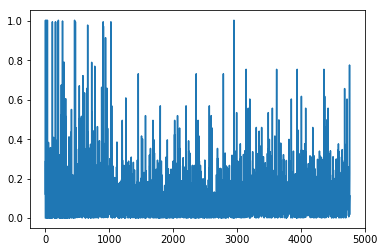

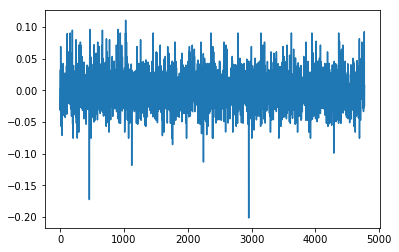

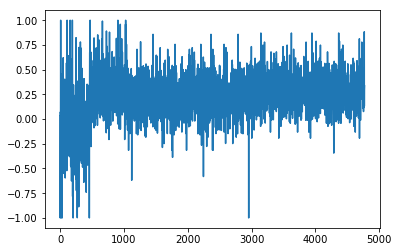

1.31831300172
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.33333333  0.22222222
  0.55555556  0.22222222  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.33333333
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.33333333  0.66666667  0.22222222  0.22222222  0.22222222]
Writing away results
1994-04-01 00:00:00


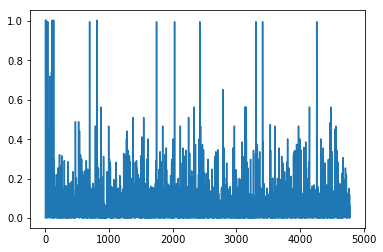

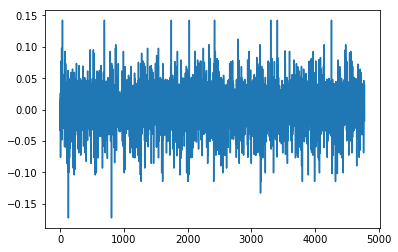

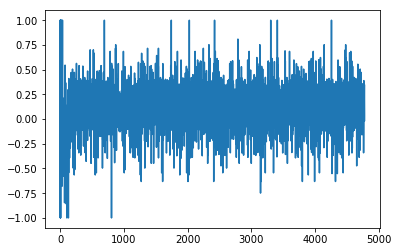

1.95580829325
[ 0.88888889  0.88888889  0.88888889  0.55555556  0.55555556  0.77777778
  0.55555556  0.88888889  0.88888889  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.88888889  0.88888889
  0.77777778  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1994-05-01 00:00:00


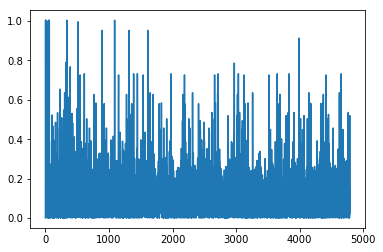

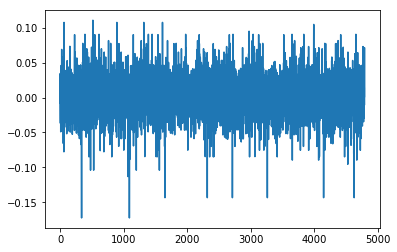

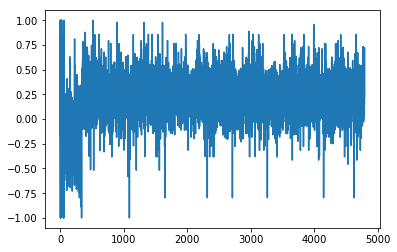

1.97427913147
[ 0.55555556  0.55555556  0.88888889  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1994-06-01 00:00:00


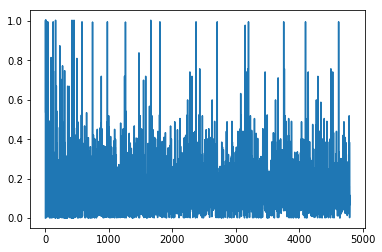

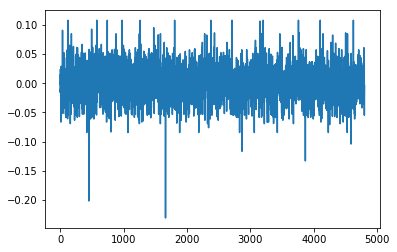

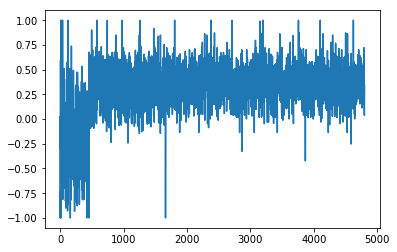

1.22649942117
[ 0.66666667  0.          0.          0.66666667  0.          0.66666667
  0.66666667  0.77777778  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.66666667
  1.          0.          0.          0.          0.          0.          0.
  0.66666667  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.          0.          0.        ]
Writing away results
1994-07-01 00:00:00


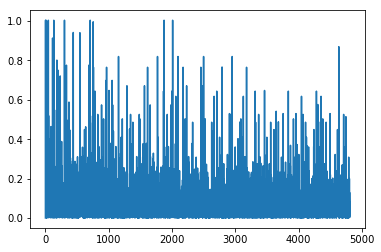

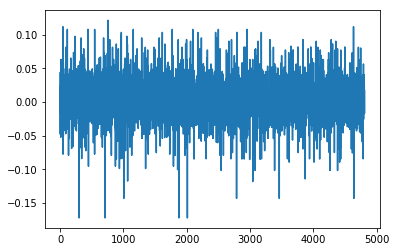

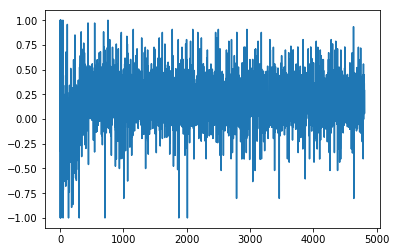

1.71493526749
[ 1.          0.66666667  0.33333333  0.66666667  0.33333333  0.33333333
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.33333333  1.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333]
Writing away results
1994-08-01 00:00:00


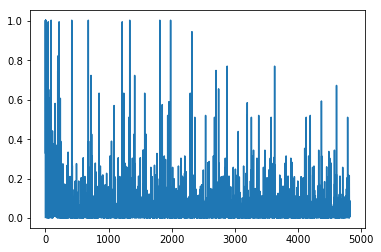

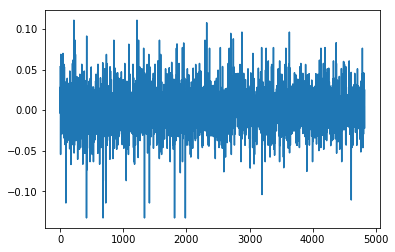

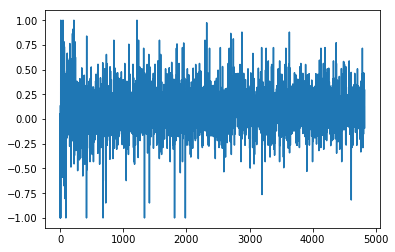

1.14222398185
[ 0.11111111  0.77777778  0.11111111  0.33333333  0.33333333  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333
  0.33333333  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.77777778
  0.33333333  0.33333333  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.44444444  0.11111111]
Writing away results
1994-09-01 00:00:00


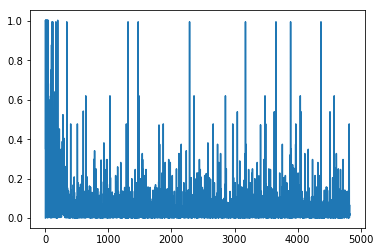

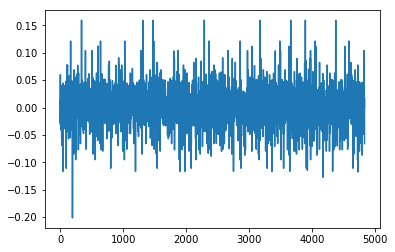

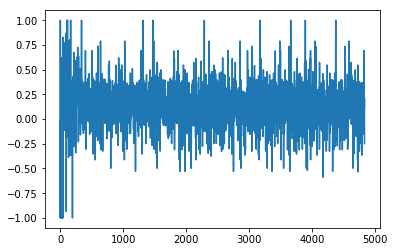

1.64135133979
[ 0.22222222  0.22222222  1.          1.          0.77777778  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  1.          0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.33333333  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.          1.
  0.55555556  1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.44444444  0.22222222  0.        ]
Writing away results
1994-10-01 00:00:00


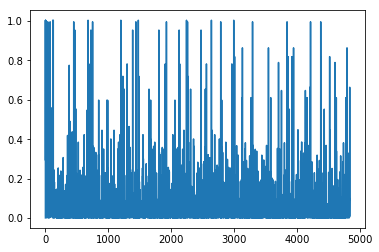

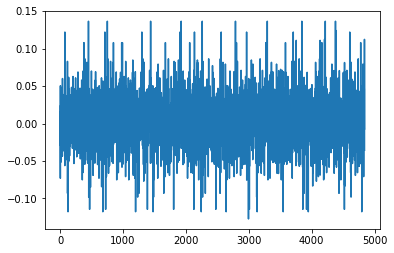

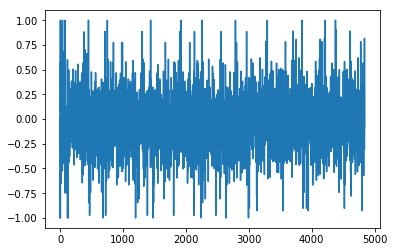

1.74686213446
[ 1.          0.77777778  0.66666667  0.77777778  1.          1.          1.
  1.          1.          0.55555556  0.55555556  1.          0.55555556
  1.          0.55555556  1.          0.55555556  0.55555556  0.11111111
  0.33333333  1.          0.22222222  0.77777778  0.44444444  1.          1.
  0.55555556  1.          0.55555556  0.66666667  0.77777778  0.33333333
  1.          1.          0.55555556  1.          0.55555556  1.
  0.55555556  1.          1.          0.55555556  1.          0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.77777778  1.
  0.55555556  0.55555556  0.55555556  0.11111111  0.77777778  0.22222222
  1.          0.55555556  0.66666667]
Writing away results
1994-11-01 00:00:00


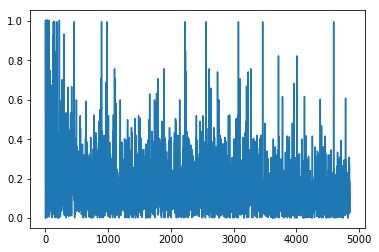

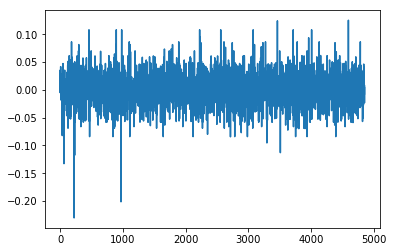

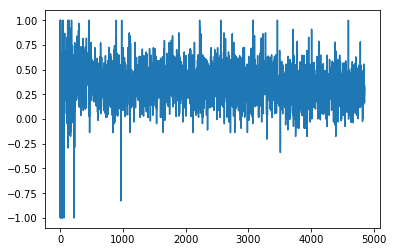

1.29634976957
[ 0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667]
Writing away results
1994-12-01 00:00:00


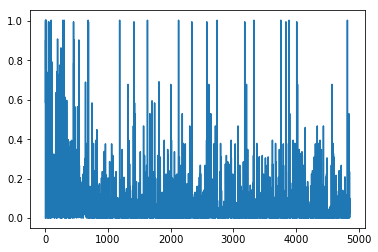

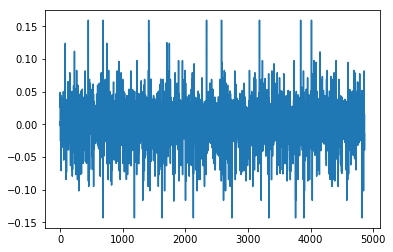

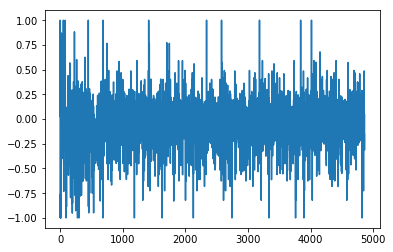

1.79812598179
[ 0.33333333  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.66666667  0.44444444  0.33333333  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.77777778
  0.77777778  0.66666667  0.66666667  0.          0.66666667  0.22222222
  0.66666667  0.77777778  0.11111111  0.77777778  0.66666667  0.66666667
  0.          0.77777778  1.          0.33333333  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.          0.11111111  0.22222222
  0.          0.11111111  0.44444444  0.44444444  0.33333333]
Writing away results
1995-01-01 00:00:00


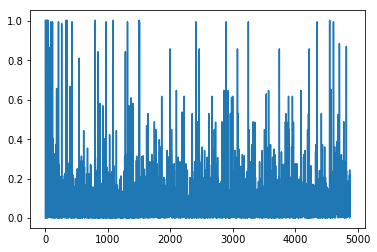

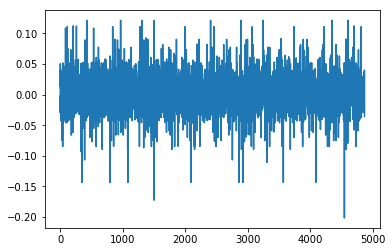

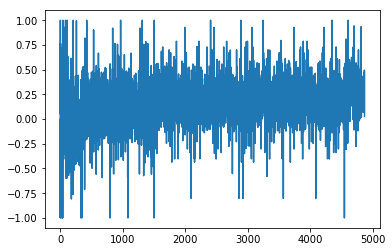

1.94372540945
[ 0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.33333333  0.33333333  0.44444444  0.66666667]
Writing away results
1995-02-01 00:00:00


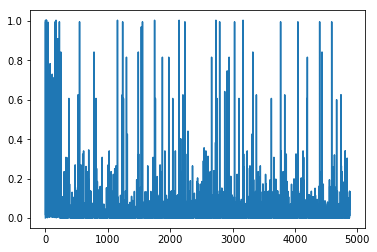

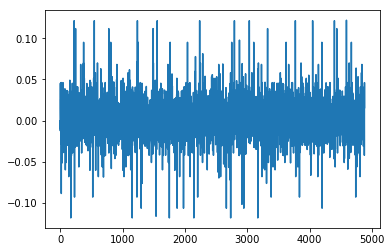

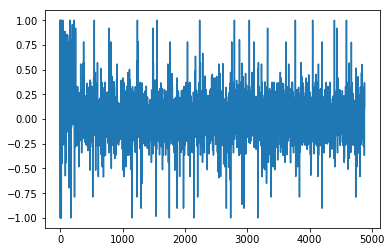

1.4125881044
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.88888889  0.33333333  0.
  0.55555556  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.11111111  0.55555556  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.88888889  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.77777778
  0.11111111  0.55555556  0.77777778  0.22222222  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.77777778  0.33333333  0.33333333
  0.          1.          0.          0.33333333  0.33333333]
Writing away results
1995-03-01 00:00:00


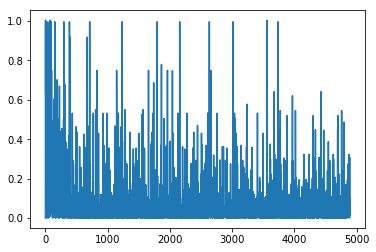

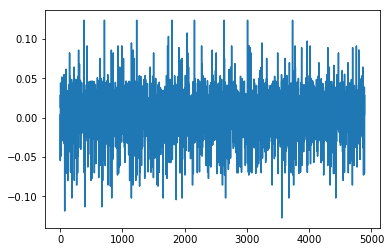

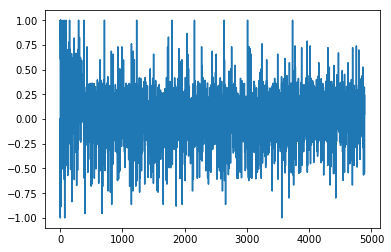

1.44307960671
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  1.          0.22222222
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  1.          0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  1.          0.11111111
  0.11111111  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  1.          0.44444444  1.          0.11111111
  0.33333333  0.22222222  0.44444444  0.44444444  0.44444444]
Writing away results
1995-04-01 00:00:00


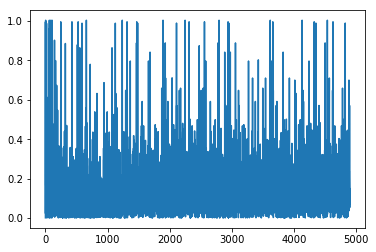

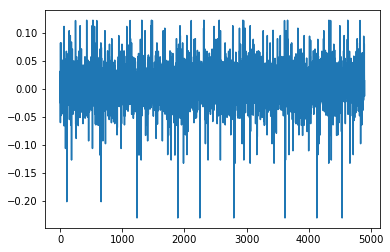

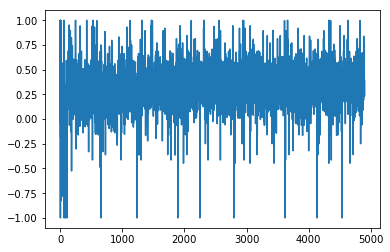

2.35287843626
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.11111111  0.55555556  1.          1.          1.          1.
  1.          1.          0.11111111  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.11111111  0.11111111
  0.55555556  0.77777778  1.          1.          1.          1.          1.
  1.          0.11111111  1.          1.          0.11111111  0.11111111
  0.22222222  1.          1.          1.          1.        ]
Writing away results
1995-05-01 00:00:00


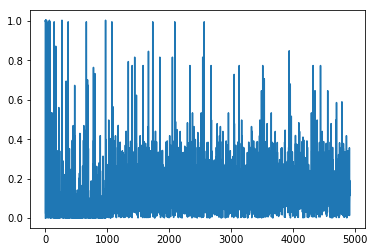

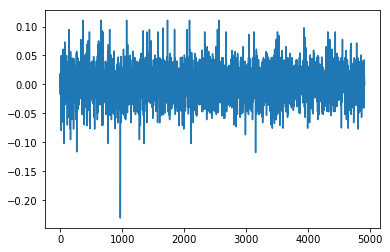

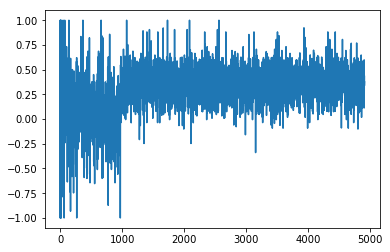

1.30949265784
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.55555556  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1995-06-01 00:00:00


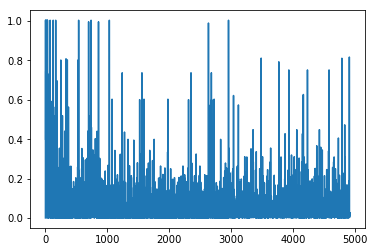

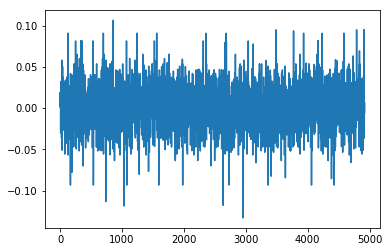

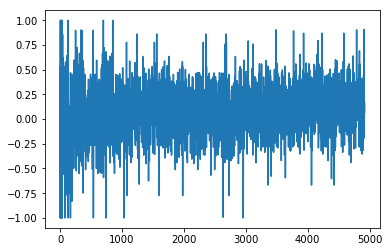

1.06491975025
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.          0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.55555556  0.          0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.55555556  0.          0.          0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.11111111  0.11111111  0.55555556  0.55555556  0.88888889  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556]
Writing away results
1995-07-01 00:00:00


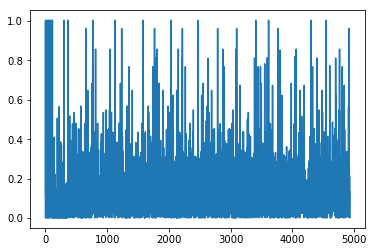

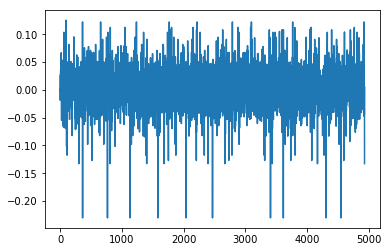

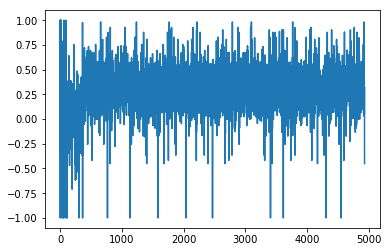

2.25199139425
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.55555556
  0.55555556  1.          1.          1.          1.          1.          1.
  0.55555556  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.11111111  0.55555556  0.55555556  1.          1.
  1.          1.          1.          1.          1.          0.11111111
  1.          1.          0.55555556  0.55555556  0.55555556  1.          1.
  1.          1.          1.          0.11111111  0.55555556]
Writing away results
1995-08-01 00:00:00


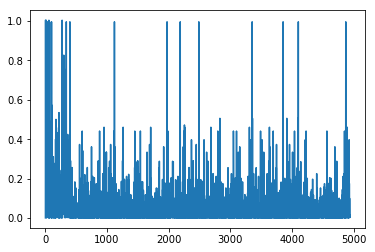

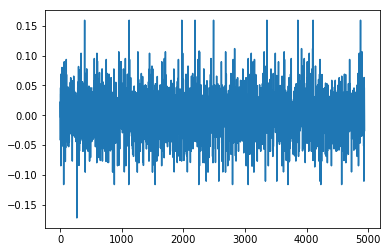

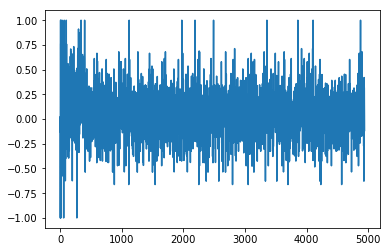

1.67987901753
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.44444444  0.55555556  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.88888889  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444  1.          1.
  1.          0.77777778  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.44444444  0.33333333  0.33333333  1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444
  1.          1.        ]
Writing away results
1995-09-01 00:00:00


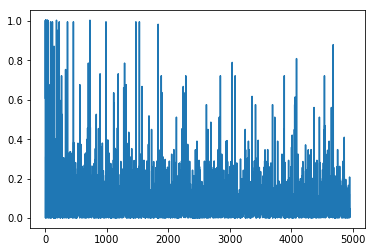

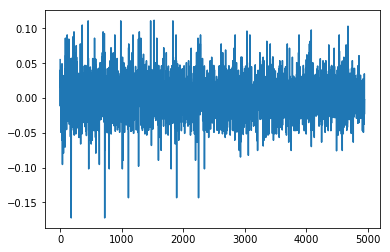

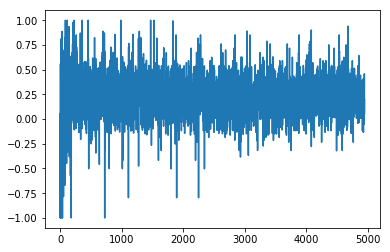

1.20672530706
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556  0.55555556
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.55555556
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.55555556  0.11111111  0.55555556]
Writing away results
1995-10-01 00:00:00


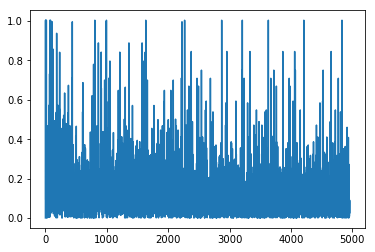

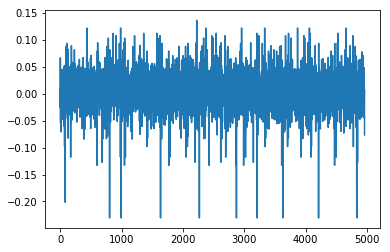

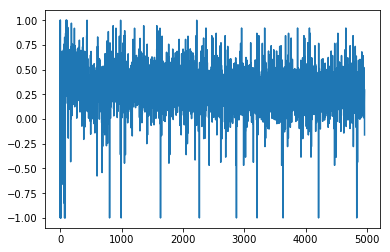

1.80062070957
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.11111111  0.11111111  1.          1.          1.
  1.          1.          1.          0.11111111  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.11111111
  0.11111111  0.11111111  1.          1.          1.          1.          1.
  1.          1.          0.11111111  1.          1.          0.11111111
  0.11111111  0.11111111  1.          1.          1.          1.          1.
  0.11111111  0.11111111  1.          0.11111111  1.        ]
Writing away results
1995-11-01 00:00:00


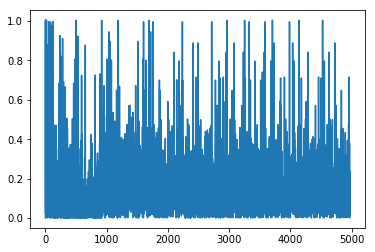

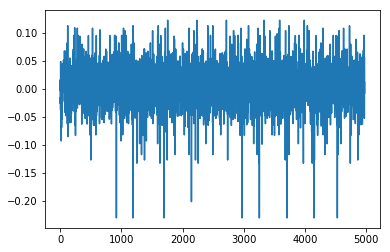

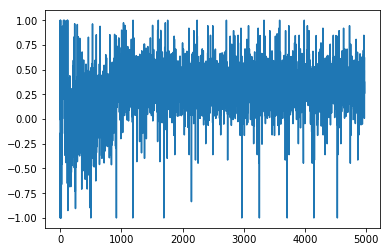

1.5409241487
[ 1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.
  1.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.
  0.  1.  0.  1.  1.]
Writing away results
1995-12-01 00:00:00


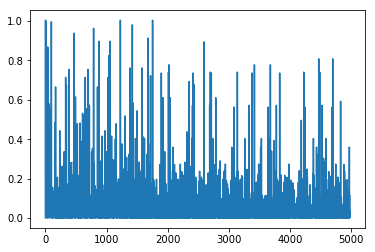

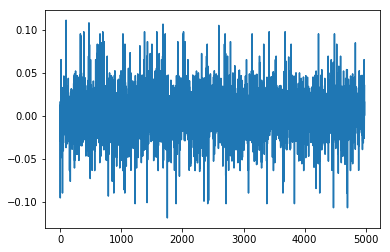

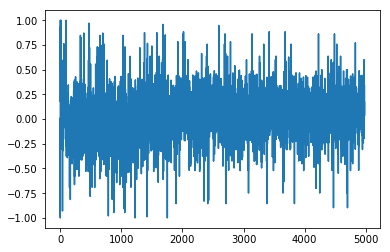

1.24821600055
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.22222222  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.44444444  0.22222222  0.44444444  0.77777778  0.77777778
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.22222222  0.44444444  0.          0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222
  0.11111111  1.          0.11111111  0.11111111  0.22222222]
Writing away results
1996-01-01 00:00:00


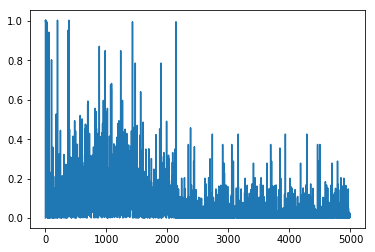

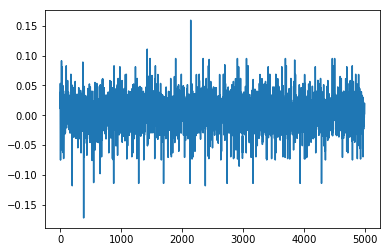

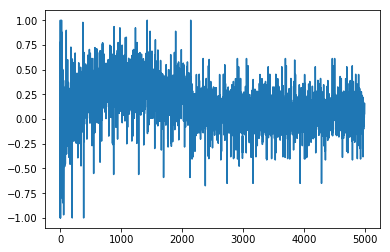

1.33224064723
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.11111111  0.          0.          0.77777778  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.55555556
  0.55555556  0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.55555556
  0.          0.55555556  0.55555556  0.          0.        ]
Writing away results
1996-02-01 00:00:00


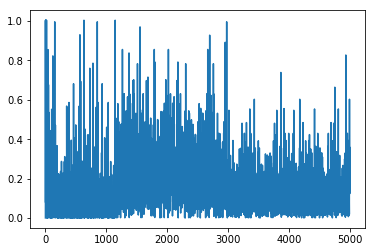

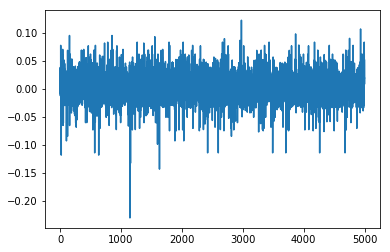

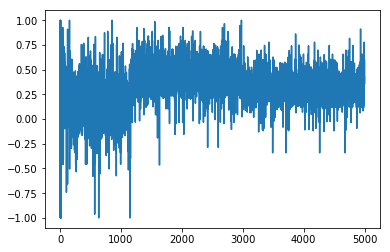

1.36220720993
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.33333333  0.33333333  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.33333333  0.55555556  0.55555556
  0.33333333  0.33333333  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.33333333  0.33333333  0.11111111  0.33333333
  0.55555556  0.55555556  0.33333333  0.33333333  0.33333333]
Writing away results
1996-03-01 00:00:00


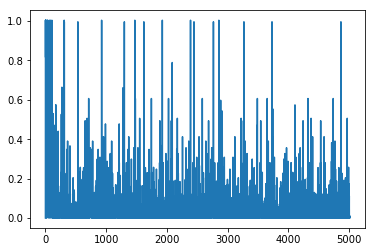

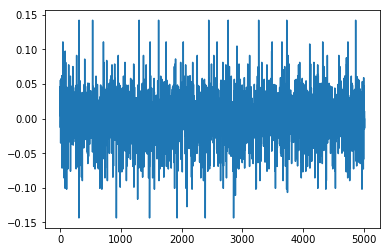

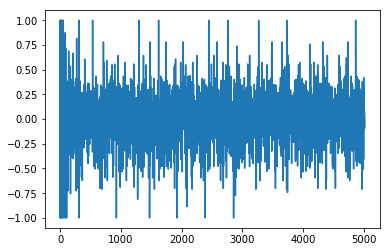

1.15090751707
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.88888889  0.22222222
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889
  0.22222222  0.          0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.11111111  0.33333333  1.
  0.88888889  0.          0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.22222222  0.55555556  0.88888889  0.11111111
  0.11111111  0.22222222  0.88888889  0.88888889  0.        ]
Writing away results
1996-04-01 00:00:00


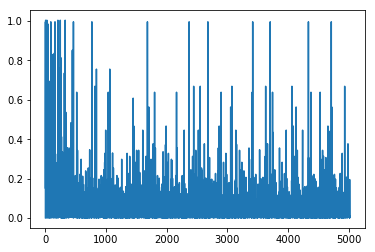

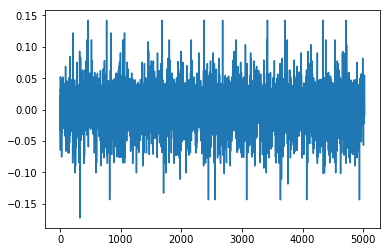

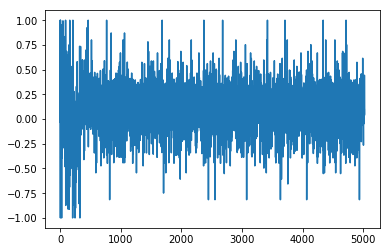

1.60217896286
[ 0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.88888889  0.88888889
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.88888889  0.66666667  0.66666667
  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1996-05-01 00:00:00


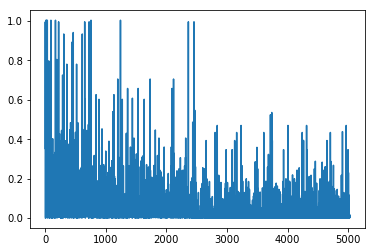

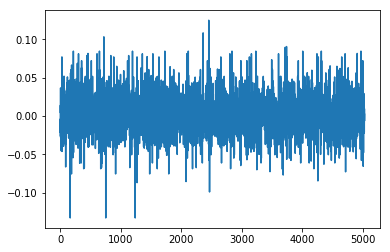

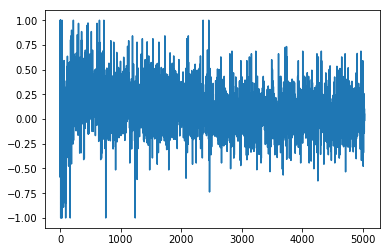

1.25213209768
[ 0.          0.          0.33333333  0.88888889  0.55555556  0.          0.
  0.          0.          0.          0.33333333  0.88888889  0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.33333333
  0.33333333  0.88888889  0.55555556  0.          0.          0.          0.
  0.          0.          0.33333333  0.          0.22222222  0.33333333
  0.33333333  0.88888889  0.          0.          0.          0.          0.
  0.33333333  0.33333333  0.88888889  0.33333333  0.          0.
  0.33333333  0.33333333  0.33333333  0.55555556  0.33333333  0.33333333]
Writing away results
1996-06-01 00:00:00


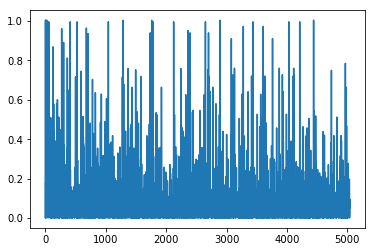

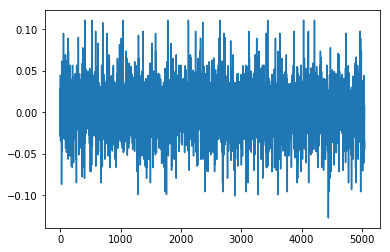

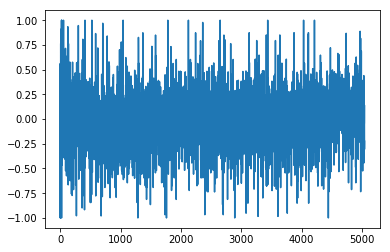

1.38033637696
[ 0.66666667  0.11111111  0.55555556  0.44444444  0.77777778  0.77777778
  0.66666667  0.77777778  0.66666667  0.11111111  0.55555556  0.77777778
  0.77777778  0.77777778  0.66666667  0.55555556  0.11111111  0.88888889
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.55555556  0.44444444  0.11111111  1.          0.44444444  0.77777778
  0.66666667  0.66666667  0.11111111  0.55555556  0.66666667  0.11111111
  0.66666667  0.11111111  1.          0.44444444  0.44444444  0.66666667
  0.77777778  0.66666667  0.22222222  0.66666667  0.11111111  0.22222222
  0.44444444  0.44444444  0.77777778  0.11111111  1.          0.44444444
  0.44444444  0.44444444  0.11111111  1.          0.44444444]
Writing away results
1996-07-01 00:00:00


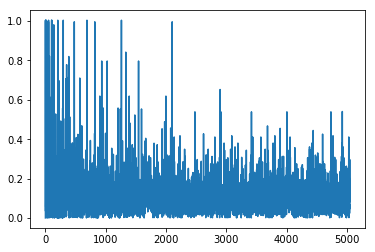

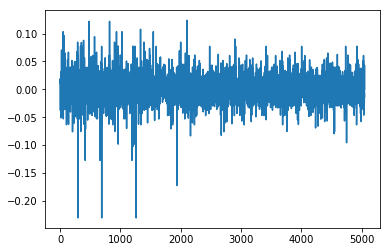

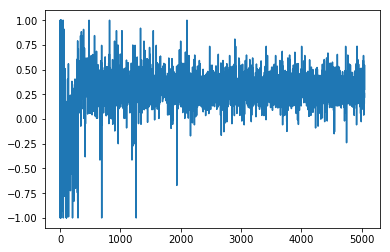

1.07704576275
[ 0.33333333  0.33333333  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.33333333  0.33333333  0.11111111
  0.33333333  0.11111111  0.11111111  1.          0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1996-08-01 00:00:00


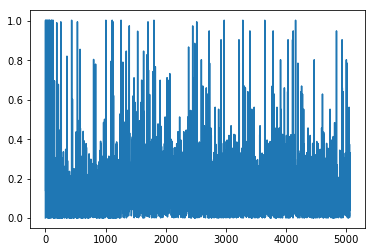

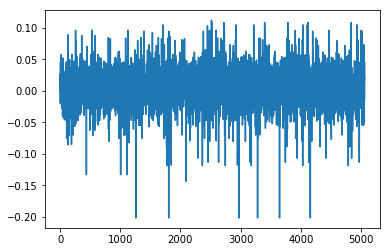

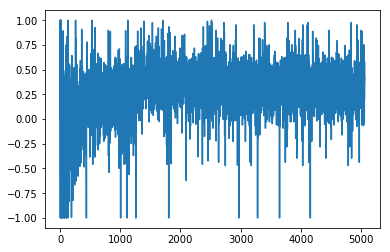

1.5075050492
[ 0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.88888889  0.88888889
  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.33333333  0.88888889  0.22222222
  0.88888889  0.88888889  0.33333333  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.33333333]
Writing away results
1996-09-01 00:00:00


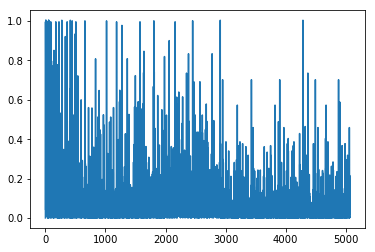

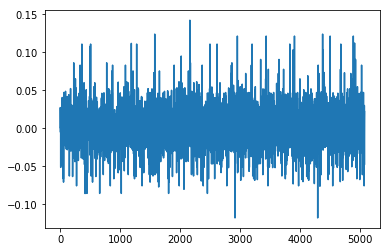

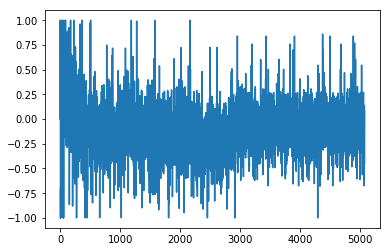

1.11934559186
[ 0.77777778  0.44444444  0.44444444  0.          0.44444444  0.
  0.22222222  0.77777778  0.77777778  0.          0.44444444  0.44444444
  0.33333333  1.          0.88888889  0.77777778  0.44444444  0.77777778
  0.          0.44444444  0.44444444  0.77777778  0.55555556  0.66666667
  0.55555556  0.77777778  0.88888889  0.44444444  0.33333333  0.44444444
  0.33333333  0.          0.22222222  0.11111111  0.66666667  0.22222222
  0.55555556  0.88888889  0.          0.44444444  0.44444444  0.33333333
  0.77777778  0.22222222  0.66666667  0.77777778  0.22222222  0.88888889
  1.          0.88888889  0.55555556  0.55555556  0.77777778  0.22222222
  0.66666667  0.77777778  0.55555556  0.88888889  0.66666667]
Writing away results
1996-10-01 00:00:00


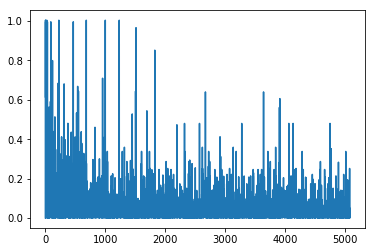

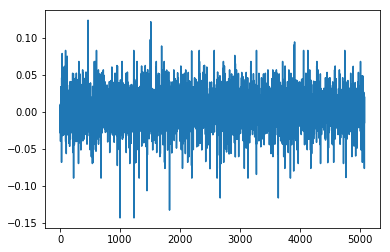

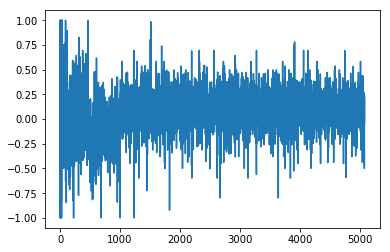

1.11874764759
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  1.          0.22222222  0.77777778
  1.          1.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  0.33333333  0.33333333  0.22222222  0.77777778
  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.22222222  0.22222222  0.77777778  0.22222222  0.33333333  0.33333333
  0.22222222  0.22222222  0.22222222  1.          0.22222222  0.22222222
  0.77777778  0.22222222  0.22222222  0.33333333  0.22222222]
Writing away results
1996-11-01 00:00:00


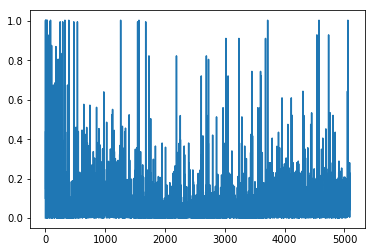

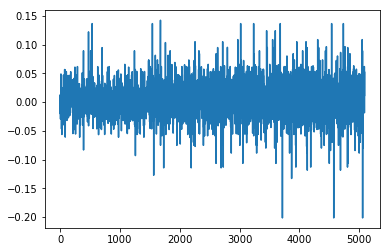

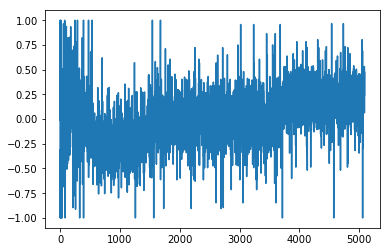

1.33682817845
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.33333333  0.11111111  1.          0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.88888889  0.44444444  0.11111111  0.11111111  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  1.          0.77777778  0.11111111  0.88888889  0.88888889  1.
  0.11111111  1.          0.77777778  0.11111111  1.          1.
  0.11111111  1.          0.88888889  0.11111111  0.11111111]
Writing away results
1996-12-01 00:00:00


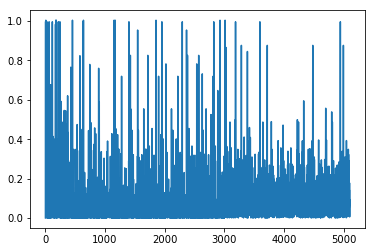

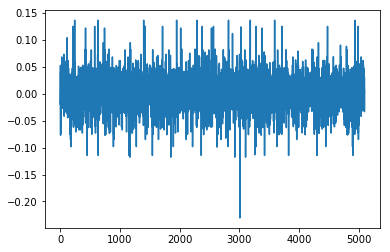

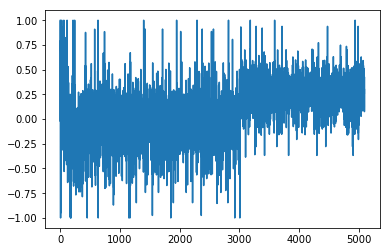

1.21103953561
[ 0.55555556  0.55555556  0.55555556  1.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.22222222  0.66666667  0.33333333  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.55555556  0.55555556  0.22222222  0.66666667  0.77777778  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.
  0.66666667  0.33333333  0.55555556  0.55555556  1.          0.66666667
  0.77777778  0.77777778  0.11111111  0.66666667  0.77777778  0.33333333
  1.          0.55555556  0.66666667  0.66666667  0.77777778]
Writing away results
1997-01-01 00:00:00


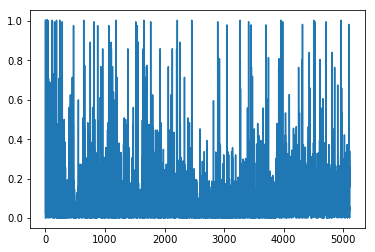

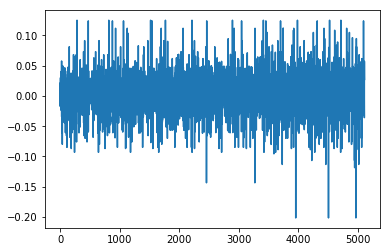

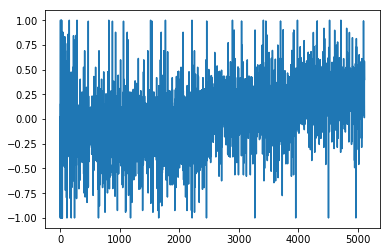

1.34761166623
[ 0.88888889  0.88888889  0.11111111  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  1.          0.66666667  0.33333333  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889
  0.88888889  0.66666667  0.          0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.66666667  0.66666667
  0.77777778  0.88888889  0.88888889  0.66666667  0.11111111  0.66666667
  0.77777778  1.          0.66666667  0.66666667  0.77777778  1.
  0.88888889  0.11111111  1.          0.66666667  0.77777778]
Writing away results
1997-02-01 00:00:00


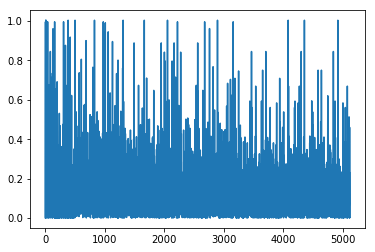

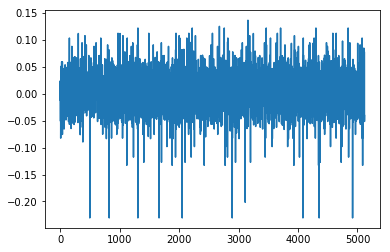

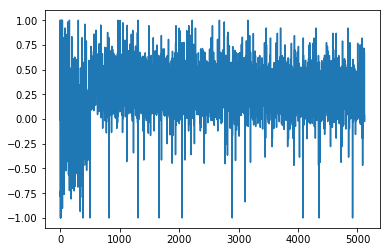

1.35053360652
[ 1.          0.55555556  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.55555556  0.55555556  0.55555556
  0.55555556  1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          0.55555556  0.55555556  0.55555556
  1.          1.          1.          1.          1.          0.55555556
  0.55555556  1.          0.55555556  1.          1.          0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  1.          0.55555556  0.55555556  0.55555556
  0.55555556  1.        ]
Writing away results
1997-03-01 00:00:00


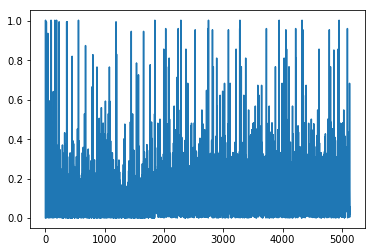

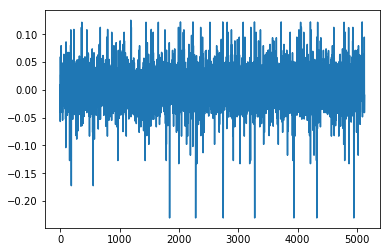

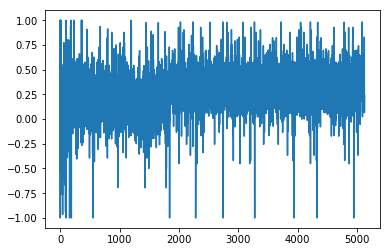

1.29777740278
[ 0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.22222222  1.          1.
  1.          1.          1.          1.          1.          0.44444444
  1.          1.          0.44444444  0.44444444  0.44444444  1.          1.
  1.          1.          1.          0.44444444  0.44444444  1.
  0.44444444  1.          1.          0.88888889  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.22222222  0.44444444  0.44444444
  1.          0.44444444  0.44444444  0.44444444  0.44444444  1.          1.        ]
Writing away results
1997-04-01 00:00:00


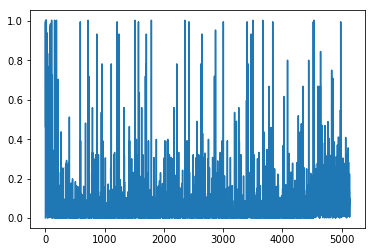

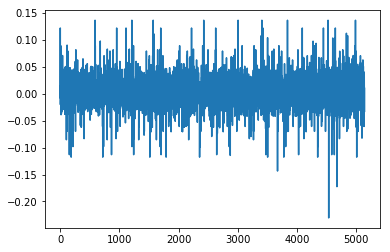

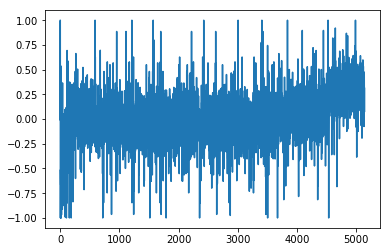

1.19027349777
[ 0.22222222  0.88888889  1.          1.          1.          1.
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          0.          0.11111111  0.22222222  0.          1.
  1.          1.          1.          1.          0.44444444  0.11111111
  1.          0.44444444  0.11111111  0.11111111  0.11111111  1.          1.
  1.          1.          0.44444444  0.11111111  0.11111111  0.22222222
  0.11111111  1.          1.          1.          0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  1.          1.
  0.11111111  0.11111111  0.11111111  0.11111111  1.          1.
  0.44444444]
Writing away results
1997-05-01 00:00:00


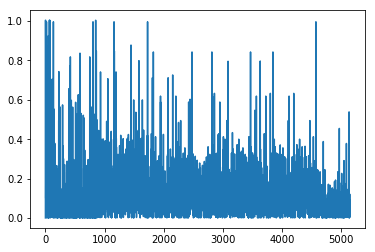

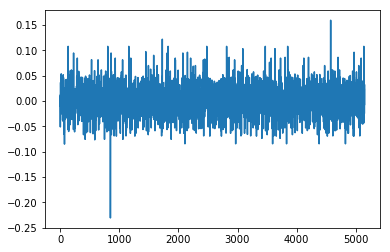

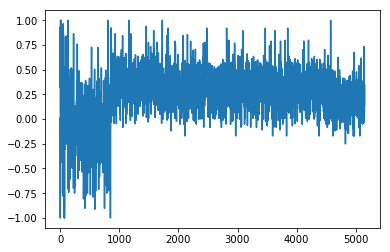

1.07393365656
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.66666667  0.66666667  0.77777778
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.77777778  0.66666667  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.77777778  0.11111111  0.11111111  0.11111111  0.66666667]
Writing away results
1997-06-01 00:00:00


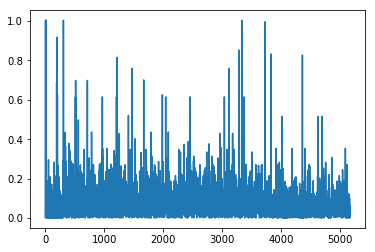

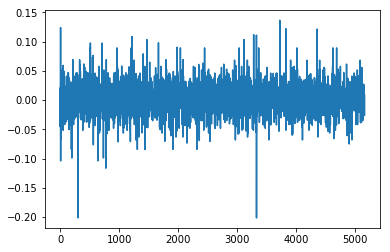

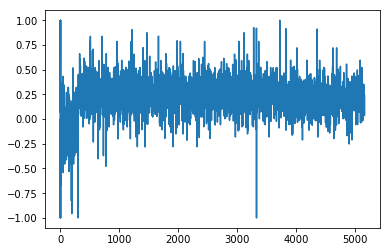

1.2236084281
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.11111111  0.11111111  0.11111111  0.77777778  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.33333333  0.33333333  0.11111111  0.11111111  0.88888889  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111
  0.33333333  0.11111111  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111  0.88888889
  0.33333333  0.33333333  0.33333333  0.88888889  0.11111111]
Writing away results
1997-07-01 00:00:00


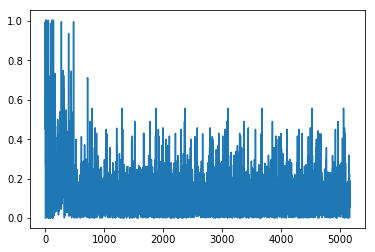

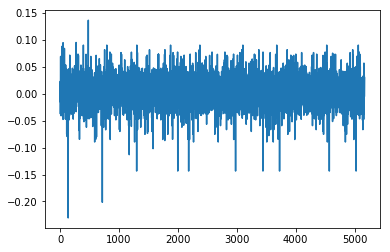

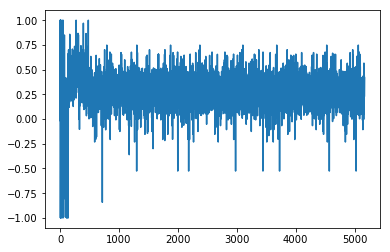

1.05092913672
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.44444444  0.44444444  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.66666667  0.44444444  0.44444444  0.44444444  0.33333333  0.66666667
  0.66666667  0.66666667  0.33333333  0.44444444  0.44444444]
Writing away results
1997-08-01 00:00:00


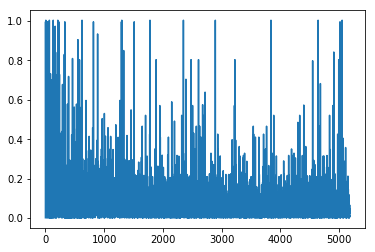

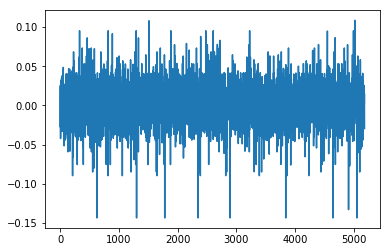

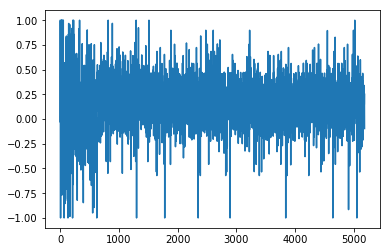

1.2428093756
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.          0.55555556  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.          0.
  0.          0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.          0.33333333  0.66666667
  0.          0.          0.          0.          0.          0.          0.
  0.          0.11111111  0.66666667  0.          0.          0.          0.
  0.33333333  0.66666667  0.66666667  0.55555556  0.          0.          0.        ]
Writing away results
1997-09-01 00:00:00


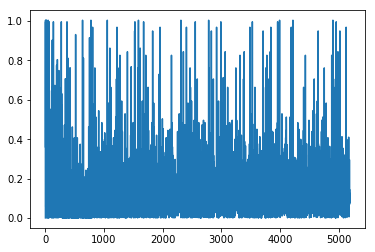

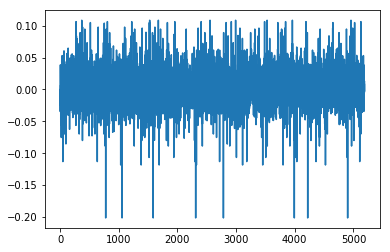

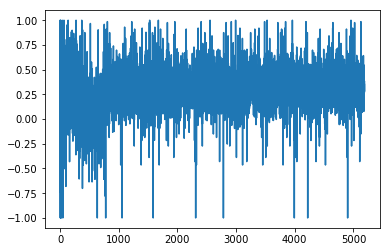

1.29382765316
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.88888889  0.88888889  0.11111111
  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.22222222  0.11111111  0.88888889
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889  0.11111111
  0.11111111  0.11111111  0.22222222  0.88888889  0.88888889  0.88888889
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1997-10-01 00:00:00


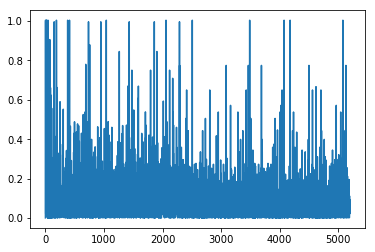

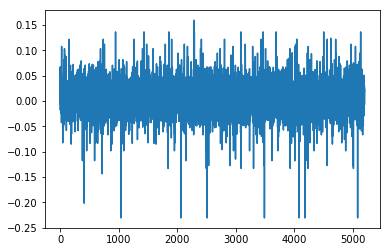

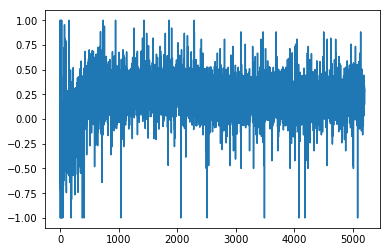

1.09924179551
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.88888889  0.44444444
  1.          1.          1.          1.          1.          1.
  0.44444444  1.          0.44444444  0.44444444  0.44444444  0.44444444
  1.          1.          1.          1.          1.          0.44444444
  1.          1.          0.44444444  1.          1.          1.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          1.          0.44444444  0.44444444  0.44444444
  0.44444444  1.          1.          1.          0.33333333  0.44444444
  0.11111111  0.44444444  0.44444444  0.44444444]
Writing away results
1997-11-01 00:00:00


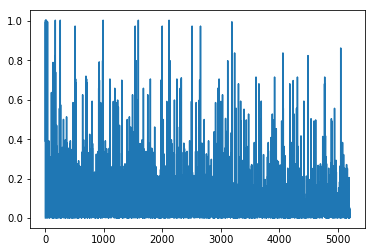

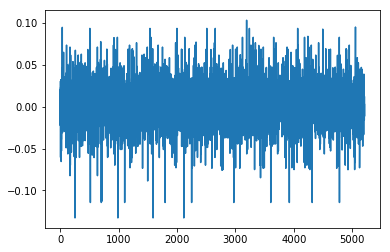

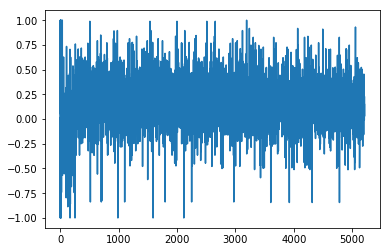

0.991230564674
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.44444444  0.44444444  0.66666667  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  0.55555556  0.44444444  0.44444444  0.44444444  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444
  0.          1.          0.44444444  0.55555556  0.55555556  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.22222222  0.55555556  0.44444444  0.44444444  0.44444444
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1997-12-01 00:00:00


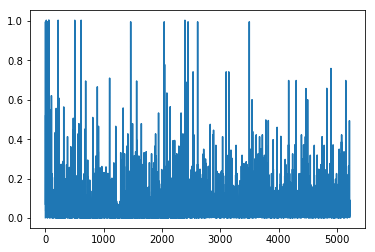

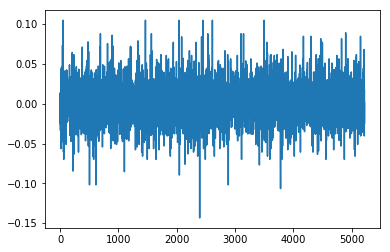

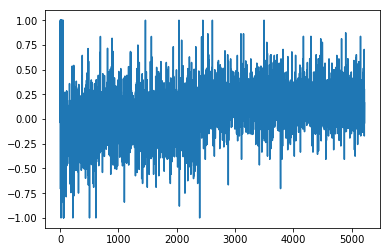

1.17198720725
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.33333333  0.33333333  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889  0.22222222
  0.22222222  0.          0.33333333  0.33333333  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444
  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889
  0.22222222  0.55555556  0.33333333  0.33333333  0.33333333  0.88888889
  0.22222222  0.22222222  0.55555556  0.33333333  0.33333333  0.11111111
  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444]
Writing away results
1998-01-01 00:00:00


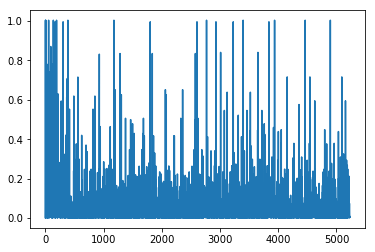

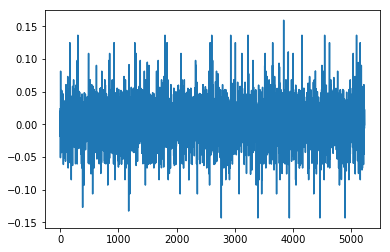

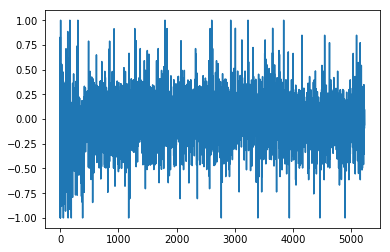

0.962790707598
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.77777778  0.77777778  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.22222222  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  1.          0.66666667
  0.77777778  0.66666667  0.66666667  1.          0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  1.
  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667  0.88888889
  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667]
Writing away results
1998-02-01 00:00:00


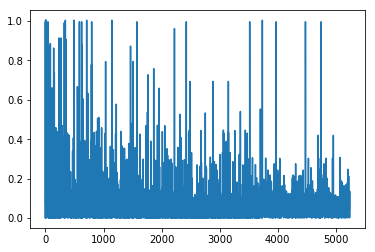

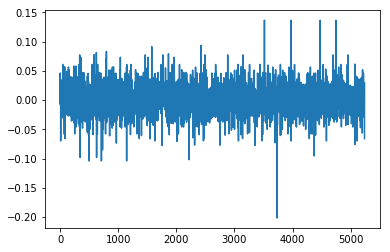

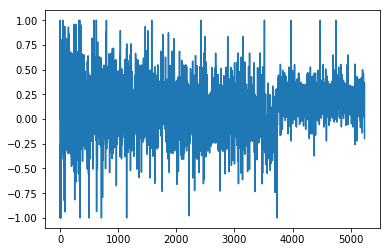

1.066782026
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.33333333
  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.22222222  0.22222222
  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.33333333  0.44444444  0.33333333
  0.22222222  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222
  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222
  0.22222222  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222]
Writing away results
1998-03-01 00:00:00


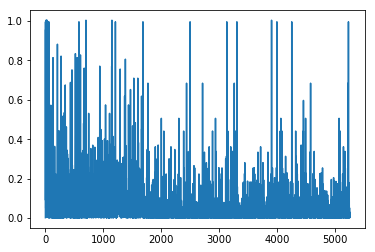

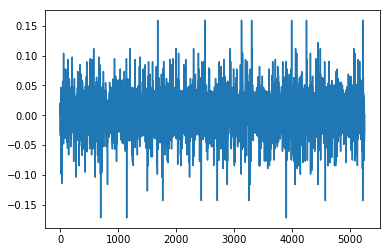

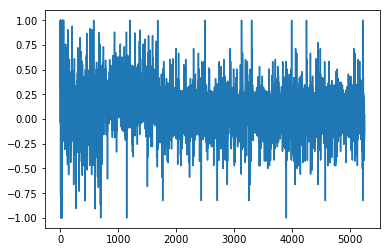

1.10114635285
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  1.          0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  1.          1.
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  1.          1.          0.22222222  0.66666667  0.66666667
  0.          1.          1.          0.22222222  0.22222222  1.          1.
  0.22222222  0.          0.66666667  1.          1.          1.
  0.22222222  0.66666667  0.66666667  0.66666667  1.          0.22222222
  1.          0.22222222  1.          1.          0.22222222  1.
  0.66666667  0.66666667  0.66666667]
Writing away results
1998-04-01 00:00:00


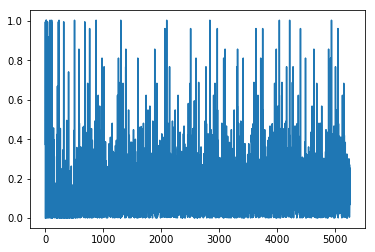

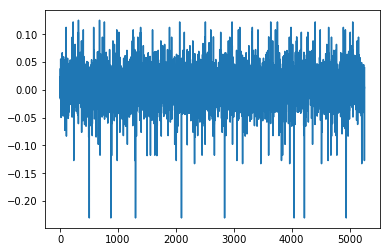

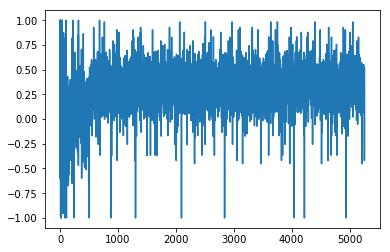

1.11848924561
[ 1.          1.          1.          0.          0.          0.77777778
  1.          1.          1.          1.          1.          1.          1.
  0.11111111  1.          1.          0.          0.          0.22222222
  1.          1.          1.          1.          1.          0.11111111
  0.          1.          0.11111111  1.          1.          0.          0.
  0.          0.11111111  0.          0.          0.          0.11111111
  0.11111111  1.          0.          0.          0.          0.11111111
  1.          1.          1.          1.          0.          0.          0.
  0.          0.          0.          0.22222222  1.          0.11111111
  1.          0.        ]
Writing away results
1998-05-01 00:00:00


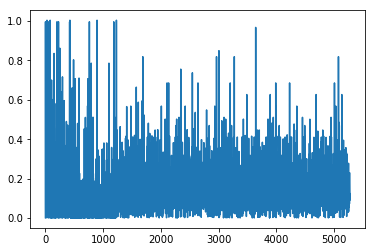

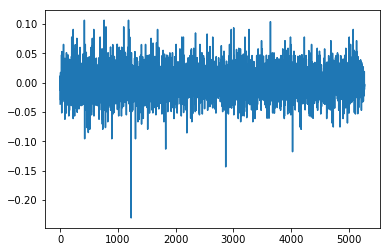

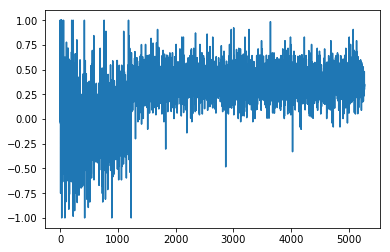

1.05211724061
[ 0.          0.          0.55555556  0.55555556  0.55555556  0.44444444
  0.          0.          0.          0.          0.          0.
  0.33333333  0.          0.          0.55555556  0.55555556  0.55555556
  0.          0.          0.          0.          0.          0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.44444444  0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.          0.55555556  0.55555556]
Writing away results
1998-06-01 00:00:00


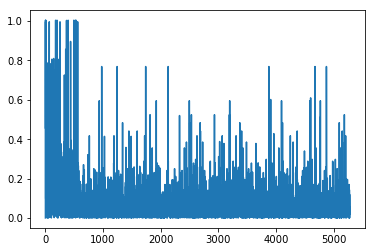

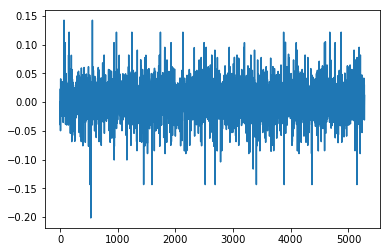

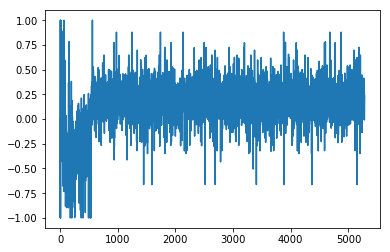

1.14994499268
[ 0.66666667  0.33333333  0.          0.22222222  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.          0.55555556  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.88888889
  0.22222222  0.          0.66666667  0.66666667  0.88888889  0.88888889
  0.          0.33333333  0.          0.88888889  0.55555556  0.          0.
  0.66666667  0.          0.          0.          0.11111111  0.66666667
  0.66666667  0.66666667  0.11111111  0.          0.          0.          0.
  0.          0.          0.          0.66666667  0.          0.66666667
  0.22222222  0.          0.66666667]
Writing away results
1998-07-01 00:00:00


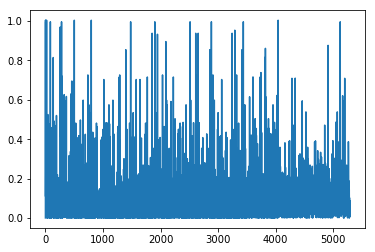

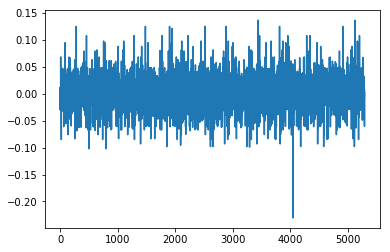

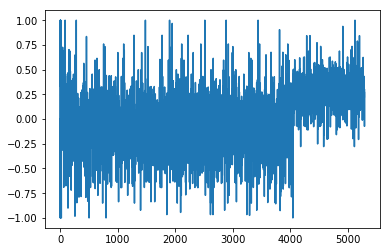

0.985743157716
[ 0.          0.77777778  0.33333333  0.          0.11111111  0.11111111
  0.11111111  0.11111111  1.          0.          0.77777778  1.          0.
  0.77777778  0.77777778  0.33333333  0.          0.11111111  0.11111111
  1.          0.11111111  0.77777778  0.77777778  0.88888889  0.77777778
  1.          0.11111111  1.          0.77777778  0.77777778  0.
  0.77777778  0.77777778  0.88888889  0.77777778  0.77777778  1.
  0.77777778  0.77777778  0.77777778  0.          0.11111111  0.11111111
  1.          1.          0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.33333333  0.          0.11111111  1.
  0.77777778  0.77777778  0.          0.11111111]
Writing away results
1998-08-01 00:00:00


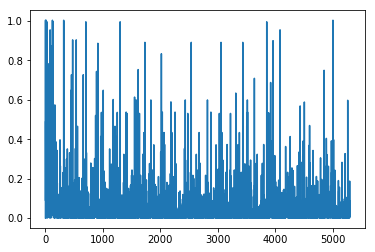

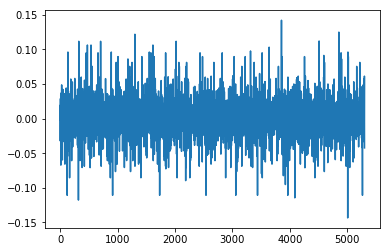

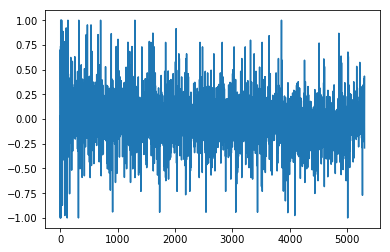

0.999415611932
[ 0.          0.33333333  1.          0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.44444444  0.44444444
  0.          0.88888889  0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.88888889  1.          0.
  0.22222222  0.44444444  0.77777778  0.88888889  0.          1.          0.
  0.          1.          0.          0.          0.44444444  0.          0.
  0.          0.55555556  0.55555556  0.44444444  0.88888889  1.          0.
  0.          0.77777778  0.          0.          0.          0.
  0.55555556  0.55555556  0.88888889  1.          0.          0.22222222
  0.44444444  0.44444444]
Writing away results
1998-09-01 00:00:00


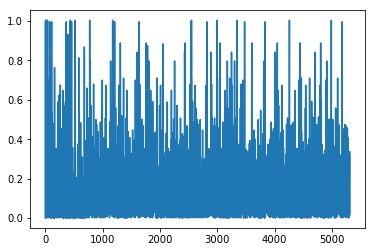

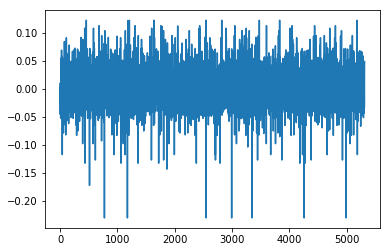

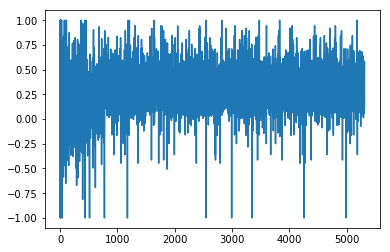

1.08570548976
[ 0.44444444  0.44444444  1.          1.          1.          1.          1.
  1.          0.55555556  1.          1.          0.55555556  0.55555556
  0.44444444  1.          1.          1.          1.          1.
  0.55555556  0.55555556  0.44444444  0.55555556  1.          1.
  0.55555556  0.55555556  0.44444444  0.44444444  0.55555556  0.55555556
  0.44444444  0.55555556  0.55555556  1.          0.55555556  0.55555556
  0.44444444  0.44444444  1.          1.          1.          0.44444444
  0.55555556  0.44444444  0.55555556  0.55555556  0.44444444  0.55555556
  0.44444444  1.          1.          1.          0.55555556  0.44444444
  1.          1.          1.          1.        ]
Writing away results
1998-10-01 00:00:00


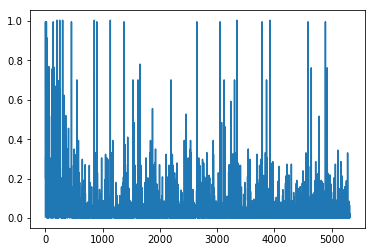

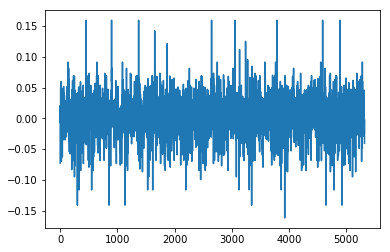

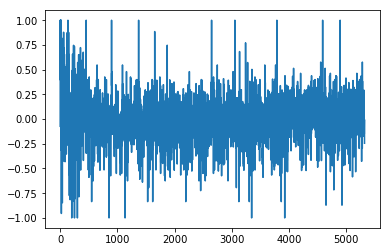

0.942065420262
[ 0.          0.          0.33333333  0.33333333  0.11111111  0.66666667
  0.33333333  0.          0.66666667  0.88888889  1.          0.88888889
  0.22222222  0.11111111  0.33333333  0.33333333  0.66666667  0.33333333
  0.          0.66666667  0.33333333  0.          0.66666667  0.33333333
  0.66666667  0.88888889  0.22222222  0.          0.          0.66666667
  0.22222222  0.          0.          0.33333333  1.          1.
  0.22222222  0.          0.11111111  0.33333333  0.66666667  0.22222222
  0.44444444  1.          0.88888889  1.          0.22222222  0.
  0.22222222  0.11111111  0.55555556  0.66666667  0.88888889  1.
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1998-11-01 00:00:00


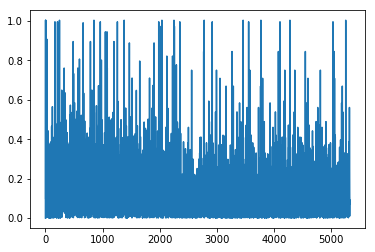

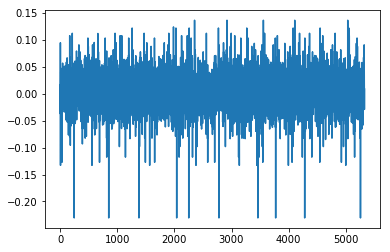

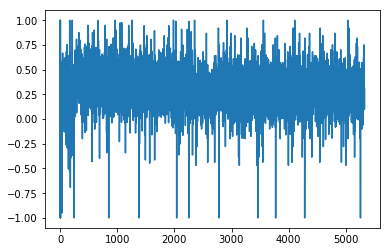

1.03396001774
[ 1.          1.          1.          1.          1.          1.
  0.55555556  1.          1.          0.55555556  0.55555556  0.22222222
  1.          1.          1.          1.          1.          0.55555556
  0.55555556  1.          0.55555556  1.          1.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  1.          0.55555556  0.55555556  0.55555556
  0.66666667  1.          1.          1.          1.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  1.          1.          1.          0.55555556  0.55555556  1.          1.
  1.          1.          1.          1.        ]
Writing away results
1998-12-01 00:00:00


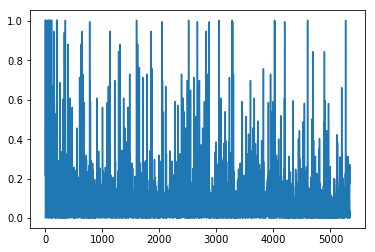

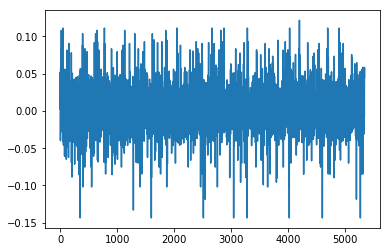

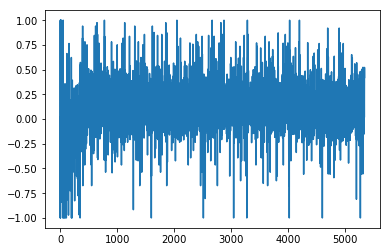

1.03832562603
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.22222222  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.22222222
  0.          0.88888889  0.66666667  0.66666667  1.          0.11111111
  0.11111111  0.11111111  0.22222222  0.22222222  0.11111111  0.11111111
  0.66666667  0.66666667  0.22222222  0.22222222  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.11111111  0.22222222  0.33333333
  0.11111111  0.22222222  0.11111111  0.22222222  0.          0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1999-01-01 00:00:00


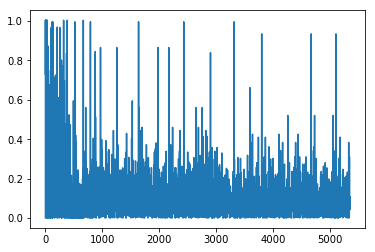

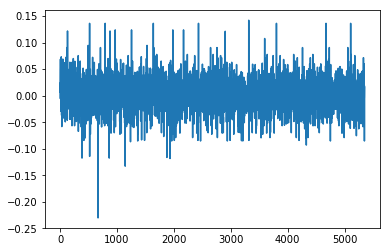

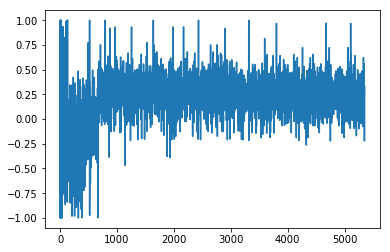

1.01746316999
[ 0.44444444  0.44444444  0.44444444  0.44444444  1.          0.44444444
  0.44444444  0.55555556  0.55555556  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.55555556  0.33333333
  0.55555556  0.44444444  0.44444444  0.55555556  0.55555556  0.55555556
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  1.
  0.44444444  0.55555556  0.55555556  0.55555556  0.66666667  0.44444444
  0.44444444  0.44444444  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444  1.
  0.44444444  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1999-02-01 00:00:00


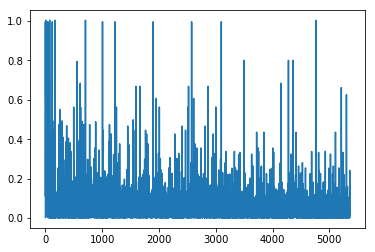

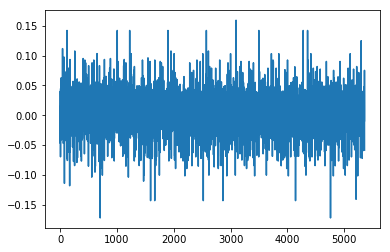

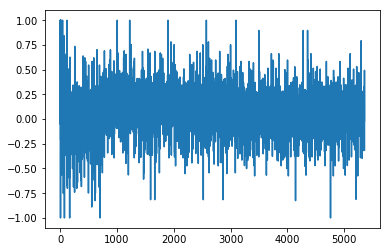

1.04969875103
[ 0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  1.          0.88888889  0.88888889
  0.66666667  0.66666667  1.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1999-03-01 00:00:00


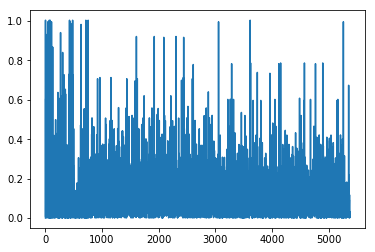

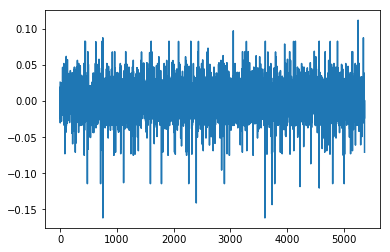

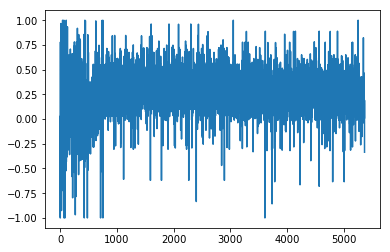

1.20139026631
[ 0.55555556  0.55555556  0.          0.55555556  0.55555556  0.22222222
  0.22222222  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.55555556  0.22222222  0.55555556
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.55555556  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.55555556  0.          0.55555556  0.22222222
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1999-04-01 00:00:00


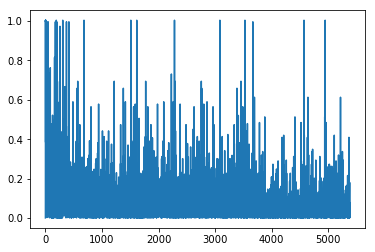

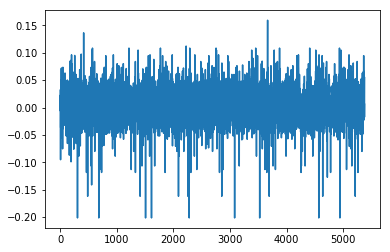

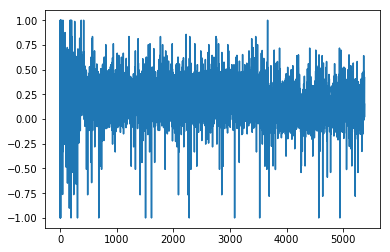

1.07252021439
[ 0.88888889  1.          0.88888889  0.88888889  0.44444444  0.44444444
  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.44444444  0.88888889  0.44444444  0.88888889  0.88888889
  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444  0.44444444
  0.44444444  0.33333333  0.55555556  0.88888889  0.44444444  0.44444444
  0.44444444  0.33333333  0.88888889  0.88888889  0.88888889  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.55555556  0.88888889  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1999-05-01 00:00:00


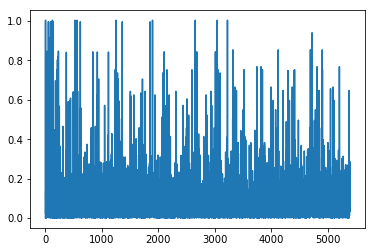

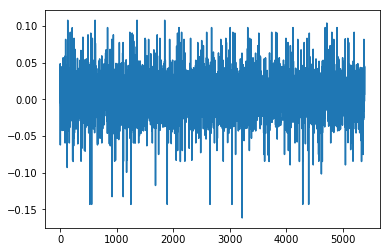

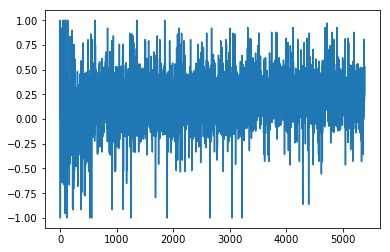

1.12341707193
[ 0.77777778  0.66666667  0.11111111  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.55555556  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.11111111  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444
  0.11111111  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1999-06-01 00:00:00


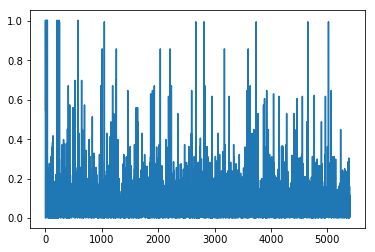

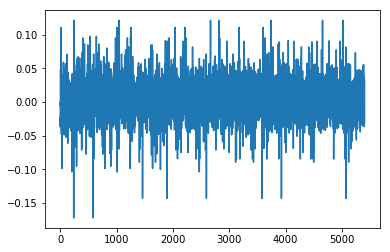

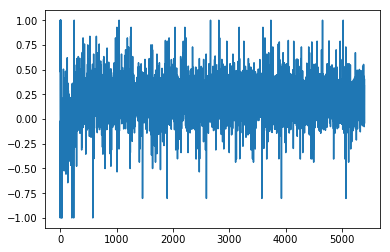

0.866054685756
[ 0.66666667  0.66666667  0.88888889  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.44444444
  1.          0.11111111  0.66666667  0.66666667  0.88888889  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  1.          0.11111111  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.22222222  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.        ]
Writing away results
1999-07-01 00:00:00


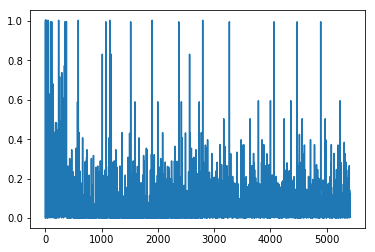

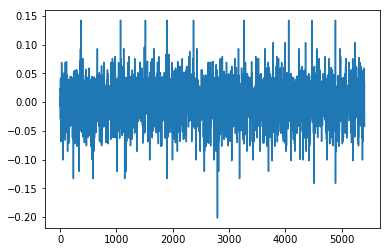

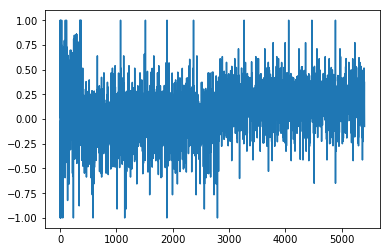

1.03888797563
[ 0.44444444  0.88888889  0.88888889  0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.88888889  0.
  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.44444444  0.88888889  0.88888889  0.88888889  0.66666667  0.44444444
  0.44444444  0.44444444  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.33333333
  0.44444444  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889]
Writing away results
1999-08-01 00:00:00


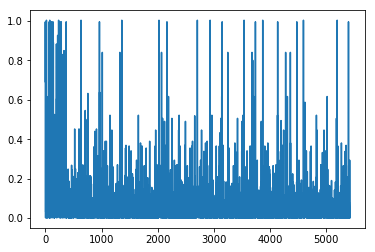

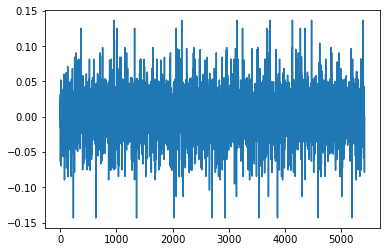

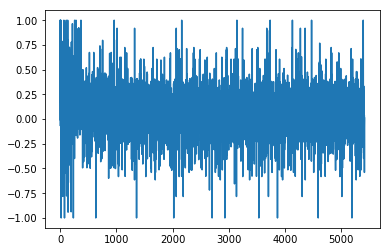

0.856880049864
[ 0.77777778  0.55555556  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.77777778  0.88888889  0.77777778
  0.66666667  0.66666667  0.77777778  0.55555556  0.77777778  0.88888889
  0.77777778  0.77777778  0.88888889  0.11111111  1.          0.88888889
  0.55555556  0.77777778  0.44444444  0.66666667  0.66666667  0.66666667
  0.22222222  0.          0.33333333  0.77777778  0.55555556  0.77777778
  0.44444444  0.55555556  0.          0.66666667  0.66666667  0.88888889
  0.55555556  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.          0.77777778]
Writing away results
1999-09-01 00:00:00


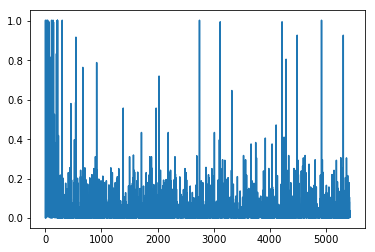

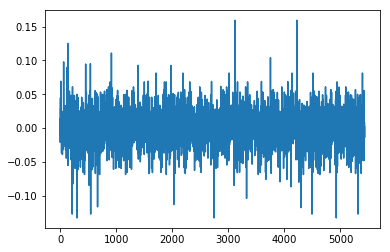

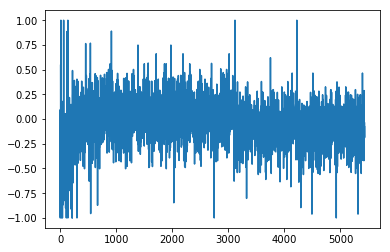

1.14283523213
[ 0.77777778  0.33333333  0.33333333  0.          0.22222222  0.22222222
  0.22222222  0.44444444  0.77777778  0.33333333  0.11111111  0.
  0.22222222  0.66666667  0.77777778  0.11111111  0.33333333  0.11111111
  0.77777778  0.33333333  0.11111111  0.          0.22222222  0.77777778
  0.11111111  0.11111111  0.33333333  0.          0.22222222  0.88888889
  0.33333333  0.11111111  0.77777778  0.77777778  0.11111111  0.11111111
  0.11111111  0.          0.33333333  0.          0.22222222  0.77777778
  0.11111111  0.33333333  0.          0.22222222  0.22222222  0.22222222
  0.22222222  0.88888889  1.          0.          0.22222222  0.22222222
  0.22222222  0.77777778  0.77777778  0.33333333  0.11111111]
Writing away results
1999-10-01 00:00:00


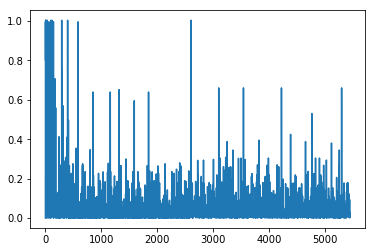

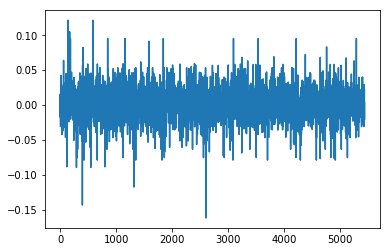

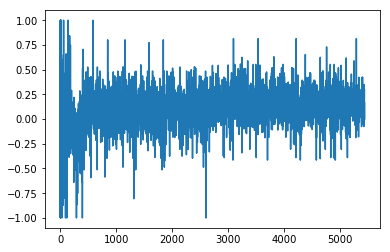

1.20623333
[ 0.          0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.          0.          0.11111111  0.          0.11111111  0.11111111
  0.          0.          0.          0.55555556  0.          0.          0.
  0.          0.          0.11111111  0.          0.          0.
  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111  0.          0.
  0.          0.          0.          0.          0.          0.11111111
  0.          0.11111111  0.22222222  0.          0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.          0.          0.
  0.          0.22222222]
Writing away results
1999-11-01 00:00:00


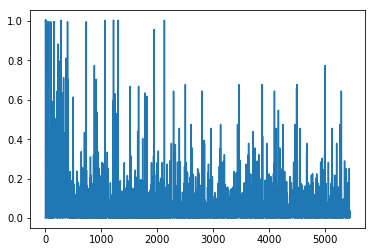

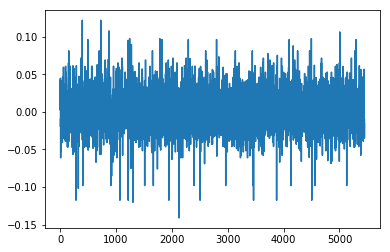

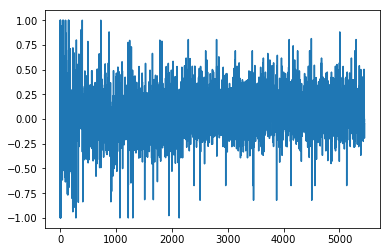

1.05631113339
[ 0.22222222  0.22222222  0.22222222  0.88888889  0.22222222  0.55555556
  0.77777778  0.22222222  0.33333333  0.22222222  0.22222222  0.77777778
  0.33333333  0.33333333  0.33333333  0.55555556  0.33333333  0.33333333
  0.55555556  0.55555556  0.22222222  0.33333333  0.33333333  0.33333333
  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889  0.33333333
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.22222222  0.55555556  0.88888889  0.33333333  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.77777778
  0.33333333  0.55555556  0.55555556  0.11111111  0.22222222]
Writing away results
1999-12-01 00:00:00


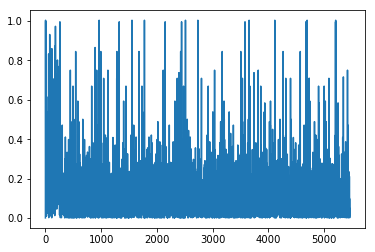

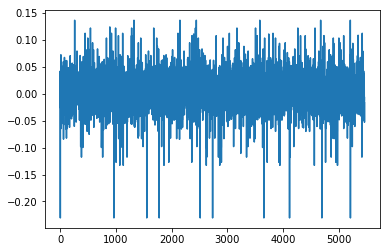

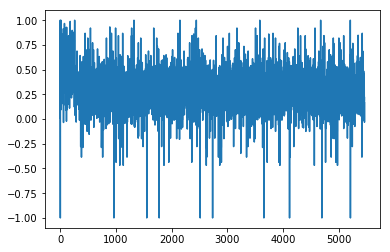

1.12520097521
[ 1.          1.          1.          1.          0.55555556  0.22222222
  0.22222222  0.22222222  1.          1.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.
  1.          0.22222222  0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.22222222  0.22222222  0.22222222  1.          1.
  1.        ]
Writing away results
2000-01-01 00:00:00


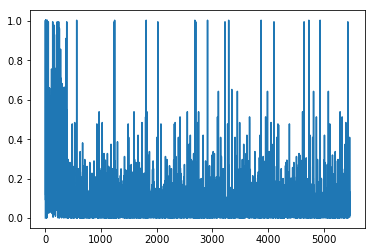

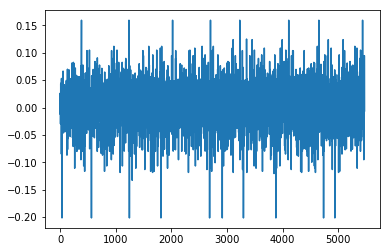

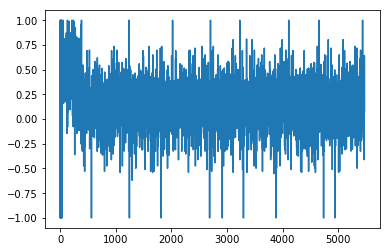

0.990434705266
[ 0.88888889  0.88888889  0.88888889  1.          1.          0.44444444
  1.          0.88888889  0.88888889  0.55555556  1.          1.          1.
  1.          1.          1.          1.          0.55555556  0.88888889
  1.          1.          1.          0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.55555556  0.88888889  1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          0.88888889  0.88888889
  0.88888889  0.88888889]
Writing away results
2000-02-01 00:00:00


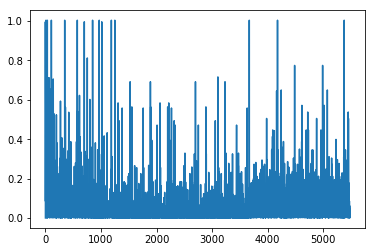

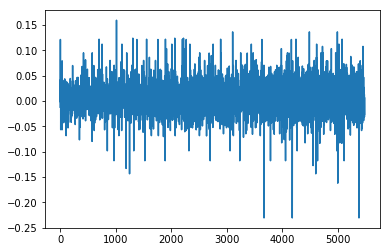

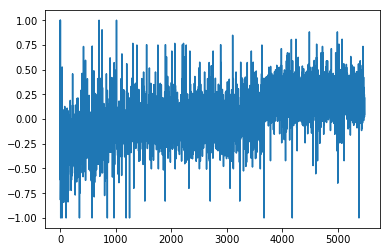

1.17531580993
[ 1.          1.          0.          0.11111111  0.22222222  0.          1.
  1.          0.88888889  0.          0.          0.          0.          0.
  0.22222222  0.          0.88888889  1.          0.          0.          0.
  0.44444444  1.          1.          1.          0.44444444  0.          0.
  0.          0.          0.          0.          0.          0.44444444
  1.          1.          0.11111111  0.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.          0.          0.          0.          1.
  1.          1.          1.          1.        ]
Writing away results
2000-03-01 00:00:00


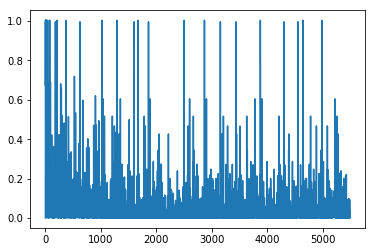

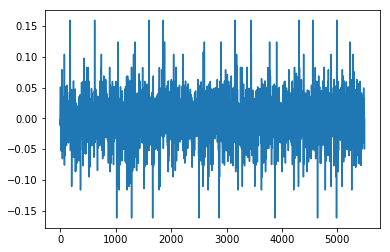

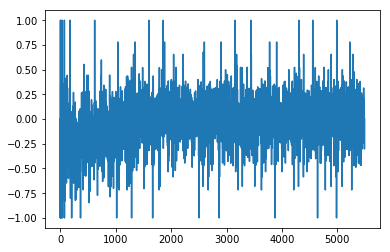

1.22748782692
[ 0.55555556  1.          0.44444444  0.33333333  1.          0.22222222
  0.          0.          0.33333333  0.88888889  0.77777778  1.
  0.88888889  0.77777778  1.          0.          0.          0.11111111
  1.          0.33333333  0.77777778  0.22222222  0.          0.44444444
  0.66666667  1.          0.22222222  0.66666667  1.          0.33333333
  1.          0.22222222  0.55555556  0.          0.44444444  0.66666667
  1.          0.77777778  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.55555556  0.55555556  0.22222222  0.55555556  0.          0.
  0.66666667  0.88888889  1.          1.          0.44444444  0.55555556
  0.22222222  0.55555556  0.55555556  0.        ]
Writing away results
2000-04-01 00:00:00


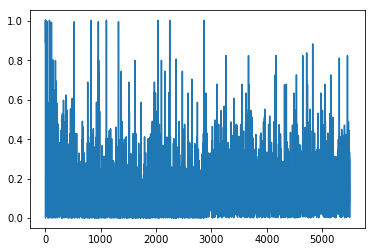

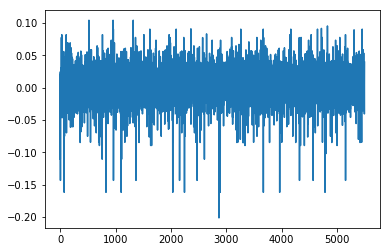

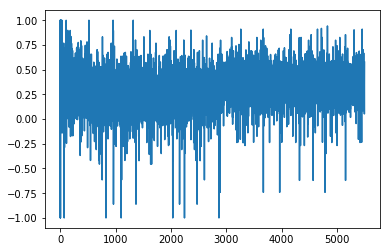

1.16311360702
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.22222222  0.66666667  0.33333333  0.33333333
  0.33333333  1.          0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2000-05-01 00:00:00


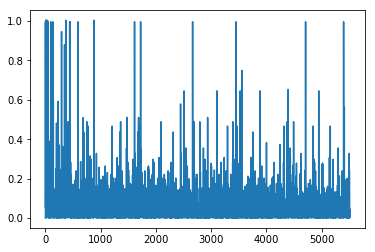

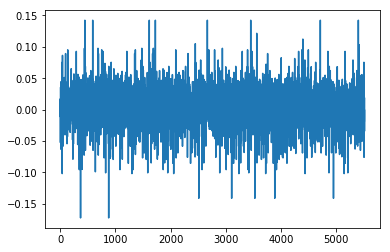

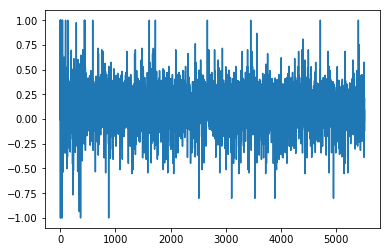

0.98930581335
[ 0.11111111  0.88888889  0.88888889  0.33333333  0.33333333  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.77777778  0.33333333  0.33333333  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.77777778  0.33333333  0.88888889  0.88888889  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.
  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333  0.77777778
  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556]
Writing away results
2000-06-01 00:00:00


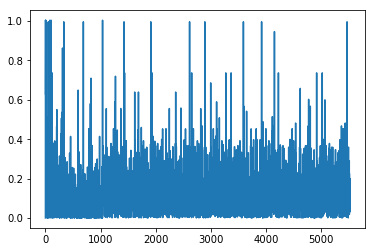

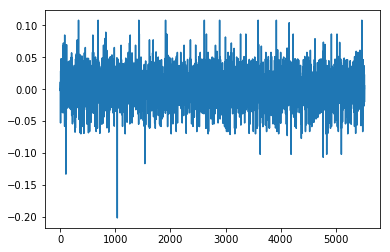

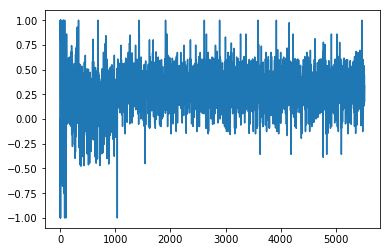

1.03534932953
[ 0.66666667  0.88888889  0.          0.          0.66666667  0.66666667
  0.66666667  0.88888889  0.33333333  0.66666667  0.66666667  0.88888889
  0.          0.          0.66666667  0.66666667  0.66666667  0.88888889
  0.          0.          0.          0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.          0.
  0.          0.66666667  0.66666667  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.33333333  0.          0.
  0.          0.          0.          0.          0.          0.66666667
  0.66666667]
Writing away results
2000-07-01 00:00:00


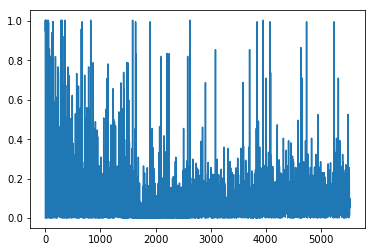

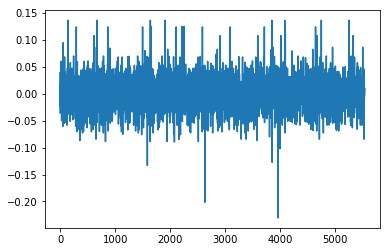

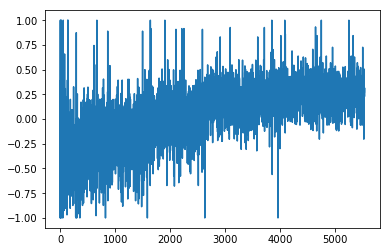

0.989870318679
[ 0.66666667  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.33333333  0.66666667  0.66666667  0.66666667  0.55555556  0.33333333
  0.33333333  0.33333333  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  1.
  0.33333333  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.44444444  0.66666667  0.33333333]
Writing away results
2000-08-01 00:00:00


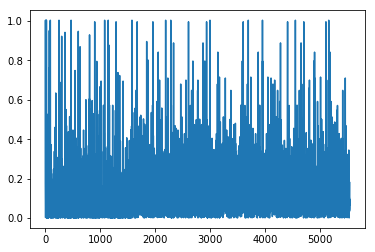

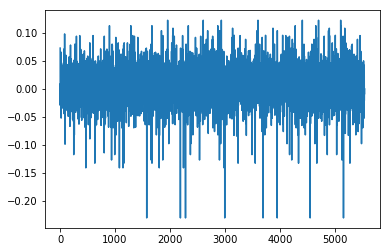

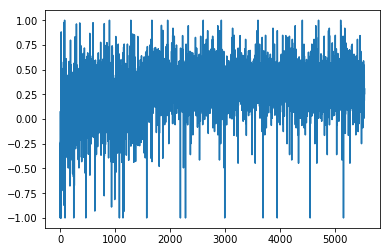

1.32572583455
[ 1.          1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.          0.
  0.          0.          1.          1.          1.          0.77777778
  0.          0.          0.          0.          0.          0.          0.
  1.          1.          1.          0.          0.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.          0.          0.          0.
  1.          1.          1.          1.          1.          1.          1.
  0.          0.          0.77777778  1.        ]
Writing away results
2000-09-01 00:00:00


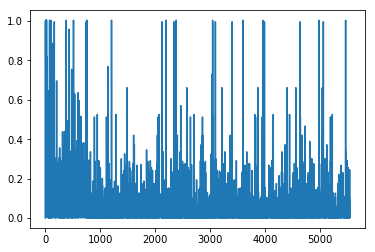

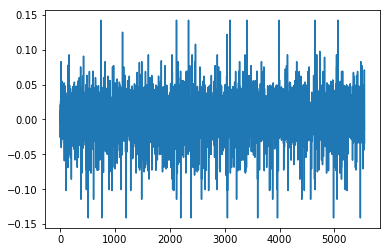

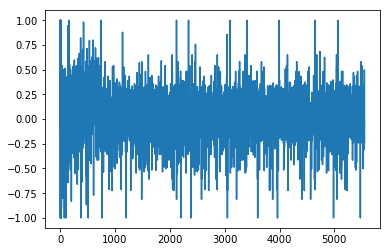

1.09431446601
[ 0.55555556  0.          0.88888889  0.11111111  0.88888889  0.44444444
  0.11111111  0.11111111  0.88888889  0.          0.55555556  0.88888889
  0.44444444  0.44444444  0.88888889  0.          0.55555556  0.55555556
  0.11111111  0.88888889  0.          0.88888889  0.44444444  0.88888889
  0.88888889  0.66666667  0.55555556  0.          0.11111111  0.88888889
  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.33333333  0.33333333  0.88888889  0.77777778
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.88888889  0.33333333  0.66666667  0.55555556  0.55555556]
Writing away results
2000-10-01 00:00:00


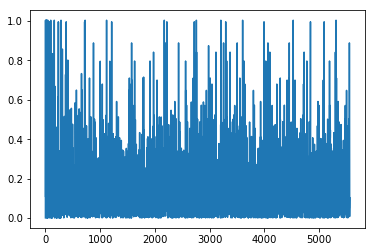

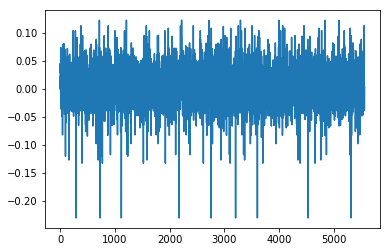

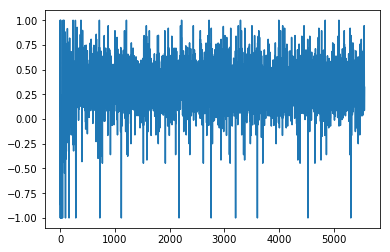

1.22444035542
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  1.          0.44444444  0.44444444
  0.44444444  0.33333333  1.          1.          1.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          1.          1.          0.44444444  0.44444444
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.44444444
  0.44444444  0.44444444  0.44444444  0.22222222  1.          1.          1.
  1.          1.          1.          0.44444444  0.44444444  0.44444444
  1.          1.          1.        ]
Writing away results
2000-11-01 00:00:00


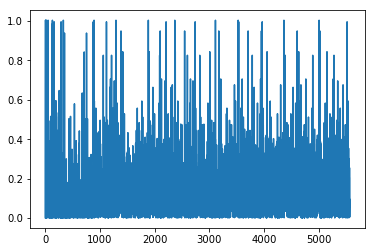

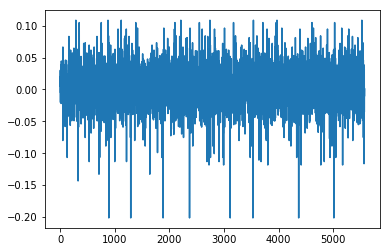

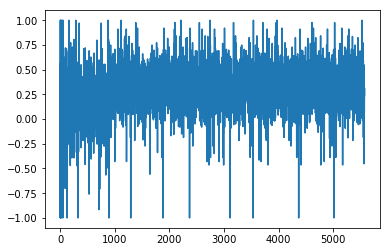

1.27857803922
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.88888889  0.22222222  0.22222222  0.22222222
  0.22222222  0.88888889  0.88888889  0.88888889  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.22222222
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2000-12-01 00:00:00


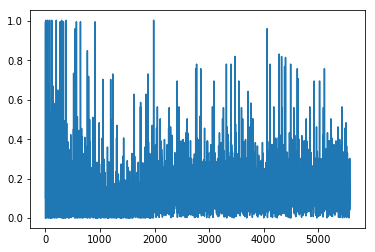

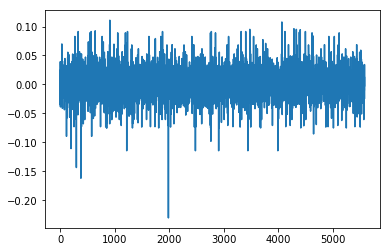

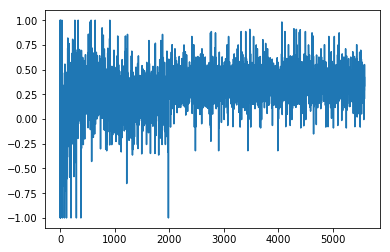

1.25672022511
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.33333333  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111]
Writing away results
2001-01-01 00:00:00


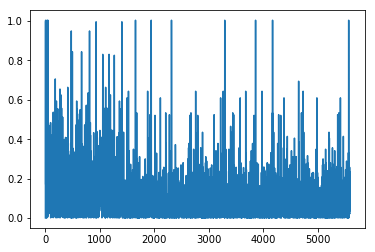

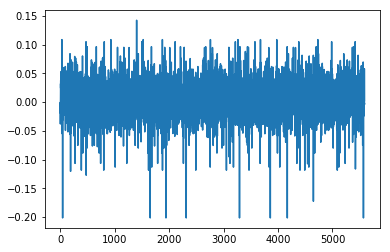

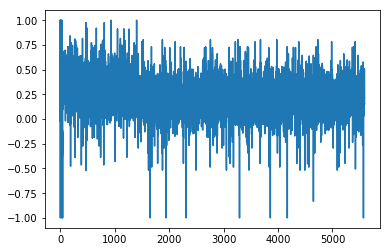

1.31496785468
[ 0.11111111  0.          0.          0.11111111  0.          0.
  0.88888889  0.          0.          0.          0.11111111  0.88888889
  0.88888889  0.88888889  1.          0.          0.          0.          0.
  0.          0.          0.          0.88888889  0.          0.88888889
  0.          0.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.88888889]
Writing away results
2001-02-01 00:00:00


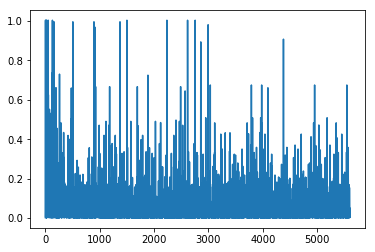

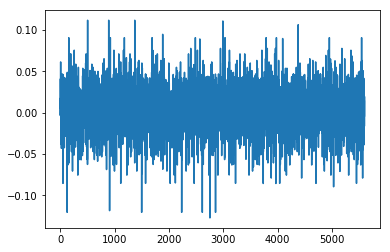

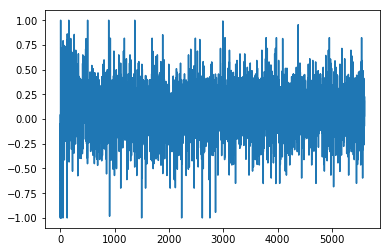

1.17856350943
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444
  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.55555556  0.55555556  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.77777778  0.44444444
  0.44444444  0.44444444  0.55555556  0.55555556  0.77777778]
Writing away results
2001-03-01 00:00:00


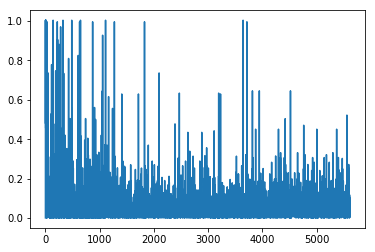

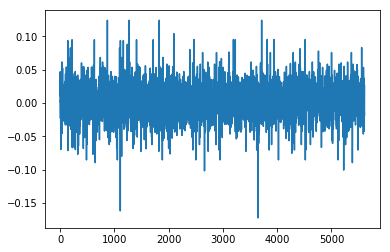

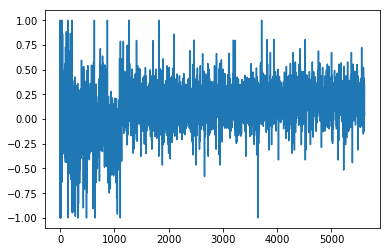

1.20764048377
[ 0.          0.          0.          1.          0.44444444  0.          0.
  0.          0.22222222  0.44444444  0.44444444  0.44444444  0.          0.
  0.          0.          0.          0.          0.          0.
  0.33333333  0.66666667  0.44444444  0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.
  0.          0.          0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.          0.44444444
  0.11111111  0.44444444  0.44444444  0.44444444  0.          0.44444444
  0.33333333  0.44444444]
Writing away results
2001-04-01 00:00:00


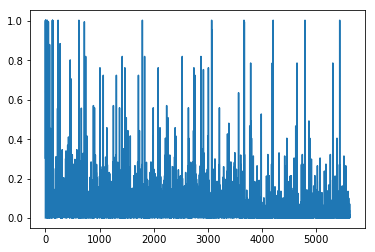

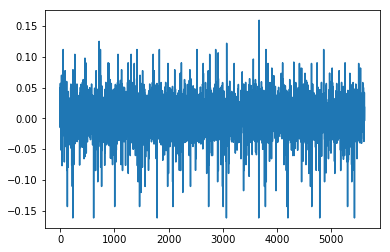

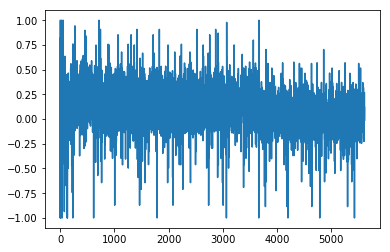

1.28450044913
[ 0.11111111  0.11111111  0.33333333  0.66666667  0.11111111  0.11111111
  0.11111111  1.          0.66666667  0.66666667  0.66666667  0.55555556
  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.33333333  0.66666667  1.          0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.11111111  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.88888889  1.          0.66666667  0.66666667]
Writing away results
2001-05-01 00:00:00


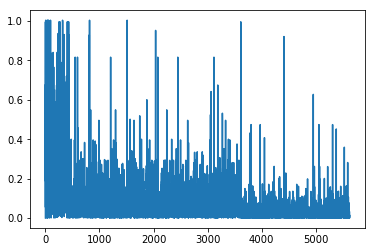

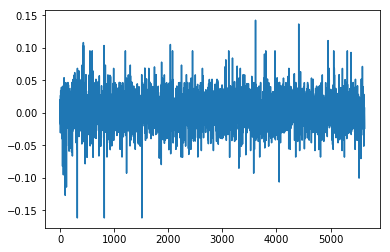

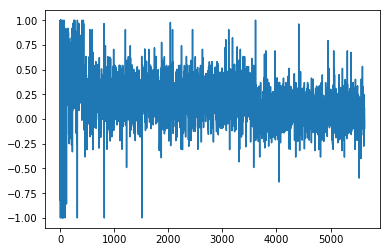

1.18058503751
[ 0.          0.44444444  0.33333333  0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.66666667  0.          0.          0.
  0.          0.          0.          0.          0.33333333  0.33333333
  0.33333333  0.          0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.          0.          0.
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.          0.          0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.          0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333]
Writing away results
2001-06-01 00:00:00


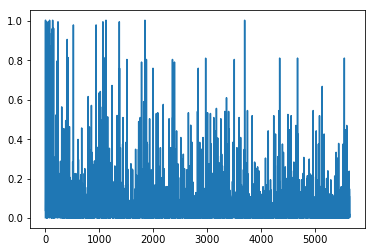

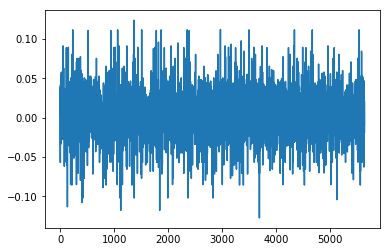

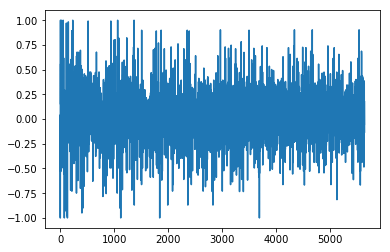

0.967000971595
[ 0.66666667  0.44444444  0.11111111  0.11111111  1.          0.22222222
  0.22222222  0.44444444  0.44444444  1.          0.88888889  1.          1.
  0.11111111  1.          0.11111111  1.          0.44444444  0.66666667
  0.44444444  1.          0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.11111111  1.          0.11111111
  0.11111111  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  1.          0.11111111  1.          0.44444444
  0.44444444  0.44444444  0.44444444  0.11111111  1.          0.33333333
  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2001-07-01 00:00:00


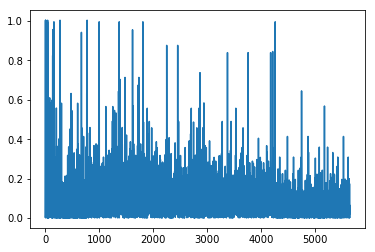

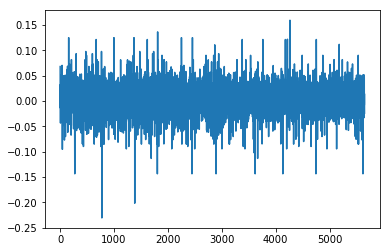

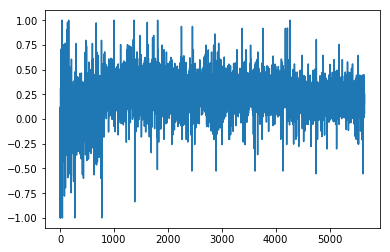

1.22557198964
[ 0.66666667  0.33333333  0.33333333  0.33333333  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667  0.44444444
  0.66666667  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333]
Writing away results
2001-08-01 00:00:00


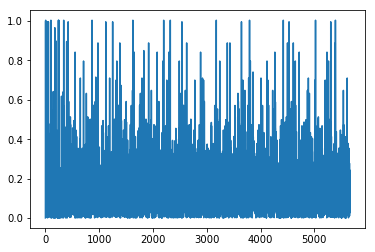

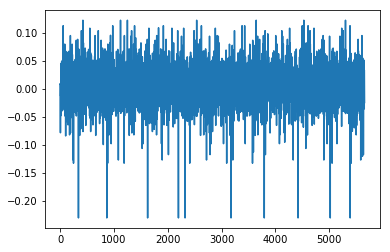

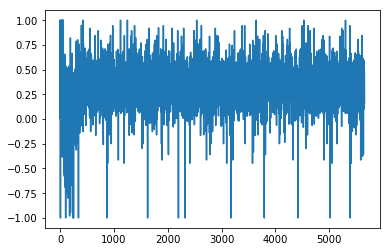

1.35438871661
[ 0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  1.          0.55555556  1.          0.33333333
  0.33333333  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.          0.33333333
  1.          1.          1.          1.          1.          0.33333333
  1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333]
Writing away results
2001-09-01 00:00:00


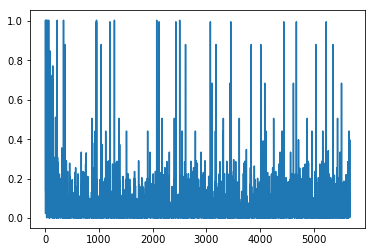

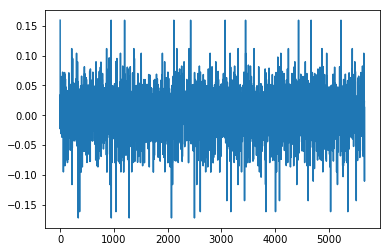

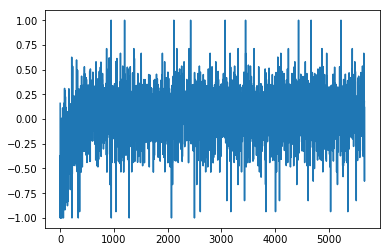

1.1882535994
[ 1.          1.          0.11111111  0.66666667  0.66666667  0.66666667
  0.88888889  1.          1.          1.          1.          1.          1.
  0.22222222  0.66666667  0.33333333  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          1.          1.          0.44444444  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  1.          0.33333333  0.66666667  0.66666667  0.66666667  1.
  0.44444444  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          1.        ]
Writing away results
2001-10-01 00:00:00


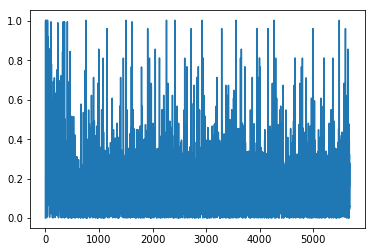

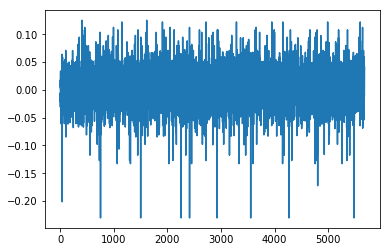

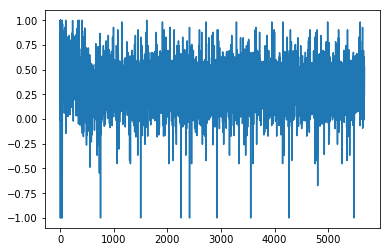

1.45877996181
[ 0.66666667  0.44444444  1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          1.          1.          0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          0.          0.66666667  0.44444444
  1.          1.          1.          1.          0.66666667  1.          1.
  1.          1.          1.          1.          0.66666667  0.66666667
  0.66666667  0.44444444]
Writing away results
2001-11-01 00:00:00


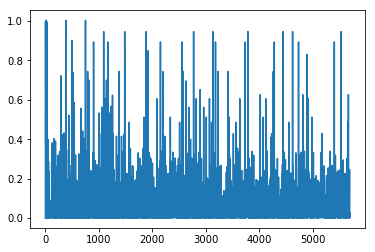

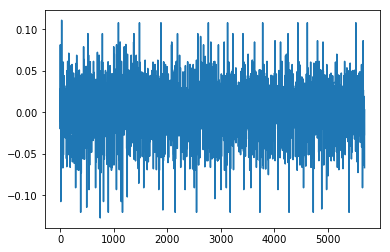

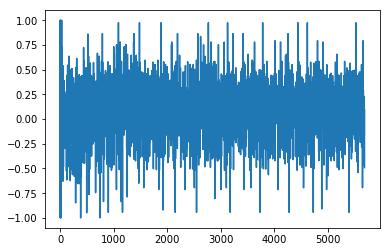

1.02630616648
[ 0.88888889  0.11111111  0.11111111  0.11111111  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.          0.11111111  0.66666667  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.77777778  0.66666667
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.44444444  0.11111111]
Writing away results
2001-12-01 00:00:00


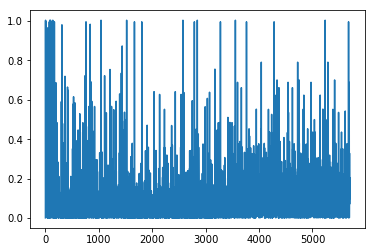

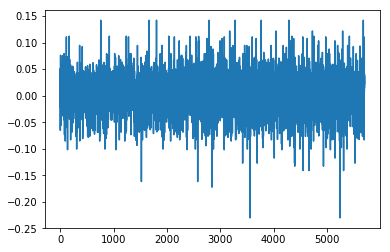

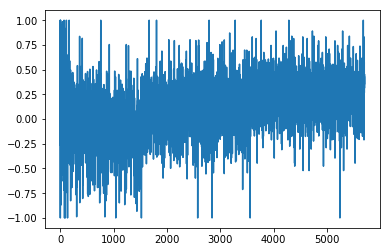

1.45026633744
[ 1.          1.          1.          0.77777778  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.55555556  1.          0.77777778  0.88888889  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  0.88888889  1.          1.          1.          1.          1.
  0.88888889  1.          1.          1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.        ]
Writing away results
2002-01-01 00:00:00


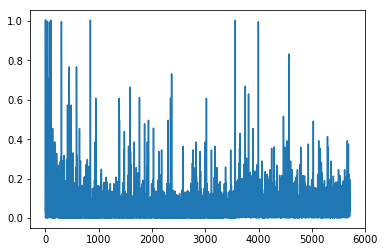

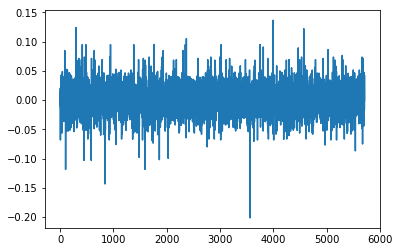

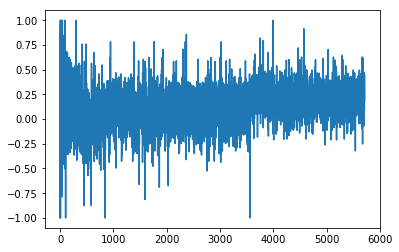

1.21328526541
[ 0.33333333  0.33333333  0.33333333  0.44444444  0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.33333333  0.66666667
  0.33333333  0.77777778  0.44444444  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.44444444  0.55555556  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.44444444  0.44444444  0.33333333  0.66666667
  0.33333333  0.33333333  0.33333333  0.44444444  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444  0.
  0.44444444  0.66666667  0.33333333  0.33333333  0.33333333]
Writing away results
2002-02-01 00:00:00


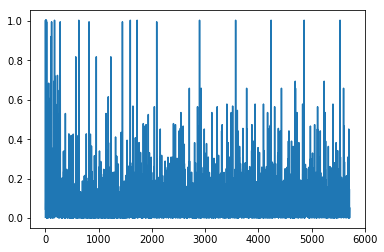

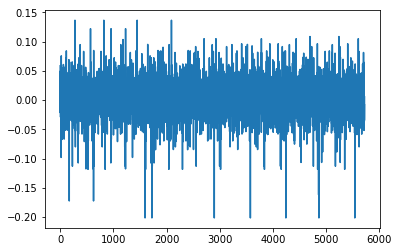

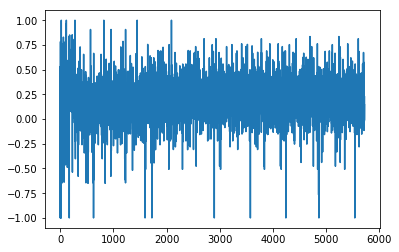

1.51258584298
[ 0.88888889  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  0.66666667  0.88888889
  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.22222222  0.22222222  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.22222222  0.33333333  0.44444444  0.88888889
  0.88888889  0.88888889  0.22222222  0.33333333  0.44444444  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.22222222
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2002-03-01 00:00:00


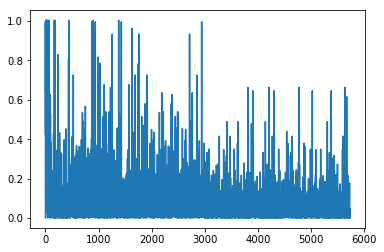

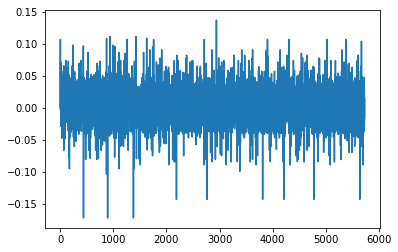

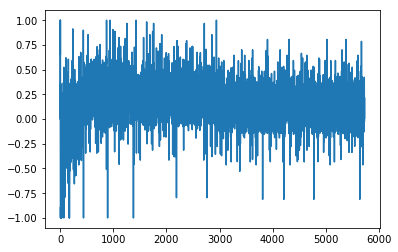

1.3518364459
[ 0.33333333  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.44444444  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2002-04-01 00:00:00


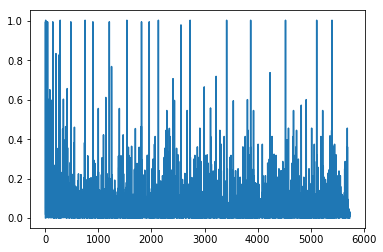

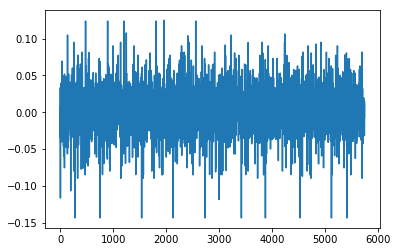

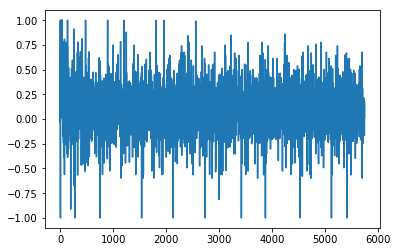

1.27844209055
[ 0.          1.          0.          0.          0.          0.
  0.44444444  0.66666667  0.          0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.          0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.          1.          0.          0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2002-05-01 00:00:00


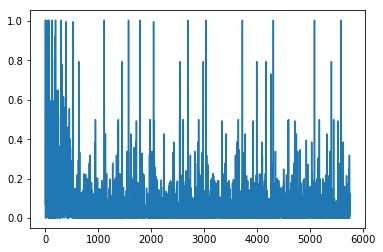

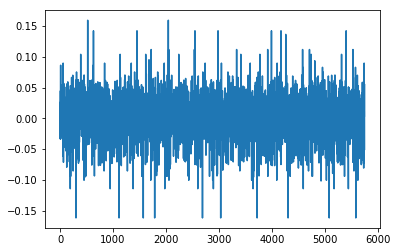

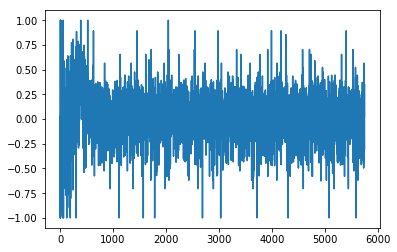

1.22593944355
[ 0.88888889  1.          0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.77777778  0.55555556  1.          0.88888889  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889
  0.88888889  0.66666667  0.44444444  0.55555556  0.55555556  0.
  0.55555556  0.55555556  0.55555556  0.55555556  1.          0.88888889
  0.55555556  0.          0.55555556  0.55555556  0.11111111  1.
  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  0.88888889  1.          0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2002-06-01 00:00:00


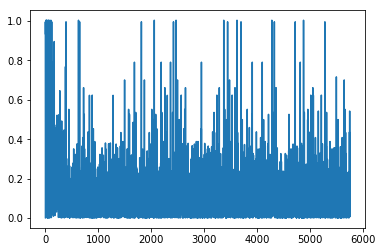

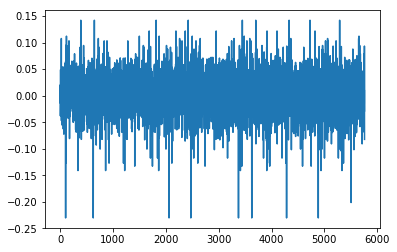

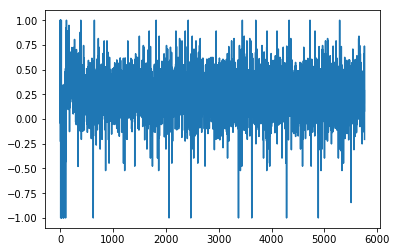

1.6749027593
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  1.
  0.44444444  1.          0.88888889  0.88888889  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.          1.
  0.88888889  0.88888889  1.          1.          1.          1.          1.
  0.88888889  0.66666667  1.          1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.        ]
Writing away results
2002-07-01 00:00:00


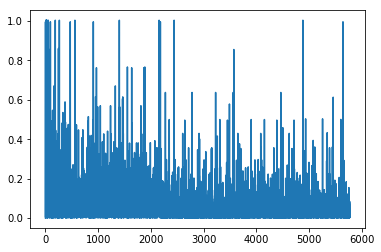

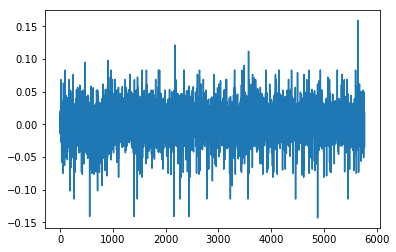

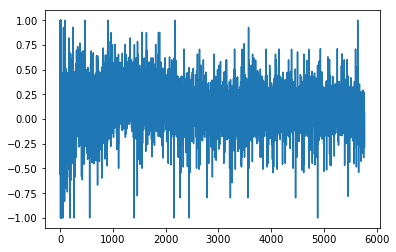

1.41030328327
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222  1.
  0.55555556  0.55555556  0.55555556  0.22222222  0.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2002-08-01 00:00:00


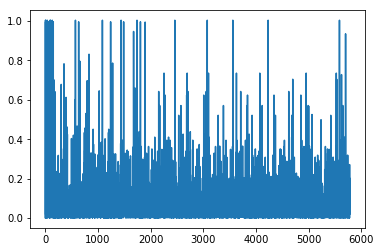

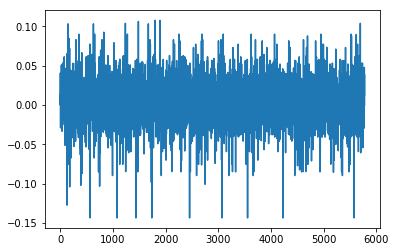

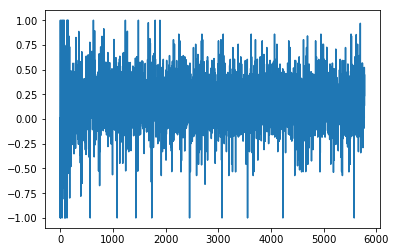

1.3259138059
[ 0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.22222222  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667]
Writing away results
2002-09-01 00:00:00


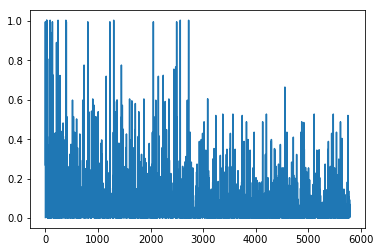

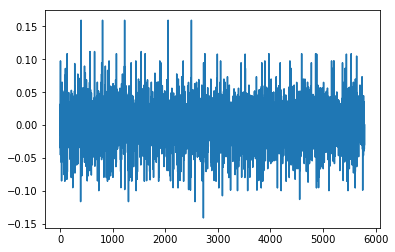

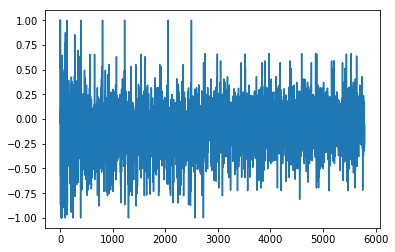

1.50152127141
[ 0.22222222  0.11111111  0.77777778  0.22222222  0.11111111  0.66666667
  0.22222222  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  1.          1.          0.66666667  0.66666667  0.11111111
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.33333333
  0.66666667  0.22222222  0.77777778  0.88888889  0.77777778  0.77777778
  0.11111111  0.66666667  0.          0.66666667  0.77777778  0.77777778
  0.77777778  0.44444444  0.66666667  0.66666667  0.66666667  0.22222222
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.11111111  0.77777778  0.77777778  0.44444444  0.11111111]
Writing away results
2002-10-01 00:00:00


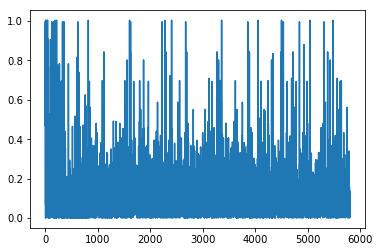

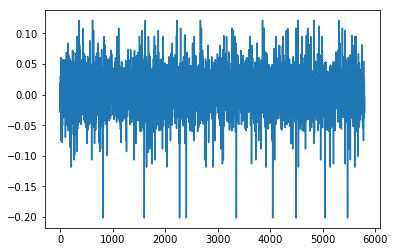

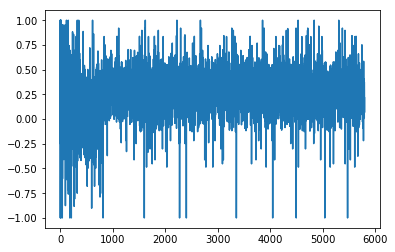

1.43776684597
[ 0.          0.88888889  0.88888889  0.88888889  0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.        ]
Writing away results
2002-11-01 00:00:00


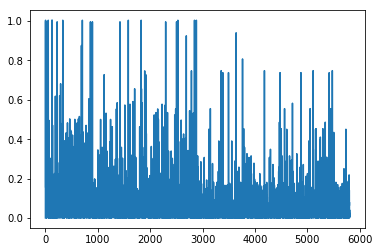

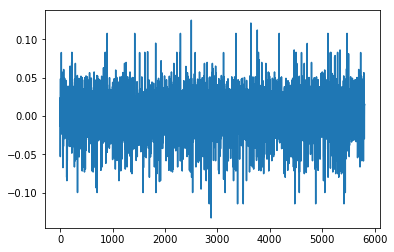

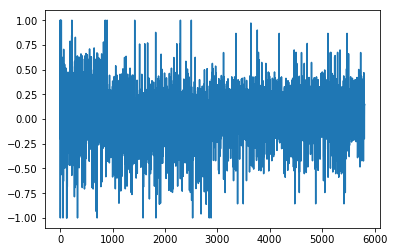

1.39415492305
[ 0.55555556  0.11111111  0.55555556  0.          0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.66666667  0.66666667  0.22222222  0.77777778  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.22222222
  0.44444444  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.66666667  0.66666667  0.33333333  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.77777778  0.55555556
  0.55555556  0.55555556  0.11111111  0.44444444  0.55555556]
Writing away results
2002-12-01 00:00:00


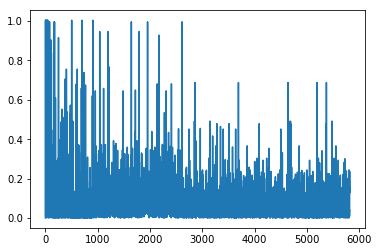

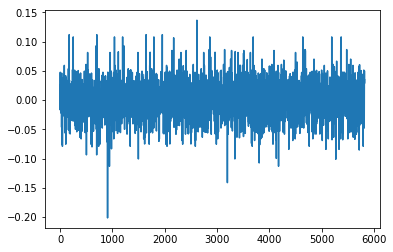

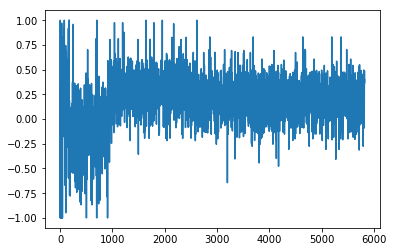

1.17234263331
[ 0.22222222  0.11111111  0.33333333  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.55555556  0.66666667  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333  0.
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111]
Writing away results
2003-01-01 00:00:00


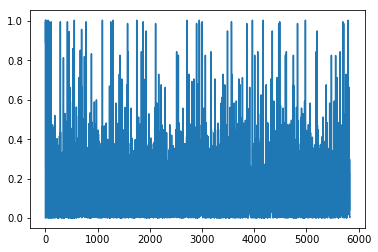

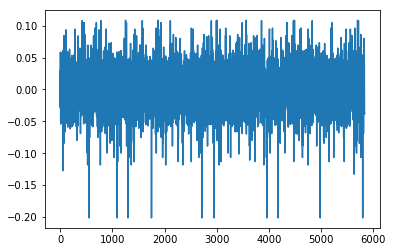

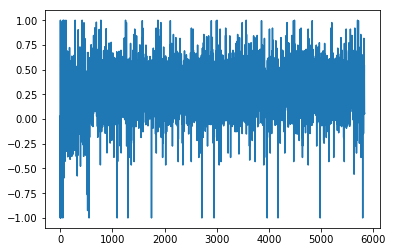

1.66598687295
[ 0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889]
Writing away results
2003-02-01 00:00:00


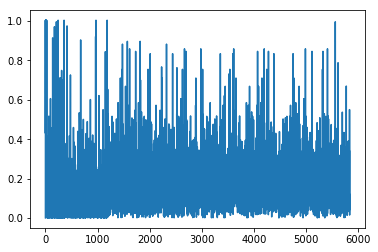

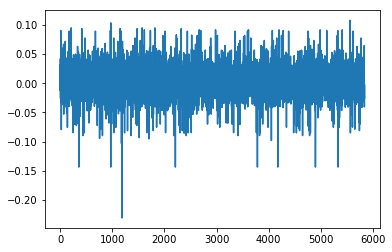

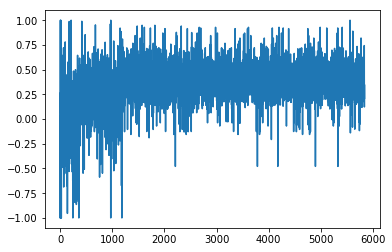

1.41966667543
[ 0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2003-03-01 00:00:00


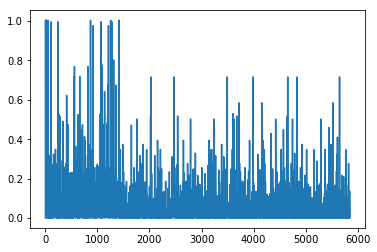

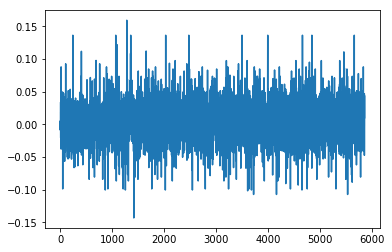

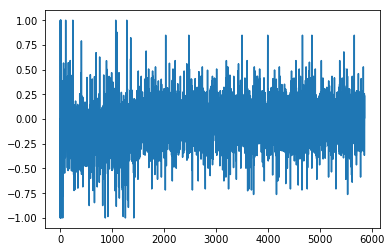

1.49870922286
[ 0.66666667  0.66666667  1.          0.77777778  0.77777778  0.77777778
  0.55555556  0.77777778  0.77777778  1.          0.77777778  0.77777778
  0.77777778  0.33333333  0.44444444  0.88888889  0.22222222  0.44444444
  0.77777778  0.66666667  1.          0.77777778  1.          0.77777778
  0.33333333  0.88888889  0.44444444  0.66666667  1.          0.77777778
  0.55555556  0.33333333  0.55555556  0.77777778  1.          0.77777778
  1.          0.77777778  0.44444444  0.44444444  0.44444444  0.66666667
  0.77777778  1.          0.77777778  0.77777778  0.77777778  1.
  0.44444444  0.77777778  1.          0.11111111  0.55555556  0.44444444
  0.66666667  0.66666667  1.          1.          0.33333333]
Writing away results
2003-04-01 00:00:00


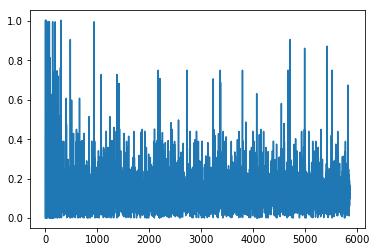

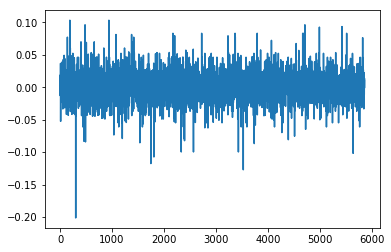

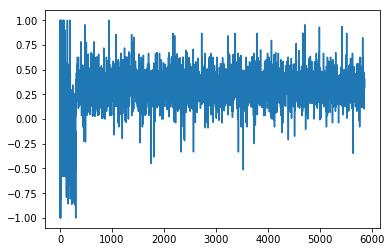

1.08061824995
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.          0.          0.          0.88888889  0.22222222  0.55555556
  0.          0.          0.          0.          0.22222222  0.22222222
  0.          0.          0.          0.          0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.88888889  0.          0.          0.          0.          0.22222222
  0.22222222]
Writing away results
2003-05-01 00:00:00


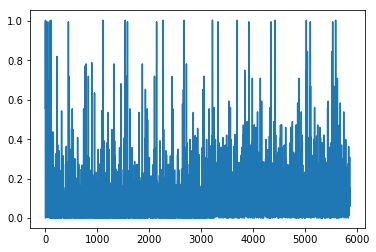

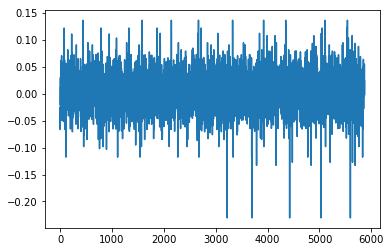

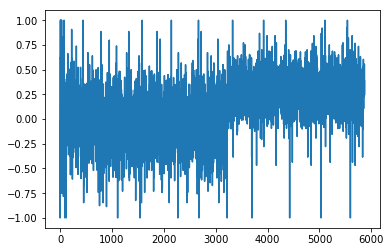

1.44294989091
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.55555556  0.55555556
  0.55555556  0.55555556  1.          1.          1.          1.          1.
  1.          1.          0.66666667  0.55555556  0.          1.          1.
  1.          1.          0.55555556  1.          0.66666667  1.          1.
  1.          1.          0.55555556  0.55555556  0.55555556  0.55555556
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  1.          1.
  1.          1.          0.55555556  0.55555556  0.55555556]
Writing away results
2003-06-01 00:00:00


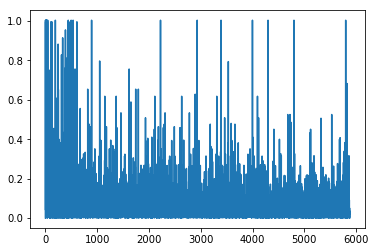

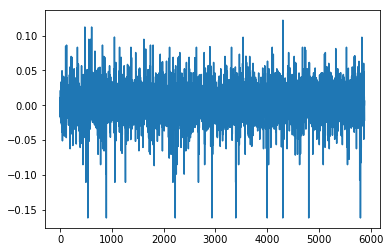

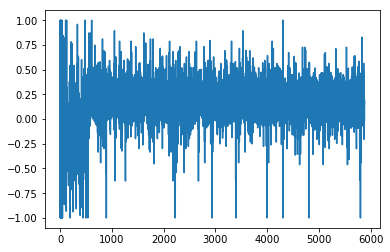

1.19402054325
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.22222222  0.77777778
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222
  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2003-07-01 00:00:00


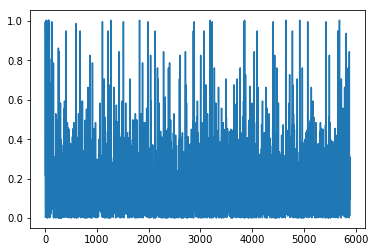

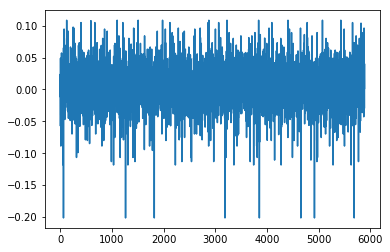

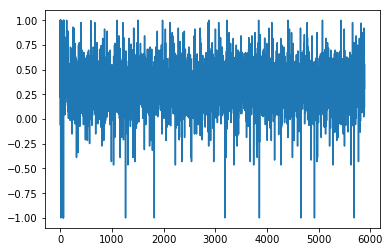

1.27174192293
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889]
Writing away results
2003-08-01 00:00:00


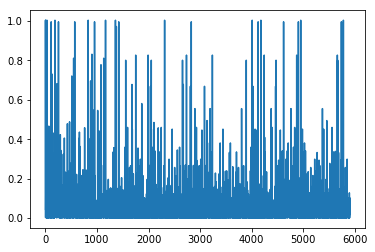

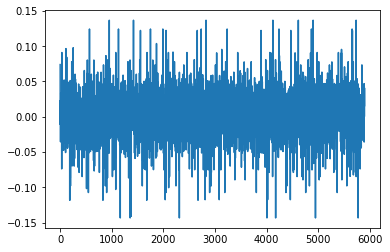

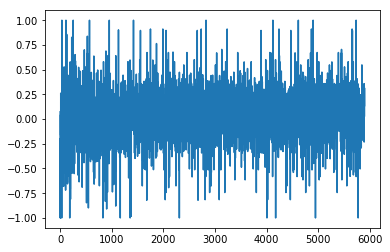

1.13325660944
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.55555556  0.          0.33333333  0.66666667
  0.66666667  0.66666667  0.55555556  0.          0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.33333333  0.33333333  1.        ]
Writing away results
2003-09-01 00:00:00


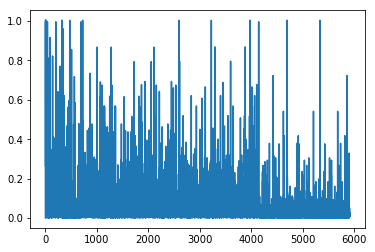

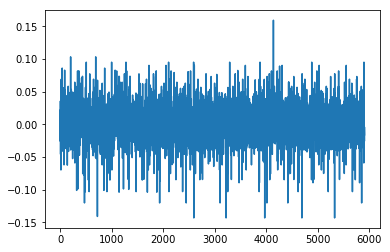

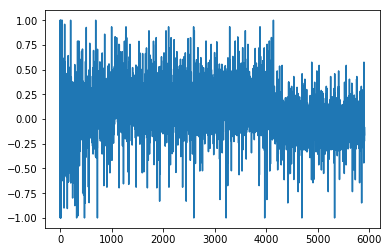

1.16038285568
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.          0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.44444444  0.          0.        ]
Writing away results
2003-10-01 00:00:00


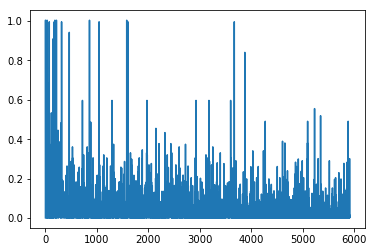

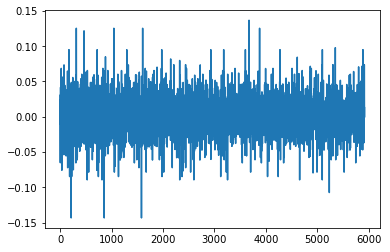

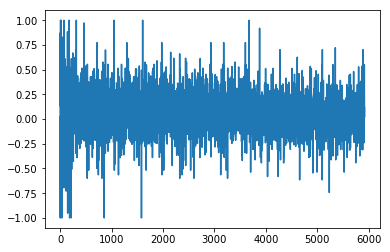

1.03861824676
[ 0.          0.          0.          0.          0.          0.
  0.66666667  0.77777778  0.33333333  0.55555556  0.22222222  0.
  0.11111111  0.          0.          0.          0.          0.66666667
  0.44444444  0.44444444  0.11111111  0.          0.          0.
  0.66666667  0.          0.          0.          0.          0.          0.
  0.55555556  0.44444444  0.44444444  0.33333333  0.          0.          0.
  0.          0.          0.          0.22222222  0.          0.          0.
  0.          0.44444444  0.11111111  0.          0.          0.
  0.77777778  0.44444444  0.44444444  0.33333333  0.33333333  0.88888889
  0.44444444  0.44444444]
Writing away results
2003-11-01 00:00:00


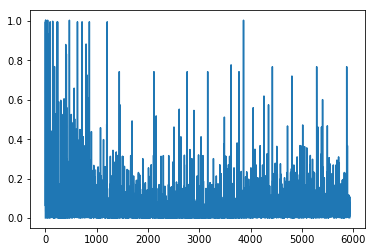

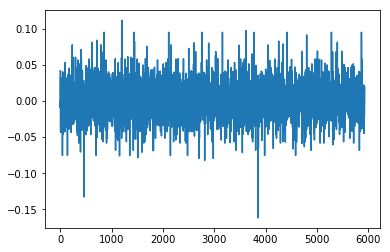

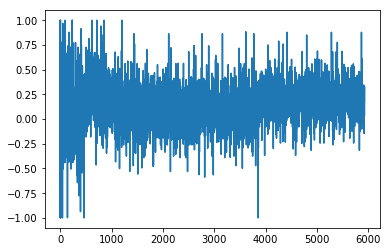

1.0771753747
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.
  0.          0.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.55555556  0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.22222222
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.
  0.          0.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.22222222  0.33333333  0.33333333  0.33333333
  0.33333333  0.55555556  0.33333333  0.33333333  0.33333333  0.33333333
  0.55555556  0.          0.          0.          0.33333333  0.          0.
  0.          0.        ]
Writing away results
2003-12-01 00:00:00


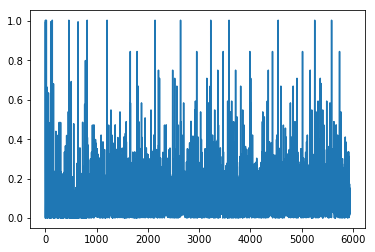

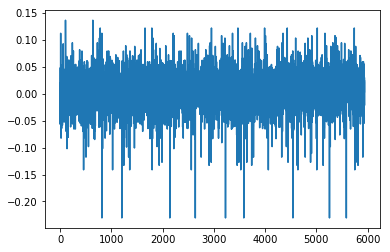

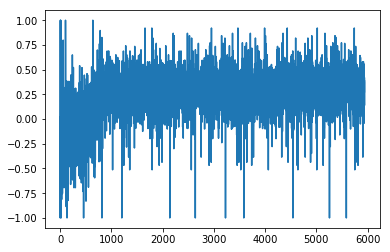

1.08550827407
[ 1.          1.          1.          1.          0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  1.          1.          1.          1.
  1.          1.          0.55555556  0.11111111  0.          1.          1.
  1.          1.          0.11111111  0.11111111  1.          1.          1.
  1.          1.          0.11111111  0.11111111  0.11111111  0.11111111
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.11111111  1.          1.
  1.          1.          0.11111111  0.11111111  0.11111111  0.11111111
  1.          0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
2004-01-01 00:00:00


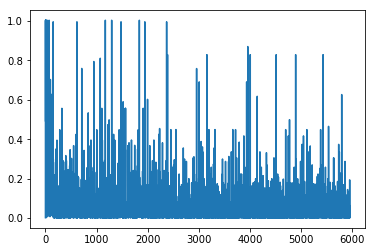

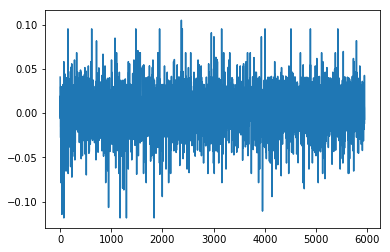

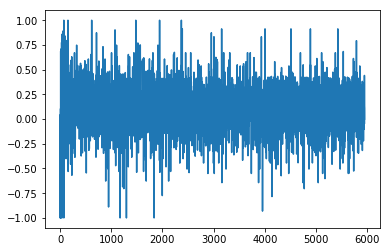

1.18186364711
[ 0.33333333  0.33333333  0.33333333  0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.          0.          0.77777778  0.33333333  0.33333333
  0.33333333  0.33333333  0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.          0.
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.
  0.          0.77777778  0.55555556  0.          0.          0.          0.
  0.          0.        ]
Writing away results
2004-02-01 00:00:00


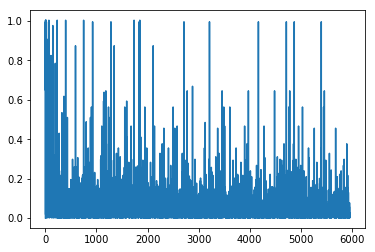

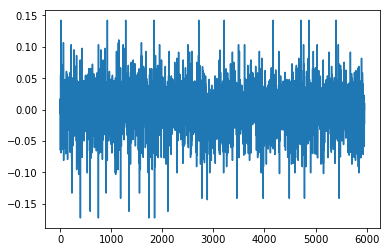

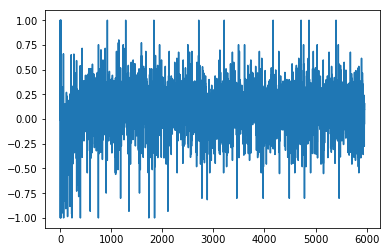

0.728989301336
[ 0.11111111  0.11111111  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.88888889  0.55555556  0.33333333  0.11111111
  0.11111111  0.11111111  0.88888889  0.55555556  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  1.          0.44444444  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2004-03-01 00:00:00


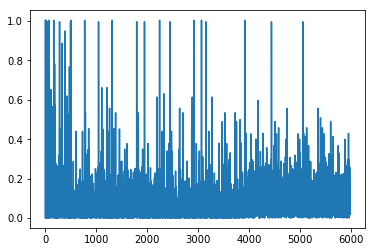

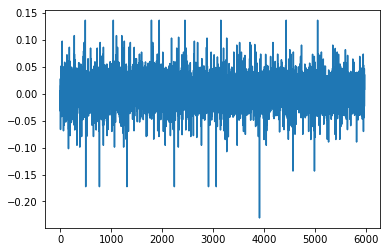

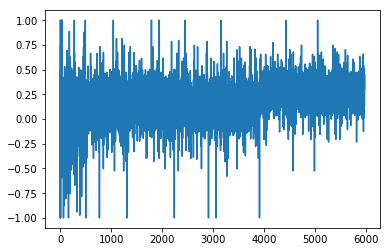

0.952612352819
[ 0.66666667  0.33333333  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2004-04-01 00:00:00


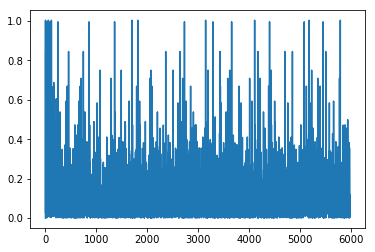

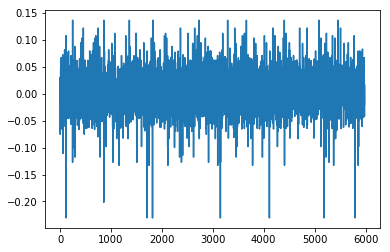

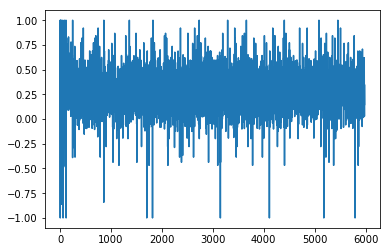

1.03470048531
[ 0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          0.33333333  0.33333333
  1.          1.          1.          1.          1.          0.33333333
  1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.33333333  1.          1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  1.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333]
Writing away results
2004-05-01 00:00:00


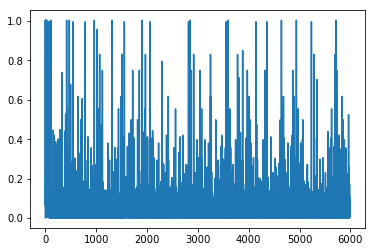

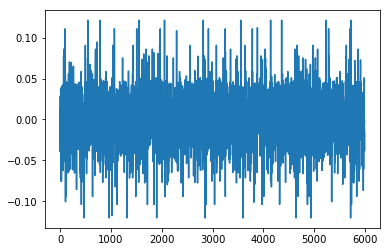

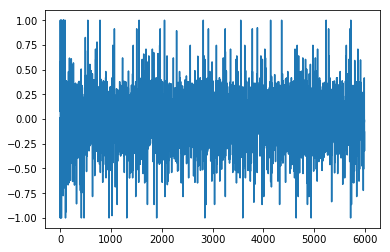

1.00352787402
[ 0.55555556  0.55555556  0.88888889  0.33333333  0.77777778  0.33333333
  0.33333333  0.33333333  0.          0.          0.55555556  0.88888889
  0.33333333  0.77777778  0.33333333  0.          0.          0.55555556
  0.44444444  0.77777778  0.33333333  0.          0.33333333  0.77777778
  0.88888889  0.55555556  0.55555556  0.11111111  0.          0.          0.
  0.          0.          0.          0.          0.33333333  0.33333333
  0.66666667  1.          0.33333333  0.33333333  0.33333333  0.          0.
  0.55555556  0.22222222  0.55555556  0.22222222  0.22222222  0.88888889
  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556
  0.22222222  0.11111111  0.55555556]
Writing away results
2004-06-01 00:00:00


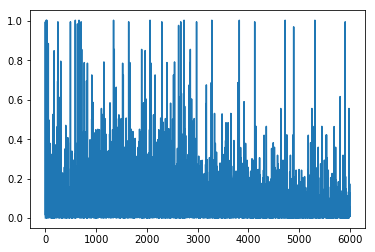

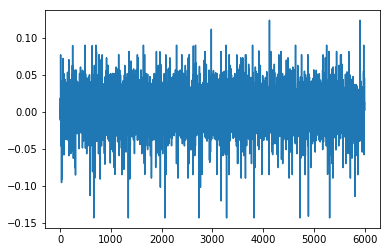

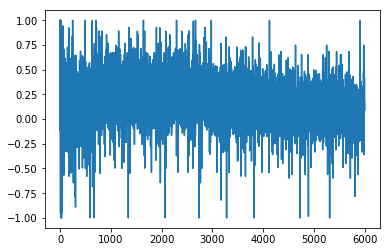

1.01695637552
[ 0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111]
Writing away results
2004-07-01 00:00:00


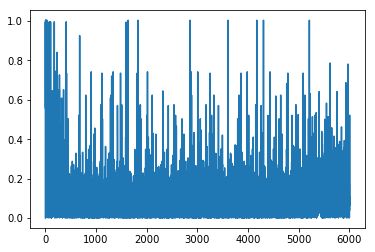

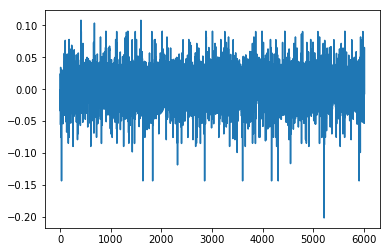

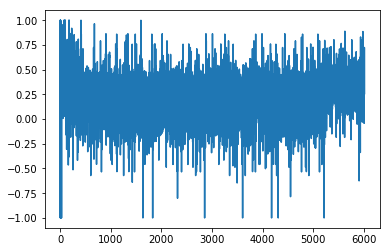

0.987391822542
[ 0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667]
Writing away results
2004-08-01 00:00:00


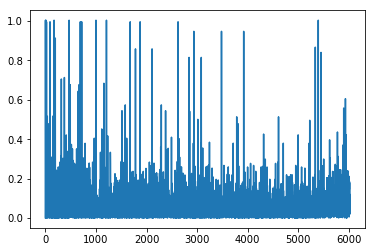

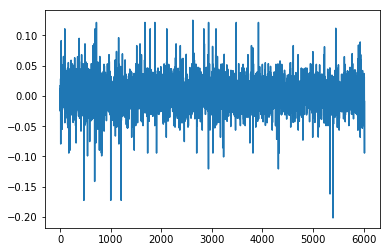

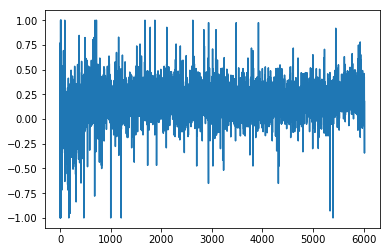

1.10105288136
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  0.22222222  0.22222222  0.33333333  0.33333333
  0.33333333  0.33333333  0.22222222  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222
  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.77777778  0.33333333  0.33333333  0.33333333  1.
  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.33333333  0.33333333]
Writing away results
2004-09-01 00:00:00


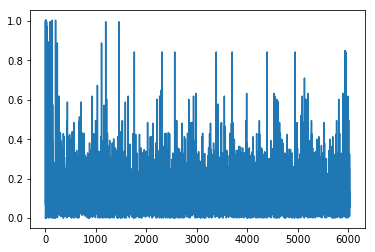

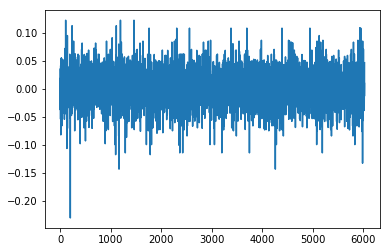

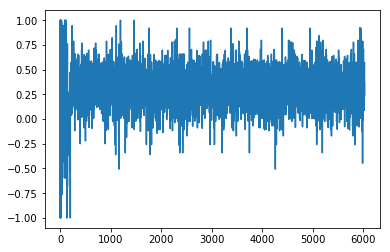

1.04745479829
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.55555556  1.          0.55555556  0.55555556
  0.55555556  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556]
Writing away results
2004-10-01 00:00:00


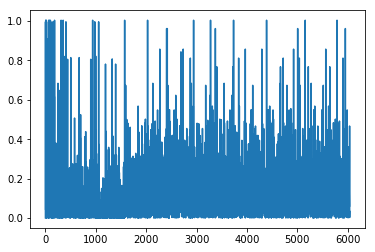

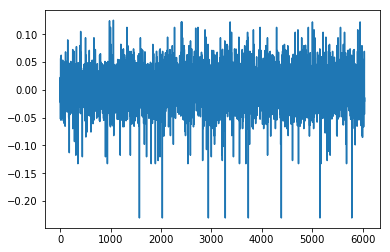

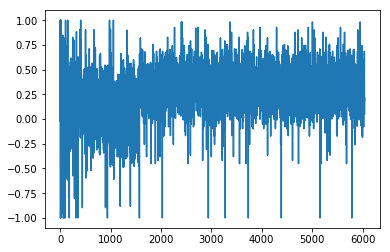

1.17912293524
[ 1.          1.          1.          1.          1.          0.77777778
  0.44444444  1.          1.          1.          1.          1.
  0.44444444  1.          1.          1.          1.          1.          1.
  0.44444444  0.44444444  0.44444444  0.44444444  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.11111111  1.          1.          1.          1.
  0.44444444  0.44444444  0.44444444  0.44444444  1.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  1.          1.          1.
  1.        ]
Writing away results
2004-11-01 00:00:00


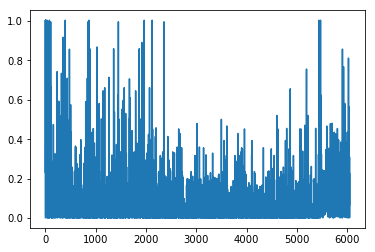

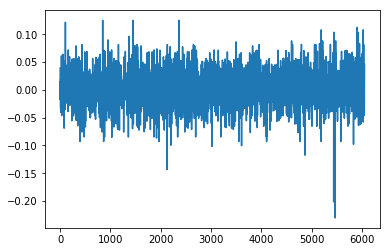

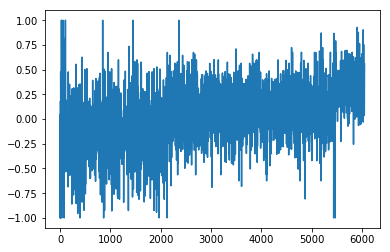

1.11510795467
[ 1.          1.          1.          1.          0.          0.22222222
  0.88888889  0.          1.          1.          1.          0.66666667
  0.22222222  0.          1.          1.          1.          1.
  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.          1.
  1.          1.          1.          0.55555556  1.          0.          1.
  1.          1.          0.11111111  1.          1.          1.
  0.66666667  0.22222222  0.22222222  0.22222222  0.          0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.          1.          1.          1.
  1.          1.        ]
Writing away results
2004-12-01 00:00:00


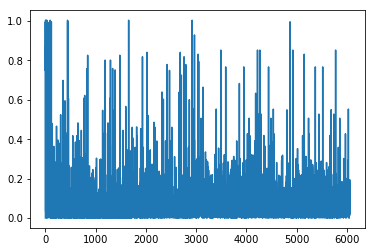

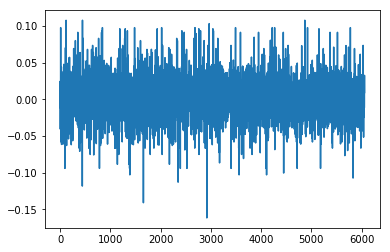

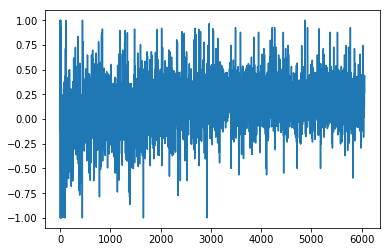

1.07128574031
[ 0.          0.          0.          0.44444444  0.44444444  0.44444444
  0.          0.          0.          0.          0.44444444  0.55555556
  0.          0.          0.          0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.          0.          0.
  0.          0.          0.88888889  0.          0.          0.          0.
  0.44444444  0.11111111  0.          0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.          0.          0.
  0.          0.        ]
Writing away results
2005-01-01 00:00:00


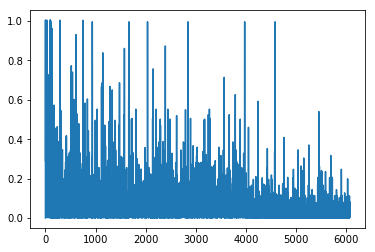

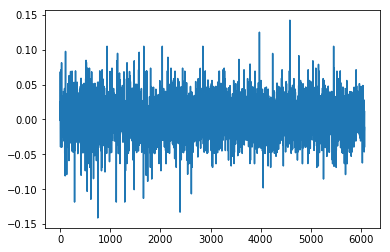

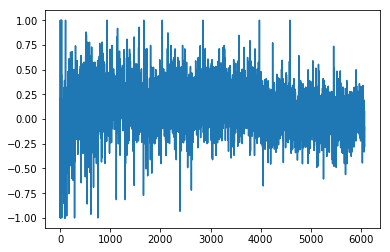

1.06203713249
[ 0.11111111  0.11111111  0.44444444  0.44444444  0.11111111  0.88888889
  0.11111111  0.11111111  0.11111111  0.44444444  0.11111111  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
2005-02-01 00:00:00


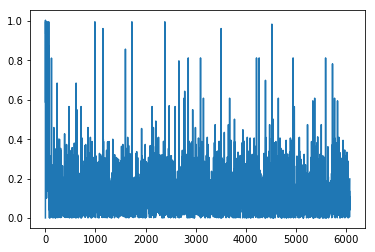

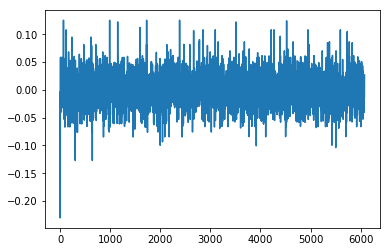

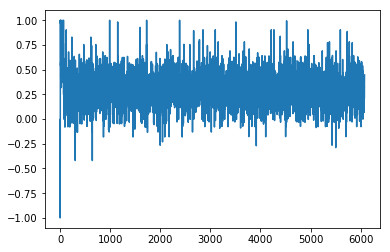

0.97080477108
[ 0.22222222  1.          0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2005-03-01 00:00:00


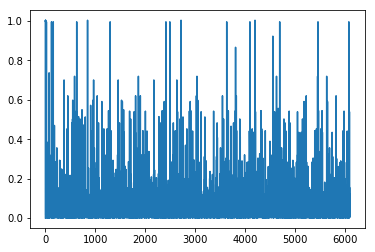

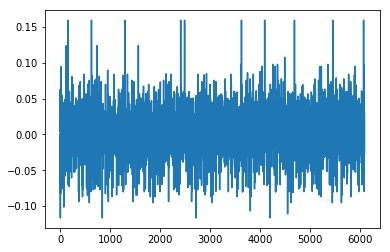

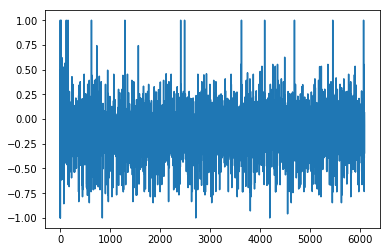

0.925018484997
[ 0.          0.66666667  0.22222222  0.88888889  0.77777778  0.88888889
  0.33333333  0.22222222  0.55555556  0.          0.11111111  0.44444444
  0.33333333  0.          0.66666667  0.22222222  1.          0.77777778
  0.44444444  0.55555556  0.44444444  0.44444444  0.88888889  0.55555556
  0.22222222  0.          0.55555556  0.33333333  0.22222222  0.22222222
  0.44444444  0.77777778  0.33333333  0.11111111  0.          0.77777778
  1.          0.77777778  1.          0.66666667  0.22222222  0.          1.
  1.          0.22222222  1.          1.          1.          0.22222222
  0.          0.77777778  0.33333333  0.33333333  0.88888889  0.11111111
  0.44444444  0.33333333  0.          0.77777778]
Writing away results
2005-04-01 00:00:00


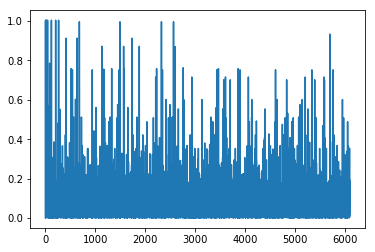

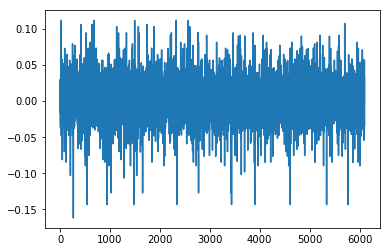

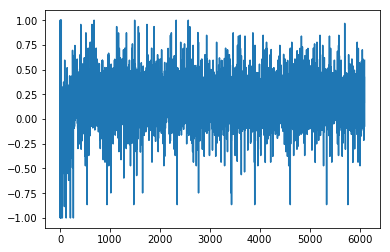

1.25346033912
[ 0.44444444  0.66666667  1.          0.66666667  0.66666667  0.66666667
  0.44444444  0.66666667  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2005-05-01 00:00:00


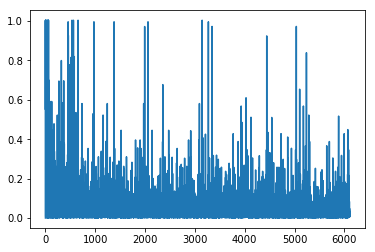

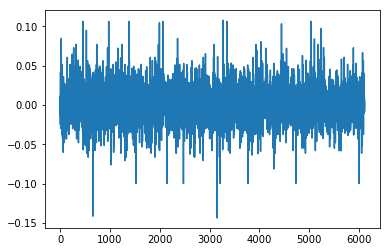

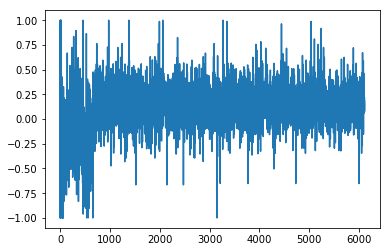

1.03647755564
[ 0.33333333  0.          0.          0.          0.          0.33333333
  0.88888889  0.          0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.          0.
  0.          0.          0.          0.22222222  0.          0.          0.
  0.11111111  0.33333333  0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.        ]
Writing away results
2005-06-01 00:00:00


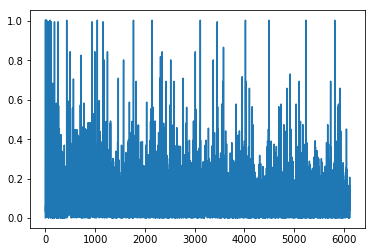

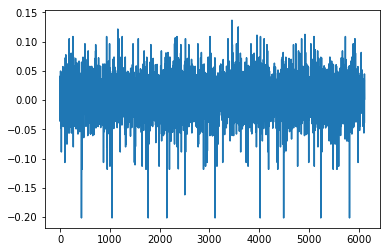

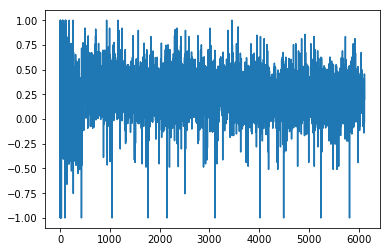

1.19591164428
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2005-07-01 00:00:00


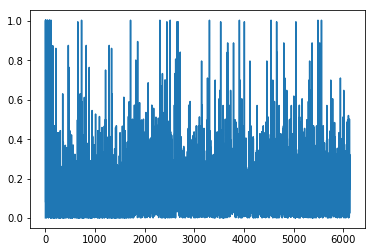

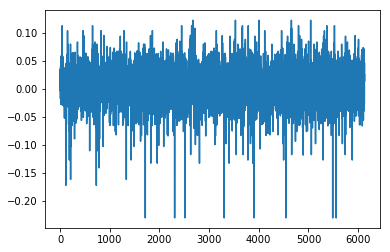

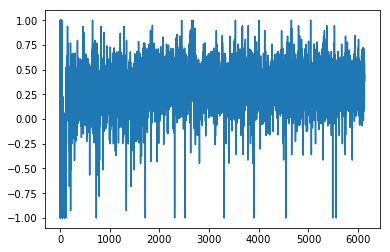

1.18204041421
[ 1.          1.          1.          0.22222222  1.          1.          1.
  1.          1.          1.          0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.22222222  0.55555556
  1.          1.          1.          1.          0.22222222  0.22222222
  0.22222222  0.22222222  1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.        ]
Writing away results
2005-08-01 00:00:00


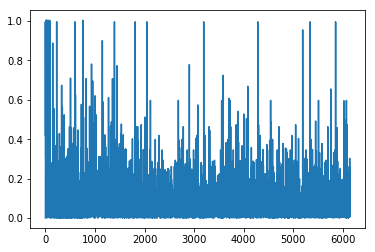

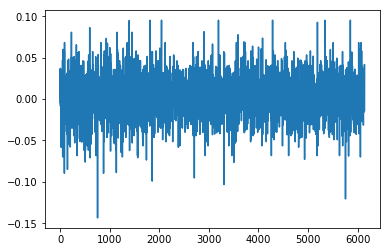

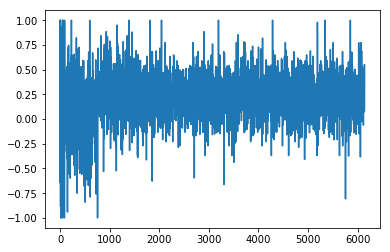

1.23097310557
[ 0.33333333  0.33333333  0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.          0.
  0.          0.33333333  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.        ]
Writing away results
2005-09-01 00:00:00


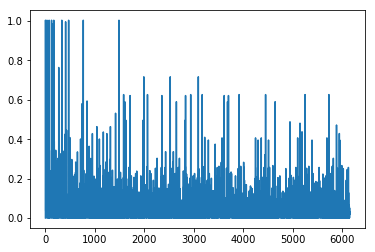

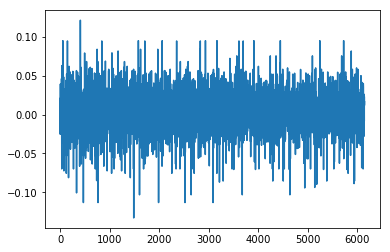

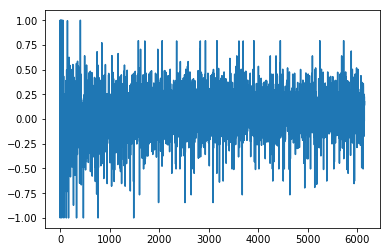

1.33673504978
[ 0.44444444  0.22222222  0.66666667  0.88888889  0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.          0.          0.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.          0.
  0.          1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.66666667  1.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.22222222  0.77777778]
Writing away results
2005-10-01 00:00:00


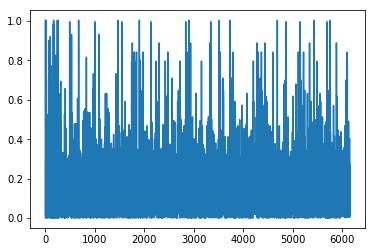

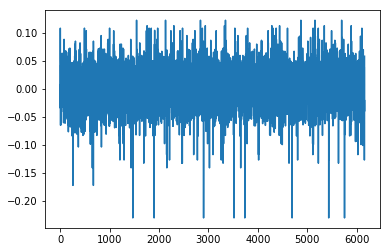

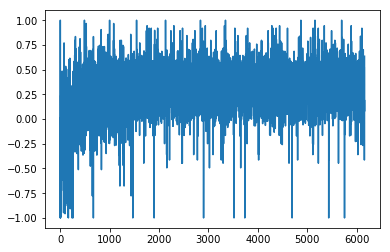

1.13755815977
[ 0.66666667  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.66666667  0.66666667]
Writing away results
2005-11-01 00:00:00


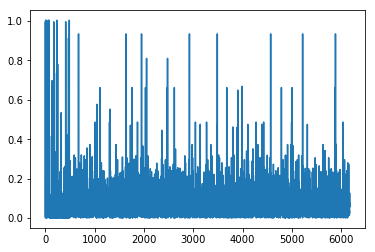

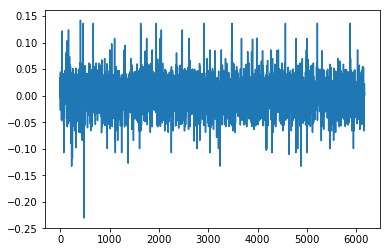

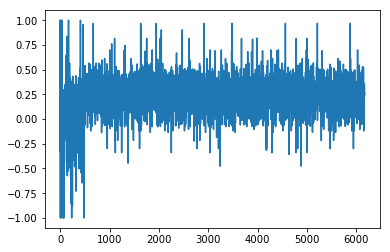

1.11971043434
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.77777778  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.11111111  0.66666667  0.11111111]
Writing away results
2005-12-01 00:00:00


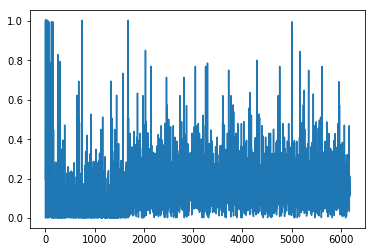

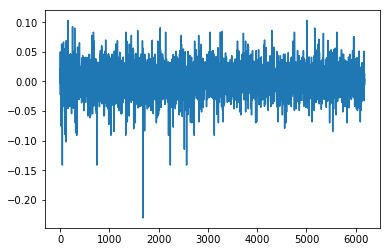

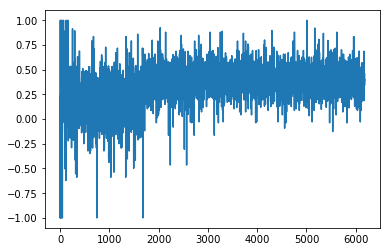

1.17684053325
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.55555556  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222  0.33333333
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.22222222  0.88888889  0.22222222  0.33333333  0.33333333]
Writing away results
2006-01-01 00:00:00


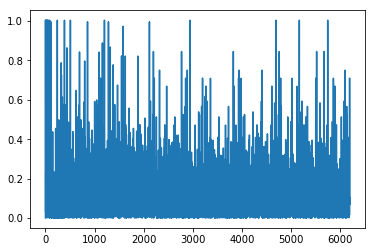

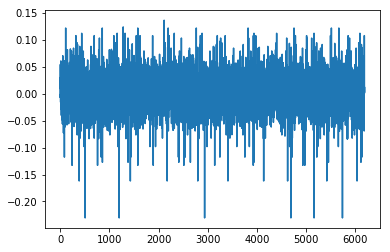

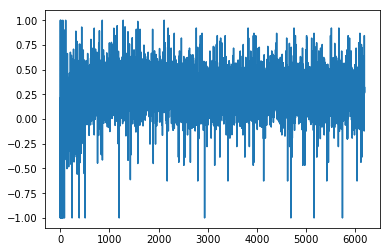

1.23608978667
[ 1.          1.          1.          1.          0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  1.          0.66666667  1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.66666667  0.11111111  0.66666667  1.          1.
  1.        ]
Writing away results
2006-02-01 00:00:00


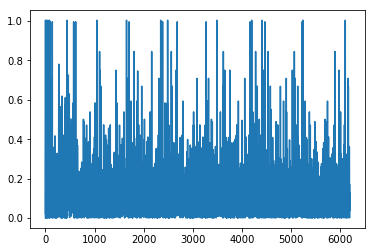

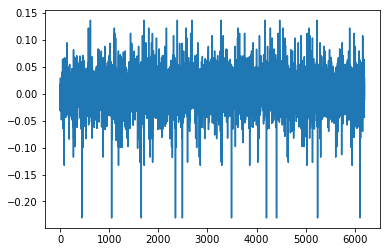

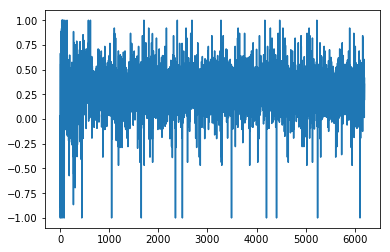

1.27826369186
[ 1.          1.          1.          0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222
  1.          1.          1.          1.          0.22222222  0.22222222
  0.22222222  0.22222222  1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.          0.22222222  1.          1.          1.
  1.        ]
Writing away results
2006-03-01 00:00:00


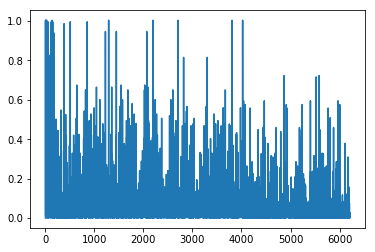

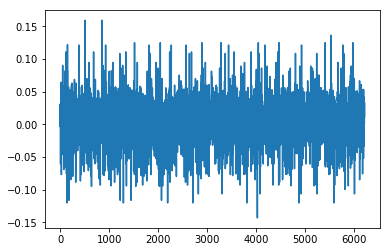

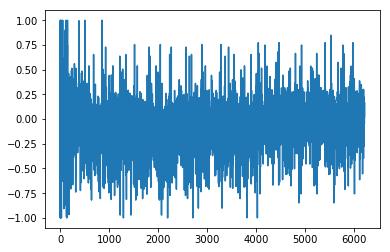

1.05104135999
[ 0.88888889  0.          0.11111111  0.44444444  0.77777778  0.88888889
  0.55555556  0.55555556  0.55555556  0.33333333  0.33333333  0.11111111
  0.44444444  0.22222222  0.55555556  0.11111111  0.33333333  0.77777778
  0.66666667  0.55555556  0.88888889  0.44444444  0.77777778  0.77777778
  0.77777778  0.66666667  0.11111111  0.11111111  0.44444444  0.77777778
  0.88888889  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.44444444  0.22222222  0.88888889  0.11111111  0.          0.22222222
  0.88888889  0.33333333  0.          0.22222222  0.88888889  0.66666667
  0.22222222  0.88888889  0.11111111  0.44444444  0.77777778  0.88888889
  0.66666667  0.22222222  0.88888889  0.          0.22222222]
Writing away results
2006-04-01 00:00:00


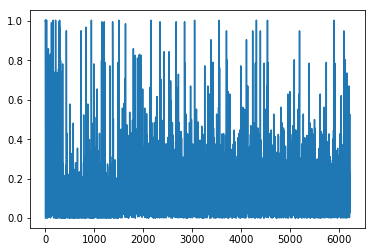

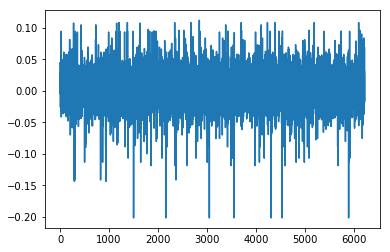

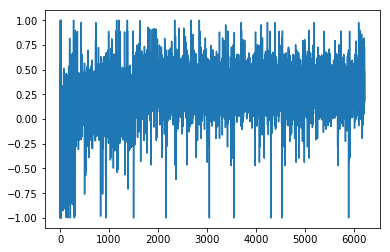

1.45887478607
[ 0.88888889  0.          0.          0.          0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  1.          0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.          0.          0.
  0.88888889  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.33333333  0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889]
Writing away results
2006-05-01 00:00:00


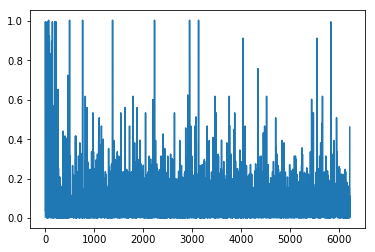

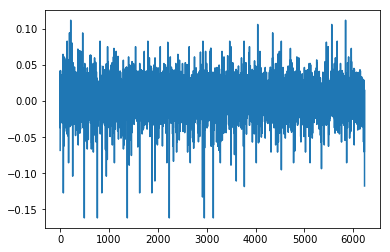

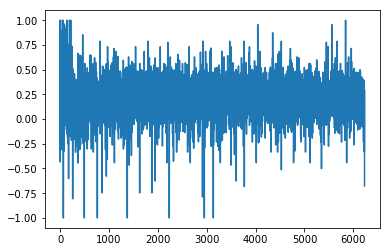

1.30593132308
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.22222222  0.44444444  0.44444444
  0.44444444  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222
  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.22222222  0.66666667  0.22222222  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2006-06-01 00:00:00


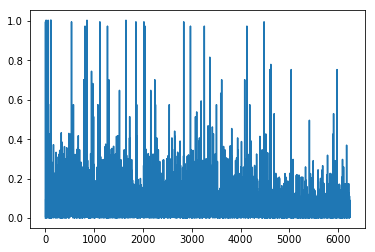

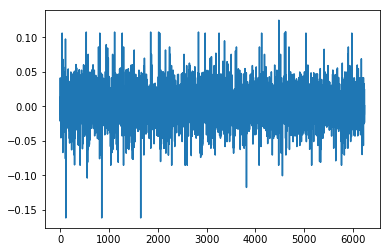

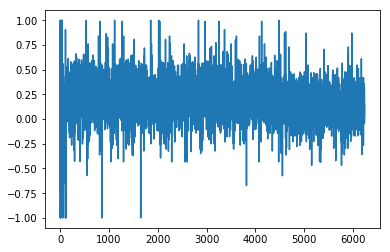

1.35915731841
[ 0.66666667  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111  1.
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.11111111  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.44444444  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2006-07-01 00:00:00


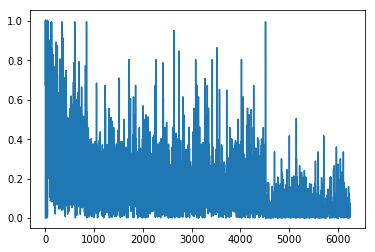

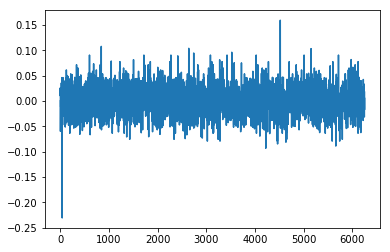

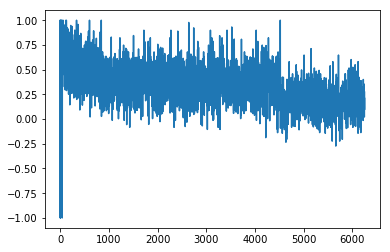

1.16412298429
[ 0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.11111111  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
2006-08-01 00:00:00


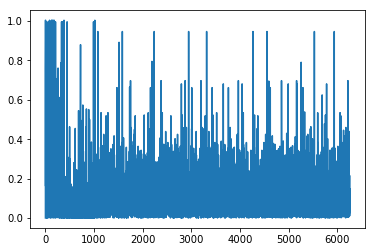

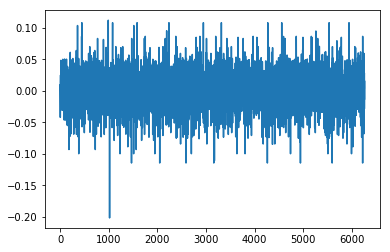

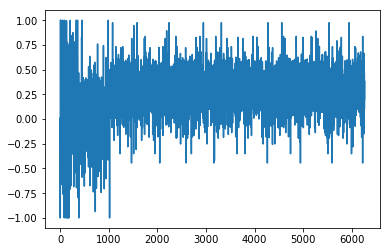

1.1892858493
[ 0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2006-09-01 00:00:00


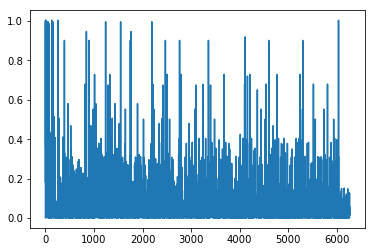

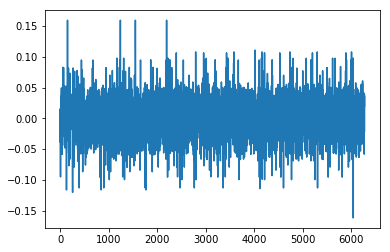

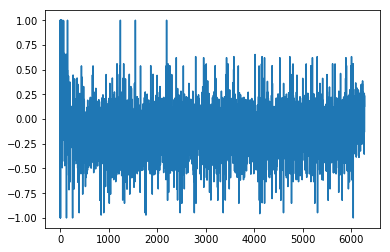

1.0403838977
[ 0.55555556  0.55555556  0.77777778  0.77777778  0.77777778  0.11111111
  0.33333333  0.44444444  0.77777778  0.77777778  0.33333333  0.88888889
  0.55555556  0.55555556  0.77777778  0.          0.88888889  0.
  0.66666667  1.          1.          0.77777778  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  1.          0.77777778  0.77777778  0.44444444  0.77777778
  0.77777778  0.11111111  0.          0.44444444  0.77777778  0.
  0.44444444  0.77777778  0.77777778  0.33333333  0.66666667  0.77777778
  0.55555556  0.88888889  0.77777778  0.44444444  0.77777778  0.77777778
  0.44444444  0.          0.88888889  0.77777778  0.88888889]
Writing away results
2006-10-01 00:00:00


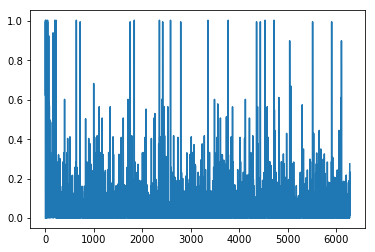

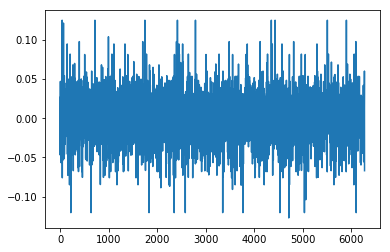

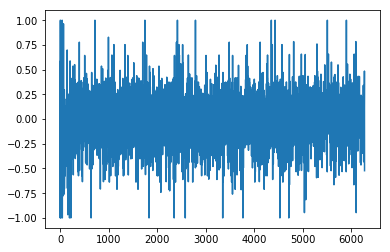

0.976638321037
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.11111111  0.33333333  0.22222222  0.55555556  0.
  0.11111111  0.11111111  0.11111111  0.77777778  0.77777778  0.55555556
  0.          0.33333333  0.77777778  0.77777778  0.55555556  0.77777778
  0.77777778  0.55555556  0.55555556  0.55555556  0.77777778  0.
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111
  0.11111111  0.22222222  0.77777778  0.          0.77777778  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222
  0.11111111  0.22222222  0.22222222  0.11111111  0.77777778]
Writing away results
2006-11-01 00:00:00


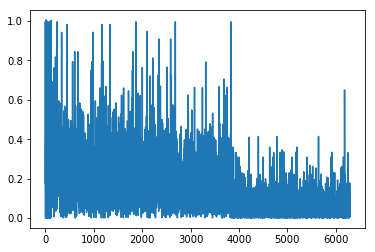

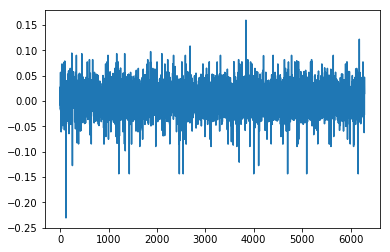

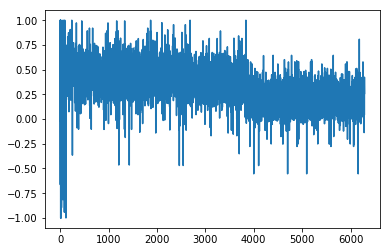

1.17556069642
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.22222222  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.66666667  0.33333333  0.33333333]
Writing away results
2006-12-01 00:00:00


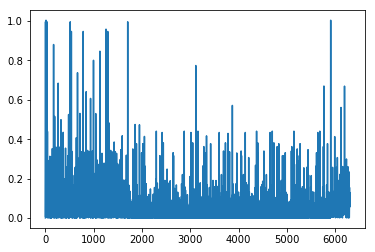

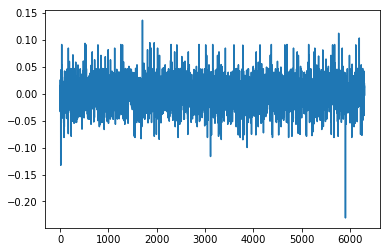

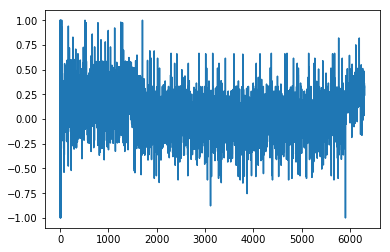

1.11214657664
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.44444444
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.11111111  0.55555556  0.55555556
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.55555556  0.55555556
  0.55555556]
Writing away results
2007-01-01 00:00:00


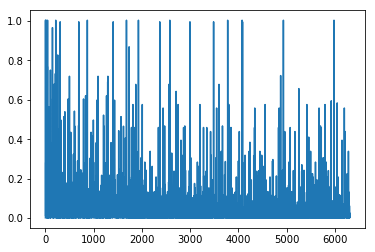

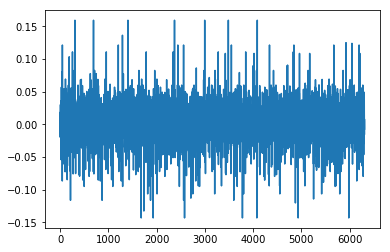

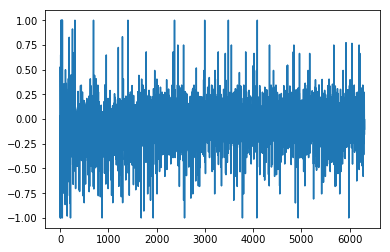

1.22226686808
[ 0.44444444  0.44444444  0.77777778  0.33333333  0.33333333  0.22222222
  0.44444444  0.44444444  0.11111111  0.11111111  0.44444444  0.44444444
  0.44444444  0.77777778  0.55555556  0.55555556  0.55555556  0.66666667
  0.77777778  0.77777778  0.55555556  0.66666667  0.77777778  0.77777778
  0.55555556  0.55555556  0.77777778  0.33333333  0.33333333  0.44444444
  0.22222222  0.11111111  0.44444444  0.44444444  0.44444444  0.11111111
  0.88888889  0.44444444  0.33333333  0.11111111  0.44444444  0.44444444
  0.77777778  0.55555556  0.88888889  0.11111111  0.88888889  0.22222222
  0.11111111  0.22222222  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.77777778  0.11111111]
Writing away results
2007-02-01 00:00:00


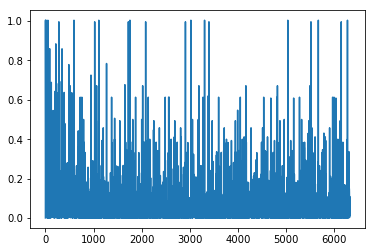

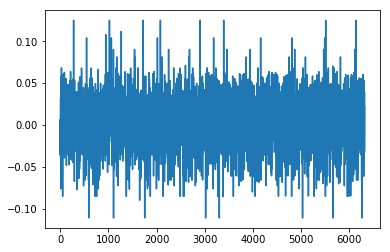

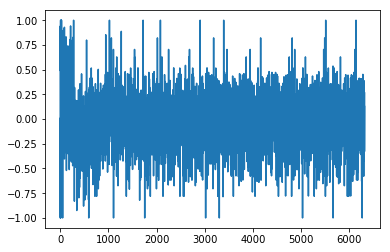

1.19044213378
[ 0.33333333  0.88888889  0.66666667  0.66666667  0.33333333  0.33333333
  0.88888889  0.66666667  0.66666667  0.33333333  0.55555556  0.
  0.77777778  0.          0.77777778  0.77777778  0.77777778  0.88888889
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.66666667  0.66666667  0.33333333  0.55555556
  0.66666667  0.66666667  0.33333333  0.55555556  0.22222222  0.33333333
  0.55555556  0.66666667  0.66666667  0.33333333  0.88888889  0.          0.
  0.55555556  0.66666667  0.55555556  0.11111111  0.33333333  0.55555556
  0.33333333  0.55555556  0.66666667  0.44444444  0.33333333  0.
  0.77777778  0.77777778  0.66666667  0.55555556]
Writing away results
2007-03-01 00:00:00


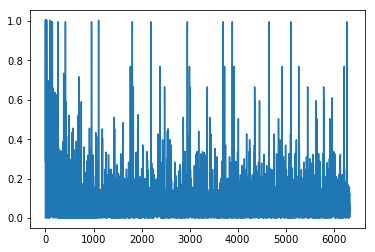

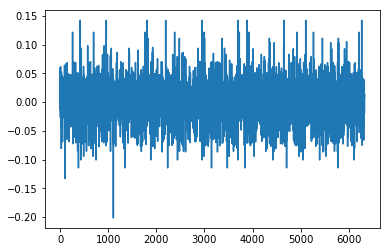

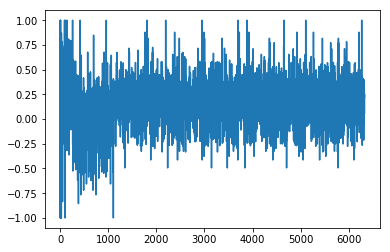

1.02045086814
[ 0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889
  0.88888889  0.88888889  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.88888889  0.          0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.22222222  0.55555556  0.55555556]
Writing away results
2007-04-01 00:00:00


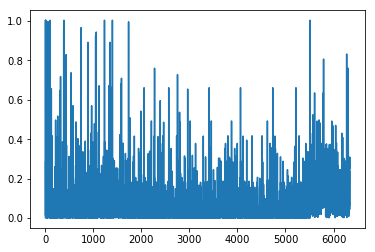

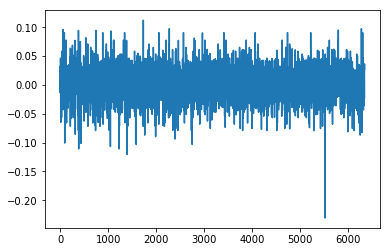

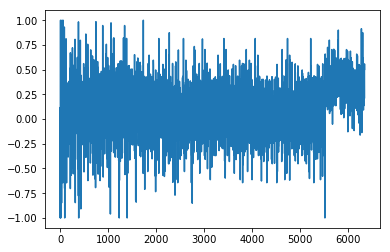

1.14869147355
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  0.55555556  0.77777778  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.77777778  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  1.          0.77777778  0.22222222  0.22222222  0.22222222]
Writing away results
2007-05-01 00:00:00


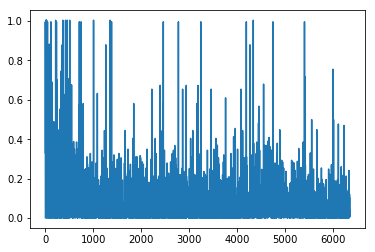

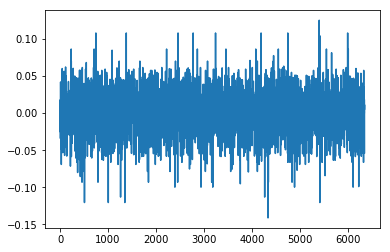

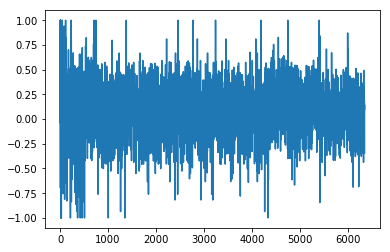

1.20617288904
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.11111111  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.11111111
  0.88888889  0.44444444  0.11111111  0.11111111  0.11111111]
Writing away results
2007-06-01 00:00:00


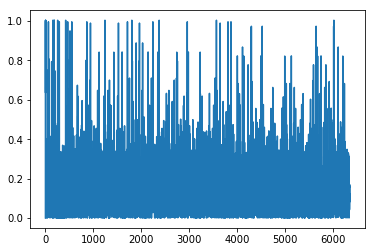

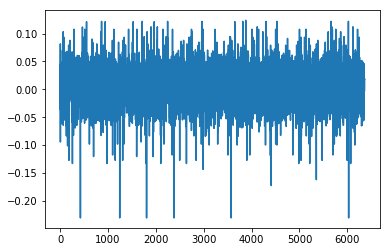

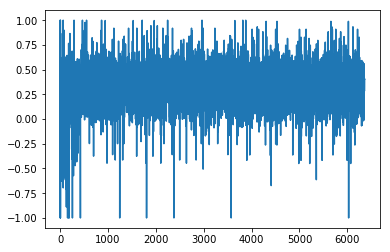

1.17536570171
[ 1.          1.          0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  1.          0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.        ]
Writing away results
2007-07-01 00:00:00


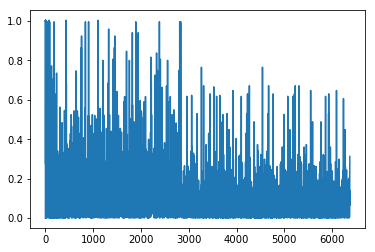

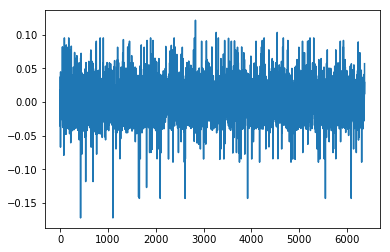

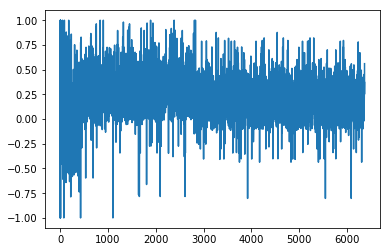

1.21837215468
[ 0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.          0.66666667  0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          1.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.          0.
  1.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.        ]
Writing away results
2007-08-01 00:00:00


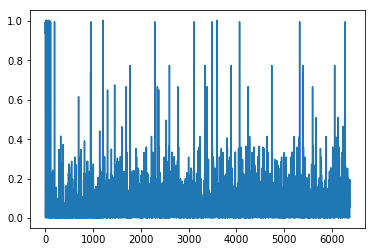

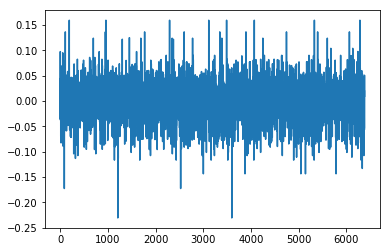

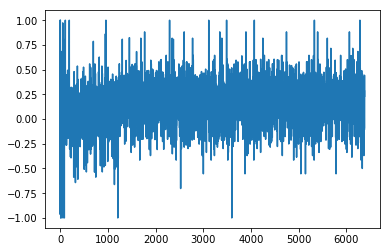

1.10995805267
[ 0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  1.          1.          0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.88888889  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  1.        ]
Writing away results
2007-09-01 00:00:00


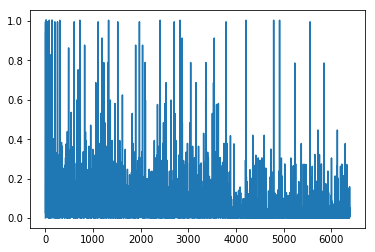

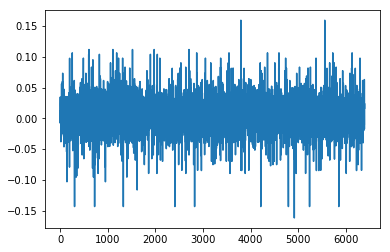

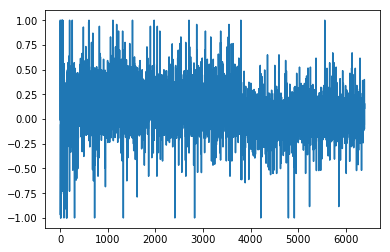

1.42665058278
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.22222222  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.22222222  1.        ]
Writing away results
2007-10-01 00:00:00


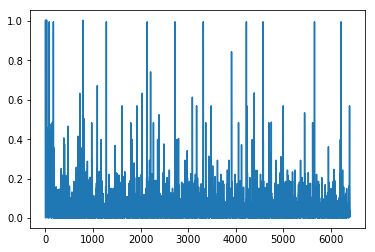

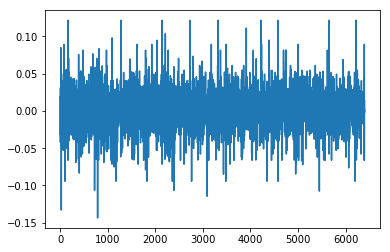

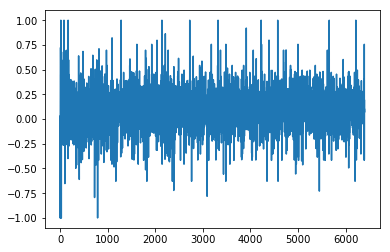

1.2968094808
[ 0.22222222  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.66666667  0.33333333  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111
  1.          0.33333333  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.77777778  0.66666667  0.22222222]
Writing away results
2007-11-01 00:00:00


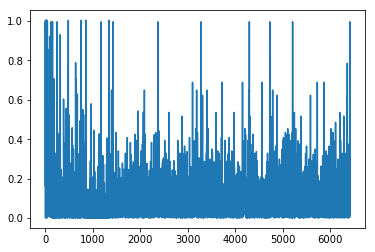

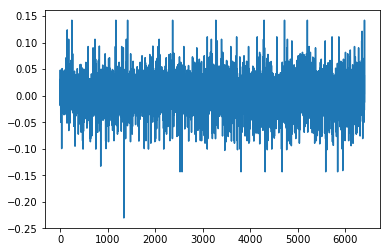

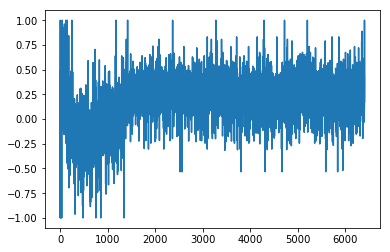

1.14391471002
[ 0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.44444444  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667]
Writing away results
2007-12-01 00:00:00


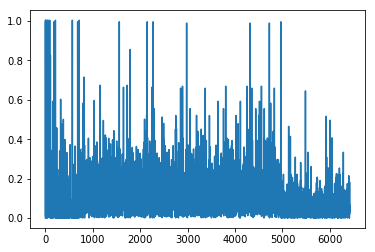

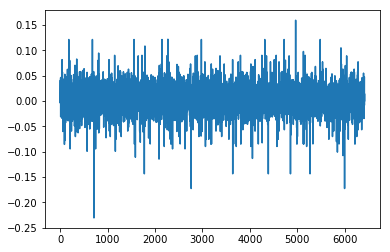

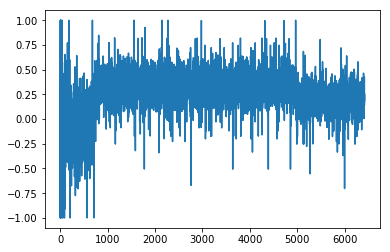

1.3622567089
[ 0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.11111111  0.11111111  0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667]
Writing away results
2008-01-01 00:00:00


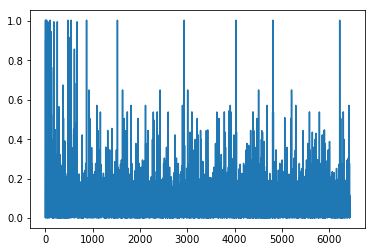

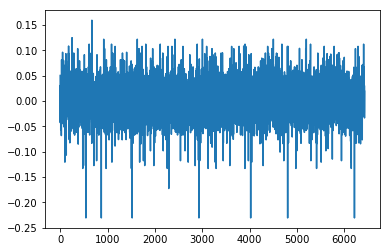

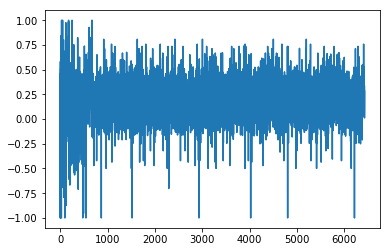

1.30488207147
[ 0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  1.          0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  1.          1.          1.          1.
  0.77777778  0.66666667  1.          1.          1.          1.          1.        ]
Writing away results
2008-02-01 00:00:00


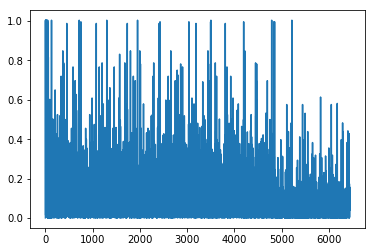

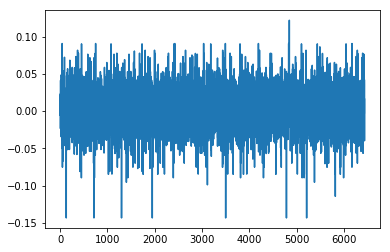

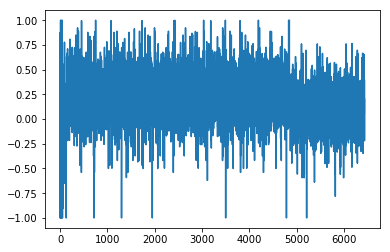

1.34527902954
[ 0.55555556  0.55555556  0.55555556  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
Done!


In [17]:
# initialize
init = tf.global_variables_initializer()
startepsilon = 0.8
endepsilon = 0.01
startlr = 0.8
endlr = 0.01
startgamma = 0.01
endgamma = 0.8
TWlist = []
Index = []
MWeights = []
Turnover = []
chooserlist = []
RU = []
learningrateQ = 0.01
n = 707
periods = 60
epochs = 10     # preferred to have a low amount of epochs because otherwise the the same data is used multiple times (usually not the case in stock returns)

# data parsing
dates = data['Date']
mdata = data[['r','xs','xb']]
mdata.index = pd.DatetimeIndex(dates)

# include the lags
for i in range(1,num_lags+1):  # 1 till 11
    mdata['r_lag' + str(i)] = mdata['r'].shift(i)
    mdata['xs_lag' + str(i)] = mdata['xs'].shift(i)
    mdata['xb_lag' + str(i)] = mdata['xb'].shift(i)

mdata.drop(mdata.head(num_lags).index, inplace=True)
# have a look at the data (if not include NANs)
# print(mdata)

# Train the the Q-function DNN
with tf.Session() as sess:
    for i in range(240,int(n-periods-1)):
        lostlist = []
        OptimalWeights = np.zeros(periods-1)
        currentK = 0
        print(mdata.index[i])
        rmin = -1
        rmax = 1
        sess.run(init) # initialize the Neural Network again
        epsilon = 0.15
        lr = 0.1
        gamma = 0.98
        currentEpoch = 0
        rlist = []  
        runitlist = []
        while currentEpoch < epochs:
            #Training of the Q-Network for the data available (with Neural Nets) 
            indexes = np.asarray(range(i+currentK-1))
            random.shuffle(indexes)
            for j in indexes:
                s = mdata.iloc[j,:].values.reshape(1,num_inputvar)
                #Choose an action by greedily (with e chance of random action) from the Q-network
                a_int,allQ = sess.run([A_Max,output],feed_dict={NN_input:s})
                a = A[a_int]  # -1 because index
                if np.random.rand(1) < epsilon:
                    a = random.choice(A)

                #Get new state and reward from environment
                s1 = mdata.iloc[j+1,:].values.reshape(1,num_inputvar)
                r = (a*s1[0][1] + (1-a)*s1[0][2]) #reward: this is now the wealth gained from this step, but could be other rewards like utility
                rlist.append(r)
                Q = sess.run(output,feed_dict={NN_input:s1})
                    
                #Obtain maxQ' and set our target value for chosen action.
                Q1 = np.max(Q)
                targetQ = allQ
                if(len(rlist)>1):
                    rmin = np.min(rlist)
                    rmax = np.max(rlist)
                runit = -1 + 2*((r -rmin)/(rmax-rmin))
                targetQ[0,int(a*(num_actions-1))] = runit + gamma*Q1
                runitlist.append(runit)
                #Train the neural network using target and predicted Q values
                opt,W1,loss_ = sess.run([optmzr,w1,loss],feed_dict={NN_input:s,Q_Next:targetQ,learning_rate:lr})
                lostlist.append(loss_)
            currentEpoch += 1
                
        while currentK < periods - 1:
            # After training now calculate the optimal weights for the K=60 periods to come
            s = mdata.iloc[i+currentK,:].values.reshape(1,num_inputvar)
            a_int,allQ = sess.run([A_Max,output],feed_dict={NN_input:s})
            aOpt = A[a_int]
            OptimalWeights[currentK] = aOpt
            currentK += 1
            
        # For insight purposes (Write away)
        plt.ion()
        plt.plot(lostlist)
        plt.show()
        plt.plot(rlist)
        plt.show()
        plt.plot(runitlist)
        plt.show()
        
        firstdiff = OptimalWeights[1:] - OptimalWeights[:-1]
        MWeights.append(np.mean(OptimalWeights))
        TerminalWealth = np.exp(sum(OptimalWeights*mdata[i+1:i+currentK+1]['xs'] + (1-OptimalWeights)*mdata[i+1:i+currentK+1]['xb']))
        TWlist.append(TerminalWealth)
        Index.append(mdata.index[i])
        Turnover.append(sum(abs(firstdiff*np.exp(mdata[i+1:i+currentK]['xs'])) + abs((1-firstdiff)*np.exp(mdata[i+1:i+currentK]['xb']))))
        RU.append((1/(1-5))*pow(TerminalWealth,(1-5)))
        print(TerminalWealth)
        print(OptimalWeights)
     n   
        print('Writing away results')
        df = pd.DataFrame({'index date':Index,'TW':TWlist, 'Mean Weights Xs':MWeights,'Turnover':Turnover, 'Realized Utility':RU})
        df.to_excel('DNN1t_2l_softmax_b2.xlsx', sheet_name='sheet1', index=False)
print('Done!')
        